# Import stuff

In [ ]:
import tensorflow as tf
import keras
from keras.models import Sequential
from keras.layers import Dense, Dropout
import sklearn
import pandas as pd
import os
from sklearn.model_selection import train_test_split
import time
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt

In [ ]:
from google.colab import files

# Without SMOTE

## Data Processing

### Import dataset

In [ ]:
directory_all = "/content/drive/MyDrive/Surjya Sir Work/5000"
directory_pbd = "/content/drive/MyDrive/Surjya Sir Work/5000_probed"

In [ ]:
# videos = [1,2,3,4,5,6,7,8]
videos = [1,2,3,4,7,8]

In [ ]:
all = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_all + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    all.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


In [ ]:
probed = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_pbd + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    probed.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


### Create df

In [ ]:
df = pd.DataFrame()
for i in range(len(all)):#per video = 8
  for j in range(len(all[i])): #per subject = 30
    df = df.append(all[i][j], ignore_index=True)

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8
5606,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8
5607,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8
5608,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8


In [ ]:
tester = pd.DataFrame()
for i in range(len(probed)):#per video = 8
  for j in range(len(probed[i])): #per subject = 30
    tester = tester.append(probed[i][j], ignore_index=True)

In [ ]:
tester

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1738876.01,1743876.01,1748876.01,6.309,5.096,0.013,0.106,5.632759,0.600,0.378,0.155,0.010,0.369,1.642,8.131,10,1
1,832168.01,837168.01,842168.01,6.488,5.290,0.012,0.159,1.883567,0.300,3.623,0.126,0.021,0.657,0.246,0.000,11,1
2,907168.01,912168.01,917168.01,5.330,4.958,0.394,0.082,3.340205,0.103,3.119,0.136,0.004,7.022,0.699,0.123,11,1
3,917168.01,922168.01,927168.01,6.046,5.011,0.767,0.003,2.078420,0.213,0.785,0.136,0.007,4.846,0.041,0.040,11,1
4,922168.01,927168.01,932168.01,6.476,5.014,0.430,0.022,2.208317,0.307,4.601,0.068,0.010,4.148,1.191,0.288,11,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
653,2282834.01,2287834.01,2292834.01,2.090,7.542,0.918,0.586,3.800016,3.170,4.349,0.261,0.003,0.082,2.916,1.602,8,8
654,2287834.01,2292834.01,2297834.01,1.199,8.115,1.181,0.661,5.052202,4.889,8.049,1.549,0.039,0.164,1.315,2.587,8,8
655,1166459.01,1171459.01,1176459.01,3.156,6.595,0.518,0.543,4.114055,0.256,0.368,4.792,0.011,2.998,3.368,13.429,9,8
656,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8


In [ ]:
temp = df[df.isin(tester)].dropna()

In [ ]:
temp = df.loc[df.set_index(list(df.columns)).index.isin(tester.set_index(list(tester.columns)).index)]

In [ ]:
temp.index

Int64Index([  35,   47,   62,   64,   65,   70,   99,  107,  117,  118,
            ...
            5511, 5532, 5551, 5554, 5559, 5575, 5576, 5604, 5605, 5606],
           dtype='int64', length=658)

In [ ]:
df['Probe'] = 0

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,0
5606,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,0
5607,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
5608,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
for idx in temp.index:
  df.at[idx, 'Probe'] = 1

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
5606,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
5607,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
5608,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


### Optimise df

In [ ]:
df = df.drop(columns=["Start", "Border", "End"], axis=1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
5606,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
5607,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
5608,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
df['valence_acc_video'] = 0
df['arousal_acc_video'] = 0

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,0,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,0,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,0,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,0,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,0
5606,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,0
5607,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,0
5608,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,0


I'm using the following encoding: 

1 - Low
2 - Mid/high
3 - High

In [ ]:
# def basedOnVideoValence(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 2
#     if int(video) == 6:
#         return 2
#     if int(video) == 7:
#         return 1
#     if int(video) == 8:
#         return 1
    
# def basedOnVideoArousal(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 1
#     if int(video) == 6:
#         return 1
#     if int(video) == 7:
#         return 3
#     if int(video) == 8:
#         return 3

New encoding, 
Low - 0 
Med / High - 1

In [ ]:
def basedOnVideoValence(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 1
    if int(video) == 6:
        return 1
    if int(video) == 7:
        return 0
    if int(video) == 8:
        return 0
    
def basedOnVideoArousal(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 0
    if int(video) == 6:
        return 0
    if int(video) == 7:
        return 1
    if int(video) == 8:
        return 1

In [ ]:
df['valence_acc_video'] = df.apply(lambda row : basedOnVideoValence(row['video']), axis = 1)
df['arousal_acc_video'] = df.apply(lambda row : basedOnVideoArousal(row['video']), axis = 1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1
5606,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1
5607,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1
5608,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1


### Create X,y

In [ ]:
#df

In [ ]:
# X_train = pd.DataFrame()
# y_train = pd.DataFrame()
# X_test = pd.DataFrame()
# y_test = pd.DataFrame()

In [ ]:
# for video in videos:
#     df_selected = df[df['video'] == video]
#     y = df_selected['Probe']
#     y = pd.DataFrame(y)
#     X = df_selected.drop(columns=["Probe"], axis = 1)
#     X_train_new, X_test_new, y_train_new, y_test_new = train_test_split(X, y, test_size=0.2, random_state=42)
#     X_train = X_train.append(X_train_new, ignore_index=True)
#     y_train = y_train.append(y_train_new, ignore_index=True)
#     X_test = X_test.append(X_test_new, ignore_index=True)
#     y_test = y_test.append(y_test_new, ignore_index=True)

In [ ]:
# X_train

In [ ]:
# y_test

In [ ]:
# X_train = X_train.drop(columns=['video', 'subject'])
# X_test = X_test.drop(columns=['video', 'subject'])

In [ ]:
# X_train

### X,y using leave 1 use rest

In [ ]:
X_train_all = []
y_train_all = []
X_test_all = []
y_test_all = []

In [ ]:
users = []
for i in range(1, 31):
  users.append(i)

print(users)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30]


In [ ]:
for testuser in users:
  X_train = pd.DataFrame()
  y_train = pd.DataFrame()
  X_test = pd.DataFrame()
  y_test = pd.DataFrame()
  df_new = df[df['subject'] != str(testuser)]
  for video in videos:
    df_selected = df_new[df_new['video'] == video]
    y = df_selected['Probe']
    y = pd.DataFrame(y)
    X = df_selected.drop(columns=["Probe"], axis = 1)
    X_train = X_train.append(X, ignore_index=True)
    y_train = y_train.append(y, ignore_index=True)
  df_new = df[df['subject'] == str(testuser)]
  # print(df_new)
  for video in videos:
    df_selected = df_new[df_new['video'] == video]
    y = df_selected['Probe']
    y = pd.DataFrame(y)
    X = df_selected.drop(columns=["Probe"], axis = 1)
    X_test = X_test.append(X, ignore_index=True)
    y_test = y_test.append(y, ignore_index=True)  
  X_train_all.append(X_train)
  y_train_all.append(y_train)
  X_test_all.append(X_test)
  y_test_all.append(y_test)

In [ ]:
print(len(X_train_all[29]['subject'].unique()))

29


In [ ]:
new_X_train_all = []

for i in range(len(X_train_all)):
    df_temp = X_train_all[i]
    #df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    df_temp = df_temp.drop(columns=["subject"], axis = 1)
    new_X_train_all.append(df_temp)

X_train_all = new_X_train_all

new_X_test_all = []

for i in range(len(X_test_all)):
    df_temp = X_test_all[i]
    #df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    df_temp = df_temp.drop(columns=["subject"], axis = 1)
    new_X_test_all.append(df_temp)

X_test_all = new_X_test_all

In [ ]:
X_train_all[2]

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,video,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,1,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,1,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,1,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,1,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5418,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,8,0,1
5419,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,8,0,1
5420,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,8,0,1
5421,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,8,0,1


In [ ]:
y_test_all[7]

,Probe
0,0
1,0
2,0
3,0
4,0
...,...
182,0
183,0
184,0
185,0


## Models

###RandomForest

#### Model

In [ ]:
from sklearn.ensemble import RandomForestClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []

TPs = []
FPs = []
TNs = []
FNs = []


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.7249557971954346
Random Forest Accuracy = 0.9251336898395722
Random Forest Test time = 0.06212949752807617
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.925134
[[163   3]
 [ 11  10]]
True negatives: 163
True positives: 10
False positives: 3
False negatives: 11
ROC AUC: 0.729059
F1 Score: 0.588235
Precision: 0.769231
TPR: 0.476190
FPR: 0.018072
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.7674744129180908
Random Forest Accuracy = 0.946524064171123
Random Forest Test time = 0.058441877365112305
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.946524
[[165   7]
 [  3  12]]
True negatives: 165
True positives: 12
False positives: 7
False negatives: 3
ROC AUC: 0.879651
F1 Score: 0.705882
Precision: 0.631579
TPR: 0.800000
FPR: 0.040698
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6579697132110596
Random Forest Accuracy = 0.9411764705882353
Random Forest Test time = 0.062012672424316406
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.941176
[[158   4]
 [  7  18]]
True negatives: 158
True positives: 18
False positives: 4
False negatives: 7
ROC AUC: 0.847654
F1 Score: 0.765957
Precision: 0.818182
TPR: 0.720000
FPR: 0.024691
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.620072603225708
Random Forest Accuracy = 0.8823529411764706
Random Forest Test time = 0.06071329116821289
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.882353
[[154   1]
 [ 21  11]]
True negatives: 154
True positives: 11
False positives: 1
False negatives: 21
ROC AUC: 0.668649
F1 Score: 0.500000
Precision: 0.916667
TPR: 0.343750
FPR: 0.006452
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6946215629577637
Random Forest Accuracy = 0.9090909090909091
Random Forest Test time = 0.05928158760070801
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.909091
[[155   5]
 [ 12  15]]
True negatives: 155
True positives: 15
False positives: 5
False negatives: 12
ROC AUC: 0.762153
F1 Score: 0.638298
Precision: 0.750000
TPR: 0.555556
FPR: 0.031250
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6056010723114014
Random Forest Accuracy = 0.93048128342246
Random Forest Test time = 0.05858278274536133
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.930481
[[166   2]
 [ 11   8]]
True negatives: 166
True positives: 8
False positives: 2
False negatives: 11
ROC AUC: 0.704574
F1 Score: 0.551724
Precision: 0.800000
TPR: 0.421053
FPR: 0.011905
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.5735664367675781
Random Forest Accuracy = 0.93048128342246
Random Forest Test time = 0.05836749076843262
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.930481
[[157   7]
 [  6  17]]
True negatives: 157
True positives: 17
False positives: 7
False negatives: 6
ROC AUC: 0.848224
F1 Score: 0.723404
Precision: 0.708333
TPR: 0.739130
FPR: 0.042683
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6537492275238037
Random Forest Accuracy = 0.9037433155080213
Random Forest Test time = 0.06482625007629395
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.903743
[[161   5]
 [ 13   8]]
True negatives: 161
True positives: 8
False positives: 5
False negatives: 13
ROC AUC: 0.675416
F1 Score: 0.470588
Precision: 0.615385
TPR: 0.380952
FPR: 0.030120
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6659114360809326
Random Forest Accuracy = 0.9251336898395722
Random Forest Test time = 0.057839393615722656
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.925134
[[160   2]
 [ 12  13]]
True negatives: 160
True positives: 13
False positives: 2
False negatives: 12
ROC AUC: 0.753827
F1 Score: 0.650000
Precision: 0.866667
TPR: 0.520000
FPR: 0.012346
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.5524837970733643
Random Forest Accuracy = 0.9197860962566845
Random Forest Test time = 0.07737398147583008
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.919786
[[168   0]
 [ 15   4]]
True negatives: 168
True positives: 4
False positives: 0
False negatives: 15
ROC AUC: 0.605263
F1 Score: 0.347826
Precision: 1.000000
TPR: 0.210526
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.5854532718658447
Random Forest Accuracy = 0.8983957219251337
Random Forest Test time = 0.058449506759643555
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.898396
[[165   0]
 [ 19   3]]
True negatives: 165
True positives: 3
False positives: 0
False negatives: 19
ROC AUC: 0.568182
F1 Score: 0.240000
Precision: 1.000000
TPR: 0.136364
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.680100917816162
Random Forest Accuracy = 0.9358288770053476
Random Forest Test time = 0.06331825256347656
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.935829
[[169   0]
 [ 12   6]]
True negatives: 169
True positives: 6
False positives: 0
False negatives: 12
ROC AUC: 0.666667
F1 Score: 0.500000
Precision: 1.000000
TPR: 0.333333
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6100788116455078
Random Forest Accuracy = 0.9144385026737968
Random Forest Test time = 0.05413675308227539
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.914439
[[157   8]
 [  8  14]]
True negatives: 157
True positives: 14
False positives: 8
False negatives: 8
ROC AUC: 0.793939
F1 Score: 0.636364
Precision: 0.636364
TPR: 0.636364
FPR: 0.048485
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.5935111045837402
Random Forest Accuracy = 0.9358288770053476
Random Forest Test time = 0.05234813690185547
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.935829
[[163   6]
 [  6  12]]
True negatives: 163
True positives: 12
False positives: 6
False negatives: 6
ROC AUC: 0.815582
F1 Score: 0.666667
Precision: 0.666667
TPR: 0.666667
FPR: 0.035503
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6056926250457764
Random Forest Accuracy = 0.9411764705882353
Random Forest Test time = 0.06017661094665527
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.941176
[[160   4]
 [  7  16]]
True negatives: 160
True positives: 16
False positives: 4
False negatives: 7
ROC AUC: 0.835631
F1 Score: 0.744186
Precision: 0.800000
TPR: 0.695652
FPR: 0.024390
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6644015312194824
Random Forest Accuracy = 0.9090909090909091
Random Forest Test time = 0.05610203742980957
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.909091
[[167   0]
 [ 17   3]]
True negatives: 167
True positives: 3
False positives: 0
False negatives: 17
ROC AUC: 0.575000
F1 Score: 0.260870
Precision: 1.000000
TPR: 0.150000
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6425573825836182
Random Forest Accuracy = 0.8983957219251337
Random Forest Test time = 0.05672955513000488
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.898396
[[164   1]
 [ 18   4]]
True negatives: 164
True positives: 4
False positives: 1
False negatives: 18
ROC AUC: 0.587879
F1 Score: 0.296296
Precision: 0.800000
TPR: 0.181818
FPR: 0.006061
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.688896656036377
Random Forest Accuracy = 0.946524064171123
Random Forest Test time = 0.055796146392822266
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.946524
[[170   1]
 [  9   7]]
True negatives: 170
True positives: 7
False positives: 1
False negatives: 9
ROC AUC: 0.715826
F1 Score: 0.583333
Precision: 0.875000
TPR: 0.437500
FPR: 0.005848
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6348164081573486
Random Forest Accuracy = 0.8716577540106952
Random Forest Test time = 0.052385568618774414
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.871658
[[149  10]
 [ 14  14]]
True negatives: 149
True positives: 14
False positives: 10
False negatives: 14
ROC AUC: 0.718553
F1 Score: 0.538462
Precision: 0.583333
TPR: 0.500000
FPR: 0.062893
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.5887928009033203
Random Forest Accuracy = 0.9572192513368984
Random Forest Test time = 0.06038093566894531
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.957219
[[159   4]
 [  4  20]]
True negatives: 159
True positives: 20
False positives: 4
False negatives: 4
ROC AUC: 0.904397
F1 Score: 0.833333
Precision: 0.833333
TPR: 0.833333
FPR: 0.024540
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.7095396518707275
Random Forest Accuracy = 0.8609625668449198
Random Forest Test time = 0.06039714813232422
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.860963
[[161   0]
 [ 26   0]]
True negatives: 161
True positives: 0
False positives: 0
False negatives: 26
ROC AUC: 0.500000
F1 Score: 0.000000
Precision: nan
TPR: 0.000000
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:58: RuntimeWarning: invalid value encountered in long_scalars
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y w

Random Forest Train time = 1.6572246551513672
Random Forest Accuracy = 0.9358288770053476
Random Forest Test time = 0.057076215744018555
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.935829
[[166   0]
 [ 12   9]]
True negatives: 166
True positives: 9
False positives: 0
False negatives: 12
ROC AUC: 0.714286
F1 Score: 0.600000
Precision: 1.000000
TPR: 0.428571
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6110999584197998
Random Forest Accuracy = 0.893048128342246
Random Forest Test time = 0.056748151779174805
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.893048
[[162   0]
 [ 20   5]]
True negatives: 162
True positives: 5
False positives: 0
False negatives: 20
ROC AUC: 0.600000
F1 Score: 0.333333
Precision: 1.000000
TPR: 0.200000
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.7312378883361816
Random Forest Accuracy = 0.9037433155080213
Random Forest Test time = 0.05871176719665527
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.903743
[[165   0]
 [ 18   4]]
True negatives: 165
True positives: 4
False positives: 0
False negatives: 18
ROC AUC: 0.590909
F1 Score: 0.307692
Precision: 1.000000
TPR: 0.181818
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6696162223815918
Random Forest Accuracy = 0.8770053475935828
Random Forest Test time = 0.057554006576538086
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.877005
[[161   2]
 [ 21   3]]
True negatives: 161
True positives: 3
False positives: 2
False negatives: 21
ROC AUC: 0.556365
F1 Score: 0.206897
Precision: 0.600000
TPR: 0.125000
FPR: 0.012270
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.688603401184082
Random Forest Accuracy = 0.9625668449197861
Random Forest Test time = 0.058058977127075195
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.962567
[[165   4]
 [  3  15]]
True negatives: 165
True positives: 15
False positives: 4
False negatives: 3
ROC AUC: 0.904832
F1 Score: 0.810811
Precision: 0.789474
TPR: 0.833333
FPR: 0.023669
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6160671710968018
Random Forest Accuracy = 0.9037433155080213
Random Forest Test time = 0.05523109436035156
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.903743
[[161   4]
 [ 14   8]]
True negatives: 161
True positives: 8
False positives: 4
False negatives: 14
ROC AUC: 0.669697
F1 Score: 0.470588
Precision: 0.666667
TPR: 0.363636
FPR: 0.024242


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.631455659866333
Random Forest Accuracy = 0.93048128342246
Random Forest Test time = 0.060643911361694336
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.930481
[[169   0]
 [ 13   5]]
True negatives: 169
True positives: 5
False positives: 0
False negatives: 13
ROC AUC: 0.638889
F1 Score: 0.434783
Precision: 1.000000
TPR: 0.277778
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6395504474639893
Random Forest Accuracy = 0.9411764705882353
Random Forest Test time = 0.05849289894104004
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.941176
[[163   4]
 [  7  13]]
True negatives: 163
True positives: 13
False positives: 4
False negatives: 7
ROC AUC: 0.813024
F1 Score: 0.702703
Precision: 0.764706
TPR: 0.650000
FPR: 0.023952
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6503431797027588
Random Forest Accuracy = 0.93048128342246
Random Forest Test time = 0.06399726867675781
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.930481
[[160   5]
 [  8  14]]
True negatives: 160
True positives: 14
False positives: 5
False negatives: 8
ROC AUC: 0.803030
F1 Score: 0.682927
Precision: 0.736842
TPR: 0.636364
FPR: 0.030303
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


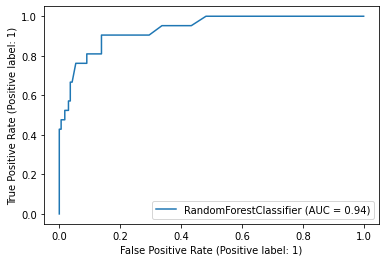

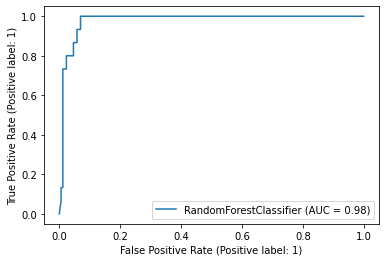

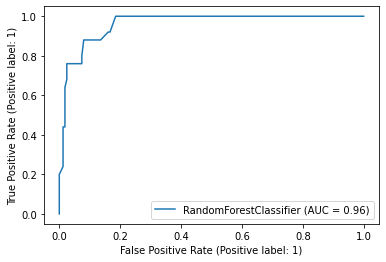

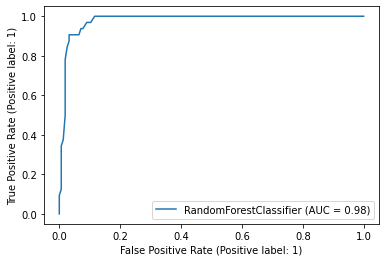

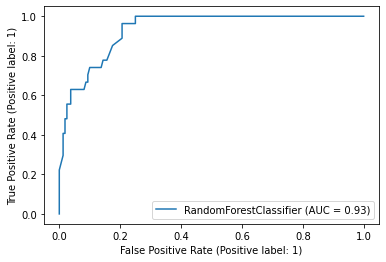

...

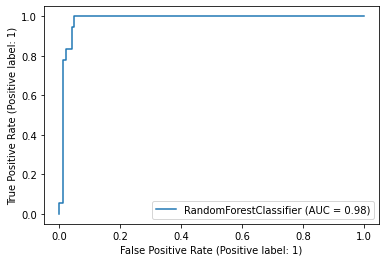

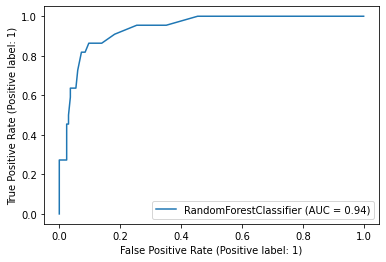

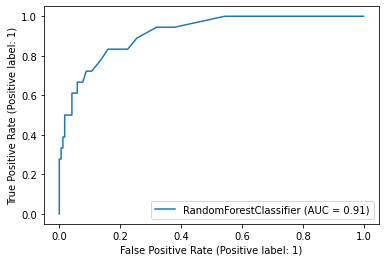

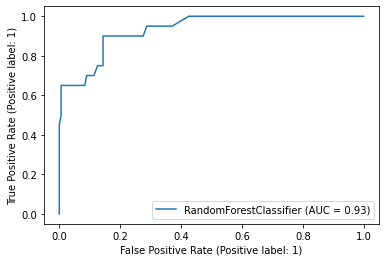

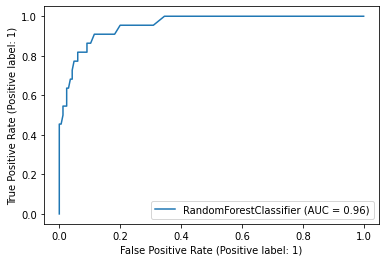

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_rf = RandomForestClassifier() 
    tic = time.time()
    model_rf.fit(X_train, y_train) 
    toc = time.time()
    print("Random Forest Train time = " + str(toc-tic))
    print("Random Forest Accuracy = "+ str(model_rf.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_rf.predict(X_test)
    yhat_classes = (model_rf.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Random Forest Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Random Forest Stats _____________________")

    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    CM = confusion_matrix(y_test, yhat_classes)
    print(CM)
    TN = CM[0][0]
    FN = CM[1][0]
    TP = CM[1][1]
    FP = CM[0][1]
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)

    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    auc = roc_auc_score(y_test, yhat_probs)
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    #AUC
    from sklearn.metrics import plot_roc_curve
    plot_roc_curve(model_rf, X_test, y_test)

    print("____________________________________________________________")
    print("____________________________________________________________")

#### Results

291


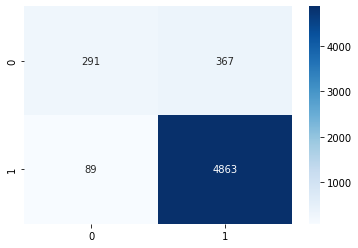

In [ ]:
import seaborn as sns

TPsum = np.sum(TPs)
TNsum = np.sum(TNs)
FPsum = np.sum(FPs)
FNsum = np.sum(FNs)

print(TPsum)

cm_data = [[TPsum, FNsum], [FPsum, TNsum]]
sns.heatmap(cm_data, annot=True, cmap='Blues', fmt='d')

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
RFWithoutSMOTE = pd.DataFrame(data, columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([RFWithoutSMOTE.mean(axis=0).values],  columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User Left Out  Accuracy   ROC_AUC        F1  Precision       TPR  \
Average           15.5  0.918717  0.714905  0.526372   0.814773  0.447823   

              FPR   TP     TN        FP         FN  
Average  0.018012  9.7  162.1  2.966667  12.233333  


In [ ]:
RFWithoutSMOTE = RFWithoutSMOTE.append(df_temp)

In [ ]:
print(RFWithoutSMOTE)
RFWithoutSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/RFWithoutSMOTE.csv', index = True)

         User Left Out  Accuracy   ROC_AUC        F1  Precision       TPR  \
0                  1.0  0.925134  0.729059  0.588235   0.769231  0.476190   
1                  2.0  0.946524  0.879651  0.705882   0.631579  0.800000   
2                  3.0  0.941176  0.847654  0.765957   0.818182  0.720000   
3                  4.0  0.882353  0.668649  0.500000   0.916667  0.343750   
4                  5.0  0.909091  0.762153  0.638298   0.750000  0.555556   
5                  6.0  0.930481  0.704574  0.551724   0.800000  0.421053   
6                  7.0  0.930481  0.848224  0.723404   0.708333  0.739130   
7                  8.0  0.903743  0.675416  0.470588   0.615385  0.380952   
8                  9.0  0.925134  0.753827  0.650000   0.866667  0.520000   
9                 10.0  0.919786  0.605263  0.347826   1.000000  0.210526   
10                11.0  0.898396  0.568182  0.240000   1.000000  0.136364   
11                12.0  0.935829  0.666667  0.500000   1.000000  0.333333   

###Descision Tree

####Model

In [ ]:
from sklearn.tree import DecisionTreeClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

Decision Tree Train time = 0.0734410285949707
Decision Tree Accuracy = 0.8983957219251337
Decision Tree Test time = 0.004842519760131836
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.898396
[[159   7]
 [ 12   9]]
True negatives: 159
True positives: 9
False positives: 7
False negatives: 12
ROC AUC: 0.693201
F1 Score: 0.486486
Precision: 0.562500
TPR: 0.428571
FPR: 0.042169
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.08131265640258789
Decision Tree Accuracy = 0.893048128342246
Decision Tree Test time = 0.00459599494934082
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.893048
[[154  18]
 [  2  13]]
True negatives: 154
True positives: 13
False positives: 18
False negatives: 2
ROC AUC: 0.881008
F1 Score: 0.565217
Precision: 0.419355
TPR: 0.866667
FPR: 0.104651
______________________________________________

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


Decision Tree Train time = 0.08168768882751465
Decision Tree Accuracy = 0.8609625668449198
Decision Tree Test time = 0.0048067569732666016
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.860963
[[142  20]
 [  6  19]]
True negatives: 142
True positives: 19
False positives: 20
False negatives: 6
ROC AUC: 0.818272
F1 Score: 0.593750
Precision: 0.487179
TPR: 0.760000
FPR: 0.123457
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.08716368675231934
Decision Tree Accuracy = 0.8288770053475936
Decision Tree Test time = 0.005608081817626953
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.828877
[[138  17]
 [ 15  17]]
True negatives: 138
True positives: 17
False positives: 17
False negatives: 15
ROC AUC: 0.710786
F1 Score: 0.515152
Precision: 0.500000
TPR: 0.531250
FPR: 0.109677
________________________________________

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


Decision Tree Train time = 0.08625245094299316
Decision Tree Accuracy = 0.8181818181818182
Decision Tree Test time = 0.006055355072021484
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.818182
[[136  24]
 [ 10  17]]
True negatives: 136
True positives: 17
False positives: 24
False negatives: 10
ROC AUC: 0.739815
F1 Score: 0.500000
Precision: 0.414634
TPR: 0.629630
FPR: 0.150000
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.07688260078430176
Decision Tree Accuracy = 0.9037433155080213
Decision Tree Test time = 0.006205081939697266
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.903743
[[158  10]
 [  8  11]]
True negatives: 158
True positives: 11
False positives: 10
False negatives: 8
ROC AUC: 0.759712
F1 Score: 0.550000
Precision: 0.523810
TPR: 0.578947
FPR: 0.059524
_________________________________________

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


Decision Tree Train time = 0.08956241607666016
Decision Tree Accuracy = 0.8502673796791443
Decision Tree Test time = 0.0052716732025146484
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.850267
[[144  20]
 [  8  15]]
True negatives: 144
True positives: 15
False positives: 20
False negatives: 8
ROC AUC: 0.765111
F1 Score: 0.517241
Precision: 0.428571
TPR: 0.652174
FPR: 0.121951
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.07619571685791016
Decision Tree Accuracy = 0.8663101604278075
Decision Tree Test time = 0.005660533905029297
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.866310
[[155  11]
 [ 14   7]]
True negatives: 155
True positives: 7
False positives: 11
False negatives: 14
ROC AUC: 0.633534
F1 Score: 0.358974
Precision: 0.388889
TPR: 0.333333
FPR: 0.066265
_________________________________________

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


Decision Tree Train time = 0.09183740615844727
Decision Tree Accuracy = 0.8716577540106952
Decision Tree Test time = 0.0052340030670166016
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.871658
[[146  16]
 [  8  17]]
True negatives: 146
True positives: 17
False positives: 16
False negatives: 8
ROC AUC: 0.790617
F1 Score: 0.586207
Precision: 0.515152
TPR: 0.680000
FPR: 0.098765
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.07621407508850098
Decision Tree Accuracy = 0.893048128342246
Decision Tree Test time = 0.005153179168701172
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.893048
[[161   7]
 [ 13   6]]
True negatives: 161
True positives: 6
False positives: 7
False negatives: 13
ROC AUC: 0.637061
F1 Score: 0.375000
Precision: 0.461538
TPR: 0.315789
FPR: 0.041667
___________________________________________

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


Decision Tree Train time = 0.10334205627441406
Decision Tree Accuracy = 0.8877005347593583
Decision Tree Test time = 0.005377292633056641
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.887701
[[158   7]
 [ 14   8]]
True negatives: 158
True positives: 8
False positives: 7
False negatives: 14
ROC AUC: 0.660606
F1 Score: 0.432432
Precision: 0.533333
TPR: 0.363636
FPR: 0.042424
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.07874536514282227
Decision Tree Accuracy = 0.9251336898395722
Decision Tree Test time = 0.005871772766113281
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.925134
[[168   1]
 [ 13   5]]
True negatives: 168
True positives: 5
False positives: 1
False negatives: 13
ROC AUC: 0.635930
F1 Score: 0.416667
Precision: 0.833333
TPR: 0.277778
FPR: 0.005917
____________________________________________

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


Decision Tree Train time = 0.09041762351989746
Decision Tree Accuracy = 0.8556149732620321
Decision Tree Test time = 0.005465984344482422
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.855615
[[146  19]
 [  8  14]]
True negatives: 146
True positives: 14
False positives: 19
False negatives: 8
ROC AUC: 0.760606
F1 Score: 0.509091
Precision: 0.424242
TPR: 0.636364
FPR: 0.115152
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.07725334167480469
Decision Tree Accuracy = 0.8716577540106952
Decision Tree Test time = 0.00548863410949707
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.871658
[[151  18]
 [  6  12]]
True negatives: 151
True positives: 12
False positives: 18
False negatives: 6
ROC AUC: 0.780079
F1 Score: 0.500000
Precision: 0.400000
TPR: 0.666667
FPR: 0.106509
___________________________________________

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


Decision Tree Train time = 0.09339737892150879
Decision Tree Accuracy = 0.8823529411764706
Decision Tree Test time = 0.005475282669067383
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.882353
[[151  13]
 [  9  14]]
True negatives: 151
True positives: 14
False positives: 13
False negatives: 9
ROC AUC: 0.764714
F1 Score: 0.560000
Precision: 0.518519
TPR: 0.608696
FPR: 0.079268
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.07723426818847656
Decision Tree Accuracy = 0.9144385026737968
Decision Tree Test time = 0.005346536636352539
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.914439
[[164   3]
 [ 13   7]]
True negatives: 164
True positives: 7
False positives: 3
False negatives: 13
ROC AUC: 0.666018
F1 Score: 0.466667
Precision: 0.700000
TPR: 0.350000
FPR: 0.017964
___________________________________________

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


Decision Tree Train time = 0.08820652961730957
Decision Tree Accuracy = 0.8983957219251337
Decision Tree Test time = 0.005663871765136719
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.898396
[[161   4]
 [ 15   7]]
True negatives: 161
True positives: 7
False positives: 4
False negatives: 15
ROC AUC: 0.646970
F1 Score: 0.424242
Precision: 0.636364
TPR: 0.318182
FPR: 0.024242
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.07813024520874023
Decision Tree Accuracy = 0.946524064171123
Decision Tree Test time = 0.0064084529876708984
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.946524
[[169   2]
 [  8   8]]
True negatives: 169
True positives: 8
False positives: 2
False negatives: 8
ROC AUC: 0.744152
F1 Score: 0.615385
Precision: 0.800000
TPR: 0.500000
FPR: 0.011696
_____________________________________________

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


Decision Tree Train time = 0.08321285247802734
Decision Tree Accuracy = 0.7593582887700535
Decision Tree Test time = 0.005299091339111328
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.759358
[[129  30]
 [ 15  13]]
True negatives: 129
True positives: 13
False positives: 30
False negatives: 15
ROC AUC: 0.637803
F1 Score: 0.366197
Precision: 0.302326
TPR: 0.464286
FPR: 0.188679
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.07332777976989746
Decision Tree Accuracy = 0.8770053475935828
Decision Tree Test time = 0.0053637027740478516
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.877005
[[145  18]
 [  5  19]]
True negatives: 145
True positives: 19
False positives: 18
False negatives: 5
ROC AUC: 0.840619
F1 Score: 0.622951
Precision: 0.513514
TPR: 0.791667
FPR: 0.110429
________________________________________

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


Decision Tree Train time = 0.08017945289611816
Decision Tree Accuracy = 0.839572192513369
Decision Tree Test time = 0.004776954650878906
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.839572
[[155   6]
 [ 24   2]]
True negatives: 155
True positives: 2
False positives: 6
False negatives: 24
ROC AUC: 0.519828
F1 Score: 0.117647
Precision: 0.250000
TPR: 0.076923
FPR: 0.037267
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.0742194652557373
Decision Tree Accuracy = 0.9197860962566845
Decision Tree Test time = 0.004695415496826172
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.919786
[[158   8]
 [  7  14]]
True negatives: 158
True positives: 14
False positives: 8
False negatives: 7
ROC AUC: 0.809237
F1 Score: 0.651163
Precision: 0.636364
TPR: 0.666667
FPR: 0.048193
______________________________________________

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class m

Decision Tree Train time = 0.08619499206542969
Decision Tree Accuracy = 0.8823529411764706
Decision Tree Test time = 0.00496363639831543
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.882353
[[154   8]
 [ 14  11]]
True negatives: 154
True positives: 11
False positives: 8
False negatives: 14
ROC AUC: 0.695309
F1 Score: 0.500000
Precision: 0.578947
TPR: 0.440000
FPR: 0.049383
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.08472490310668945
Decision Tree Accuracy = 0.9251336898395722
Decision Tree Test time = 0.006147146224975586
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.925134
[[160   5]
 [  9  13]]
True negatives: 160
True positives: 13
False positives: 5
False negatives: 9
ROC AUC: 0.780303
F1 Score: 0.650000
Precision: 0.722222
TPR: 0.590909
FPR: 0.030303
____________________________________________

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class m

Decision Tree Train time = 0.08018374443054199
Decision Tree Accuracy = 0.8609625668449198
Decision Tree Test time = 0.004910707473754883
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.860963
[[154   9]
 [ 17   7]]
True negatives: 154
True positives: 7
False positives: 9
False negatives: 17
ROC AUC: 0.618226
F1 Score: 0.350000
Precision: 0.437500
TPR: 0.291667
FPR: 0.055215
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.09088516235351562
Decision Tree Accuracy = 0.893048128342246
Decision Tree Test time = 0.0051937103271484375
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.893048
[[152  17]
 [  3  15]]
True negatives: 152
True positives: 15
False positives: 17
False negatives: 3
ROC AUC: 0.866371
F1 Score: 0.600000
Precision: 0.468750
TPR: 0.833333
FPR: 0.100592


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class m

____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.08360671997070312
Decision Tree Accuracy = 0.8770053475935828
Decision Tree Test time = 0.005438327789306641
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.877005
[[155  10]
 [ 13   9]]
True negatives: 155
True positives: 9
False positives: 10
False negatives: 13
ROC AUC: 0.674242
F1 Score: 0.439024
Precision: 0.473684
TPR: 0.409091
FPR: 0.060606
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class m

Decision Tree Train time = 0.08455729484558105
Decision Tree Accuracy = 0.9197860962566845
Decision Tree Test time = 0.005553245544433594
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.919786
[[163   6]
 [  9   9]]
True negatives: 163
True positives: 9
False positives: 6
False negatives: 9
ROC AUC: 0.732249
F1 Score: 0.545455
Precision: 0.600000
TPR: 0.500000
FPR: 0.035503
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.08089971542358398
Decision Tree Accuracy = 0.8342245989304813
Decision Tree Test time = 0.005179166793823242
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.834225
[[147  20]
 [ 11   9]]
True negatives: 147
True positives: 9
False positives: 20
False negatives: 11
ROC AUC: 0.665120
F1 Score: 0.367347
Precision: 0.310345
TPR: 0.450000
FPR: 0.119760
____________________________________________

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class m

Decision Tree Train time = 0.08340620994567871
Decision Tree Accuracy = 0.8609625668449198
Decision Tree Test time = 0.005466938018798828
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.860963
[[141  24]
 [  2  20]]
True negatives: 141
True positives: 20
False positives: 24
False negatives: 2
ROC AUC: 0.881818
F1 Score: 0.606061
Precision: 0.454545
TPR: 0.909091
FPR: 0.145455
____________________________________________________________
____________________________________________________________


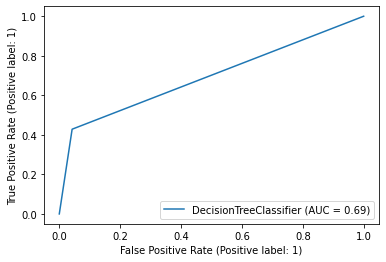

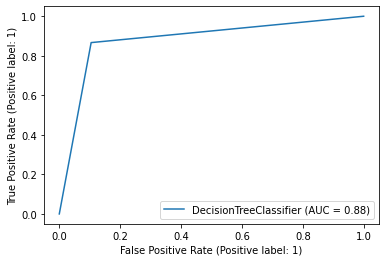

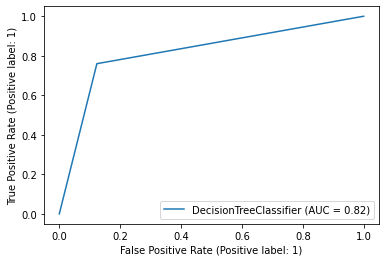

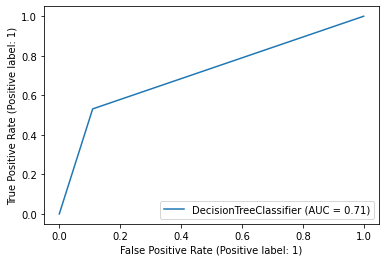

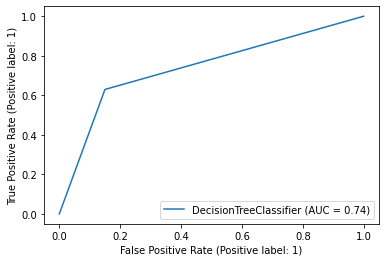

...

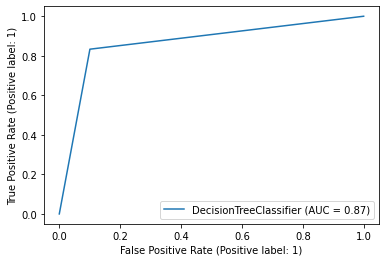

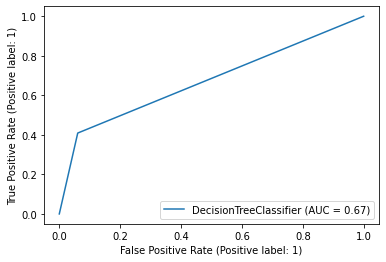

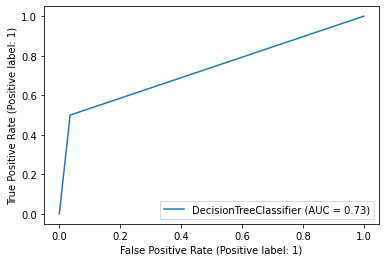

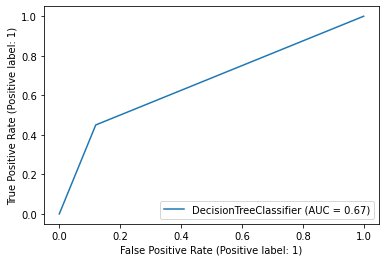

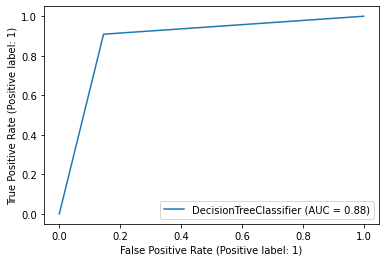

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_dt = DecisionTreeClassifier()
    tic = time.time()
    model_dt.fit(X_train, y_train) 
    toc = time.time()
    print("Decision Tree Train time = " + str(toc-tic))
    print("Decision Tree Accuracy = "+ str(model_dt.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_dt.predict(X_test)
    yhat_classes = (model_dt.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Decision Tree Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Decision Tree Stats _____________________")

    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    CM = confusion_matrix(y_test, yhat_classes)
    print(CM)
    TN = CM[0][0]
    FN = CM[1][0]
    TP = CM[1][1]
    FP = CM[0][1]
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)

    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    auc = roc_auc_score(y_test, yhat_probs)
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    #AUC
    from sklearn.metrics import plot_roc_curve
    plot_roc_curve(model_dt, X_test, y_test)

    print("____________________________________________________________")
    print("____________________________________________________________")

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
DTWithoutSMOTE = pd.DataFrame(data, columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DTWithoutSMOTE.mean(axis=0).values],  columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User Left Out  Accuracy   ROC_AUC        F1  Precision       TPR  \
Average           15.5  0.877184  0.726977  0.492945   0.509854  0.530711   

              FPR         TP          TN    FP         FN  
Average  0.076756  11.566667  152.466667  12.6  10.366667  


In [ ]:
DTWithoutSMOTE = DTWithoutSMOTE.append(df_temp)

In [ ]:
print(DTWithoutSMOTE)
DTWithoutSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/DTWithoutSMOTE.csv', index = True)

         User Left Out  Accuracy   ROC_AUC        F1  Precision       TPR  \
0                  1.0  0.898396  0.693201  0.486486   0.562500  0.428571   
1                  2.0  0.893048  0.881008  0.565217   0.419355  0.866667   
2                  3.0  0.860963  0.818272  0.593750   0.487179  0.760000   
3                  4.0  0.828877  0.710786  0.515152   0.500000  0.531250   
4                  5.0  0.818182  0.739815  0.500000   0.414634  0.629630   
5                  6.0  0.903743  0.759712  0.550000   0.523810  0.578947   
6                  7.0  0.850267  0.765111  0.517241   0.428571  0.652174   
7                  8.0  0.866310  0.633534  0.358974   0.388889  0.333333   
8                  9.0  0.871658  0.790617  0.586207   0.515152  0.680000   
9                 10.0  0.893048  0.637061  0.375000   0.461538  0.315789   
10                11.0  0.887701  0.660606  0.432432   0.533333  0.363636   
11                12.0  0.925134  0.635930  0.416667   0.833333  0.277778   

###Gradient Boost

####Model

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 25.01033306121826
Gradient Boost Accuracy = 0.93048128342246
Gradient Boost Test time = 0.016973495483398438
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.930481
[[160   6]
 [  7  14]]
True negatives: 160
True positives: 14
False positives: 6
False negatives: 7
ROC AUC: 0.815261
F1 Score: 0.682927
Precision: 0.700000
TPR: 0.666667
FPR: 0.036145
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 24.881505966186523
Gradient Boost Accuracy = 0.946524064171123
Gradient Boost Test time = 0.01637411117553711
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.946524
[[162  10]
 [  0  15]]
True negatives: 162
True positives: 15
False positives: 10
False negatives: 0
ROC AUC: 0.970930
F1 Score: 0.750000
Precision: 0.600000
TPR: 1.000000
FPR: 0.058140
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 24.58924388885498
Gradient Boost Accuracy = 0.9037433155080213
Gradient Boost Test time = 0.01738882064819336
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.903743
[[150  12]
 [  6  19]]
True negatives: 150
True positives: 19
False positives: 12
False negatives: 6
ROC AUC: 0.842963
F1 Score: 0.678571
Precision: 0.612903
TPR: 0.760000
FPR: 0.074074
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 24.320926904678345
Gradient Boost Accuracy = 0.8877005347593583
Gradient Boost Test time = 0.014958381652832031
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.887701
[[151   4]
 [ 17  15]]
True negatives: 151
True positives: 15
False positives: 4
False negatives: 17
ROC AUC: 0.721472
F1 Score: 0.588235
Precision: 0.789474
TPR: 0.468750
FPR: 0.025806
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 24.580288410186768
Gradient Boost Accuracy = 0.8663101604278075
Gradient Boost Test time = 0.01710200309753418
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.866310
[[143  17]
 [  8  19]]
True negatives: 143
True positives: 19
False positives: 17
False negatives: 8
ROC AUC: 0.798727
F1 Score: 0.603175
Precision: 0.527778
TPR: 0.703704
FPR: 0.106250
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 24.536354064941406
Gradient Boost Accuracy = 0.9144385026737968
Gradient Boost Test time = 0.018048524856567383
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.914439
[[162   6]
 [ 10   9]]
True negatives: 162
True positives: 9
False positives: 6
False negatives: 10
ROC AUC: 0.718985
F1 Score: 0.529412
Precision: 0.600000
TPR: 0.473684
FPR: 0.035714
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 24.755134105682373
Gradient Boost Accuracy = 0.9251336898395722
Gradient Boost Test time = 0.01644754409790039
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.925134
[[158   6]
 [  8  15]]
True negatives: 158
True positives: 15
False positives: 6
False negatives: 8
ROC AUC: 0.807794
F1 Score: 0.681818
Precision: 0.714286
TPR: 0.652174
FPR: 0.036585
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 24.521727323532104
Gradient Boost Accuracy = 0.9037433155080213
Gradient Boost Test time = 0.018905162811279297
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.903743
[[161   5]
 [ 13   8]]
True negatives: 161
True positives: 8
False positives: 5
False negatives: 13
ROC AUC: 0.675416
F1 Score: 0.470588
Precision: 0.615385
TPR: 0.380952
FPR: 0.030120
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 24.520696878433228
Gradient Boost Accuracy = 0.9090909090909091
Gradient Boost Test time = 0.015943050384521484
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.909091
[[157   5]
 [ 12  13]]
True negatives: 157
True positives: 13
False positives: 5
False negatives: 12
ROC AUC: 0.744568
F1 Score: 0.604651
Precision: 0.722222
TPR: 0.520000
FPR: 0.030864
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 24.856538772583008
Gradient Boost Accuracy = 0.93048128342246
Gradient Boost Test time = 0.014698266983032227
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.930481
[[167   1]
 [ 12   7]]
True negatives: 167
True positives: 7
False positives: 1
False negatives: 12
ROC AUC: 0.681234
F1 Score: 0.518519
Precision: 0.875000
TPR: 0.368421
FPR: 0.005952
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 24.61155867576599
Gradient Boost Accuracy = 0.9197860962566845
Gradient Boost Test time = 0.017226696014404297
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.919786
[[165   0]
 [ 15   7]]
True negatives: 165
True positives: 7
False positives: 0
False negatives: 15
ROC AUC: 0.659091
F1 Score: 0.482759
Precision: 1.000000
TPR: 0.318182
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 24.661014080047607
Gradient Boost Accuracy = 0.9358288770053476
Gradient Boost Test time = 0.02669072151184082
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.935829
[[169   0]
 [ 12   6]]
True negatives: 169
True positives: 6
False positives: 0
False negatives: 12
ROC AUC: 0.666667
F1 Score: 0.500000
Precision: 1.000000
TPR: 0.333333
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 23.546610832214355
Gradient Boost Accuracy = 0.9037433155080213
Gradient Boost Test time = 0.009643793106079102
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.903743
[[155  10]
 [  8  14]]
True negatives: 155
True positives: 14
False positives: 10
False negatives: 8
ROC AUC: 0.787879
F1 Score: 0.608696
Precision: 0.583333
TPR: 0.636364
FPR: 0.060606
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 16.939801454544067
Gradient Boost Accuracy = 0.9251336898395722
Gradient Boost Test time = 0.011461734771728516
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.925134
[[162   7]
 [  7  11]]
True negatives: 162
True positives: 11
False positives: 7
False negatives: 7
ROC AUC: 0.784845
F1 Score: 0.611111
Precision: 0.611111
TPR: 0.611111
FPR: 0.041420
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 16.93253254890442
Gradient Boost Accuracy = 0.9251336898395722
Gradient Boost Test time = 0.012183427810668945
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.925134
[[156   8]
 [  6  17]]
True negatives: 156
True positives: 17
False positives: 8
False negatives: 6
ROC AUC: 0.845175
F1 Score: 0.708333
Precision: 0.680000
TPR: 0.739130
FPR: 0.048780
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 16.903778553009033
Gradient Boost Accuracy = 0.9197860962566845
Gradient Boost Test time = 0.010610342025756836
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.919786
[[167   0]
 [ 15   5]]
True negatives: 167
True positives: 5
False positives: 0
False negatives: 15
ROC AUC: 0.625000
F1 Score: 0.400000
Precision: 1.000000
TPR: 0.250000
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 17.008545398712158
Gradient Boost Accuracy = 0.9037433155080213
Gradient Boost Test time = 0.011963129043579102
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.903743
[[163   2]
 [ 16   6]]
True negatives: 163
True positives: 6
False positives: 2
False negatives: 16
ROC AUC: 0.630303
F1 Score: 0.400000
Precision: 0.750000
TPR: 0.272727
FPR: 0.012121
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 16.96658229827881
Gradient Boost Accuracy = 0.946524064171123
Gradient Boost Test time = 0.011003971099853516
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.946524
[[170   1]
 [  9   7]]
True negatives: 170
True positives: 7
False positives: 1
False negatives: 9
ROC AUC: 0.715826
F1 Score: 0.583333
Precision: 0.875000
TPR: 0.437500
FPR: 0.005848
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 17.015311002731323
Gradient Boost Accuracy = 0.8449197860962567
Gradient Boost Test time = 0.010810136795043945
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.844920
[[140  19]
 [ 10  18]]
True negatives: 140
True positives: 18
False positives: 19
False negatives: 10
ROC AUC: 0.761680
F1 Score: 0.553846
Precision: 0.486486
TPR: 0.642857
FPR: 0.119497
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 16.976033210754395
Gradient Boost Accuracy = 0.9679144385026738
Gradient Boost Test time = 0.010622501373291016
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.967914
[[159   4]
 [  2  22]]
True negatives: 159
True positives: 22
False positives: 4
False negatives: 2
ROC AUC: 0.946063
F1 Score: 0.880000
Precision: 0.846154
TPR: 0.916667
FPR: 0.024540
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 17.010558128356934
Gradient Boost Accuracy = 0.8770053475935828
Gradient Boost Test time = 0.01324915885925293
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.877005
[[158   3]
 [ 20   6]]
True negatives: 158
True positives: 6
False positives: 3
False negatives: 20
ROC AUC: 0.606068
F1 Score: 0.342857
Precision: 0.666667
TPR: 0.230769
FPR: 0.018634
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 16.977164030075073
Gradient Boost Accuracy = 0.9518716577540107
Gradient Boost Test time = 0.012917041778564453
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.951872
[[162   4]
 [  5  16]]
True negatives: 162
True positives: 16
False positives: 4
False negatives: 5
ROC AUC: 0.868904
F1 Score: 0.780488
Precision: 0.800000
TPR: 0.761905
FPR: 0.024096
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 16.90575671195984
Gradient Boost Accuracy = 0.8983957219251337
Gradient Boost Test time = 0.011918783187866211
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.898396
[[159   3]
 [ 16   9]]
True negatives: 159
True positives: 9
False positives: 3
False negatives: 16
ROC AUC: 0.670741
F1 Score: 0.486486
Precision: 0.750000
TPR: 0.360000
FPR: 0.018519
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 16.917564868927002
Gradient Boost Accuracy = 0.9197860962566845
Gradient Boost Test time = 0.009755849838256836
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.919786
[[165   0]
 [ 15   7]]
True negatives: 165
True positives: 7
False positives: 0
False negatives: 15
ROC AUC: 0.659091
F1 Score: 0.482759
Precision: 1.000000
TPR: 0.318182
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 16.865818738937378
Gradient Boost Accuracy = 0.8609625668449198
Gradient Boost Test time = 0.009746789932250977
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.860963
[[158   5]
 [ 21   3]]
True negatives: 158
True positives: 3
False positives: 5
False negatives: 21
ROC AUC: 0.547163
F1 Score: 0.187500
Precision: 0.375000
TPR: 0.125000
FPR: 0.030675
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 16.788520574569702
Gradient Boost Accuracy = 0.9358288770053476
Gradient Boost Test time = 0.011260271072387695
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.935829
[[161   8]
 [  4  14]]
True negatives: 161
True positives: 14
False positives: 8
False negatives: 4
ROC AUC: 0.865220
F1 Score: 0.700000
Precision: 0.636364
TPR: 0.777778
FPR: 0.047337
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 16.951071977615356
Gradient Boost Accuracy = 0.893048128342246
Gradient Boost Test time = 0.010774850845336914
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.893048
[[162   3]
 [ 17   5]]
True negatives: 162
True positives: 5
False positives: 3
False negatives: 17
ROC AUC: 0.604545
F1 Score: 0.333333
Precision: 0.625000
TPR: 0.227273
FPR: 0.018182
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 17.00468873977661
Gradient Boost Accuracy = 0.93048128342246
Gradient Boost Test time = 0.012499332427978516
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.930481
[[166   3]
 [ 10   8]]
True negatives: 166
True positives: 8
False positives: 3
False negatives: 10
ROC AUC: 0.713346
F1 Score: 0.551724
Precision: 0.727273
TPR: 0.444444
FPR: 0.017751
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 16.983542442321777
Gradient Boost Accuracy = 0.9251336898395722
Gradient Boost Test time = 0.012462377548217773
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.925134
[[160   7]
 [  7  13]]
True negatives: 160
True positives: 13
False positives: 7
False negatives: 7
ROC AUC: 0.804042
F1 Score: 0.650000
Precision: 0.650000
TPR: 0.650000
FPR: 0.041916
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 16.875224828720093
Gradient Boost Accuracy = 0.9197860962566845
Gradient Boost Test time = 0.011494636535644531
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.919786
[[154  11]
 [  4  18]]
True negatives: 154
True positives: 18
False positives: 11
False negatives: 4
ROC AUC: 0.875758
F1 Score: 0.705882
Precision: 0.620690
TPR: 0.818182
FPR: 0.066667
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


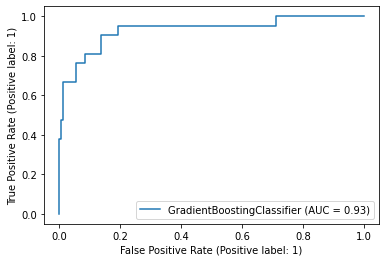

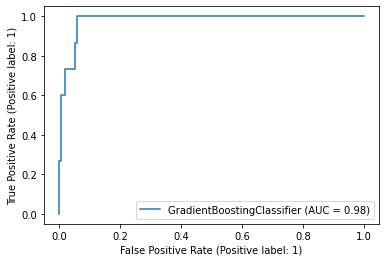

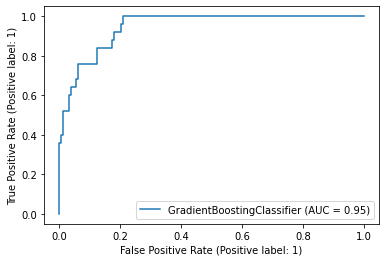

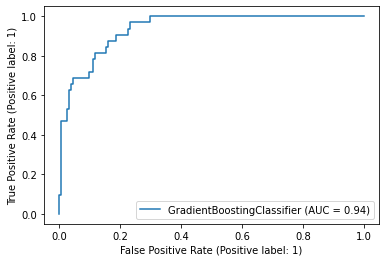

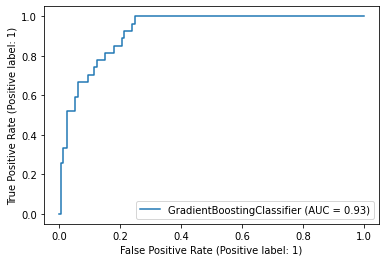

...

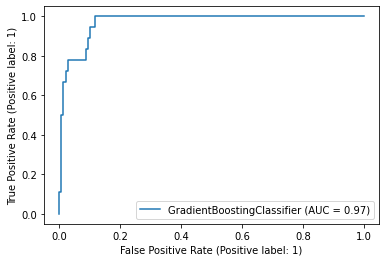

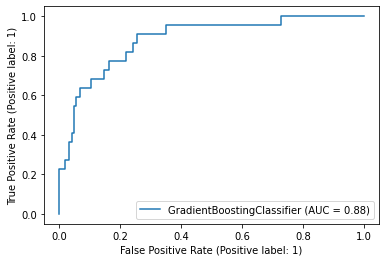

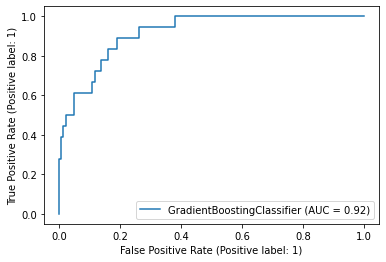

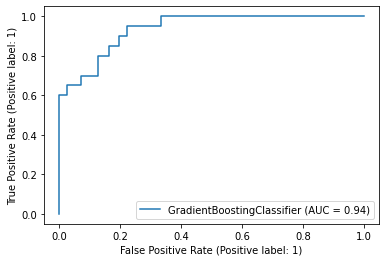

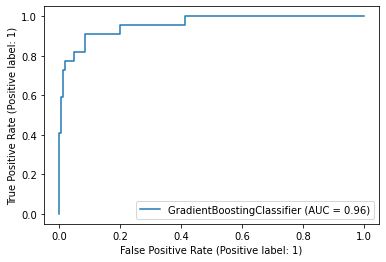

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_gb = GradientBoostingClassifier(n_estimators = 1000) 
    tic = time.time()
    model_gb.fit(X_train, y_train) 
    toc = time.time()
    print("Gradient Boost Train time = " + str(toc-tic))
    print("Gradient Boost Accuracy = "+ str(model_gb.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_gb.predict(X_test)
    yhat_classes = (model_gb.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Gradient Boost Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Gradient Boost Stats _____________________")

    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    CM = confusion_matrix(y_test, yhat_classes)
    print(CM)
    TN = CM[0][0]
    FN = CM[1][0]
    TP = CM[1][1]
    FP = CM[0][1]
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)

    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)
    # ROC AUC
    auc = roc_auc_score(y_test, yhat_probs)
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    #AUC
    from sklearn.metrics import plot_roc_curve
    plot_roc_curve(model_gb, X_test, y_test)

    print("____________________________________________________________")
    print("____________________________________________________________")

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
GBWithoutSMOTE = pd.DataFrame(data, columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([GBWithoutSMOTE.mean(axis=0).values],  columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User Left Out  Accuracy   ROC_AUC        F1  Precision       TPR  \
Average           15.5  0.914082  0.747159  0.568567   0.714671  0.528859   

              FPR         TP     TN        FP    FN  
Average  0.034541  11.533333  159.4  5.666667  10.4  


In [ ]:
GBWithoutSMOTE = GBWithoutSMOTE.append(df_temp)

In [ ]:
print(GBWithoutSMOTE)
GBWithoutSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/GBWithoutSMOTE.csv', index = True)

         User Left Out  Accuracy   ROC_AUC        F1  Precision       TPR  \
0                  1.0  0.930481  0.815261  0.682927   0.700000  0.666667   
1                  2.0  0.946524  0.970930  0.750000   0.600000  1.000000   
2                  3.0  0.903743  0.842963  0.678571   0.612903  0.760000   
3                  4.0  0.887701  0.721472  0.588235   0.789474  0.468750   
4                  5.0  0.866310  0.798727  0.603175   0.527778  0.703704   
5                  6.0  0.914439  0.718985  0.529412   0.600000  0.473684   
6                  7.0  0.925134  0.807794  0.681818   0.714286  0.652174   
7                  8.0  0.903743  0.675416  0.470588   0.615385  0.380952   
8                  9.0  0.909091  0.744568  0.604651   0.722222  0.520000   
9                 10.0  0.930481  0.681234  0.518519   0.875000  0.368421   
10                11.0  0.919786  0.659091  0.482759   1.000000  0.318182   
11                12.0  0.935829  0.666667  0.500000   1.000000  0.333333   

###3 DNN

#### Model

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
print(X_train.shape[1])

15


Epoch 1/100
77/77 [==============================] - 1s 6ms/step - loss: 0.5799 - accuracy: 0.7844 - val_loss: 0.2734 - val_accuracy: 0.8840 - lr: 0.0010
Epoch 2/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3801 - accuracy: 0.8617 - val_loss: 0.2528 - val_accuracy: 0.8913 - lr: 0.0010
Epoch 3/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3432 - accuracy: 0.8809 - val_loss: 0.2453 - val_accuracy: 0.8932 - lr: 0.0010
Epoch 4/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3167 - accuracy: 0.8861 - val_loss: 0.2452 - val_accuracy: 0.8950 - lr: 0.0010
Epoch 5/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3060 - accuracy: 0.8898 - val_loss: 0.2512 - val_accuracy: 0.8969 - lr: 0.0010
Epoch 6/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2899 - accuracy: 0.8900 - val_loss: 0.2414 - val_accuracy: 0.8969 - lr: 0.0010
Epoch 7/100
77/77 [==============================] - 0s 4ms/step - loss: 0.2

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


77/77 [==============================] - 1s 6ms/step - loss: 0.6445 - accuracy: 0.6000 - val_loss: 0.3274 - val_accuracy: 0.8840 - lr: 0.0010
Epoch 2/100
77/77 [==============================] - 0s 4ms/step - loss: 0.4529 - accuracy: 0.8254 - val_loss: 0.2683 - val_accuracy: 0.8858 - lr: 0.0010
Epoch 3/100
77/77 [==============================] - 0s 3ms/step - loss: 0.4045 - accuracy: 0.8752 - val_loss: 0.2563 - val_accuracy: 0.8858 - lr: 0.0010
Epoch 4/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3844 - accuracy: 0.8836 - val_loss: 0.2482 - val_accuracy: 0.8932 - lr: 0.0010
Epoch 5/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3259 - accuracy: 0.8990 - val_loss: 0.2406 - val_accuracy: 0.9116 - lr: 0.0010
Epoch 6/100
77/77 [==============================] - 0s 4ms/step - loss: 0.2876 - accuracy: 0.9035 - val_loss: 0.2413 - val_accuracy: 0.9153 - lr: 0.0010
Epoch 7/100
77/77 [==============================] - 0s 4ms/step - loss: 0.2823 - accura

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


77/77 [==============================] - 1s 5ms/step - loss: 0.5348 - accuracy: 0.8387 - val_loss: 0.3045 - val_accuracy: 0.8858 - lr: 0.0010
Epoch 2/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3776 - accuracy: 0.8795 - val_loss: 0.2655 - val_accuracy: 0.8895 - lr: 0.0010
Epoch 3/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3383 - accuracy: 0.8836 - val_loss: 0.2543 - val_accuracy: 0.8895 - lr: 0.0010
Epoch 4/100
77/77 [==============================] - 0s 4ms/step - loss: 0.3172 - accuracy: 0.8916 - val_loss: 0.2484 - val_accuracy: 0.8932 - lr: 0.0010
Epoch 5/100
77/77 [==============================] - 0s 4ms/step - loss: 0.2902 - accuracy: 0.8914 - val_loss: 0.2294 - val_accuracy: 0.9171 - lr: 0.0010
Epoch 6/100
77/77 [==============================] - 0s 4ms/step - loss: 0.2773 - accuracy: 0.8951 - val_loss: 0.2315 - val_accuracy: 0.9134 - lr: 0.0010
Epoch 7/100
77/77 [==============================] - 0s 4ms/step - loss: 0.2705 - accura

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


77/77 [==============================] - 1s 5ms/step - loss: 0.4834 - accuracy: 0.8125 - val_loss: 0.2916 - val_accuracy: 0.8821 - lr: 0.0010
Epoch 2/100
77/77 [==============================] - 0s 4ms/step - loss: 0.3468 - accuracy: 0.8791 - val_loss: 0.2598 - val_accuracy: 0.8821 - lr: 0.0010
Epoch 3/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3225 - accuracy: 0.8850 - val_loss: 0.2525 - val_accuracy: 0.8913 - lr: 0.0010
Epoch 4/100
77/77 [==============================] - 0s 4ms/step - loss: 0.3019 - accuracy: 0.8898 - val_loss: 0.2439 - val_accuracy: 0.9116 - lr: 0.0010
Epoch 5/100
77/77 [==============================] - 0s 4ms/step - loss: 0.2854 - accuracy: 0.8977 - val_loss: 0.2429 - val_accuracy: 0.9079 - lr: 0.0010
Epoch 6/100
77/77 [==============================] - 0s 4ms/step - loss: 0.2631 - accuracy: 0.9066 - val_loss: 0.2439 - val_accuracy: 0.9171 - lr: 0.0010
Epoch 7/100
77/77 [==============================] - 0s 4ms/step - loss: 0.2587 - accura

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


77/77 [==============================] - 1s 5ms/step - loss: 0.5681 - accuracy: 0.7961 - val_loss: 0.3299 - val_accuracy: 0.8877 - lr: 0.0010
Epoch 2/100
77/77 [==============================] - 0s 4ms/step - loss: 0.4039 - accuracy: 0.8674 - val_loss: 0.2951 - val_accuracy: 0.8840 - lr: 0.0010
Epoch 3/100
77/77 [==============================] - 0s 4ms/step - loss: 0.3626 - accuracy: 0.8805 - val_loss: 0.2792 - val_accuracy: 0.8877 - lr: 0.0010
Epoch 4/100
77/77 [==============================] - 0s 4ms/step - loss: 0.3368 - accuracy: 0.8857 - val_loss: 0.2551 - val_accuracy: 0.9042 - lr: 0.0010
Epoch 5/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3298 - accuracy: 0.8916 - val_loss: 0.2671 - val_accuracy: 0.9042 - lr: 0.0010
Epoch 6/100
77/77 [==============================] - 0s 4ms/step - loss: 0.2983 - accuracy: 0.8986 - val_loss: 0.2589 - val_accuracy: 0.9134 - lr: 0.0010
Epoch 7/100
77/77 [==============================] - 0s 4ms/step - loss: 0.2677 - accura

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


77/77 [==============================] - 1s 5ms/step - loss: 0.5238 - accuracy: 0.8234 - val_loss: 0.3259 - val_accuracy: 0.8840 - lr: 0.0010
Epoch 2/100
77/77 [==============================] - 0s 4ms/step - loss: 0.3833 - accuracy: 0.8791 - val_loss: 0.2817 - val_accuracy: 0.8877 - lr: 0.0010
Epoch 3/100
77/77 [==============================] - 0s 4ms/step - loss: 0.3546 - accuracy: 0.8850 - val_loss: 0.2727 - val_accuracy: 0.9024 - lr: 0.0010
Epoch 4/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3222 - accuracy: 0.8973 - val_loss: 0.2759 - val_accuracy: 0.9116 - lr: 0.0010
Epoch 5/100
77/77 [==============================] - 0s 4ms/step - loss: 0.3026 - accuracy: 0.9000 - val_loss: 0.2468 - val_accuracy: 0.9116 - lr: 0.0010
Epoch 6/100
77/77 [==============================] - 0s 4ms/step - loss: 0.2865 - accuracy: 0.9014 - val_loss: 0.2429 - val_accuracy: 0.9134 - lr: 0.0010
Epoch 7/100
77/77 [==============================] - 0s 4ms/step - loss: 0.2887 - accura

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


77/77 [==============================] - 1s 5ms/step - loss: 0.5316 - accuracy: 0.7654 - val_loss: 0.3090 - val_accuracy: 0.8858 - lr: 0.0010
Epoch 2/100
77/77 [==============================] - 0s 4ms/step - loss: 0.4164 - accuracy: 0.8480 - val_loss: 0.2799 - val_accuracy: 0.8858 - lr: 0.0010
Epoch 3/100
77/77 [==============================] - 0s 4ms/step - loss: 0.3635 - accuracy: 0.8738 - val_loss: 0.2680 - val_accuracy: 0.8858 - lr: 0.0010
Epoch 4/100
77/77 [==============================] - 0s 4ms/step - loss: 0.3446 - accuracy: 0.8805 - val_loss: 0.2461 - val_accuracy: 0.8858 - lr: 0.0010
Epoch 5/100
77/77 [==============================] - 0s 5ms/step - loss: 0.3159 - accuracy: 0.8811 - val_loss: 0.2627 - val_accuracy: 0.8858 - lr: 0.0010
Epoch 6/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3059 - accuracy: 0.8840 - val_loss: 0.2509 - val_accuracy: 0.8858 - lr: 0.0010
Epoch 7/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2999 - accura

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


77/77 [==============================] - 1s 5ms/step - loss: 0.4723 - accuracy: 0.8350 - val_loss: 0.3065 - val_accuracy: 0.8877 - lr: 0.0010
Epoch 2/100
77/77 [==============================] - 0s 4ms/step - loss: 0.3849 - accuracy: 0.8732 - val_loss: 0.2817 - val_accuracy: 0.8877 - lr: 0.0010
Epoch 3/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3446 - accuracy: 0.8799 - val_loss: 0.2341 - val_accuracy: 0.8877 - lr: 0.0010
Epoch 4/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3198 - accuracy: 0.8826 - val_loss: 0.2240 - val_accuracy: 0.8913 - lr: 0.0010
Epoch 5/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3071 - accuracy: 0.8863 - val_loss: 0.2156 - val_accuracy: 0.8987 - lr: 0.0010
Epoch 6/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2955 - accuracy: 0.8898 - val_loss: 0.2103 - val_accuracy: 0.9171 - lr: 0.0010
Epoch 7/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2874 - accura

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


77/77 [==============================] - 1s 5ms/step - loss: 0.5303 - accuracy: 0.8535 - val_loss: 0.3232 - val_accuracy: 0.8840 - lr: 0.0010
Epoch 2/100
77/77 [==============================] - 0s 3ms/step - loss: 0.4125 - accuracy: 0.8727 - val_loss: 0.3061 - val_accuracy: 0.8858 - lr: 0.0010
Epoch 3/100
77/77 [==============================] - 0s 4ms/step - loss: 0.3678 - accuracy: 0.8779 - val_loss: 0.2663 - val_accuracy: 0.8895 - lr: 0.0010
Epoch 4/100
77/77 [==============================] - 0s 4ms/step - loss: 0.3524 - accuracy: 0.8795 - val_loss: 0.2440 - val_accuracy: 0.8913 - lr: 0.0010
Epoch 5/100
77/77 [==============================] - 0s 4ms/step - loss: 0.3286 - accuracy: 0.8832 - val_loss: 0.2383 - val_accuracy: 0.8913 - lr: 0.0010
Epoch 6/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3015 - accuracy: 0.8832 - val_loss: 0.2362 - val_accuracy: 0.8913 - lr: 0.0010
Epoch 7/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2996 - accura

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


77/77 [==============================] - 1s 5ms/step - loss: 0.4730 - accuracy: 0.8664 - val_loss: 0.3273 - val_accuracy: 0.8895 - lr: 0.0010
Epoch 2/100
77/77 [==============================] - 0s 4ms/step - loss: 0.3717 - accuracy: 0.8822 - val_loss: 0.2539 - val_accuracy: 0.9116 - lr: 0.0010
Epoch 3/100
77/77 [==============================] - 0s 4ms/step - loss: 0.3239 - accuracy: 0.8881 - val_loss: 0.2555 - val_accuracy: 0.9153 - lr: 0.0010
Epoch 4/100
77/77 [==============================] - 0s 4ms/step - loss: 0.3089 - accuracy: 0.8947 - val_loss: 0.2532 - val_accuracy: 0.9208 - lr: 0.0010
Epoch 5/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2841 - accuracy: 0.8986 - val_loss: 0.2532 - val_accuracy: 0.9245 - lr: 0.0010
Epoch 6/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2782 - accuracy: 0.9012 - val_loss: 0.2510 - val_accuracy: 0.9153 - lr: 0.0010
Epoch 7/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2701 - accura

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


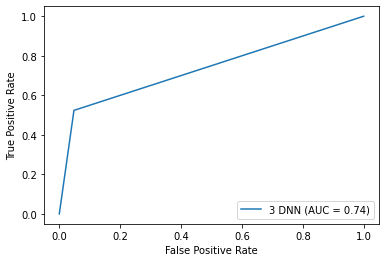

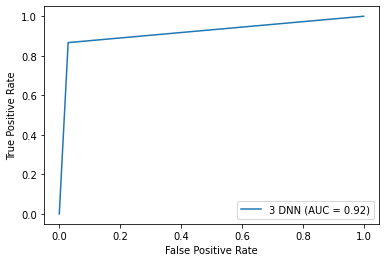

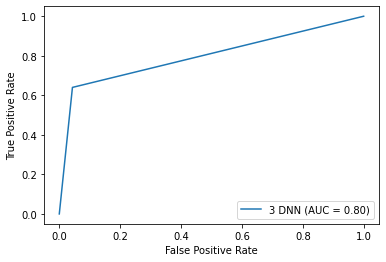

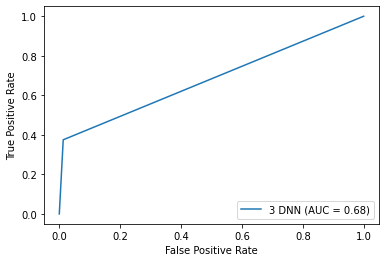

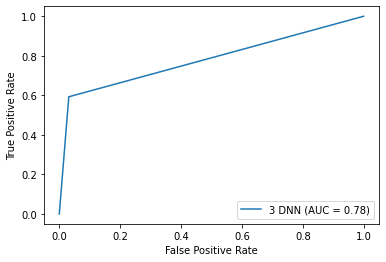

...

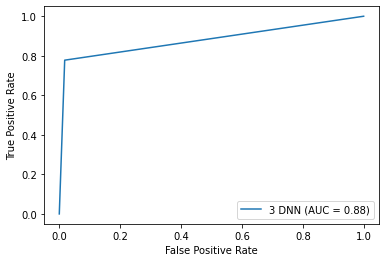

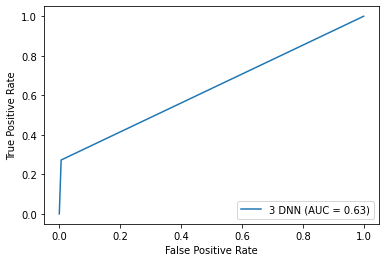

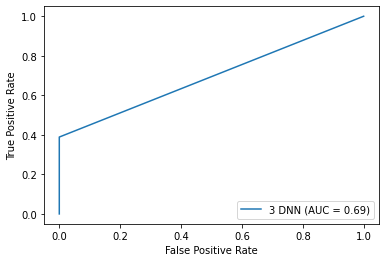

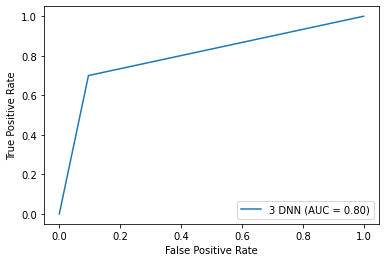

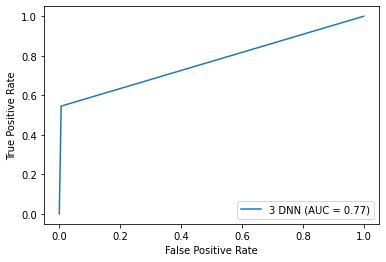

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    X_train = np.asarray(X_train).astype('float32')
    y_train = np.asarray(y_train).astype('float32')
    X_test = np.asarray(X_test).astype('float32')
    y_test = np.asarray(y_test).astype('float32')
    model3 = Sequential()

    model3.add(Dense(64, activation='relu', input_shape=(X_train.shape[1],)))
    model3.add(Dropout(0.3))
    model3.add(Dense(32, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(8, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(1, activation='sigmoid'))

    model3.compile(loss='binary_crossentropy',
                  optimizer='adam',
                  metrics=['accuracy'])
    reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=0.001)
    tic = time.time()
    model3.fit(X_train, y_train, batch_size=64, epochs=100, validation_split=0.1, callbacks=[reduce_lr])
    toc = time.time()
    print("3 DNN Train time = " + str(toc-tic))
    print("3 DNN Accuracy = "+ str(model3.evaluate(X_test, y_test, verbose=0)[1]))
    tic = time.time()
    yhat_probs = model3.predict(X_test, verbose=0)
    yhat_classes = (model3.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("3 DNN Test time = " + str(toc-tic))
    yhat_probs = yhat_probs[:, 0]
    yhat_classes = yhat_classes[:, 0]
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________3 DNN Stats _____________________")

    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    CM = confusion_matrix(y_test, yhat_classes)
    print(CM)
    TN = CM[0][0]
    FN = CM[1][0]
    TP = CM[1][1]
    FP = CM[0][1]
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    auc = roc_auc_score(y_test, yhat_probs)
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    #AUC
    from sklearn import metrics
    fpr, tpr, thresholds = metrics.roc_curve(y_test, yhat_classes)
    roc_auc = metrics.auc(fpr, tpr)
    display = metrics.RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc, estimator_name='3 DNN')
    display.plot()  

    print("____________________________________________________________")
    print("____________________________________________________________")

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
DNN3WithoutSMOTE = pd.DataFrame(data, columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DNN3WithoutSMOTE.mean(axis=0).values],  columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User Left Out  Accuracy   ROC_AUC        F1  Precision      TPR  \
Average           15.5   0.91533  0.928538  0.519659   0.803026  0.43862   

              FPR   TP          TN   FP         FN  
Average  0.020751  9.5  161.666667  3.4  12.433333  


In [ ]:
DNN3WithoutSMOTE = DNN3WithoutSMOTE.append(df_temp)

In [ ]:
print(DNN3WithoutSMOTE)
DNN3WithoutSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/DNN3WithoutSMOTE.csv', index = True)

         User Left Out  Accuracy   ROC_AUC        F1  Precision       TPR  \
0                  1.0  0.903743  0.874928  0.550000   0.578947  0.523810   
1                  2.0  0.962567  0.993798  0.787879   0.722222  0.866667   
2                  3.0  0.914439  0.965679  0.666667   0.695652  0.640000   
3                  4.0  0.882353  0.961895  0.521739   0.857143  0.375000   
4                  5.0  0.914439  0.945139  0.666667   0.761905  0.592593   
5                  6.0  0.925134  0.952381  0.500000   0.777778  0.368421   
6                  7.0  0.951872  0.968187  0.780488   0.888889  0.695652   
7                  8.0  0.914439  0.927998  0.466667   0.777778  0.333333   
8                  9.0  0.930481  0.936790  0.666667   0.928571  0.520000   
9                 10.0  0.903743  0.899749  0.250000   0.600000  0.157895   
10                11.0  0.903743  0.938017  0.357143   0.833333  0.227273   
11                12.0  0.935829  0.943458  0.500000   1.000000  0.333333   

# With SMOTE


## Data Processing

### Import dataset

In [ ]:
directory_all = "/content/drive/MyDrive/Surjya Sir Work/5000"
directory_pbd = "/content/drive/MyDrive/Surjya Sir Work/5000_probed"

In [ ]:
# videos = [1,2,3,4,5,6,7,8]
videos = [1,2,3,4,7,8]

In [ ]:
all = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_all + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    all.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


In [ ]:
probed = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_pbd + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    probed.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


### Create df

In [ ]:
df = pd.DataFrame()
for i in range(len(all)):#per video = 8
  for j in range(len(all[i])): #per subject = 30
    df = df.append(all[i][j], ignore_index=True)

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8
5606,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8
5607,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8
5608,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8


In [ ]:
tester = pd.DataFrame()
for i in range(len(probed)):#per video = 8
  for j in range(len(probed[i])): #per subject = 30
    tester = tester.append(probed[i][j], ignore_index=True)

In [ ]:
tester

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1738876.01,1743876.01,1748876.01,6.309,5.096,0.013,0.106,5.632759,0.600,0.378,0.155,0.010,0.369,1.642,8.131,10,1
1,832168.01,837168.01,842168.01,6.488,5.290,0.012,0.159,1.883567,0.300,3.623,0.126,0.021,0.657,0.246,0.000,11,1
2,907168.01,912168.01,917168.01,5.330,4.958,0.394,0.082,3.340205,0.103,3.119,0.136,0.004,7.022,0.699,0.123,11,1
3,917168.01,922168.01,927168.01,6.046,5.011,0.767,0.003,2.078420,0.213,0.785,0.136,0.007,4.846,0.041,0.040,11,1
4,922168.01,927168.01,932168.01,6.476,5.014,0.430,0.022,2.208317,0.307,4.601,0.068,0.010,4.148,1.191,0.288,11,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
653,2282834.01,2287834.01,2292834.01,2.090,7.542,0.918,0.586,3.800016,3.170,4.349,0.261,0.003,0.082,2.916,1.602,8,8
654,2287834.01,2292834.01,2297834.01,1.199,8.115,1.181,0.661,5.052202,4.889,8.049,1.549,0.039,0.164,1.315,2.587,8,8
655,1166459.01,1171459.01,1176459.01,3.156,6.595,0.518,0.543,4.114055,0.256,0.368,4.792,0.011,2.998,3.368,13.429,9,8
656,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8


In [ ]:
temp = df[df.isin(tester)].dropna()

In [ ]:
temp = df.loc[df.set_index(list(df.columns)).index.isin(tester.set_index(list(tester.columns)).index)]

In [ ]:
temp.index

Int64Index([  35,   47,   62,   64,   65,   70,   99,  107,  117,  118,
            ...
            5511, 5532, 5551, 5554, 5559, 5575, 5576, 5604, 5605, 5606],
           dtype='int64', length=658)

In [ ]:
df['Probe'] = 0

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,0
5606,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,0
5607,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
5608,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
for idx in temp.index:
  df.at[idx, 'Probe'] = 1

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
5606,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
5607,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
5608,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


### Optimise df

In [ ]:
df = df.drop(columns=["Start", "Border", "End"], axis=1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
5606,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
5607,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
5608,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
df['valence_acc_video'] = 0
df['arousal_acc_video'] = 0

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,0,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,0,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,0,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,0,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,0
5606,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,0
5607,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,0
5608,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,0


I'm using the following encoding: 

1 - Low
2 - Mid/high
3 - High

In [ ]:
# def basedOnVideoValence(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 2
#     if int(video) == 6:
#         return 2
#     if int(video) == 7:
#         return 1
#     if int(video) == 8:
#         return 1
    
# def basedOnVideoArousal(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 1
#     if int(video) == 6:
#         return 1
#     if int(video) == 7:
#         return 3
#     if int(video) == 8:
#         return 3

New encoding, 
Low - 0 
Med / High - 1

In [ ]:
def basedOnVideoValence(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 1
    if int(video) == 6:
        return 1
    if int(video) == 7:
        return 0
    if int(video) == 8:
        return 0
    
def basedOnVideoArousal(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 0
    if int(video) == 6:
        return 0
    if int(video) == 7:
        return 1
    if int(video) == 8:
        return 1

In [ ]:
df['valence_acc_video'] = df.apply(lambda row : basedOnVideoValence(row['video']), axis = 1)
df['arousal_acc_video'] = df.apply(lambda row : basedOnVideoArousal(row['video']), axis = 1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1
5606,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1
5607,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1
5608,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1


### Create X,y

In [ ]:
#df

In [ ]:
# X_train = pd.DataFrame()
# y_train = pd.DataFrame()
# X_test = pd.DataFrame()
# y_test = pd.DataFrame()

In [ ]:
# for video in videos:
#     df_selected = df[df['video'] == video]
#     y = df_selected['Probe']
#     y = pd.DataFrame(y)
#     X = df_selected.drop(columns=["Probe"], axis = 1)
#     X_train_new, X_test_new, y_train_new, y_test_new = train_test_split(X, y, test_size=0.2, random_state=42)
#     X_train = X_train.append(X_train_new, ignore_index=True)
#     y_train = y_train.append(y_train_new, ignore_index=True)
#     X_test = X_test.append(X_test_new, ignore_index=True)
#     y_test = y_test.append(y_test_new, ignore_index=True)

In [ ]:
# X_train

In [ ]:
# y_test

In [ ]:
# X_train = X_train.drop(columns=['video', 'subject'])
# X_test = X_test.drop(columns=['video', 'subject'])

In [ ]:
# X_train

### X,y using leave 1 use rest

In [ ]:
X_train_all = []
y_train_all = []
X_test_all = []
y_test_all = []

In [ ]:
users = []
for i in range(1, 31):
  users.append(i)

print(users)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30]


In [ ]:
for testuser in users:
  X_train = pd.DataFrame()
  y_train = pd.DataFrame()
  X_test = pd.DataFrame()
  y_test = pd.DataFrame()
  df_new = df[df['subject'] != str(testuser)]
  for video in videos:
    df_selected = df_new[df_new['video'] == video]
    y = df_selected['Probe']
    y = pd.DataFrame(y)
    X = df_selected.drop(columns=["Probe"], axis = 1)
    X_train = X_train.append(X, ignore_index=True)
    y_train = y_train.append(y, ignore_index=True)
  df_new = df[df['subject'] == str(testuser)]
  # print(df_new)
  for video in videos:
    df_selected = df_new[df_new['video'] == video]
    y = df_selected['Probe']
    y = pd.DataFrame(y)
    X = df_selected.drop(columns=["Probe"], axis = 1)
    X_test = X_test.append(X, ignore_index=True)
    y_test = y_test.append(y, ignore_index=True)  
  X_train_all.append(X_train)
  y_train_all.append(y_train)
  X_test_all.append(X_test)
  y_test_all.append(y_test)

In [ ]:
print(len(X_train_all[29]['subject'].unique()))

29


In [ ]:
new_X_train_all = []

for i in range(len(X_train_all)):
    df_temp = X_train_all[i]
    #df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    df_temp = df_temp.drop(columns=["subject"], axis = 1)
    new_X_train_all.append(df_temp)

X_train_all = new_X_train_all

new_X_test_all = []

for i in range(len(X_test_all)):
    df_temp = X_test_all[i]
    #df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    df_temp = df_temp.drop(columns=["subject"], axis = 1)
    new_X_test_all.append(df_temp)

X_test_all = new_X_test_all

In [ ]:
y_test_all[7]

,Probe
0,0
1,0
2,0
3,0
4,0
...,...
182,0
183,0
184,0
185,0


### SMOTE

In [ ]:
print(X_train_all[0])

      Valence  Arousal  ...  valence_acc_video  arousal_acc_video
0       5.000    5.000  ...                  1                  1
1       5.000    5.209  ...                  1                  1
2       4.824    6.102  ...                  1                  1
3       4.870    6.170  ...                  1                  1
4       4.870    6.170  ...                  1                  1
...       ...      ...  ...                ...                ...
5418    2.857    7.183  ...                  0                  1
5419    2.931    7.571  ...                  0                  1
5420    2.849    6.989  ...                  0                  1
5421    2.668    6.732  ...                  0                  1
5422    2.541    7.043  ...                  0                  1

[5423 rows x 15 columns]


In [ ]:
from imblearn.over_sampling import SMOTE
new_X_train_all = []
new_y_train_all = []

for i in range(len(X_train_all)):
  X_resampled, y_resampled = SMOTE('auto').fit_resample(X_train_all[i], y_train_all[i])
  new_X_train_all.append(X_resampled)
  new_y_train_all.append(y_resampled)

X_train_all = new_X_train_all
y_train_all = new_y_train_all

# new_X_test_all = []
# new_y_test_all = []

# for i in range(len(X_train_all)):
#   X_resampled, y_resampled = SMOTE('minority').fit_resample(X_test_all[i], y_test_all[i])
#   new_X_test_all.append(X_resampled)
#   new_y_test_all.append(y_resampled)

# X_test_all = new_X_test_all
# y_test_all = new_y_test_all

/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: Future

In [ ]:
print(X_train_all[0])

       Valence   Arousal  ...  valence_acc_video  arousal_acc_video
0     5.000000  5.000000  ...                  1                  1
1     5.000000  5.209000  ...                  1                  1
2     4.824000  6.102000  ...                  1                  1
3     4.870000  6.170000  ...                  1                  1
4     4.870000  6.170000  ...                  1                  1
...        ...       ...  ...                ...                ...
9567  7.257971  6.913476  ...                  1                  1
9568  5.040310  3.753000  ...                  0                  0
9569  6.505918  5.399209  ...                  0                  1
9570  3.887428  7.284366  ...                  0                  1
9571  6.434358  5.200232  ...                  1                  1

[9572 rows x 15 columns]


### Condensed Nearest Neighbours

In [ ]:
print(X_train_all[0])

       Valence   Arousal  ...  valence_acc_video  arousal_acc_video
0     5.000000  5.000000  ...                  1                  1
1     5.000000  5.209000  ...                  1                  1
2     4.824000  6.102000  ...                  1                  1
3     4.870000  6.170000  ...                  1                  1
4     4.870000  6.170000  ...                  1                  1
...        ...       ...  ...                ...                ...
9567  7.257971  6.913476  ...                  1                  1
9568  5.040310  3.753000  ...                  0                  0
9569  6.505918  5.399209  ...                  0                  1
9570  3.887428  7.284366  ...                  0                  1
9571  6.434358  5.200232  ...                  1                  1

[9572 rows x 15 columns]


In [ ]:
# from imblearn.under_sampling import CondensedNearestNeighbour
# new_X_train_all = []
# new_y_train_all = []

# for i in range(len(X_train_all)):
#   X_resampled, y_resampled = CondensedNearestNeighbour('auto').fit_resample(X_train_all[i], y_train_all[i])
#   new_X_train_all.append(X_resampled)
#   new_y_train_all.append(y_resampled)

# X_train_all = new_X_train_all
# y_train_all = new_y_train_all


In [ ]:
print(X_train_all[0])

       Valence   Arousal  ...  valence_acc_video  arousal_acc_video
0     5.000000  5.000000  ...                  1                  1
1     5.000000  5.209000  ...                  1                  1
2     4.824000  6.102000  ...                  1                  1
3     4.870000  6.170000  ...                  1                  1
4     4.870000  6.170000  ...                  1                  1
...        ...       ...  ...                ...                ...
9567  7.257971  6.913476  ...                  1                  1
9568  5.040310  3.753000  ...                  0                  0
9569  6.505918  5.399209  ...                  0                  1
9570  3.887428  7.284366  ...                  0                  1
9571  6.434358  5.200232  ...                  1                  1

[9572 rows x 15 columns]


## Models

###RandomForest

#### Model

In [ ]:
from sklearn.ensemble import RandomForestClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []

TPs = []
FPs = []
FNs = []
TNs = []

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.343804359436035
Random Forest Accuracy = 0.93048128342246
Random Forest Test time = 0.03898262977600098
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.930481
[[161   5]
 [  8  13]]
True negatives: 161
True positives: 13
False positives: 5
False negatives: 8
ROC AUC: 0.794464
F1 Score: 0.666667
Precision: 0.722222
TPR: 0.619048
FPR: 0.030120
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.3232614994049072
Random Forest Accuracy = 0.93048128342246
Random Forest Test time = 0.03842020034790039
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.930481
[[160  12]
 [  1  14]]
True negatives: 160
True positives: 14
False positives: 12
False negatives: 1
ROC AUC: 0.931783
F1 Score: 0.682927
Precision: 0.538462
TPR: 0.933333
FPR: 0.069767
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.3110318183898926
Random Forest Accuracy = 0.8556149732620321
Random Forest Test time = 0.04393792152404785
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.855615
[[140  22]
 [  5  20]]
True negatives: 140
True positives: 20
False positives: 22
False negatives: 5
ROC AUC: 0.832099
F1 Score: 0.597015
Precision: 0.476190
TPR: 0.800000
FPR: 0.135802
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.3410632610321045
Random Forest Accuracy = 0.9197860962566845
Random Forest Test time = 0.043788909912109375
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.919786
[[145  10]
 [  5  27]]
True negatives: 145
True positives: 27
False positives: 10
False negatives: 5
ROC AUC: 0.889617
F1 Score: 0.782609
Precision: 0.729730
TPR: 0.843750
FPR: 0.064516
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.3078086376190186
Random Forest Accuracy = 0.8823529411764706
Random Forest Test time = 0.03605222702026367
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.882353
[[147  13]
 [  9  18]]
True negatives: 147
True positives: 18
False positives: 13
False negatives: 9
ROC AUC: 0.792708
F1 Score: 0.620690
Precision: 0.580645
TPR: 0.666667
FPR: 0.081250
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.3187224864959717
Random Forest Accuracy = 0.9197860962566845
Random Forest Test time = 0.03610968589782715
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.919786
[[158  10]
 [  5  14]]
True negatives: 158
True positives: 14
False positives: 10
False negatives: 5
ROC AUC: 0.838659
F1 Score: 0.651163
Precision: 0.583333
TPR: 0.736842
FPR: 0.059524
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.2904744148254395
Random Forest Accuracy = 0.9037433155080213
Random Forest Test time = 0.04175448417663574
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.903743
[[149  15]
 [  3  20]]
True negatives: 149
True positives: 20
False positives: 15
False negatives: 3
ROC AUC: 0.889051
F1 Score: 0.689655
Precision: 0.571429
TPR: 0.869565
FPR: 0.091463
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.2567381858825684
Random Forest Accuracy = 0.9037433155080213
Random Forest Test time = 0.04331636428833008
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.903743
[[157   9]
 [  9  12]]
True negatives: 157
True positives: 12
False positives: 9
False negatives: 9
ROC AUC: 0.758606
F1 Score: 0.571429
Precision: 0.571429
TPR: 0.571429
FPR: 0.054217
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.307326555252075
Random Forest Accuracy = 0.893048128342246
Random Forest Test time = 0.038877248764038086
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.893048
[[147  15]
 [  5  20]]
True negatives: 147
True positives: 20
False positives: 15
False negatives: 5
ROC AUC: 0.853704
F1 Score: 0.666667
Precision: 0.571429
TPR: 0.800000
FPR: 0.092593
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.2912423610687256
Random Forest Accuracy = 0.946524064171123
Random Forest Test time = 0.03348493576049805
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.946524
[[167   1]
 [  9  10]]
True negatives: 167
True positives: 10
False positives: 1
False negatives: 9
ROC AUC: 0.760182
F1 Score: 0.666667
Precision: 0.909091
TPR: 0.526316
FPR: 0.005952
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.2531044483184814
Random Forest Accuracy = 0.893048128342246
Random Forest Test time = 0.035036325454711914
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.893048
[[158   7]
 [ 13   9]]
True negatives: 158
True positives: 9
False positives: 7
False negatives: 13
ROC AUC: 0.683333
F1 Score: 0.473684
Precision: 0.562500
TPR: 0.409091
FPR: 0.042424
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.29663348197937
Random Forest Accuracy = 0.9251336898395722
Random Forest Test time = 0.033217668533325195
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.925134
[[167   2]
 [ 12   6]]
True negatives: 167
True positives: 6
False positives: 2
False negatives: 12
ROC AUC: 0.660750
F1 Score: 0.461538
Precision: 0.750000
TPR: 0.333333
FPR: 0.011834
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.287362813949585
Random Forest Accuracy = 0.8770053475935828
Random Forest Test time = 0.04446101188659668
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.877005
[[149  16]
 [  7  15]]
True negatives: 149
True positives: 15
False positives: 16
False negatives: 7
ROC AUC: 0.792424
F1 Score: 0.566038
Precision: 0.483871
TPR: 0.681818
FPR: 0.096970
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.3044896125793457
Random Forest Accuracy = 0.9037433155080213
Random Forest Test time = 0.036715030670166016
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.903743
[[156  13]
 [  5  13]]
True negatives: 156
True positives: 13
False positives: 13
False negatives: 5
ROC AUC: 0.822650
F1 Score: 0.590909
Precision: 0.500000
TPR: 0.722222
FPR: 0.076923
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.3272855281829834
Random Forest Accuracy = 0.8716577540106952
Random Forest Test time = 0.04766678810119629
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.871658
[[145  19]
 [  5  18]]
True negatives: 145
True positives: 18
False positives: 19
False negatives: 5
ROC AUC: 0.833378
F1 Score: 0.600000
Precision: 0.486486
TPR: 0.782609
FPR: 0.115854
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.3015077114105225
Random Forest Accuracy = 0.9197860962566845
Random Forest Test time = 0.03475356101989746
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.919786
[[165   2]
 [ 13   7]]
True negatives: 165
True positives: 7
False positives: 2
False negatives: 13
ROC AUC: 0.669012
F1 Score: 0.482759
Precision: 0.777778
TPR: 0.350000
FPR: 0.011976
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.283212661743164
Random Forest Accuracy = 0.9197860962566845
Random Forest Test time = 0.03232979774475098
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.919786
[[164   1]
 [ 14   8]]
True negatives: 164
True positives: 8
False positives: 1
False negatives: 14
ROC AUC: 0.678788
F1 Score: 0.516129
Precision: 0.888889
TPR: 0.363636
FPR: 0.006061
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.2557570934295654
Random Forest Accuracy = 0.946524064171123
Random Forest Test time = 0.040735721588134766
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.946524
[[168   3]
 [  7   9]]
True negatives: 168
True positives: 9
False positives: 3
False negatives: 7
ROC AUC: 0.772478
F1 Score: 0.642857
Precision: 0.750000
TPR: 0.562500
FPR: 0.017544
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.31013560295105
Random Forest Accuracy = 0.7967914438502673
Random Forest Test time = 0.033443450927734375
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.796791
[[134  25]
 [ 13  15]]
True negatives: 134
True positives: 15
False positives: 25
False negatives: 13
ROC AUC: 0.689241
F1 Score: 0.441176
Precision: 0.375000
TPR: 0.535714
FPR: 0.157233
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.264678716659546
Random Forest Accuracy = 0.8556149732620321
Random Forest Test time = 0.038048744201660156
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.855615
[[138  25]
 [  2  22]]
True negatives: 138
True positives: 22
False positives: 25
False negatives: 2
ROC AUC: 0.881646
F1 Score: 0.619718
Precision: 0.468085
TPR: 0.916667
FPR: 0.153374
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.2412118911743164
Random Forest Accuracy = 0.8770053475935828
Random Forest Test time = 0.04429769515991211
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.877005
[[156   5]
 [ 18   8]]
True negatives: 156
True positives: 8
False positives: 5
False negatives: 18
ROC AUC: 0.638318
F1 Score: 0.410256
Precision: 0.615385
TPR: 0.307692
FPR: 0.031056
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.3334929943084717
Random Forest Accuracy = 0.9037433155080213
Random Forest Test time = 0.03519725799560547
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.903743
[[157   9]
 [  9  12]]
True negatives: 157
True positives: 12
False positives: 9
False negatives: 9
ROC AUC: 0.758606
F1 Score: 0.571429
Precision: 0.571429
TPR: 0.571429
FPR: 0.054217
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.291290521621704
Random Forest Accuracy = 0.8877005347593583
Random Forest Test time = 0.0360255241394043
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.887701
[[155   7]
 [ 14  11]]
True negatives: 155
True positives: 11
False positives: 7
False negatives: 14
ROC AUC: 0.698395
F1 Score: 0.511628
Precision: 0.611111
TPR: 0.440000
FPR: 0.043210
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.288337230682373
Random Forest Accuracy = 0.9144385026737968
Random Forest Test time = 0.03450322151184082
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.914439
[[162   3]
 [ 13   9]]
True negatives: 162
True positives: 9
False positives: 3
False negatives: 13
ROC AUC: 0.695455
F1 Score: 0.529412
Precision: 0.750000
TPR: 0.409091
FPR: 0.018182
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.246979236602783
Random Forest Accuracy = 0.8556149732620321
Random Forest Test time = 0.03371858596801758
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.855615
[[153  10]
 [ 17   7]]
True negatives: 153
True positives: 7
False positives: 10
False negatives: 17
ROC AUC: 0.615158
F1 Score: 0.341463
Precision: 0.411765
TPR: 0.291667
FPR: 0.061350
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.285902261734009
Random Forest Accuracy = 0.8983957219251337
Random Forest Test time = 0.035881757736206055
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.898396
[[150  19]
 [  0  18]]
True negatives: 150
True positives: 18
False positives: 19
False negatives: 0
ROC AUC: 0.943787
F1 Score: 0.654545
Precision: 0.486486
TPR: 1.000000
FPR: 0.112426
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.2709224224090576
Random Forest Accuracy = 0.8983957219251337
Random Forest Test time = 0.034232139587402344
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.898396
[[160   5]
 [ 14   8]]
True negatives: 160
True positives: 8
False positives: 5
False negatives: 14
ROC AUC: 0.666667
F1 Score: 0.457143
Precision: 0.615385
TPR: 0.363636
FPR: 0.030303
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.6065425872802734
Random Forest Accuracy = 0.9251336898395722
Random Forest Test time = 0.034338951110839844
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.925134
[[162   7]
 [  7  11]]
True negatives: 162
True positives: 11
False positives: 7
False negatives: 7
ROC AUC: 0.784845
F1 Score: 0.611111
Precision: 0.611111
TPR: 0.611111
FPR: 0.041420
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.300752878189087
Random Forest Accuracy = 0.9090909090909091
Random Forest Test time = 0.036133527755737305
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.909091
[[151  16]
 [  1  19]]
True negatives: 151
True positives: 19
False positives: 16
False negatives: 1
ROC AUC: 0.927096
F1 Score: 0.690909
Precision: 0.542857
TPR: 0.950000
FPR: 0.095808
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.305356979370117
Random Forest Accuracy = 0.9197860962566845
Random Forest Test time = 0.039205312728881836
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.919786
[[153  12]
 [  3  19]]
True negatives: 153
True positives: 19
False positives: 12
False negatives: 3
ROC AUC: 0.895455
F1 Score: 0.716981
Precision: 0.612903
TPR: 0.863636
FPR: 0.072727
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


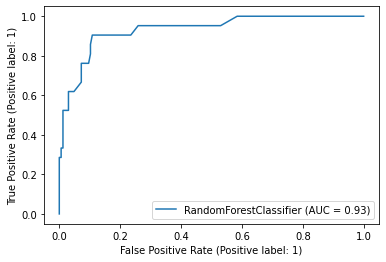

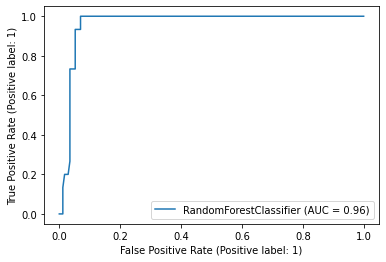

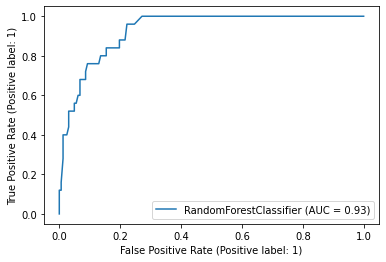

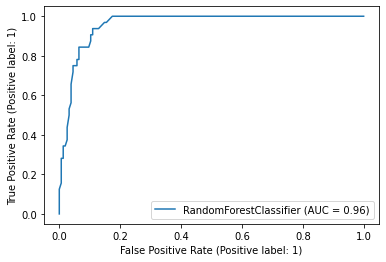

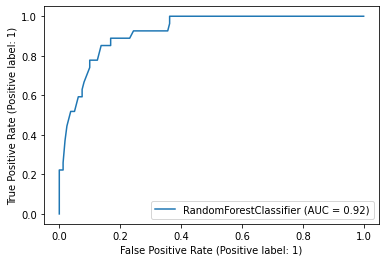

...

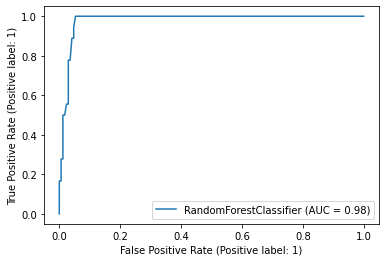

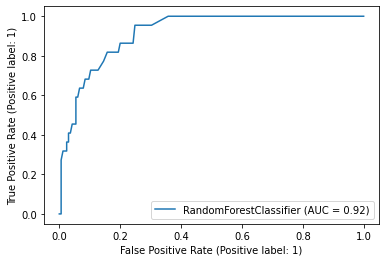

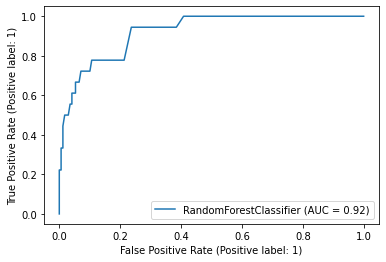

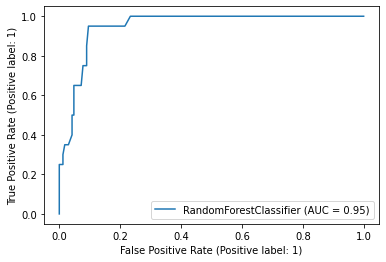

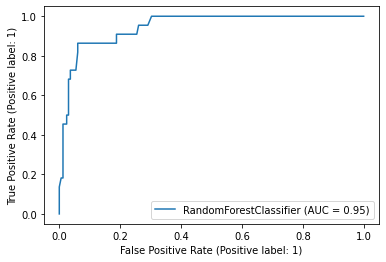

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_rf = RandomForestClassifier() 
    tic = time.time()
    model_rf.fit(X_train, y_train) 
    toc = time.time()
    print("Random Forest Train time = " + str(toc-tic))
    print("Random Forest Accuracy = "+ str(model_rf.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_rf.predict(X_test)
    yhat_classes = (model_rf.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Random Forest Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Random Forest Stats _____________________")

    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    CM = confusion_matrix(y_test, yhat_classes)
    print(CM)
    TN = CM[0][0]
    FN = CM[1][0]
    TP = CM[1][1]
    FP = CM[0][1]
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    auc = roc_auc_score(y_test, yhat_probs)
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    #AUC
    from sklearn.metrics import plot_roc_curve
    plot_roc_curve(model_rf, X_test, y_test)

    print("____________________________________________________________")
    print("____________________________________________________________")

#### Results

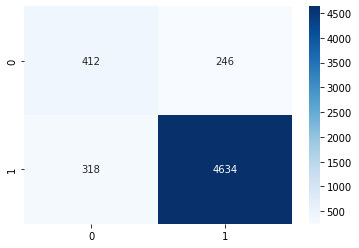

In [ ]:
import seaborn as sns

TPsum = np.sum(TPs)
TNsum = np.sum(TNs)
FPsum = np.sum(FPs)
FNsum = np.sum(FNs)

cm_data = [[TPsum, FNsum], [FPsum, TNsum]]
sns.heatmap(cm_data, annot=True, cmap='Blues', fmt='d')

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
RFWithSMOTE = pd.DataFrame(data, columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([RFWithSMOTE.mean(axis=0).values],  columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User Left Out  Accuracy   ROC_AUC  ...          TN    FP   FN
Average           15.5  0.899465  0.781612  ...  154.466667  10.6  8.2

[1 rows x 11 columns]


In [ ]:
RFWithSMOTE = RFWithSMOTE.append(df_temp)

In [ ]:
print(RFWithSMOTE)
RFWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/RFWithSMOTE.csv', index = True)

         User Left Out  Accuracy   ROC_AUC  ...          TN    FP    FN
0                  1.0  0.930481  0.794464  ...  161.000000   5.0   8.0
1                  2.0  0.930481  0.931783  ...  160.000000  12.0   1.0
2                  3.0  0.855615  0.832099  ...  140.000000  22.0   5.0
3                  4.0  0.919786  0.889617  ...  145.000000  10.0   5.0
4                  5.0  0.882353  0.792708  ...  147.000000  13.0   9.0
5                  6.0  0.919786  0.838659  ...  158.000000  10.0   5.0
6                  7.0  0.903743  0.889051  ...  149.000000  15.0   3.0
7                  8.0  0.903743  0.758606  ...  157.000000   9.0   9.0
8                  9.0  0.893048  0.853704  ...  147.000000  15.0   5.0
9                 10.0  0.946524  0.760182  ...  167.000000   1.0   9.0
10                11.0  0.893048  0.683333  ...  158.000000   7.0  13.0
11                12.0  0.925134  0.660750  ...  167.000000   2.0  12.0
12                13.0  0.877005  0.792424  ...  149.000000  16.

###Descision Tree

####Model

In [ ]:
from sklearn.tree import DecisionTreeClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

Decision Tree Train time = 0.14291071891784668
Decision Tree Accuracy = 0.8502673796791443
Decision Tree Test time = 0.0030972957611083984
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.850267
[[148  18]
 [ 10  11]]
True negatives: 148
True positives: 11
False positives: 18
False negatives: 10
ROC AUC: 0.707688
F1 Score: 0.440000
Precision: 0.379310
TPR: 0.523810
FPR: 0.108434
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.14529061317443848
Decision Tree Accuracy = 0.8502673796791443
Decision Tree Test time = 0.004024028778076172
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.850267
[[147  25]
 [  3  12]]
True negatives: 147
True positives: 12
False positives: 25
False negatives: 3


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


ROC AUC: 0.827326
F1 Score: 0.461538
Precision: 0.324324
TPR: 0.800000
FPR: 0.145349
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.13628149032592773
Decision Tree Accuracy = 0.8181818181818182
Decision Tree Test time = 0.004036664962768555
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.818182
[[134  28]
 [  6  19]]
True negatives: 134
True positives: 19
False positives: 28
False negatives: 6
ROC AUC: 0.793580
F1 Score: 0.527778
Precision: 0.404255
TPR: 0.760000
FPR: 0.172840


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.14526844024658203
Decision Tree Accuracy = 0.8556149732620321
Decision Tree Test time = 0.0029587745666503906
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.855615
[[132  23]
 [  4  28]]
True negatives: 132
True positives: 28
False positives: 23
False negatives: 4
ROC AUC: 0.863306
F1 Score: 0.674699
Precision: 0.549020
TPR: 0.875000
FPR: 0.148387
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.14148306846618652
Decision Tree Accuracy = 0.8556149732620321
Decision Tree Test time = 0.0039026737213134766
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.855615
[[139  21]
 [  6  21]]
True negatives: 139
True positives: 21
False positives: 21
False negatives: 6
ROC

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


[[149  19]
 [  5  14]]
True negatives: 149
True positives: 14
False positives: 19
False negatives: 5
ROC AUC: 0.811873
F1 Score: 0.538462
Precision: 0.424242
TPR: 0.736842
FPR: 0.113095
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.14372682571411133
Decision Tree Accuracy = 0.8770053475935828
Decision Tree Test time = 0.003086090087890625
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.877005
[[148  16]
 [  7  16]]
True negatives: 148
True positives: 16
False positives: 16
False negatives: 7
ROC AUC: 0.799046
F1 Score: 0.581818
Precision: 0.500000
TPR: 0.695652
FPR: 0.097561


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.1468372344970703
Decision Tree Accuracy = 0.7754010695187166
Decision Tree Test time = 0.0040013790130615234
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.775401
[[139  27]
 [ 15   6]]
True negatives: 139
True positives: 6
False positives: 27
False negatives: 15
ROC AUC: 0.561532
F1 Score: 0.222222
Precision: 0.181818
TPR: 0.285714
FPR: 0.162651
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.1559300422668457
Decision Tree Accuracy = 0.8288770053475936
Decision Tree Test time = 0.0037469863891601562
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.828877
[[135  27]
 [  5  20]]
True negatives: 135
True positives: 20
False positives: 27
False negatives: 5
ROC A

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


[[159   9]
 [ 11   8]]
True negatives: 159
True positives: 8
False positives: 9
False negatives: 11
ROC AUC: 0.683741
F1 Score: 0.444444
Precision: 0.470588
TPR: 0.421053
FPR: 0.053571
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.14077997207641602
Decision Tree Accuracy = 0.8663101604278075
Decision Tree Test time = 0.004762172698974609
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.866310
[[152  13]
 [ 12  10]]
True negatives: 152
True positives: 10
False positives: 13
False negatives: 12
ROC AUC: 0.687879
F1 Score: 0.444444
Precision: 0.434783
TPR: 0.454545
FPR: 0.078788


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.14104914665222168
Decision Tree Accuracy = 0.93048128342246
Decision Tree Test time = 0.0029866695404052734
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.930481
[[166   3]
 [ 10   8]]
True negatives: 166
True positives: 8
False positives: 3
False negatives: 10
ROC AUC: 0.713346
F1 Score: 0.551724
Precision: 0.727273
TPR: 0.444444
FPR: 0.017751
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.1395401954650879
Decision Tree Accuracy = 0.8556149732620321
Decision Tree Test time = 0.0038280487060546875
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.855615
[[143  22]
 [  5  17]]
True negatives: 143
True positives: 17
False positives: 22
False negatives: 5
ROC AUC

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


ROC AUC: 0.829717
F1 Score: 0.538462
Precision: 0.411765
TPR: 0.777778
FPR: 0.118343
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.14853429794311523
Decision Tree Accuracy = 0.8609625668449198
Decision Tree Test time = 0.004011869430541992
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.860963
[[142  22]
 [  4  19]]
True negatives: 142
True positives: 19
False positives: 22
False negatives: 4
ROC AUC: 0.845970
F1 Score: 0.593750
Precision: 0.463415
TPR: 0.826087
FPR: 0.134146


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.13765215873718262
Decision Tree Accuracy = 0.9144385026737968
Decision Tree Test time = 0.0030755996704101562
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.914439
[[163   4]
 [ 12   8]]
True negatives: 163
True positives: 8
False positives: 4
False negatives: 12
ROC AUC: 0.688024
F1 Score: 0.500000
Precision: 0.666667
TPR: 0.400000
FPR: 0.023952
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.1480107307434082
Decision Tree Accuracy = 0.9037433155080213
Decision Tree Test time = 0.003393411636352539
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.903743
[[162   3]
 [ 15   7]]
True negatives: 162
True positives: 7
False positives: 3
False negatives: 15
ROC AUC

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.13857293128967285
Decision Tree Accuracy = 0.7433155080213903
Decision Tree Test time = 0.003200054168701172
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.743316
[[118  41]
 [  7  21]]
True negatives: 118
True positives: 21
False positives: 41
False negatives: 7
ROC AUC: 0.746069
F1 Score: 0.466667
Precision: 0.338710
TPR: 0.750000
FPR: 0.257862
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


Decision Tree Train time = 0.15338373184204102
Decision Tree Accuracy = 0.786096256684492
Decision Tree Test time = 0.004038810729980469
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.786096
[[126  37]
 [  3  21]]
True negatives: 126
True positives: 21
False positives: 37
False negatives: 3
ROC AUC: 0.824003
F1 Score: 0.512195
Precision: 0.362069
TPR: 0.875000
FPR: 0.226994
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.14699959754943848
Decision Tree Accuracy = 0.8663101604278075
Decision Tree Test time = 0.0065479278564453125
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.866310
[[156   5]
 [ 20   6]]
True negatives: 156
True positives: 6
False positives: 5
False negatives: 20
ROC AUC: 0.599857
F1 Score: 0.324324
Precision: 0.545455
TPR: 0.230769
FPR: 0.031056
___________________________________________

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class m

[[144  22]
 [  7  14]]
True negatives: 144
True positives: 14
False positives: 22
False negatives: 7
ROC AUC: 0.767068
F1 Score: 0.491228
Precision: 0.388889
TPR: 0.666667
FPR: 0.132530
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.14207839965820312
Decision Tree Accuracy = 0.8877005347593583
Decision Tree Test time = 0.004258394241333008
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.887701
[[150  12]
 [  9  16]]
True negatives: 150
True positives: 16
False positives: 12
False negatives: 9
ROC AUC: 0.782963
F1 Score: 0.603774
Precision: 0.571429
TPR: 0.640000
FPR: 0.074074


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until ex

____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.13980579376220703
Decision Tree Accuracy = 0.8823529411764706
Decision Tree Test time = 0.0037794113159179688
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.882353
[[156   9]
 [ 13   9]]
True negatives: 156
True positives: 9
False positives: 9
False negatives: 13
ROC AUC: 0.677273
F1 Score: 0.450000
Precision: 0.500000
TPR: 0.409091
FPR: 0.054545
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.1521294116973877
Decision Tree Accuracy = 0.8021390374331551
Decision Tree Test time = 0.0032770633697509766
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.802139
[[146  17]
 [ 20   4]]
True negatives: 146
True positives: 4
False positives: 17
False negatives: 20
ROC A

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class m

ROC AUC: 0.718606
F1 Score: 0.416667
Precision: 0.333333
TPR: 0.555556
FPR: 0.118343
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.14011788368225098
Decision Tree Accuracy = 0.8770053475935828
Decision Tree Test time = 0.004076480865478516
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.877005
[[155  10]
 [ 13   9]]
True negatives: 155
True positives: 9
False positives: 10
False negatives: 13
ROC AUC: 0.674242
F1 Score: 0.439024
Precision: 0.473684
TPR: 0.409091
FPR: 0.060606


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class m

____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.1407163143157959
Decision Tree Accuracy = 0.9197860962566845
Decision Tree Test time = 0.0030977725982666016
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.919786
[[160   9]
 [  6  12]]
True negatives: 160
True positives: 12
False positives: 9
False negatives: 6
ROC AUC: 0.806706
F1 Score: 0.615385
Precision: 0.571429
TPR: 0.666667
FPR: 0.053254
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.1498713493347168
Decision Tree Accuracy = 0.8823529411764706
Decision Tree Test time = 0.004547595977783203
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.882353
[[148  19]
 [  3  17]]
True negatives: 148
True positives: 17
False positives: 19
False negatives: 3
ROC AUC

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class m

Decision Tree Test time = 0.006104707717895508
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.877005
[[149  16]
 [  7  15]]
True negatives: 149
True positives: 15
False positives: 16
False negatives: 7
ROC AUC: 0.792424
F1 Score: 0.566038
Precision: 0.483871
TPR: 0.681818
FPR: 0.096970
____________________________________________________________
____________________________________________________________


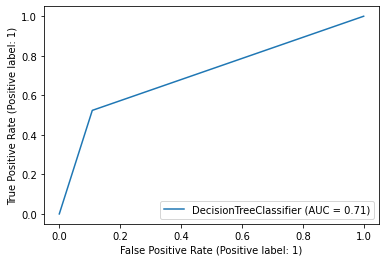

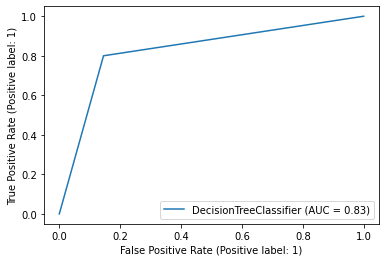

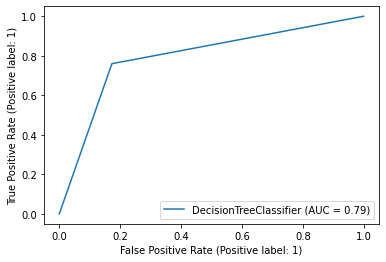

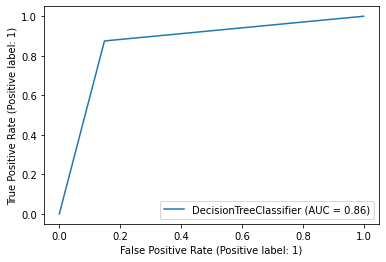

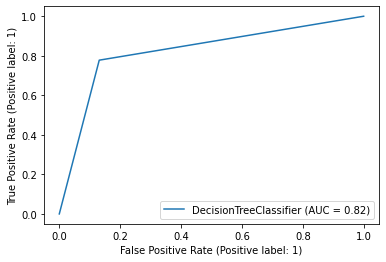

...

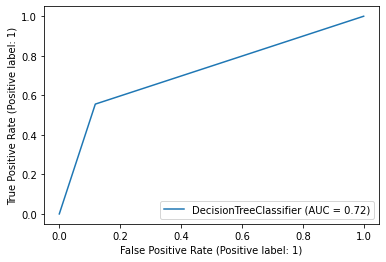

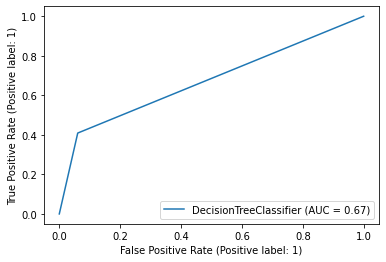

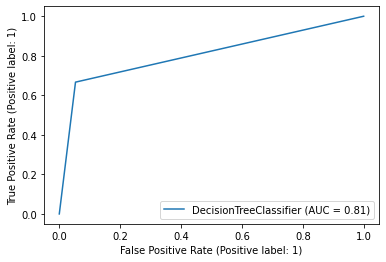

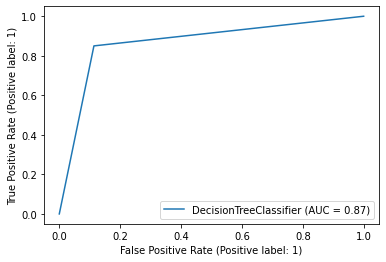

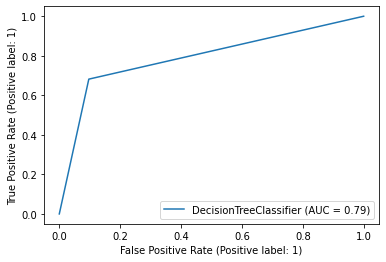

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_dt = DecisionTreeClassifier()
    tic = time.time()
    model_dt.fit(X_train, y_train) 
    toc = time.time()
    print("Decision Tree Train time = " + str(toc-tic))
    print("Decision Tree Accuracy = "+ str(model_dt.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_dt.predict(X_test)
    yhat_classes = (model_dt.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Decision Tree Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Decision Tree Stats _____________________")

    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    CM = confusion_matrix(y_test, yhat_classes)
    print(CM)
    TN = CM[0][0]
    FN = CM[1][0]
    TP = CM[1][1]
    FP = CM[0][1]
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    auc = roc_auc_score(y_test, yhat_probs)
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    #AUC
    from sklearn.metrics import plot_roc_curve
    plot_roc_curve(model_dt, X_test, y_test)

    print("____________________________________________________________")
    print("____________________________________________________________")

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
DTWithSMOTE = pd.DataFrame(data, columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DTWithSMOTE.mean(axis=0).values],  columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User Left Out  Accuracy   ROC_AUC  ...          TN    FP   FN
Average           15.5  0.860428  0.747926  ...  147.566667  17.5  8.6

[1 rows x 11 columns]


In [ ]:
DTWithSMOTE = DTWithSMOTE.append(df_temp)

In [ ]:
print(DTWithSMOTE)
DTWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/DTWithSMOTE.csv', index = True)

         User Left Out  Accuracy   ROC_AUC  ...          TN    FP    FN
0                  1.0  0.850267  0.707688  ...  148.000000  18.0  10.0
1                  2.0  0.850267  0.827326  ...  147.000000  25.0   3.0
2                  3.0  0.818182  0.793580  ...  134.000000  28.0   6.0
3                  4.0  0.855615  0.863306  ...  132.000000  23.0   4.0
4                  5.0  0.855615  0.823264  ...  139.000000  21.0   6.0
5                  6.0  0.871658  0.811873  ...  149.000000  19.0   5.0
6                  7.0  0.877005  0.799046  ...  148.000000  16.0   7.0
7                  8.0  0.775401  0.561532  ...  139.000000  27.0  15.0
8                  9.0  0.828877  0.816667  ...  135.000000  27.0   5.0
9                 10.0  0.893048  0.683741  ...  159.000000   9.0  11.0
10                11.0  0.866310  0.687879  ...  152.000000  13.0  12.0
11                12.0  0.930481  0.713346  ...  166.000000   3.0  10.0
12                13.0  0.855615  0.819697  ...  143.000000  22.

###Gradient Boost

####Model

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 36.53841233253479
Gradient Boost Accuracy = 0.9411764705882353
Gradient Boost Test time = 0.01274871826171875
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.941176
[[161   5]
 [  6  15]]
True negatives: 161
True positives: 15
False positives: 5
False negatives: 6
ROC AUC: 0.842083
F1 Score: 0.731707
Precision: 0.750000
TPR: 0.714286
FPR: 0.030120
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 36.26211619377136
Gradient Boost Accuracy = 0.9090909090909091
Gradient Boost Test time = 0.011073827743530273
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.909091
[[157  15]
 [  2  13]]
True negatives: 157
True positives: 13
False positives: 15
False negatives: 2
ROC AUC: 0.889729
F1 Score: 0.604651
Precision: 0.464286
TPR: 0.866667
FPR: 0.087209
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 36.52554416656494
Gradient Boost Accuracy = 0.8770053475935828
Gradient Boost Test time = 0.012184858322143555
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.877005
[[144  18]
 [  5  20]]
True negatives: 144
True positives: 20
False positives: 18
False negatives: 5
ROC AUC: 0.844444
F1 Score: 0.634921
Precision: 0.526316
TPR: 0.800000
FPR: 0.111111
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 36.52503991127014
Gradient Boost Accuracy = 0.93048128342246
Gradient Boost Test time = 0.011521577835083008
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.930481
[[148   7]
 [  6  26]]
True negatives: 148
True positives: 26
False positives: 7
False negatives: 6
ROC AUC: 0.883669
F1 Score: 0.800000
Precision: 0.787879
TPR: 0.812500
FPR: 0.045161
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 36.43622016906738
Gradient Boost Accuracy = 0.8449197860962567
Gradient Boost Test time = 0.010291576385498047
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.844920
[[141  19]
 [ 10  17]]
True negatives: 141
True positives: 17
False positives: 19
False negatives: 10
ROC AUC: 0.755440
F1 Score: 0.539683
Precision: 0.472222
TPR: 0.629630
FPR: 0.118750
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 36.35576343536377
Gradient Boost Accuracy = 0.9251336898395722
Gradient Boost Test time = 0.010237455368041992
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.925134
[[160   8]
 [  6  13]]
True negatives: 160
True positives: 13
False positives: 8
False negatives: 6
ROC AUC: 0.818296
F1 Score: 0.650000
Precision: 0.619048
TPR: 0.684211
FPR: 0.047619
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 36.41471076011658
Gradient Boost Accuracy = 0.893048128342246
Gradient Boost Test time = 0.01204371452331543
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.893048
[[148  16]
 [  4  19]]
True negatives: 148
True positives: 19
False positives: 16
False negatives: 4
ROC AUC: 0.864263
F1 Score: 0.655172
Precision: 0.542857
TPR: 0.826087
FPR: 0.097561
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 36.30244851112366
Gradient Boost Accuracy = 0.9037433155080213
Gradient Boost Test time = 0.010292768478393555
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.903743
[[161   5]
 [ 13   8]]
True negatives: 161
True positives: 8
False positives: 5
False negatives: 13
ROC AUC: 0.675416
F1 Score: 0.470588
Precision: 0.615385
TPR: 0.380952
FPR: 0.030120
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 36.57908916473389
Gradient Boost Accuracy = 0.9144385026737968
Gradient Boost Test time = 0.011821508407592773
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.914439
[[154   8]
 [  8  17]]
True negatives: 154
True positives: 17
False positives: 8
False negatives: 8
ROC AUC: 0.815309
F1 Score: 0.680000
Precision: 0.680000
TPR: 0.680000
FPR: 0.049383
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 36.3726019859314
Gradient Boost Accuracy = 0.9358288770053476
Gradient Boost Test time = 0.010570764541625977
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.935829
[[165   3]
 [  9  10]]
True negatives: 165
True positives: 10
False positives: 3
False negatives: 9
ROC AUC: 0.754229
F1 Score: 0.625000
Precision: 0.769231
TPR: 0.526316
FPR: 0.017857
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 36.332682371139526
Gradient Boost Accuracy = 0.9037433155080213
Gradient Boost Test time = 0.010694503784179688
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.903743
[[162   3]
 [ 15   7]]
True negatives: 162
True positives: 7
False positives: 3
False negatives: 15
ROC AUC: 0.650000
F1 Score: 0.437500
Precision: 0.700000
TPR: 0.318182
FPR: 0.018182
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 36.344375133514404
Gradient Boost Accuracy = 0.9358288770053476
Gradient Boost Test time = 0.010830163955688477
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.935829
[[168   1]
 [ 11   7]]
True negatives: 168
True positives: 7
False positives: 1
False negatives: 11
ROC AUC: 0.691486
F1 Score: 0.538462
Precision: 0.875000
TPR: 0.388889
FPR: 0.005917
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 36.25265431404114
Gradient Boost Accuracy = 0.8823529411764706
Gradient Boost Test time = 0.010534048080444336
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.882353
[[150  15]
 [  7  15]]
True negatives: 150
True positives: 15
False positives: 15
False negatives: 7
ROC AUC: 0.795455
F1 Score: 0.576923
Precision: 0.500000
TPR: 0.681818
FPR: 0.090909
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 36.45098352432251
Gradient Boost Accuracy = 0.9251336898395722
Gradient Boost Test time = 0.010512828826904297
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.925134
[[160   9]
 [  5  13]]
True negatives: 160
True positives: 13
False positives: 9
False negatives: 5
ROC AUC: 0.834484
F1 Score: 0.650000
Precision: 0.590909
TPR: 0.722222
FPR: 0.053254
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 36.58580827713013
Gradient Boost Accuracy = 0.8823529411764706
Gradient Boost Test time = 0.011240959167480469
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.882353
[[147  17]
 [  5  18]]
True negatives: 147
True positives: 18
False positives: 17
False negatives: 5
ROC AUC: 0.839475
F1 Score: 0.620690
Precision: 0.514286
TPR: 0.782609
FPR: 0.103659
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 36.31123375892639
Gradient Boost Accuracy = 0.9090909090909091
Gradient Boost Test time = 0.010244607925415039
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.909091
[[164   3]
 [ 14   6]]
True negatives: 164
True positives: 6
False positives: 3
False negatives: 14
ROC AUC: 0.641018
F1 Score: 0.413793
Precision: 0.666667
TPR: 0.300000
FPR: 0.017964
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 36.39959788322449
Gradient Boost Accuracy = 0.9037433155080213
Gradient Boost Test time = 0.010183572769165039
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.903743
[[162   3]
 [ 15   7]]
True negatives: 162
True positives: 7
False positives: 3
False negatives: 15
ROC AUC: 0.650000
F1 Score: 0.437500
Precision: 0.700000
TPR: 0.318182
FPR: 0.018182
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 36.31212759017944
Gradient Boost Accuracy = 0.9518716577540107
Gradient Boost Test time = 0.011394262313842773
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.951872
[[170   1]
 [  8   8]]
True negatives: 170
True positives: 8
False positives: 1
False negatives: 8
ROC AUC: 0.747076
F1 Score: 0.640000
Precision: 0.888889
TPR: 0.500000
FPR: 0.005848
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 36.6505446434021
Gradient Boost Accuracy = 0.786096256684492
Gradient Boost Test time = 0.012120485305786133
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.786096
[[133  26]
 [ 14  14]]
True negatives: 133
True positives: 14
False positives: 26
False negatives: 14
ROC AUC: 0.668239
F1 Score: 0.411765
Precision: 0.350000
TPR: 0.500000
FPR: 0.163522
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 36.476712703704834
Gradient Boost Accuracy = 0.8716577540106952
Gradient Boost Test time = 0.011832714080810547
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.871658
[[139  24]
 [  0  24]]
True negatives: 139
True positives: 24
False positives: 24
False negatives: 0
ROC AUC: 0.926380
F1 Score: 0.666667
Precision: 0.500000
TPR: 1.000000
FPR: 0.147239
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 36.584625244140625
Gradient Boost Accuracy = 0.8716577540106952
Gradient Boost Test time = 0.009979486465454102
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.871658
[[156   5]
 [ 19   7]]
True negatives: 156
True positives: 7
False positives: 5
False negatives: 19
ROC AUC: 0.619087
F1 Score: 0.368421
Precision: 0.583333
TPR: 0.269231
FPR: 0.031056
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 36.560707807540894
Gradient Boost Accuracy = 0.9144385026737968
Gradient Boost Test time = 0.011966466903686523
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.914439
[[158   8]
 [  8  13]]
True negatives: 158
True positives: 13
False positives: 8
False negatives: 8
ROC AUC: 0.785427
F1 Score: 0.619048
Precision: 0.619048
TPR: 0.619048
FPR: 0.048193
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 36.51190733909607
Gradient Boost Accuracy = 0.8983957219251337
Gradient Boost Test time = 0.010223627090454102
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.898396
[[157   5]
 [ 14  11]]
True negatives: 157
True positives: 11
False positives: 5
False negatives: 14
ROC AUC: 0.704568
F1 Score: 0.536585
Precision: 0.687500
TPR: 0.440000
FPR: 0.030864
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 36.51065444946289
Gradient Boost Accuracy = 0.9251336898395722
Gradient Boost Test time = 0.01004648208618164
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.925134
[[164   1]
 [ 13   9]]
True negatives: 164
True positives: 9
False positives: 1
False negatives: 13
ROC AUC: 0.701515
F1 Score: 0.562500
Precision: 0.900000
TPR: 0.409091
FPR: 0.006061
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 36.498579263687134
Gradient Boost Accuracy = 0.8716577540106952
Gradient Boost Test time = 0.010535717010498047
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.871658
[[156   7]
 [ 17   7]]
True negatives: 156
True positives: 7
False positives: 7
False negatives: 17
ROC AUC: 0.624361
F1 Score: 0.368421
Precision: 0.500000
TPR: 0.291667
FPR: 0.042945
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 36.26516628265381
Gradient Boost Accuracy = 0.9144385026737968
Gradient Boost Test time = 0.01287984848022461
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.914439
[[156  13]
 [  3  15]]
True negatives: 156
True positives: 15
False positives: 13
False negatives: 3
ROC AUC: 0.878205
F1 Score: 0.652174
Precision: 0.535714
TPR: 0.833333
FPR: 0.076923
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 36.416027784347534
Gradient Boost Accuracy = 0.893048128342246
Gradient Boost Test time = 0.009979248046875
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.893048
[[160   5]
 [ 15   7]]
True negatives: 160
True positives: 7
False positives: 5
False negatives: 15
ROC AUC: 0.643939
F1 Score: 0.411765
Precision: 0.583333
TPR: 0.318182
FPR: 0.030303
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 36.51825451850891
Gradient Boost Accuracy = 0.9358288770053476
Gradient Boost Test time = 0.011293649673461914
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.935829
[[167   2]
 [ 10   8]]
True negatives: 167
True positives: 8
False positives: 2
False negatives: 10
ROC AUC: 0.716305
F1 Score: 0.571429
Precision: 0.800000
TPR: 0.444444
FPR: 0.011834
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 36.39863991737366
Gradient Boost Accuracy = 0.8823529411764706
Gradient Boost Test time = 0.014925479888916016
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.882353
[[149  18]
 [  4  16]]
True negatives: 149
True positives: 16
False positives: 18
False negatives: 4
ROC AUC: 0.846108
F1 Score: 0.592593
Precision: 0.470588
TPR: 0.800000
FPR: 0.107784
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 36.425174713134766
Gradient Boost Accuracy = 0.9037433155080213
Gradient Boost Test time = 0.01055765151977539
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.903743
[[150  15]
 [  3  19]]
True negatives: 150
True positives: 19
False positives: 15
False negatives: 3
ROC AUC: 0.886364
F1 Score: 0.678571
Precision: 0.558824
TPR: 0.863636
FPR: 0.090909
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


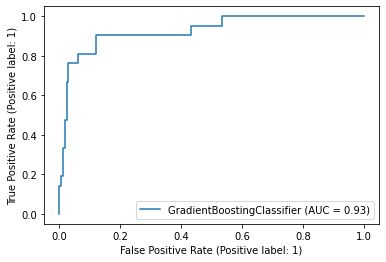

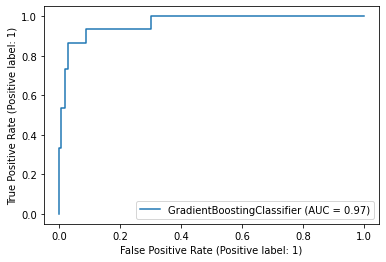

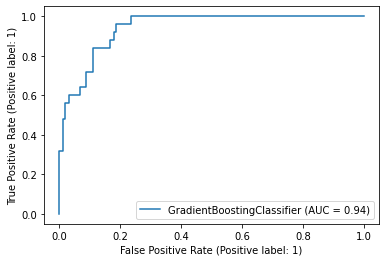

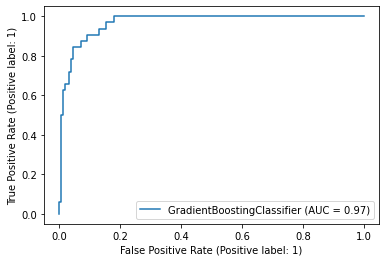

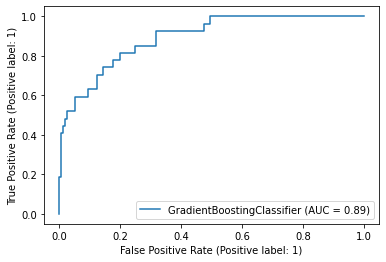

...

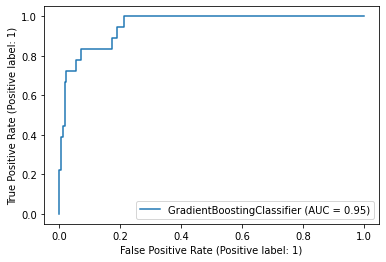

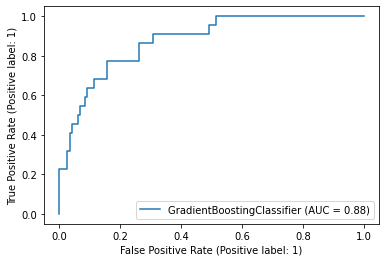

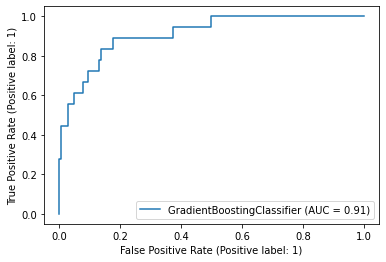

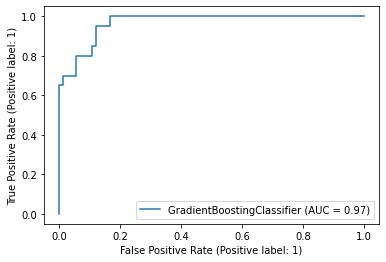

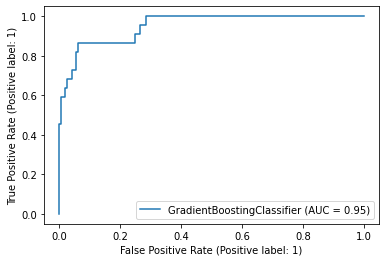

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_gb = GradientBoostingClassifier(n_estimators = 1000) 
    tic = time.time()
    model_gb.fit(X_train, y_train) 
    toc = time.time()
    print("Gradient Boost Train time = " + str(toc-tic))
    print("Gradient Boost Accuracy = "+ str(model_gb.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_gb.predict(X_test)
    yhat_classes = (model_gb.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Gradient Boost Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Gradient Boost Stats _____________________")

    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    CM = confusion_matrix(y_test, yhat_classes)
    print(CM)
    TN = CM[0][0]
    FN = CM[1][0]
    TP = CM[1][1]
    FP = CM[0][1]
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)

    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    auc = roc_auc_score(y_test, yhat_probs)
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    #AUC
    from sklearn.metrics import plot_roc_curve
    plot_roc_curve(model_gb, X_test, y_test)

    print("____________________________________________________________")
    print("____________________________________________________________")

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
GBWithSMOTE = pd.DataFrame(data, columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([GBWithSMOTE.mean(axis=0).values],  columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User Left Out  Accuracy   ROC_AUC  ...          TN   FP        FN
Average           15.5  0.901248  0.766412  ...  155.566667  9.5  8.966667

[1 rows x 11 columns]


In [ ]:
GBWithSMOTE = GBWithSMOTE.append(df_temp)

In [ ]:
print(GBWithSMOTE)
GBWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/GBWithSMOTE.csv', index = True)

         User Left Out  Accuracy   ROC_AUC  ...          TN    FP         FN
0                  1.0  0.941176  0.842083  ...  161.000000   5.0   6.000000
1                  2.0  0.909091  0.889729  ...  157.000000  15.0   2.000000
2                  3.0  0.877005  0.844444  ...  144.000000  18.0   5.000000
3                  4.0  0.930481  0.883669  ...  148.000000   7.0   6.000000
4                  5.0  0.844920  0.755440  ...  141.000000  19.0  10.000000
5                  6.0  0.925134  0.818296  ...  160.000000   8.0   6.000000
6                  7.0  0.893048  0.864263  ...  148.000000  16.0   4.000000
7                  8.0  0.903743  0.675416  ...  161.000000   5.0  13.000000
8                  9.0  0.914439  0.815309  ...  154.000000   8.0   8.000000
9                 10.0  0.935829  0.754229  ...  165.000000   3.0   9.000000
10                11.0  0.903743  0.650000  ...  162.000000   3.0  15.000000
11                12.0  0.935829  0.691486  ...  168.000000   1.0  11.000000

###3 DNN

#### Model

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

Epoch 1/100
135/135 [==============================] - 1s 4ms/step - loss: 0.7589 - accuracy: 0.5816 - val_loss: 0.6446 - val_accuracy: 0.5741 - lr: 0.0010
Epoch 2/100
135/135 [==============================] - 0s 3ms/step - loss: 0.5965 - accuracy: 0.6854 - val_loss: 0.5060 - val_accuracy: 0.7516 - lr: 0.0010
Epoch 3/100
135/135 [==============================] - 0s 3ms/step - loss: 0.5099 - accuracy: 0.7598 - val_loss: 0.5252 - val_accuracy: 0.7599 - lr: 0.0010
Epoch 4/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4718 - accuracy: 0.7952 - val_loss: 0.4260 - val_accuracy: 0.8267 - lr: 0.0010
Epoch 5/100
135/135 [==============================] - 0s 2ms/step - loss: 0.4489 - accuracy: 0.8072 - val_loss: 0.4597 - val_accuracy: 0.8048 - lr: 0.0010
Epoch 6/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4234 - accuracy: 0.8271 - val_loss: 0.4224 - val_accuracy: 0.8205 - lr: 0.0010
Epoch 7/100
135/135 [==============================] - 0s 2ms/st

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


135/135 [==============================] - 1s 4ms/step - loss: 0.6921 - accuracy: 0.6181 - val_loss: 0.6531 - val_accuracy: 0.6054 - lr: 0.0010
Epoch 2/100
135/135 [==============================] - 0s 3ms/step - loss: 0.5648 - accuracy: 0.7236 - val_loss: 0.5508 - val_accuracy: 0.6451 - lr: 0.0010
Epoch 3/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4975 - accuracy: 0.7687 - val_loss: 0.4487 - val_accuracy: 0.7401 - lr: 0.0010
Epoch 4/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4625 - accuracy: 0.7907 - val_loss: 0.4309 - val_accuracy: 0.7693 - lr: 0.0010
Epoch 5/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4434 - accuracy: 0.8049 - val_loss: 0.4354 - val_accuracy: 0.7787 - lr: 0.0010
Epoch 6/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4306 - accuracy: 0.8161 - val_loss: 0.4477 - val_accuracy: 0.7818 - lr: 0.0010
Epoch 7/100
135/135 [==============================] - 0s 3ms/step - loss: 0

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


135/135 [==============================] - 1s 4ms/step - loss: 0.6852 - accuracy: 0.6328 - val_loss: 0.6348 - val_accuracy: 0.6148 - lr: 0.0010
Epoch 2/100
135/135 [==============================] - 0s 3ms/step - loss: 0.5160 - accuracy: 0.7517 - val_loss: 0.5242 - val_accuracy: 0.7025 - lr: 0.0010
Epoch 3/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4664 - accuracy: 0.7924 - val_loss: 0.4296 - val_accuracy: 0.7547 - lr: 0.0010
Epoch 4/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4474 - accuracy: 0.8041 - val_loss: 0.4393 - val_accuracy: 0.7672 - lr: 0.0010
Epoch 5/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4354 - accuracy: 0.8121 - val_loss: 0.4227 - val_accuracy: 0.7954 - lr: 0.0010
Epoch 6/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4244 - accuracy: 0.8214 - val_loss: 0.4511 - val_accuracy: 0.7944 - lr: 0.0010
Epoch 7/100
135/135 [==============================] - 0s 3ms/step - loss: 0

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


135/135 [==============================] - 1s 4ms/step - loss: 0.6803 - accuracy: 0.6263 - val_loss: 0.6268 - val_accuracy: 0.6378 - lr: 0.0010
Epoch 2/100
135/135 [==============================] - 0s 3ms/step - loss: 0.5447 - accuracy: 0.7373 - val_loss: 0.4603 - val_accuracy: 0.7255 - lr: 0.0010
Epoch 3/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4860 - accuracy: 0.7904 - val_loss: 0.3962 - val_accuracy: 0.8027 - lr: 0.0010
Epoch 4/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4507 - accuracy: 0.8117 - val_loss: 0.4143 - val_accuracy: 0.7996 - lr: 0.0010
Epoch 5/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4223 - accuracy: 0.8239 - val_loss: 0.4082 - val_accuracy: 0.7818 - lr: 0.0010
Epoch 6/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4113 - accuracy: 0.8332 - val_loss: 0.3595 - val_accuracy: 0.8173 - lr: 0.0010
Epoch 7/100
135/135 [==============================] - 0s 3ms/step - loss: 0

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


135/135 [==============================] - 1s 4ms/step - loss: 0.7129 - accuracy: 0.5604 - val_loss: 0.7037 - val_accuracy: 0.5887 - lr: 0.0010
Epoch 2/100
135/135 [==============================] - 0s 3ms/step - loss: 0.5888 - accuracy: 0.6722 - val_loss: 0.5754 - val_accuracy: 0.7599 - lr: 0.0010
Epoch 3/100
135/135 [==============================] - 0s 3ms/step - loss: 0.5110 - accuracy: 0.7473 - val_loss: 0.4708 - val_accuracy: 0.7662 - lr: 0.0010
Epoch 4/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4703 - accuracy: 0.7824 - val_loss: 0.4952 - val_accuracy: 0.7370 - lr: 0.0010
Epoch 5/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4298 - accuracy: 0.8096 - val_loss: 0.4115 - val_accuracy: 0.7860 - lr: 0.0010
Epoch 6/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4186 - accuracy: 0.8175 - val_loss: 0.3918 - val_accuracy: 0.8111 - lr: 0.0010
Epoch 7/100
135/135 [==============================] - 0s 3ms/step - loss: 0

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Epoch 1/100
135/135 [==============================] - 1s 4ms/step - loss: 0.7370 - accuracy: 0.5675 - val_loss: 0.6562 - val_accuracy: 0.4754 - lr: 0.0010
Epoch 2/100
135/135 [==============================] - 0s 3ms/step - loss: 0.6044 - accuracy: 0.6771 - val_loss: 0.5389 - val_accuracy: 0.7022 - lr: 0.0010
Epoch 3/100
135/135 [==============================] - 0s 3ms/step - loss: 0.5169 - accuracy: 0.7629 - val_loss: 0.4466 - val_accuracy: 0.7158 - lr: 0.0010
Epoch 4/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4645 - accuracy: 0.7944 - val_loss: 0.4280 - val_accuracy: 0.7534 - lr: 0.0010
Epoch 5/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4303 - accuracy: 0.8171 - val_loss: 0.3798 - val_accuracy: 0.7973 - lr: 0.0010
Epoch 6/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4206 - accuracy: 0.8306 - val_loss: 0.3973 - val_accuracy: 0.8140 - lr: 0.0010
Epoch 7/100
135/135 [==============================] - 0s 3ms/st

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


135/135 [==============================] - 1s 4ms/step - loss: 0.9071 - accuracy: 0.5645 - val_loss: 0.7169 - val_accuracy: 0.3716 - lr: 0.0010
Epoch 2/100
135/135 [==============================] - 0s 3ms/step - loss: 0.6033 - accuracy: 0.6768 - val_loss: 0.5732 - val_accuracy: 0.6033 - lr: 0.0010
Epoch 3/100
135/135 [==============================] - 0s 3ms/step - loss: 0.5376 - accuracy: 0.7233 - val_loss: 0.4838 - val_accuracy: 0.6994 - lr: 0.0010
Epoch 4/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4969 - accuracy: 0.7606 - val_loss: 0.4419 - val_accuracy: 0.7641 - lr: 0.0010
Epoch 5/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4532 - accuracy: 0.7909 - val_loss: 0.4324 - val_accuracy: 0.7797 - lr: 0.0010
Epoch 6/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4349 - accuracy: 0.8033 - val_loss: 0.4560 - val_accuracy: 0.7871 - lr: 0.0010
Epoch 7/100
135/135 [==============================] - 0s 3ms/step - loss: 0

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Epoch 1/100
135/135 [==============================] - 2s 7ms/step - loss: 0.7359 - accuracy: 0.5722 - val_loss: 0.5609 - val_accuracy: 0.6604 - lr: 0.0010
Epoch 2/100
135/135 [==============================] - 1s 5ms/step - loss: 0.6119 - accuracy: 0.6814 - val_loss: 0.5305 - val_accuracy: 0.6447 - lr: 0.0010
Epoch 3/100
135/135 [==============================] - 1s 5ms/step - loss: 0.5162 - accuracy: 0.7554 - val_loss: 0.4873 - val_accuracy: 0.7147 - lr: 0.0010
Epoch 4/100
135/135 [==============================] - 1s 5ms/step - loss: 0.4607 - accuracy: 0.7869 - val_loss: 0.4317 - val_accuracy: 0.7764 - lr: 0.0010
Epoch 5/100
135/135 [==============================] - 1s 4ms/step - loss: 0.4428 - accuracy: 0.8024 - val_loss: 0.4360 - val_accuracy: 0.7858 - lr: 0.0010
Epoch 6/100
135/135 [==============================] - 1s 4ms/step - loss: 0.4224 - accuracy: 0.8174 - val_loss: 0.4028 - val_accuracy: 0.8286 - lr: 0.0010
Epoch 7/100
135/135 [==============================] - 1s 6ms/st

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Epoch 1/100
135/135 [==============================] - 2s 7ms/step - loss: 0.7183 - accuracy: 0.6023 - val_loss: 0.5816 - val_accuracy: 0.5726 - lr: 0.0010
Epoch 2/100
135/135 [==============================] - 1s 5ms/step - loss: 0.5636 - accuracy: 0.7211 - val_loss: 0.5391 - val_accuracy: 0.6426 - lr: 0.0010
Epoch 3/100
135/135 [==============================] - 1s 5ms/step - loss: 0.5109 - accuracy: 0.7595 - val_loss: 0.4988 - val_accuracy: 0.6719 - lr: 0.0010
Epoch 4/100
135/135 [==============================] - 1s 5ms/step - loss: 0.4588 - accuracy: 0.7908 - val_loss: 0.3958 - val_accuracy: 0.7743 - lr: 0.0010
Epoch 5/100
135/135 [==============================] - 1s 4ms/step - loss: 0.4392 - accuracy: 0.8053 - val_loss: 0.3403 - val_accuracy: 0.8328 - lr: 0.0010
Epoch 6/100
135/135 [==============================] - 1s 5ms/step - loss: 0.4298 - accuracy: 0.8096 - val_loss: 0.3430 - val_accuracy: 0.8380 - lr: 0.0010
Epoch 7/100
135/135 [==============================] - 1s 4ms/st

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Epoch 1/100
135/135 [==============================] - 2s 8ms/step - loss: 0.8094 - accuracy: 0.5751 - val_loss: 0.6709 - val_accuracy: 0.7453 - lr: 0.0010
Epoch 2/100
135/135 [==============================] - 1s 4ms/step - loss: 0.6019 - accuracy: 0.6860 - val_loss: 0.5844 - val_accuracy: 0.7349 - lr: 0.0010
Epoch 3/100
135/135 [==============================] - 1s 5ms/step - loss: 0.5283 - accuracy: 0.7441 - val_loss: 0.5283 - val_accuracy: 0.7557 - lr: 0.0010
Epoch 4/100
135/135 [==============================] - 1s 5ms/step - loss: 0.4804 - accuracy: 0.7869 - val_loss: 0.4283 - val_accuracy: 0.8184 - lr: 0.0010
Epoch 5/100
135/135 [==============================] - 1s 5ms/step - loss: 0.4599 - accuracy: 0.7996 - val_loss: 0.5139 - val_accuracy: 0.7777 - lr: 0.0010
Epoch 6/100
135/135 [==============================] - 1s 4ms/step - loss: 0.4427 - accuracy: 0.8144 - val_loss: 0.4274 - val_accuracy: 0.8205 - lr: 0.0010
Epoch 7/100
135/135 [==============================] - 1s 5ms/st

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


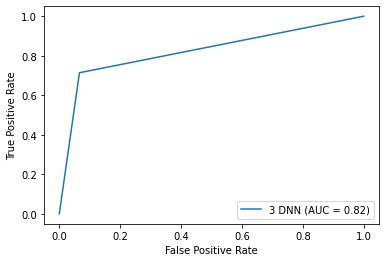

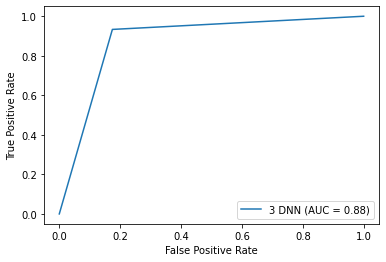

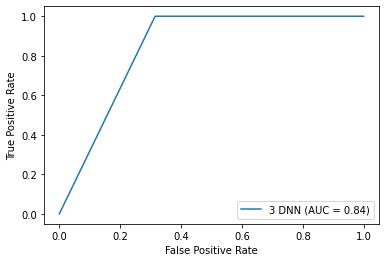

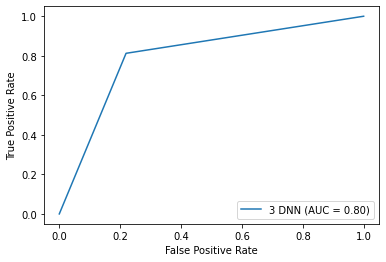

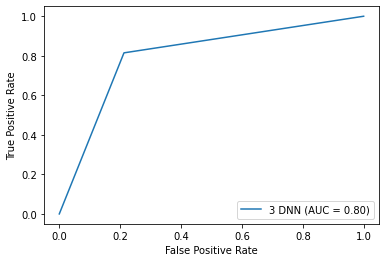

...

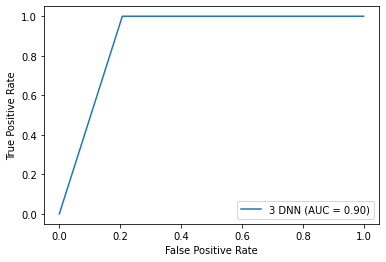

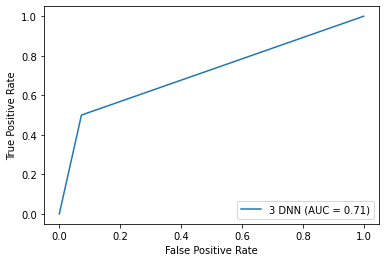

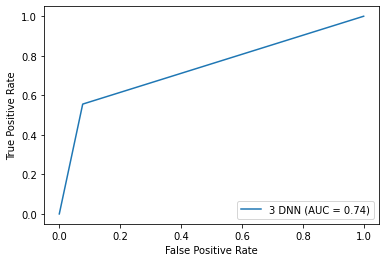

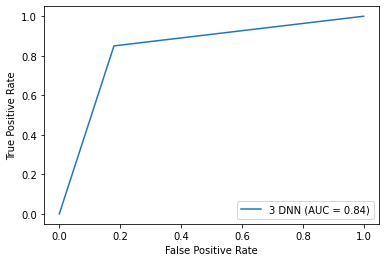

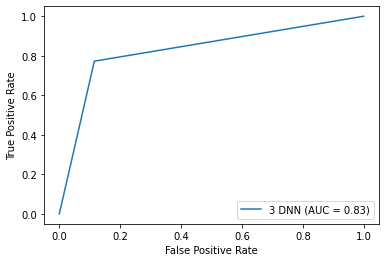

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model3 = Sequential()

    model3.add(Dense(64, activation='relu', input_shape=(15,)))
    model3.add(Dropout(0.3))
    model3.add(Dense(32, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(8, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(1, activation='sigmoid'))

    model3.compile(loss='binary_crossentropy',
                  optimizer='adam',
                  metrics=['accuracy'])
    reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=0.001)
    tic = time.time()
    model3.fit(X_train, y_train, batch_size=64, epochs=100, validation_split=0.1, callbacks=[reduce_lr])
    toc = time.time()
    print("3 DNN Train time = " + str(toc-tic))
    print("3 DNN Accuracy = "+ str(model3.evaluate(X_test, y_test, verbose=0)[1]))
    tic = time.time()
    yhat_probs = model3.predict(X_test, verbose=0)
    yhat_classes = (model3.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("3 DNN Test time = " + str(toc-tic))
    yhat_probs = yhat_probs[:, 0]
    yhat_classes = yhat_classes[:, 0]
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________3 DNN Stats _____________________")

    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    CM = confusion_matrix(y_test, yhat_classes)
    print(CM)
    TN = CM[0][0]
    FN = CM[1][0]
    TP = CM[1][1]
    FP = CM[0][1]
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)

    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    auc = roc_auc_score(y_test, yhat_probs)
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    #AUC
    from sklearn import metrics
    fpr, tpr, thresholds = metrics.roc_curve(y_test, yhat_classes)
    roc_auc = metrics.auc(fpr, tpr)
    display = metrics.RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc, estimator_name='3 DNN')
    display.plot()  

    print("____________________________________________________________")
    print("____________________________________________________________")

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
DNN3WithSMOTE = pd.DataFrame(data, columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DNN3WithSMOTE.mean(axis=0).values],  columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User Left Out  Accuracy   ROC_AUC  ...          TN    FP        FN
Average           15.5  0.848841  0.916617  ...  142.766667  22.3  5.966667

[1 rows x 11 columns]


In [ ]:
DNN3WithSMOTE = DNN3WithSMOTE.append(df_temp)

In [ ]:
print(DNN3WithSMOTE)
DNN3WithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/DNN3WithSMOTE.csv', index = True)

         User Left Out  Accuracy   ROC_AUC  ...          TN    FP         FN
0                  1.0  0.909091  0.876649  ...  155.000000  11.0   6.000000
1                  2.0  0.834225  0.980620  ...  142.000000  30.0   1.000000
2                  3.0  0.727273  0.964198  ...  111.000000  51.0   0.000000
3                  4.0  0.786096  0.922379  ...  121.000000  34.0   6.000000
4                  5.0  0.791444  0.917824  ...  126.000000  34.0   5.000000
5                  6.0  0.871658  0.960213  ...  144.000000  24.0   0.000000
6                  7.0  0.716578  0.938494  ...  112.000000  52.0   1.000000
7                  8.0  0.871658  0.906483  ...  148.000000  18.0   6.000000
8                  9.0  0.823529  0.928395  ...  134.000000  28.0   5.000000
9                 10.0  0.909091  0.899749  ...  159.000000   9.0   8.000000
10                11.0  0.882353  0.915427  ...  151.000000  14.0   8.000000
11                12.0  0.930481  0.951019  ...  166.000000   3.0  10.000000

# Personalized models without SMOTE

## Data Processing

### Import dataset

In [ ]:
directory_all = "/content/drive/MyDrive/Surjya Sir Work/5000"
directory_pbd = "/content/drive/MyDrive/Surjya Sir Work/5000_probed"

In [ ]:
videos = [1,2,3,4,5,6,7,8]

In [ ]:
all = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_all + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    all.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 5
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 6
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


In [ ]:
probed = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_pbd + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    probed.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 5
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 6
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


### Create df

In [ ]:
df = pd.DataFrame()
for i in range(len(all)):#per video = 8
  for j in range(len(all[i])): #per subject = 30
    df = df.append(all[i][j], ignore_index=True)

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8


In [ ]:
tester = pd.DataFrame()
for i in range(len(probed)):#per video = 8
  for j in range(len(probed[i])): #per subject = 30
    tester = tester.append(probed[i][j], ignore_index=True)

In [ ]:
tester

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1738876.01,1743876.01,1748876.01,6.309,5.096,0.013,0.106,5.632759,0.600,0.378,0.155,0.010,0.369,1.642,8.131,10,1
1,832168.01,837168.01,842168.01,6.488,5.290,0.012,0.159,1.883567,0.300,3.623,0.126,0.021,0.657,0.246,0.000,11,1
2,907168.01,912168.01,917168.01,5.330,4.958,0.394,0.082,3.340205,0.103,3.119,0.136,0.004,7.022,0.699,0.123,11,1
3,917168.01,922168.01,927168.01,6.046,5.011,0.767,0.003,2.078420,0.213,0.785,0.136,0.007,4.846,0.041,0.040,11,1
4,922168.01,927168.01,932168.01,6.476,5.014,0.430,0.022,2.208317,0.307,4.601,0.068,0.010,4.148,1.191,0.288,11,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
843,2282834.01,2287834.01,2292834.01,2.090,7.542,0.918,0.586,3.800016,3.170,4.349,0.261,0.003,0.082,2.916,1.602,8,8
844,2287834.01,2292834.01,2297834.01,1.199,8.115,1.181,0.661,5.052202,4.889,8.049,1.549,0.039,0.164,1.315,2.587,8,8
845,1166459.01,1171459.01,1176459.01,3.156,6.595,0.518,0.543,4.114055,0.256,0.368,4.792,0.011,2.998,3.368,13.429,9,8
846,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8


In [ ]:
temp = df[df.isin(tester)].dropna()

In [ ]:
temp = df.loc[df.set_index(list(df.columns)).index.isin(tester.set_index(list(tester.columns)).index)]

In [ ]:
temp.index

Int64Index([  35,   47,   62,   64,   65,   70,   99,  107,  117,  118,
            ...
            7191, 7212, 7231, 7234, 7239, 7255, 7256, 7284, 7285, 7286],
           dtype='int64', length=848)

In [ ]:
df['Probe'] = 0

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,0
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,0
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
for idx in temp.index:
  df.at[idx, 'Probe'] = 1

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


### Optimise df

In [ ]:
df = df.drop(columns=["Start", "Border", "End"], axis=1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1


In [ ]:
df.to_csv('df.csv')

In [ ]:
df['valence_acc_video'] = 0
df['arousal_acc_video'] = 0

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,0,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,0,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,0,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,0,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,0
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,0
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,0
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,0


I'm using the following encoding: 

1 - Low
2 - Mid/high
3 - High

In [ ]:
# def basedOnVideoValence(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 2
#     if int(video) == 6:
#         return 2
#     if int(video) == 7:
#         return 1
#     if int(video) == 8:
#         return 1
    
# def basedOnVideoArousal(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 1
#     if int(video) == 6:
#         return 1
#     if int(video) == 7:
#         return 3
#     if int(video) == 8:
#         return 3

New encoding, 
Low - 0 
Med / High - 1

In [ ]:
def basedOnVideoValence(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 1
    if int(video) == 6:
        return 1
    if int(video) == 7:
        return 0
    if int(video) == 8:
        return 0
    
def basedOnVideoArousal(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 0
    if int(video) == 6:
        return 0
    if int(video) == 7:
        return 1
    if int(video) == 8:
        return 1

In [ ]:
df['valence_acc_video'] = df.apply(lambda row : basedOnVideoValence(row['video']), axis = 1)
df['arousal_acc_video'] = df.apply(lambda row : basedOnVideoArousal(row['video']), axis = 1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1


### X,y for personalized models

In [ ]:
X_train_all = []
y_train_all = []
X_test_all = []
y_test_all = []

In [ ]:
users = []
for i in range(1, 31):
  users.append(i)

print(users)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30]


In [ ]:
for user in users:
  print("User", user)
  X_train = pd.DataFrame()
  y_train = pd.DataFrame()
  X_test = pd.DataFrame()
  y_test = pd.DataFrame()
  df_new = df[df['subject'] == str(user)]
  df_probe = df_new[df_new['Probe'] == 1]
  df_nonprobe = df_new[df_new['Probe'] == 0]

  y_probe = df_probe['Probe']
  y_nonprobe = df_nonprobe['Probe']

  y_probe = pd.DataFrame(y_probe)
  y_nonprobe = pd.DataFrame(y_nonprobe)

  X_probe = df_probe.drop(columns=["Probe"], axis = 1)
  X_nonprobe = df_nonprobe.drop(columns=["Probe"], axis = 1)

  X_train_probe, X_test_probe, y_train_probe, y_test_probe = train_test_split(X_probe, y_probe, test_size = 0.3)
  X_train_nonprobe, X_test_nonprobe, y_train_nonprobe, y_test_nonprobe = train_test_split(X_nonprobe, y_nonprobe, test_size = 0.3)

  X_train = X_train.append(X_train_probe)
  X_train = X_train.append(X_train_nonprobe)
  X_test = X_test.append(X_test_probe)
  X_test = X_test.append(X_test_nonprobe)
  y_train = y_train.append(y_train_probe)
  y_train = y_train.append(y_train_nonprobe)
  y_test = y_test.append(y_test_probe)
  y_test = y_test.append(y_test_nonprobe)


  
  # for video in videos:
  #   print("    Video", video)
  #   df_selected = df_new[df_new['video'] == video]
  #   df_probe = df_selected[df_selected['Probe'] == 1]
  #   df_nonprobe = df_selected[df_selected['Probe'] == 0]

  #   y_probe = df_probe['Probe']
  #   y_nonprobe = df_nonprobe['Probe']

  #   y_probe = pd.DataFrame(y_probe)
  #   y_nonprobe = pd.DataFrame(y_nonprobe)

  #   X_probe = df_probe.drop(columns=["Probe"], axis = 1)
  #   X_nonprobe = df_nonprobe.drop(columns=["Probe"], axis = 1)

  #   X_train_probe, X_test_probe, y_train_probe, y_test_probe = train_test_split(X_probe, y_probe, test_size = 0.5)
  #   X_train_nonprobe, X_test_nonprobe, y_train_nonprobe, y_test_nonprobe = train_test_split(X_nonprobe, y_nonprobe, test_size = 0.2)
  
  #   X_train = X_train.append(X_train_probe)
  #   X_train = X_train.append(X_train_nonprobe)
  #   X_test = X_test.append(X_test_probe)
  #   X_test = X_test.append(X_test_nonprobe)
  #   y_train = y_train.append(y_train_probe)
  #   y_train = y_train.append(y_train_nonprobe)
  #   y_test = y_test.append(y_test_probe)
  #   y_test = y_test.append(y_test_nonprobe)
  X_train_all.append(X_train)
  y_train_all.append(y_train)
  X_test_all.append(X_test)
  y_test_all.append(y_test)

User 1
User 2
User 3
User 4
User 5
User 6
User 7
User 8
User 9
User 10
User 11
User 12
User 13
User 14
User 15
User 16
User 17
User 18
User 19
User 20
User 21
User 22
User 23
User 24
User 25
User 26
User 27
User 28
User 29
User 30


In [ ]:
print(len(X_train_all[29]['subject'].unique()))

1


In [ ]:
X_train_all[2]

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,valence_acc_video,arousal_acc_video
3448,5.000,4.829,0.023,0.642,1.521831,0.579,0.203,0.910,0.000,0.082,0.329,0.370,3,4,0,0
6225,3.215,8.880,1.164,0.628,6.924313,3.572,0.272,2.536,0.021,7.721,2.464,3.080,3,7,0,1
3468,5.684,4.537,0.032,0.051,1.652376,0.469,0.562,0.901,0.004,0.904,0.246,0.164,3,4,0,0
833,7.769,6.395,0.512,0.439,12.270461,0.457,2.063,0.242,0.024,3.943,2.546,0.205,3,1,1,1
2585,4.986,1.506,0.000,0.054,3.973151,0.019,0.465,0.610,0.007,0.616,0.164,1.315,3,3,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
861,8.445,6.639,0.007,0.138,1.750890,0.765,0.136,0.136,0.011,2.300,0.123,0.123,3,1,1,1
6243,2.005,8.644,0.034,0.394,0.783467,0.989,1.434,2.071,0.000,0.205,0.780,1.191,3,7,0,1
5166,6.061,4.766,0.002,0.010,0.429760,0.836,0.436,0.223,0.018,0.411,0.452,0.205,3,6,1,0
4306,6.009,5.066,0.000,0.066,0.416418,0.919,0.310,0.367,0.000,0.575,1.067,0.165,3,5,1,0


In [ ]:
new_X_train_all = []

for i in range(len(X_train_all)):
    df_temp = X_train_all[i]
    #df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    df_temp = df_temp.drop(columns=["subject"], axis = 1)
    new_X_train_all.append(df_temp)

X_train_all = new_X_train_all

new_X_test_all = []

for i in range(len(X_test_all)):
    df_temp = X_test_all[i]
    #df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    df_temp = df_temp.drop(columns=["subject"], axis = 1)
    new_X_test_all.append(df_temp)

X_test_all = new_X_test_all

In [ ]:
X_train_all[2]

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,video,valence_acc_video,arousal_acc_video
3448,5.000,4.829,0.023,0.642,1.521831,0.579,0.203,0.910,0.000,0.082,0.329,0.370,4,0,0
6225,3.215,8.880,1.164,0.628,6.924313,3.572,0.272,2.536,0.021,7.721,2.464,3.080,7,0,1
3468,5.684,4.537,0.032,0.051,1.652376,0.469,0.562,0.901,0.004,0.904,0.246,0.164,4,0,0
833,7.769,6.395,0.512,0.439,12.270461,0.457,2.063,0.242,0.024,3.943,2.546,0.205,1,1,1
2585,4.986,1.506,0.000,0.054,3.973151,0.019,0.465,0.610,0.007,0.616,0.164,1.315,3,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
861,8.445,6.639,0.007,0.138,1.750890,0.765,0.136,0.136,0.011,2.300,0.123,0.123,1,1,1
6243,2.005,8.644,0.034,0.394,0.783467,0.989,1.434,2.071,0.000,0.205,0.780,1.191,7,0,1
5166,6.061,4.766,0.002,0.010,0.429760,0.836,0.436,0.223,0.018,0.411,0.452,0.205,6,1,0
4306,6.009,5.066,0.000,0.066,0.416418,0.919,0.310,0.367,0.000,0.575,1.067,0.165,5,1,0


In [ ]:
y_test_all[7]

,Probe
2004,1
2706,1
5308,1
2696,1
6429,1
...,...
4458,0
2030,0
4452,0
6437,0


## Models

###RandomForest

#### Model

In [ ]:
from sklearn.ensemble import RandomForestClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []

TPs = []
FPs = []
FNs = []
TNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_rf = RandomForestClassifier() 
    tic = time.time()
    print("X_train_size = ", str(len(X_train)))
    print("X_test_size = ", str(len(X_test)))
    model_rf.fit(X_train, y_train) 
    toc = time.time()
    print("Random Forest Train time = " + str(toc-tic))
    print("Random Forest Accuracy = "+ str(model_rf.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_rf.predict(X_test)
    print("yhat_probs",yhat_probs)
    yhat_classes = (model_rf.predict(X_test) > 0.5).astype("int32")
    print("yhat_classes",yhat_classes)
    toc = time.time()
    print("Random Forest Test time = " + str(toc-tic))

    print("___________________Random Forest Stats _____________________")

    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.32315731048583984
Random Forest Accuracy = 0.8648648648648649
yhat_probs [0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.05468630790710449
___________________Random Forest Stats _____________________
Accuracy: 0.864865
True negatives: 63
True positives: 1
False positives: 1
False negatives: 9
ROC AUC: 0.542188
F1 Score: 0.166667
Precision: 0.500000
TPR: 0.100000
FPR: 0.015625
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.30094218254089355
Random Forest Accuracy = 0.9594594594594594
yhat_probs [1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.05197310447692871
___________________Random Forest Stats _____________________
Accuracy: 0.959459
True negatives: 68
True positives: 3
False positives: 0
False negatives: 3
ROC AUC: 0.750000
F1 Score: 0.666667
Precision: 1.000000
TPR: 0.500000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2900829315185547
Random Forest Accuracy = 0.918918918918919
yhat_probs [0 1 0 1 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 0 1 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.07097768783569336
___________________Random Forest Stats _____________________
Accuracy: 0.918919
True negatives: 64
True positives: 4
False positives: 0
False negatives: 6
ROC AUC: 0.700000
F1 Score: 0.571429
Precision: 1.000000
TPR: 0.400000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2962305545806885
Random Forest Accuracy = 0.918918918918919
yhat_probs [1 1 0 1 1 1 1 1 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0
 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0]
yhat_classes [1 1 0 1 1 1 1 1 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0
 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0]
Random Forest Test time = 0.049375295639038086
___________________Random Forest Stats _____________________
Accuracy: 0.918919
True negatives: 58
True positives: 10
False positives: 4
False negatives: 2
ROC AUC: 0.884409
F1 Score: 0.769231
Precision: 0.714286
TPR: 0.833333
FPR: 0.064516
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3081061840057373
Random Forest Accuracy = 0.8918918918918919
yhat_probs [1 0 1 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 1 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.051130056381225586
___________________Random Forest Stats _____________________
Accuracy: 0.891892
True negatives: 62
True positives: 4
False positives: 1
False negatives: 7
ROC AUC: 0.673882
F1 Score: 0.500000
Precision: 0.800000
TPR: 0.363636
FPR: 0.015873
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3167755603790283
Random Forest Accuracy = 0.9054054054054054
yhat_probs [1 1 0 1 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0]
yhat_classes [1 1 0 1 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0]
Random Forest Test time = 0.051979780197143555
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 63
True positives: 4
False positives: 3
False negatives: 4
ROC AUC: 0.727273
F1 Score: 0.533333
Precision: 0.571429
TPR: 0.500000
FPR: 0.045455
____________________________________________________________
____________________________________________________________
X_train_size =  170
X_test_size =  73


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2932400703430176
Random Forest Accuracy = 0.9452054794520548
yhat_probs [0 1 1 0 0 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 1 0 0 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.05597543716430664
___________________Random Forest Stats _____________________
Accuracy: 0.945205
True negatives: 64
True positives: 5
False positives: 0
False negatives: 4
ROC AUC: 0.777778
F1 Score: 0.714286
Precision: 1.000000
TPR: 0.555556
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.29979896545410156
Random Forest Accuracy = 0.8918918918918919
yhat_probs [1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.07512879371643066
___________________Random Forest Stats _____________________
Accuracy: 0.891892
True negatives: 65
True positives: 1
False positives: 0
False negatives: 8
ROC AUC: 0.555556
F1 Score: 0.200000
Precision: 1.000000
TPR: 0.111111
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2829611301422119
Random Forest Accuracy = 0.9054054054054054
yhat_probs [0 1 1 0 0 1 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 1 0 0 1 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.047777414321899414
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 63
True positives: 4
False positives: 1
False negatives: 6
ROC AUC: 0.692187
F1 Score: 0.533333
Precision: 0.800000
TPR: 0.400000
FPR: 0.015625
____________________________________________________________
____________________________________________________________
X_train_size =  170
X_test_size =  73


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2761378288269043
Random Forest Accuracy = 0.9178082191780822
yhat_probs [1 1 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.054862022399902344
___________________Random Forest Stats _____________________
Accuracy: 0.917808
True negatives: 64
True positives: 3
False positives: 2
False negatives: 4
ROC AUC: 0.699134
F1 Score: 0.500000
Precision: 0.600000
TPR: 0.428571
FPR: 0.030303
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2877805233001709
Random Forest Accuracy = 0.972972972972973
yhat_probs [1 1 0 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 0 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.05207204818725586
___________________Random Forest Stats _____________________
Accuracy: 0.972973
True negatives: 65
True positives: 7
False positives: 1
False negatives: 1
ROC AUC: 0.929924
F1 Score: 0.875000
Precision: 0.875000
TPR: 0.875000
FPR: 0.015152
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2935667037963867
Random Forest Accuracy = 0.8918918918918919
yhat_probs [0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.050827980041503906
___________________Random Forest Stats _____________________
Accuracy: 0.891892
True negatives: 65
True positives: 1
False positives: 0
False negatives: 8
ROC AUC: 0.555556
F1 Score: 0.200000
Precision: 1.000000
TPR: 0.111111
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.28079652786254883
Random Forest Accuracy = 0.8918918918918919
yhat_probs [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.05070829391479492
___________________Random Forest Stats _____________________
Accuracy: 0.891892
True negatives: 66
True positives: 0
False positives: 0
False negatives: 8
ROC AUC: 0.500000
F1 Score: 0.000000
Precision: nan
TPR: 0.000000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:59: RuntimeWarning: invalid value encountered in long_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.29012489318847656
Random Forest Accuracy = 0.8918918918918919
yhat_probs [0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04945516586303711
___________________Random Forest Stats _____________________
Accuracy: 0.891892
True negatives: 65
True positives: 1
False positives: 2
False negatives: 6
ROC AUC: 0.556503
F1 Score: 0.200000
Precision: 0.333333
TPR: 0.142857
FPR: 0.029851
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2854018211364746
Random Forest Accuracy = 0.9459459459459459
yhat_probs [1 0 1 0 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 1 0 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04863333702087402
___________________Random Forest Stats _____________________
Accuracy: 0.945946
True negatives: 65
True positives: 5
False positives: 0
False negatives: 4
ROC AUC: 0.777778
F1 Score: 0.714286
Precision: 1.000000
TPR: 0.555556
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2763688564300537
Random Forest Accuracy = 0.9054054054054054
yhat_probs [0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.05146074295043945
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 66
True positives: 1
False positives: 0
False negatives: 7
ROC AUC: 0.562500
F1 Score: 0.222222
Precision: 1.000000
TPR: 0.125000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2847433090209961
Random Forest Accuracy = 0.918918918918919
yhat_probs [1 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.05462360382080078
___________________Random Forest Stats _____________________
Accuracy: 0.918919
True negatives: 65
True positives: 3
False positives: 0
False negatives: 6
ROC AUC: 0.666667
F1 Score: 0.500000
Precision: 1.000000
TPR: 0.333333
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  170
X_test_size =  73


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2693016529083252
Random Forest Accuracy = 0.9452054794520548
yhat_probs [0 1 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.054506778717041016
___________________Random Forest Stats _____________________
Accuracy: 0.945205
True negatives: 66
True positives: 3
False positives: 0
False negatives: 4
ROC AUC: 0.714286
F1 Score: 0.600000
Precision: 1.000000
TPR: 0.428571
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2899188995361328
Random Forest Accuracy = 0.9459459459459459
yhat_probs [0 0 1 1 0 1 1 1 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 1 0 1 1 1 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.061896562576293945
___________________Random Forest Stats _____________________
Accuracy: 0.945946
True negatives: 62
True positives: 8
False positives: 0
False negatives: 4
ROC AUC: 0.833333
F1 Score: 0.800000
Precision: 1.000000
TPR: 0.666667
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.27913498878479004
Random Forest Accuracy = 0.918918918918919
yhat_probs [1 0 0 0 0 0 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 0 0 0 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04688143730163574
___________________Random Forest Stats _____________________
Accuracy: 0.918919
True negatives: 64
True positives: 4
False positives: 0
False negatives: 6
ROC AUC: 0.700000
F1 Score: 0.571429
Precision: 1.000000
TPR: 0.400000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.26811671257019043
Random Forest Accuracy = 0.8783783783783784
yhat_probs [1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04906034469604492
___________________Random Forest Stats _____________________
Accuracy: 0.878378
True negatives: 63
True positives: 2
False positives: 1
False negatives: 8
ROC AUC: 0.592187
F1 Score: 0.307692
Precision: 0.666667
TPR: 0.200000
FPR: 0.015625
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2684786319732666
Random Forest Accuracy = 0.918918918918919
yhat_probs [0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04747366905212402
___________________Random Forest Stats _____________________
Accuracy: 0.918919
True negatives: 66
True positives: 2
False positives: 0
False negatives: 6
ROC AUC: 0.625000
F1 Score: 0.400000
Precision: 1.000000
TPR: 0.250000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.27165699005126953
Random Forest Accuracy = 0.8783783783783784
yhat_probs [0 1 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0]
yhat_classes [0 1 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0]
Random Forest Test time = 0.050797224044799805
___________________Random Forest Stats _____________________
Accuracy: 0.878378
True negatives: 62
True positives: 3
False positives: 2
False negatives: 7
ROC AUC: 0.634375
F1 Score: 0.400000
Precision: 0.600000
TPR: 0.300000
FPR: 0.031250
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.26395106315612793
Random Forest Accuracy = 0.8648648648648649
yhat_probs [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.05150938034057617
___________________Random Forest Stats _____________________
Accuracy: 0.864865
True negatives: 64
True positives: 0
False positives: 1
False negatives: 9
ROC AUC: 0.492308
F1 Score: 0.000000
Precision: 0.000000
TPR: 0.000000
FPR: 0.015385
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2956264019012451
Random Forest Accuracy = 0.8648648648648649
yhat_probs [0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04871535301208496
___________________Random Forest Stats _____________________
Accuracy: 0.864865
True negatives: 63
True positives: 1
False positives: 0
False negatives: 10
ROC AUC: 0.545455
F1 Score: 0.166667
Precision: 1.000000
TPR: 0.090909
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  170
X_test_size =  73


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.27655529975891113
Random Forest Accuracy = 0.9452054794520548
yhat_probs [1 0 0 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04826545715332031
___________________Random Forest Stats _____________________
Accuracy: 0.945205
True negatives: 65
True positives: 4
False positives: 1
False negatives: 3
ROC AUC: 0.778139
F1 Score: 0.666667
Precision: 0.800000
TPR: 0.571429
FPR: 0.015152
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2849090099334717
Random Forest Accuracy = 0.9054054054054054
yhat_probs [1 1 0 1 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 0 1 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.049040794372558594
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 62
True positives: 5
False positives: 2
False negatives: 5
ROC AUC: 0.734375
F1 Score: 0.588235
Precision: 0.714286
TPR: 0.500000
FPR: 0.031250
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.29259729385375977
Random Forest Accuracy = 0.9054054054054054
yhat_probs [0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04779815673828125
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 66
True positives: 1
False positives: 0
False negatives: 7
ROC AUC: 0.562500
F1 Score: 0.222222
Precision: 1.000000
TPR: 0.125000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.28220248222351074
Random Forest Accuracy = 0.9324324324324325
yhat_probs [0 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.047638893127441406
___________________Random Forest Stats _____________________
Accuracy: 0.932432
True negatives: 66
True positives: 3
False positives: 0
False negatives: 5
ROC AUC: 0.687500
F1 Score: 0.545455
Precision: 1.000000
TPR: 0.375000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.28550219535827637
Random Forest Accuracy = 0.9324324324324325
yhat_probs [0 0 0 1 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 1 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04993247985839844
___________________Random Forest Stats _____________________
Accuracy: 0.932432
True negatives: 65
True positives: 4
False positives: 0
False negatives: 5
ROC AUC: 0.722222
F1 Score: 0.615385
Precision: 1.000000
TPR: 0.444444
FPR: 0.000000
____________________________________________________________
____________________________________________________________


#### Results

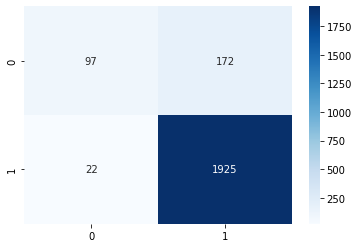

In [ ]:
import seaborn as sns

TPsum = np.sum(TPs)
TNsum = np.sum(TNs)
FPsum = np.sum(FPs)
FNsum = np.sum(FNs)

cm_data = [[TPsum, FNsum], [FPsum, TNsum]]
sns.heatmap(cm_data, annot=True, cmap='Blues', fmt='d')

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
RFWithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([RFWithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC  ...         TN        FP        FN
Average  15.5  0.912502  0.672434  ...  64.166667  0.733333  5.733333

[1 rows x 11 columns]


In [ ]:
RFWithSMOTE = RFWithSMOTE.append(df_temp)

In [ ]:
print(RFWithSMOTE)
RFWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/Personalized/RFPersonalized.csv', index = True)

         User  Accuracy   ROC_AUC  ...         TN        FP         FN
0         1.0  0.864865  0.542188  ...  63.000000  1.000000   9.000000
1         2.0  0.959459  0.750000  ...  68.000000  0.000000   3.000000
2         3.0  0.918919  0.700000  ...  64.000000  0.000000   6.000000
3         4.0  0.918919  0.884409  ...  58.000000  4.000000   2.000000
4         5.0  0.891892  0.673882  ...  62.000000  1.000000   7.000000
5         6.0  0.905405  0.727273  ...  63.000000  3.000000   4.000000
6         7.0  0.945205  0.777778  ...  64.000000  0.000000   4.000000
7         8.0  0.891892  0.555556  ...  65.000000  0.000000   8.000000
8         9.0  0.905405  0.692187  ...  63.000000  1.000000   6.000000
9        10.0  0.917808  0.699134  ...  64.000000  2.000000   4.000000
10       11.0  0.972973  0.929924  ...  65.000000  1.000000   1.000000
11       12.0  0.891892  0.555556  ...  65.000000  0.000000   8.000000
12       13.0  0.891892  0.500000  ...  66.000000  0.000000   8.000000
13    

###Descision Tree

####Model

In [ ]:
from sklearn.tree import DecisionTreeClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_dt = DecisionTreeClassifier()
    tic = time.time()
    model_dt.fit(X_train, y_train) 
    toc = time.time()
    print("Decision Tree Train time = " + str(toc-tic))
    print("Decision Tree Accuracy = "+ str(model_dt.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_dt.predict(X_test)
    yhat_classes = (model_dt.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Decision Tree Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Decision Tree Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

Decision Tree Train time = 0.006257534027099609
Decision Tree Accuracy = 0.8783783783783784
Decision Tree Test time = 0.00513458251953125
(74,)
(74,)
___________________Decision Tree Stats _____________________
Accuracy: 0.878378
True negatives: 58
True positives: 7
False positives: 6
False negatives: 3
ROC AUC: 0.803125
F1 Score: 0.608696
Precision: 0.538462
TPR: 0.700000
FPR: 0.093750
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.0056803226470947266
Decision Tree Accuracy = 0.9594594594594594
Decision Tree Test time = 0.010807514190673828
(74,)
(74,)
___________________Decision Tree Stats _____________________
Accuracy: 0.959459
True negatives: 68
True positives: 3
False positives: 0
False negatives: 3
ROC AUC: 0.750000
F1 Score: 0.666667
Precision: 1.000000
TPR: 0.500000
FPR: 0.000000
____________________________________________________________
___________________________________

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
DTWithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DTWithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC        F1  ...   TP    TN   FP        FN
Average  15.5  0.912458  0.786286  0.629683  ...  5.6  61.8  3.1  3.366667

[1 rows x 11 columns]


In [ ]:
DTWithSMOTE = DTWithSMOTE.append(df_temp)

In [ ]:
print(DTWithSMOTE)
DTWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/Personalized/DTPersonalized.csv', index = True)

         User  Accuracy   ROC_AUC        F1  ...    TP    TN    FP        FN
0         1.0  0.878378  0.803125  0.608696  ...   7.0  58.0   6.0  3.000000
1         2.0  0.959459  0.750000  0.666667  ...   3.0  68.0   0.0  3.000000
2         3.0  0.945946  0.884375  0.800000  ...   8.0  62.0   2.0  2.000000
3         4.0  0.918919  0.884409  0.769231  ...  10.0  58.0   4.0  2.000000
4         5.0  0.878378  0.778499  0.608696  ...   7.0  58.0   5.0  4.000000
5         6.0  0.905405  0.782197  0.588235  ...   5.0  62.0   4.0  3.000000
6         7.0  0.958904  0.833333  0.800000  ...   6.0  64.0   0.0  3.000000
7         8.0  0.891892  0.699145  0.500000  ...   4.0  62.0   3.0  5.000000
8         9.0  0.905405  0.734375  0.588235  ...   5.0  62.0   2.0  5.000000
9        10.0  0.835616  0.589827  0.250000  ...   2.0  59.0   7.0  5.000000
10       11.0  0.945946  0.859848  0.750000  ...   6.0  64.0   2.0  2.000000
11       12.0  0.932432  0.817949  0.705882  ...   6.0  63.0   2.0  3.000000

###Gradient Boost

####Model

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_gb = GradientBoostingClassifier(n_estimators = 1000) 
    tic = time.time()
    model_gb.fit(X_train, y_train) 
    toc = time.time()
    print("Gradient Boost Train time = " + str(toc-tic))
    print("Gradient Boost Accuracy = "+ str(model_gb.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_gb.predict(X_test)
    yhat_classes = (model_gb.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Gradient Boost Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Gradient Boost Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.1006321907043457
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.00854182243347168
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 61
True positives: 9
False positives: 3
False negatives: 1
ROC AUC: 0.926562
F1 Score: 0.818182
Precision: 0.750000
TPR: 0.900000
FPR: 0.046875
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.6707613468170166
Gradient Boost Accuracy = 0.9594594594594594
Gradient Boost Test time = 0.009076118469238281
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.959459
True negatives: 67
True positives: 4
False positives: 1
False negatives: 2
ROC AUC: 0.825980
F1 Score: 0.727273
Precision: 0.800000
TPR: 0.666667
FPR: 0.014706
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.8304338455200195
Gradient Boost Accuracy = 0.9324324324324325
Gradient Boost Test time = 0.008308649063110352
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.932432
True negatives: 62
True positives: 7
False positives: 2
False negatives: 3
ROC AUC: 0.834375
F1 Score: 0.736842
Precision: 0.777778
TPR: 0.700000
FPR: 0.031250
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.8514351844787598
Gradient Boost Accuracy = 0.9054054054054054
Gradient Boost Test time = 0.00831913948059082
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.905405
True negatives: 56
True positives: 11
False positives: 6
False negatives: 1
ROC AUC: 0.909946
F1 Score: 0.758621
Precision: 0.647059
TPR: 0.916667
FPR: 0.096774
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0504224300384521
Gradient Boost Accuracy = 0.8918918918918919
Gradient Boost Test time = 0.014644861221313477
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.891892
True negatives: 61
True positives: 5
False positives: 2
False negatives: 6
ROC AUC: 0.711400
F1 Score: 0.555556
Precision: 0.714286
TPR: 0.454545
FPR: 0.031746
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9594671726226807
Gradient Boost Accuracy = 0.8918918918918919
Gradient Boost Test time = 0.00820016860961914
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.891892
True negatives: 62
True positives: 4
False positives: 4
False negatives: 4
ROC AUC: 0.719697
F1 Score: 0.500000
Precision: 0.500000
TPR: 0.500000
FPR: 0.060606
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9357268810272217
Gradient Boost Accuracy = 0.9452054794520548
Gradient Boost Test time = 0.009269475936889648
(73,)
(73,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945205
True negatives: 63
True positives: 6
False positives: 1
False negatives: 3
ROC AUC: 0.825521
F1 Score: 0.750000
Precision: 0.857143
TPR: 0.666667
FPR: 0.015625
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0843899250030518
Gradient Boost Accuracy = 0.918918918918919
Gradient Boost Test time = 0.009107828140258789
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.918919
True negatives: 64
True positives: 4
False positives: 1
False negatives: 5
ROC AUC: 0.714530
F1 Score: 0.571429
Precision: 0.800000
TPR: 0.444444
FPR: 0.015385
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9842374324798584
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.008675813674926758
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 63
True positives: 7
False positives: 1
False negatives: 3
ROC AUC: 0.842187
F1 Score: 0.777778
Precision: 0.875000
TPR: 0.700000
FPR: 0.015625
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.119379997253418
Gradient Boost Accuracy = 0.8904109589041096
Gradient Boost Test time = 0.009099483489990234
(73,)
(73,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.890411
True negatives: 63
True positives: 2
False positives: 3
False negatives: 5
ROC AUC: 0.620130
F1 Score: 0.333333
Precision: 0.400000
TPR: 0.285714
FPR: 0.045455
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0131962299346924
Gradient Boost Accuracy = 0.972972972972973
Gradient Boost Test time = 0.00872182846069336
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.972973
True negatives: 65
True positives: 7
False positives: 1
False negatives: 1
ROC AUC: 0.929924
F1 Score: 0.875000
Precision: 0.875000
TPR: 0.875000
FPR: 0.015152
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9365262985229492
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.008086204528808594
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 64
True positives: 6
False positives: 1
False negatives: 3
ROC AUC: 0.825641
F1 Score: 0.750000
Precision: 0.857143
TPR: 0.666667
FPR: 0.015385
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9178383350372314
Gradient Boost Accuracy = 0.9324324324324325
Gradient Boost Test time = 0.009233474731445312
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.932432
True negatives: 63
True positives: 6
False positives: 3
False negatives: 2
ROC AUC: 0.852273
F1 Score: 0.705882
Precision: 0.666667
TPR: 0.750000
FPR: 0.045455
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.6944847106933594
Gradient Boost Accuracy = 0.8513513513513513
Gradient Boost Test time = 0.008382797241210938
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.851351
True negatives: 61
True positives: 2
False positives: 6
False negatives: 5
ROC AUC: 0.598081
F1 Score: 0.266667
Precision: 0.250000
TPR: 0.285714
FPR: 0.089552
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0205063819885254
Gradient Boost Accuracy = 0.9594594594594594
Gradient Boost Test time = 0.009557247161865234
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.959459
True negatives: 64
True positives: 7
False positives: 1
False negatives: 2
ROC AUC: 0.881197
F1 Score: 0.823529
Precision: 0.875000
TPR: 0.777778
FPR: 0.015385
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0286567211151123
Gradient Boost Accuracy = 0.9594594594594594
Gradient Boost Test time = 0.008727550506591797
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.959459
True negatives: 65
True positives: 6
False positives: 1
False negatives: 2
ROC AUC: 0.867424
F1 Score: 0.800000
Precision: 0.857143
TPR: 0.750000
FPR: 0.015152
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0649995803833008
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.009658098220825195
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 62
True positives: 8
False positives: 3
False negatives: 1
ROC AUC: 0.921368
F1 Score: 0.800000
Precision: 0.727273
TPR: 0.888889
FPR: 0.046154
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0235047340393066
Gradient Boost Accuracy = 0.9726027397260274
Gradient Boost Test time = 0.008970022201538086
(73,)
(73,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.972603
True negatives: 66
True positives: 5
False positives: 0
False negatives: 2
ROC AUC: 0.857143
F1 Score: 0.833333
Precision: 1.000000
TPR: 0.714286
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0518710613250732
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.008547067642211914
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 61
True positives: 9
False positives: 1
False negatives: 3
ROC AUC: 0.866935
F1 Score: 0.818182
Precision: 0.900000
TPR: 0.750000
FPR: 0.016129
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9757182598114014
Gradient Boost Accuracy = 0.9324324324324325
Gradient Boost Test time = 0.008633852005004883
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.932432
True negatives: 64
True positives: 5
False positives: 0
False negatives: 5
ROC AUC: 0.750000
F1 Score: 0.666667
Precision: 1.000000
TPR: 0.500000
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9949421882629395
Gradient Boost Accuracy = 0.8783783783783784
Gradient Boost Test time = 0.0092620849609375
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.878378
True negatives: 60
True positives: 5
False positives: 4
False negatives: 5
ROC AUC: 0.718750
F1 Score: 0.526316
Precision: 0.555556
TPR: 0.500000
FPR: 0.062500
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.8513498306274414
Gradient Boost Accuracy = 0.9864864864864865
Gradient Boost Test time = 0.008212566375732422
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.986486
True negatives: 65
True positives: 8
False positives: 1
False negatives: 0
ROC AUC: 0.992424
F1 Score: 0.941176
Precision: 0.888889
TPR: 1.000000
FPR: 0.015152
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9676320552825928
Gradient Boost Accuracy = 0.8918918918918919
Gradient Boost Test time = 0.012605428695678711
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.891892
True negatives: 61
True positives: 5
False positives: 3
False negatives: 5
ROC AUC: 0.726562
F1 Score: 0.555556
Precision: 0.625000
TPR: 0.500000
FPR: 0.046875
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0535764694213867
Gradient Boost Accuracy = 0.9324324324324325
Gradient Boost Test time = 0.009417533874511719
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.932432
True negatives: 63
True positives: 6
False positives: 2
False negatives: 3
ROC AUC: 0.817949
F1 Score: 0.705882
Precision: 0.750000
TPR: 0.666667
FPR: 0.030769
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.2222721576690674
Gradient Boost Accuracy = 0.8783783783783784
Gradient Boost Test time = 0.013895750045776367
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.878378
True negatives: 61
True positives: 4
False positives: 2
False negatives: 7
ROC AUC: 0.665945
F1 Score: 0.470588
Precision: 0.666667
TPR: 0.363636
FPR: 0.031746
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0610239505767822
Gradient Boost Accuracy = 0.958904109589041
Gradient Boost Test time = 0.008852005004882812
(73,)
(73,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.958904
True negatives: 64
True positives: 6
False positives: 2
False negatives: 1
ROC AUC: 0.913420
F1 Score: 0.800000
Precision: 0.750000
TPR: 0.857143
FPR: 0.030303
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0683135986328125
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.009336709976196289
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 61
True positives: 9
False positives: 3
False negatives: 1
ROC AUC: 0.926562
F1 Score: 0.818182
Precision: 0.750000
TPR: 0.900000
FPR: 0.046875
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0548882484436035
Gradient Boost Accuracy = 0.8648648648648649
Gradient Boost Test time = 0.009783506393432617
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.864865
True negatives: 61
True positives: 3
False positives: 5
False negatives: 5
ROC AUC: 0.649621
F1 Score: 0.375000
Precision: 0.375000
TPR: 0.375000
FPR: 0.075758
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.8678882122039795
Gradient Boost Accuracy = 0.9594594594594594
Gradient Boost Test time = 0.00962686538696289
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.959459
True negatives: 64
True positives: 7
False positives: 2
False negatives: 1
ROC AUC: 0.922348
F1 Score: 0.823529
Precision: 0.777778
TPR: 0.875000
FPR: 0.030303
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0921351909637451
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.00960230827331543
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 65
True positives: 5
False positives: 0
False negatives: 4
ROC AUC: 0.777778
F1 Score: 0.714286
Precision: 1.000000
TPR: 0.555556
FPR: 0.000000
____________________________________________________________
____________________________________________________________


#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
GBWithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([GBWithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC  ...         TN        FP        FN
Average  15.5  0.929625  0.813056  ...  62.733333  2.166667  3.033333

[1 rows x 11 columns]


In [ ]:
GBWithSMOTE = GBWithSMOTE.append(df_temp)

In [ ]:
print(GBWithSMOTE)
GBWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/Personalized/GBPersonalized.csv', index = True)

         User  Accuracy   ROC_AUC  ...         TN        FP        FN
0         1.0  0.945946  0.926562  ...  61.000000  3.000000  1.000000
1         2.0  0.959459  0.825980  ...  67.000000  1.000000  2.000000
2         3.0  0.932432  0.834375  ...  62.000000  2.000000  3.000000
3         4.0  0.905405  0.909946  ...  56.000000  6.000000  1.000000
4         5.0  0.891892  0.711400  ...  61.000000  2.000000  6.000000
5         6.0  0.891892  0.719697  ...  62.000000  4.000000  4.000000
6         7.0  0.945205  0.825521  ...  63.000000  1.000000  3.000000
7         8.0  0.918919  0.714530  ...  64.000000  1.000000  5.000000
8         9.0  0.945946  0.842187  ...  63.000000  1.000000  3.000000
9        10.0  0.890411  0.620130  ...  63.000000  3.000000  5.000000
10       11.0  0.972973  0.929924  ...  65.000000  1.000000  1.000000
11       12.0  0.945946  0.825641  ...  64.000000  1.000000  3.000000
12       13.0  0.932432  0.852273  ...  63.000000  3.000000  2.000000
13       14.0  0.851

###3 DNN

#### Model

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model3 = Sequential()

    model3.add(Dense(64, activation='relu', input_shape=(15,)))
    model3.add(Dropout(0.3))
    model3.add(Dense(32, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(8, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(1, activation='sigmoid'))

    model3.compile(loss='binary_crossentropy',
                  optimizer='adam',
                  metrics=['accuracy'])
    reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=0.001)
    tic = time.time()
    model3.fit(X_train, y_train, batch_size=64, epochs=100, validation_split=0.1, callbacks=[reduce_lr])
    toc = time.time()
    print("3 DNN Train time = " + str(toc-tic))
    print("3 DNN Accuracy = "+ str(model3.evaluate(X_test, y_test, verbose=0)[1]))
    tic = time.time()
    yhat_probs = model3.predict(X_test, verbose=0)
    yhat_classes = (model3.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("3 DNN Test time = " + str(toc-tic))
    yhat_probs = yhat_probs[:, 0]
    yhat_classes = yhat_classes[:, 0]
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________3 DNN Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

Epoch 1/100
3/3 [==============================] - 2s 203ms/step - loss: 2.2317 - accuracy: 0.2434 - val_loss: 1.4199 - val_accuracy: 0.0000e+00 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 29ms/step - loss: 1.7003 - accuracy: 0.3026 - val_loss: 1.0081 - val_accuracy: 0.2941 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 27ms/step - loss: 1.4161 - accuracy: 0.3092 - val_loss: 0.7870 - val_accuracy: 0.7647 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 24ms/step - loss: 1.2187 - accuracy: 0.3816 - val_loss: 0.6630 - val_accuracy: 0.8235 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 21ms/step - loss: 0.9548 - accuracy: 0.4539 - val_loss: 0.5958 - val_accuracy: 0.9412 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 22ms/step - loss: 0.8688 - accuracy: 0.5921 - val_loss: 0.5673 - val_accuracy: 0.9412 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 38ms/step - loss: 0.728

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


Epoch 1/100
3/3 [==============================] - 1s 162ms/step - loss: 0.5789 - accuracy: 0.8618 - val_loss: 0.3783 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 21ms/step - loss: 0.4652 - accuracy: 0.8882 - val_loss: 0.3285 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 22ms/step - loss: 0.4740 - accuracy: 0.8947 - val_loss: 0.2894 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 21ms/step - loss: 0.3610 - accuracy: 0.9145 - val_loss: 0.2544 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 20ms/step - loss: 0.4561 - accuracy: 0.9145 - val_loss: 0.2229 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 24ms/step - loss: 0.4463 - accuracy: 0.9079 - val_loss: 0.2011 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 28ms/step - loss: 0.3535 - 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


Epoch 1/100
3/3 [==============================] - 1s 158ms/step - loss: 0.6920 - accuracy: 0.6908 - val_loss: 0.4218 - val_accuracy: 0.8824 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 22ms/step - loss: 0.6557 - accuracy: 0.7039 - val_loss: 0.3375 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 23ms/step - loss: 0.5386 - accuracy: 0.6842 - val_loss: 0.2744 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 23ms/step - loss: 0.5771 - accuracy: 0.7368 - val_loss: 0.2400 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 27ms/step - loss: 0.4881 - accuracy: 0.7763 - val_loss: 0.2264 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 27ms/step - loss: 0.5600 - accuracy: 0.7237 - val_loss: 0.2184 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 26ms/step - loss: 0.6351 - 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


Epoch 1/100
3/3 [==============================] - 1s 153ms/step - loss: 0.8033 - accuracy: 0.4211 - val_loss: 0.7357 - val_accuracy: 0.1176 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 25ms/step - loss: 0.7753 - accuracy: 0.4474 - val_loss: 0.6577 - val_accuracy: 0.7647 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 29ms/step - loss: 0.6659 - accuracy: 0.6447 - val_loss: 0.6109 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 25ms/step - loss: 0.6108 - accuracy: 0.7303 - val_loss: 0.5731 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 26ms/step - loss: 0.5828 - accuracy: 0.7829 - val_loss: 0.5379 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 24ms/step - loss: 0.6000 - accuracy: 0.8289 - val_loss: 0.5033 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 23ms/step - loss: 0.5247 - 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


Epoch 1/100
3/3 [==============================] - 1s 153ms/step - loss: 0.6348 - accuracy: 0.8289 - val_loss: 0.2751 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 28ms/step - loss: 0.6201 - accuracy: 0.7829 - val_loss: 0.2437 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 26ms/step - loss: 0.5394 - accuracy: 0.8289 - val_loss: 0.2293 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 23ms/step - loss: 0.4941 - accuracy: 0.8355 - val_loss: 0.2233 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 22ms/step - loss: 0.4638 - accuracy: 0.8421 - val_loss: 0.2066 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 28ms/step - loss: 0.5130 - accuracy: 0.8553 - val_loss: 0.1908 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 29ms/step - loss: 0.5003 - 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


Epoch 1/100
3/3 [==============================] - 1s 161ms/step - loss: 1.7720 - accuracy: 0.2680 - val_loss: 0.7663 - val_accuracy: 0.2941 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 23ms/step - loss: 1.6213 - accuracy: 0.3856 - val_loss: 0.5935 - val_accuracy: 0.7647 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 26ms/step - loss: 1.6509 - accuracy: 0.4248 - val_loss: 0.5086 - val_accuracy: 0.8824 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 22ms/step - loss: 0.9950 - accuracy: 0.5098 - val_loss: 0.4424 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 22ms/step - loss: 0.8371 - accuracy: 0.6078 - val_loss: 0.3920 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 22ms/step - loss: 0.9097 - accuracy: 0.6797 - val_loss: 0.3514 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 23ms/step - loss: 0.6597 - 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


Epoch 1/100
3/3 [==============================] - 1s 148ms/step - loss: 1.6940 - accuracy: 0.2632 - val_loss: 1.2260 - val_accuracy: 0.0000e+00 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 23ms/step - loss: 1.2471 - accuracy: 0.3750 - val_loss: 0.9714 - val_accuracy: 0.0000e+00 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 21ms/step - loss: 1.0583 - accuracy: 0.3882 - val_loss: 0.7702 - val_accuracy: 0.2353 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 21ms/step - loss: 0.9298 - accuracy: 0.5066 - val_loss: 0.5941 - val_accuracy: 0.9412 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 21ms/step - loss: 0.7428 - accuracy: 0.6053 - val_loss: 0.4360 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 23ms/step - loss: 0.6748 - accuracy: 0.6579 - val_loss: 0.3207 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 24ms/step - loss: 0

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
DNN3WithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DNN3WithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC        F1  ...        TP         TN        FP   FN
Average  15.5  0.898038  0.874528  0.334149  ...  2.266667  64.066667  0.833333  6.7

[1 rows x 11 columns]


In [ ]:
DNN3WithSMOTE = DNN3WithSMOTE.append(df_temp)

In [ ]:
print(DNN3WithSMOTE)
DNN3WithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/Personalized/DNNPersonalized.csv', index = True)

         User  Accuracy   ROC_AUC  ...         TN        FP    FN
0         1.0  0.864865  0.659375  ...  64.000000  0.000000  10.0
1         2.0  0.932432  0.977941  ...  66.000000  2.000000   3.0
2         3.0  0.891892  0.929688  ...  63.000000  1.000000   7.0
3         4.0  0.891892  0.922043  ...  57.000000  5.000000   3.0
4         5.0  0.824324  0.883838  ...  61.000000  2.000000  11.0
5         6.0  0.918919  0.861742  ...  63.000000  3.000000   3.0
6         7.0  0.876712  0.819444  ...  64.000000  0.000000   9.0
7         8.0  0.905405  0.914530  ...  64.000000  1.000000   6.0
8         9.0  0.905405  0.946875  ...  63.000000  1.000000   6.0
9        10.0  0.917808  0.930736  ...  66.000000  0.000000   6.0
10       11.0  0.945946  0.975379  ...  66.000000  0.000000   4.0
11       12.0  0.905405  0.664957  ...  65.000000  0.000000   7.0
12       13.0  0.905405  0.755682  ...  66.000000  0.000000   7.0
13       14.0  0.864865  0.827292  ...  63.000000  4.000000   6.0
14       1

# Personalized models with SMOTE

## Data Processing

### Import dataset

In [ ]:
directory_all = "/content/drive/MyDrive/Surjya Sir Work/5000"
directory_pbd = "/content/drive/MyDrive/Surjya Sir Work/5000_probed"

In [ ]:
videos = [1,2,3,4,5,6,7,8]

In [ ]:
all = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_all + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    all.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 5
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 6
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


In [ ]:
probed = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_pbd + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    probed.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 5
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 6
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


### Create df

In [ ]:
df = pd.DataFrame()
for i in range(len(all)):#per video = 8
  for j in range(len(all[i])): #per subject = 30
    df = df.append(all[i][j], ignore_index=True)

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8


In [ ]:
tester = pd.DataFrame()
for i in range(len(probed)):#per video = 8
  for j in range(len(probed[i])): #per subject = 30
    tester = tester.append(probed[i][j], ignore_index=True)

In [ ]:
tester

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1738876.01,1743876.01,1748876.01,6.309,5.096,0.013,0.106,5.632759,0.600,0.378,0.155,0.010,0.369,1.642,8.131,10,1
1,832168.01,837168.01,842168.01,6.488,5.290,0.012,0.159,1.883567,0.300,3.623,0.126,0.021,0.657,0.246,0.000,11,1
2,907168.01,912168.01,917168.01,5.330,4.958,0.394,0.082,3.340205,0.103,3.119,0.136,0.004,7.022,0.699,0.123,11,1
3,917168.01,922168.01,927168.01,6.046,5.011,0.767,0.003,2.078420,0.213,0.785,0.136,0.007,4.846,0.041,0.040,11,1
4,922168.01,927168.01,932168.01,6.476,5.014,0.430,0.022,2.208317,0.307,4.601,0.068,0.010,4.148,1.191,0.288,11,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
843,2282834.01,2287834.01,2292834.01,2.090,7.542,0.918,0.586,3.800016,3.170,4.349,0.261,0.003,0.082,2.916,1.602,8,8
844,2287834.01,2292834.01,2297834.01,1.199,8.115,1.181,0.661,5.052202,4.889,8.049,1.549,0.039,0.164,1.315,2.587,8,8
845,1166459.01,1171459.01,1176459.01,3.156,6.595,0.518,0.543,4.114055,0.256,0.368,4.792,0.011,2.998,3.368,13.429,9,8
846,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8


In [ ]:
temp = df[df.isin(tester)].dropna()

In [ ]:
temp = df.loc[df.set_index(list(df.columns)).index.isin(tester.set_index(list(tester.columns)).index)]

In [ ]:
temp.index

Int64Index([  35,   47,   62,   64,   65,   70,   99,  107,  117,  118,
            ...
            7191, 7212, 7231, 7234, 7239, 7255, 7256, 7284, 7285, 7286],
           dtype='int64', length=848)

In [ ]:
df['Probe'] = 0

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,0
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,0
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
for idx in temp.index:
  df.at[idx, 'Probe'] = 1

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


### Optimise df

In [ ]:
df = df.drop(columns=["Start", "Border", "End"], axis=1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
df['valence_acc_video'] = 0
df['arousal_acc_video'] = 0

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,0,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,0,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,0,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,0,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,0
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,0
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,0
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,0


I'm using the following encoding: 

1 - Low
2 - Mid/high
3 - High

In [ ]:
# def basedOnVideoValence(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 2
#     if int(video) == 6:
#         return 2
#     if int(video) == 7:
#         return 1
#     if int(video) == 8:
#         return 1
    
# def basedOnVideoArousal(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 1
#     if int(video) == 6:
#         return 1
#     if int(video) == 7:
#         return 3
#     if int(video) == 8:
#         return 3

New encoding, 
Low - 0 
Med / High - 1

In [ ]:
def basedOnVideoValence(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 1
    if int(video) == 6:
        return 1
    if int(video) == 7:
        return 0
    if int(video) == 8:
        return 0
    
def basedOnVideoArousal(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 0
    if int(video) == 6:
        return 0
    if int(video) == 7:
        return 1
    if int(video) == 8:
        return 1

In [ ]:
df['valence_acc_video'] = df.apply(lambda row : basedOnVideoValence(row['video']), axis = 1)
df['arousal_acc_video'] = df.apply(lambda row : basedOnVideoArousal(row['video']), axis = 1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1


### X,y for personalized models

In [ ]:
X_train_all = []
y_train_all = []
X_test_all = []
y_test_all = []

In [ ]:
users = []
for i in range(1, 31):
  users.append(i)

print(users)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30]


In [ ]:
for user in users:
  print("User", user)
  X_train = pd.DataFrame()
  y_train = pd.DataFrame()
  X_test = pd.DataFrame()
  y_test = pd.DataFrame()
  df_new = df[df['subject'] == str(user)]
  df_probe = df_new[df_new['Probe'] == 1]
  df_nonprobe = df_new[df_new['Probe'] == 0]

  y_probe = df_probe['Probe']
  y_nonprobe = df_nonprobe['Probe']

  y_probe = pd.DataFrame(y_probe)
  y_nonprobe = pd.DataFrame(y_nonprobe)

  X_probe = df_probe.drop(columns=["Probe"], axis = 1)
  X_nonprobe = df_nonprobe.drop(columns=["Probe"], axis = 1)

  X_train_probe, X_test_probe, y_train_probe, y_test_probe = train_test_split(X_probe, y_probe, test_size = 0.3)
  X_train_nonprobe, X_test_nonprobe, y_train_nonprobe, y_test_nonprobe = train_test_split(X_nonprobe, y_nonprobe, test_size = 0.3)

  X_train = X_train.append(X_train_probe)
  X_train = X_train.append(X_train_nonprobe)
  X_test = X_test.append(X_test_probe)
  X_test = X_test.append(X_test_nonprobe)
  y_train = y_train.append(y_train_probe)
  y_train = y_train.append(y_train_nonprobe)
  y_test = y_test.append(y_test_probe)
  y_test = y_test.append(y_test_nonprobe)


  
  # for video in videos:
  #   print("    Video", video)
  #   df_selected = df_new[df_new['video'] == video]
  #   df_probe = df_selected[df_selected['Probe'] == 1]
  #   df_nonprobe = df_selected[df_selected['Probe'] == 0]

  #   y_probe = df_probe['Probe']
  #   y_nonprobe = df_nonprobe['Probe']

  #   y_probe = pd.DataFrame(y_probe)
  #   y_nonprobe = pd.DataFrame(y_nonprobe)

  #   X_probe = df_probe.drop(columns=["Probe"], axis = 1)
  #   X_nonprobe = df_nonprobe.drop(columns=["Probe"], axis = 1)

  #   X_train_probe, X_test_probe, y_train_probe, y_test_probe = train_test_split(X_probe, y_probe, test_size = 0.5)
  #   X_train_nonprobe, X_test_nonprobe, y_train_nonprobe, y_test_nonprobe = train_test_split(X_nonprobe, y_nonprobe, test_size = 0.2)
  
  #   X_train = X_train.append(X_train_probe)
  #   X_train = X_train.append(X_train_nonprobe)
  #   X_test = X_test.append(X_test_probe)
  #   X_test = X_test.append(X_test_nonprobe)
  #   y_train = y_train.append(y_train_probe)
  #   y_train = y_train.append(y_train_nonprobe)
  #   y_test = y_test.append(y_test_probe)
  #   y_test = y_test.append(y_test_nonprobe)
  X_train_all.append(X_train)
  y_train_all.append(y_train)
  X_test_all.append(X_test)
  y_test_all.append(y_test)

User 1
User 2
User 3
User 4
User 5
User 6
User 7
User 8
User 9
User 10
User 11
User 12
User 13
User 14
User 15
User 16
User 17
User 18
User 19
User 20
User 21
User 22
User 23
User 24
User 25
User 26
User 27
User 28
User 29
User 30


In [ ]:
print(len(X_train_all[29]['subject'].unique()))

1


In [ ]:
X_train_all[2]

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,valence_acc_video,arousal_acc_video
3460,4.967,4.552,0.036,0.448,1.923860,0.474,0.649,0.301,0.011,3.450,0.041,0.082,3,4,0,0
2585,4.986,1.506,0.000,0.054,3.973151,0.019,0.465,0.610,0.007,0.616,0.164,1.315,3,3,0,0
7123,2.073,8.601,0.113,0.200,7.879364,1.482,0.049,0.716,0.046,0.452,0.164,0.288,3,8,0,1
860,8.445,6.612,0.014,0.150,4.157970,0.358,0.301,1.955,0.003,10.678,1.766,0.041,3,1,1,1
4331,6.426,2.471,0.000,0.045,2.883300,0.304,0.116,0.610,0.003,0.123,0.246,8.994,3,5,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5144,5.000,5.000,0.000,0.000,0.919889,0.801,0.581,0.106,0.021,0.123,0.164,0.124,3,6,1,0
857,8.451,6.785,0.144,0.052,0.081041,0.690,0.513,0.058,0.004,5.256,0.822,0.083,3,1,1,1
4310,6.009,4.871,0.000,0.126,0.213957,0.509,0.649,0.842,0.011,0.000,0.370,0.164,3,5,1,0
3455,5.000,4.801,0.036,0.249,0.865906,0.572,0.697,0.688,0.007,0.000,0.657,0.247,3,4,0,0


In [ ]:
new_X_train_all = []

for i in range(len(X_train_all)):
    df_temp = X_train_all[i]
    #df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    df_temp = df_temp.drop(columns=["subject"], axis = 1)
    new_X_train_all.append(df_temp)

X_train_all = new_X_train_all

new_X_test_all = []

for i in range(len(X_test_all)):
    df_temp = X_test_all[i]
    #df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    df_temp = df_temp.drop(columns=["subject"], axis = 1)
    new_X_test_all.append(df_temp)

X_test_all = new_X_test_all

In [ ]:
X_train_all[2]

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,video,valence_acc_video,arousal_acc_video
3460,4.967,4.552,0.036,0.448,1.923860,0.474,0.649,0.301,0.011,3.450,0.041,0.082,4,0,0
2585,4.986,1.506,0.000,0.054,3.973151,0.019,0.465,0.610,0.007,0.616,0.164,1.315,3,0,0
7123,2.073,8.601,0.113,0.200,7.879364,1.482,0.049,0.716,0.046,0.452,0.164,0.288,8,0,1
860,8.445,6.612,0.014,0.150,4.157970,0.358,0.301,1.955,0.003,10.678,1.766,0.041,1,1,1
4331,6.426,2.471,0.000,0.045,2.883300,0.304,0.116,0.610,0.003,0.123,0.246,8.994,5,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5144,5.000,5.000,0.000,0.000,0.919889,0.801,0.581,0.106,0.021,0.123,0.164,0.124,6,1,0
857,8.451,6.785,0.144,0.052,0.081041,0.690,0.513,0.058,0.004,5.256,0.822,0.083,1,1,1
4310,6.009,4.871,0.000,0.126,0.213957,0.509,0.649,0.842,0.011,0.000,0.370,0.164,5,1,0
3455,5.000,4.801,0.036,0.249,0.865906,0.572,0.697,0.688,0.007,0.000,0.657,0.247,4,0,0


In [ ]:
y_test_all[7]

,Probe
5301,1
1040,1
2705,1
2696,1
3619,1
...,...
4446,0
3615,0
6440,0
1023,0


### SMOTE

In [ ]:
print(X_train_all[0])

      Valence  Arousal  ...  valence_acc_video  arousal_acc_video
3051    7.505    5.098  ...                  0                  0
4797    4.984    4.464  ...                  1                  0
5743    0.500    9.500  ...                  0                  1
1425    9.347    6.295  ...                  1                  1
2310    5.152    1.757  ...                  0                  0
...       ...      ...  ...                ...                ...
1434    9.458    7.328  ...                  1                  1
2294    5.774    4.473  ...                  0                  0
384     6.939    6.371  ...                  1                  1
2311    5.144    1.757  ...                  0                  0
5741    1.294    7.481  ...                  0                  1

[169 rows x 15 columns]


In [ ]:
from imblearn.over_sampling import SMOTE
new_X_train_all = []
new_y_train_all = []

for i in range(len(X_train_all)):
  X_resampled, y_resampled = SMOTE('auto').fit_resample(X_train_all[i], y_train_all[i])
  new_X_train_all.append(X_resampled)
  new_y_train_all.append(y_resampled)

X_train_all = new_X_train_all
y_train_all = new_y_train_all

# new_X_test_all = []
# new_y_test_all = []

# for i in range(len(X_train_all)):
#   X_resampled, y_resampled = SMOTE('minority').fit_resample(X_test_all[i], y_test_all[i])
#   new_X_test_all.append(X_resampled)
#   new_y_test_all.append(y_resampled)

# X_test_all = new_X_test_all
# y_test_all = new_y_test_all

/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: Future

In [ ]:
print(X_train_all[0])

      Valence   Arousal  ...  valence_acc_video  arousal_acc_video
0    7.505000  5.098000  ...                  0                  0
1    4.984000  4.464000  ...                  1                  0
2    0.500000  9.500000  ...                  0                  1
3    9.347000  6.295000  ...                  1                  1
4    5.152000  1.757000  ...                  0                  0
..        ...       ...  ...                ...                ...
291  8.744036  6.289108  ...                  1                  1
292  4.581986  7.609203  ...                  0                  1
293  4.966679  4.530482  ...                  1                  0
294  5.493097  4.592032  ...                  0                  0
295  5.448145  3.729314  ...                  0                  0

[296 rows x 15 columns]


## Models

###RandomForest

#### Model

In [ ]:
from sklearn.ensemble import RandomForestClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []

TPs = []
FPs = []
FNs = []
TNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_rf = RandomForestClassifier() 
    tic = time.time()
    print("X_train_size = ", str(len(X_train)))
    print("X_test_size = ", str(len(X_test)))
    model_rf.fit(X_train, y_train) 
    toc = time.time()
    print("Random Forest Train time = " + str(toc-tic))
    print("Random Forest Accuracy = "+ str(model_rf.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_rf.predict(X_test)
    print("yhat_probs",yhat_probs)
    yhat_classes = (model_rf.predict(X_test) > 0.5).astype("int32")
    print("yhat_classes",yhat_classes)
    toc = time.time()
    print("Random Forest Test time = " + str(toc-tic))

    print("___________________Random Forest Stats _____________________")

    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

X_train_size =  296
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3178126811981201
Random Forest Accuracy = 0.918918918918919
yhat_probs [1 0 1 0 0 1 1 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 1 0 0 1 1 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.05115151405334473
___________________Random Forest Stats _____________________
Accuracy: 0.918919
True negatives: 63
True positives: 5
False positives: 1
False negatives: 5
ROC AUC: 0.742188
F1 Score: 0.625000
Precision: 0.833333
TPR: 0.500000
FPR: 0.015625
____________________________________________________________
____________________________________________________________
X_train_size =  314
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3041672706604004
Random Forest Accuracy = 0.918918918918919
yhat_probs [0 1 1 1 1 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 1 1 1 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04851961135864258
___________________Random Forest Stats _____________________
Accuracy: 0.918919
True negatives: 63
True positives: 5
False positives: 5
False negatives: 1
ROC AUC: 0.879902
F1 Score: 0.625000
Precision: 0.500000
TPR: 0.833333
FPR: 0.073529
____________________________________________________________
____________________________________________________________
X_train_size =  296
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3167150020599365
Random Forest Accuracy = 0.918918918918919
yhat_probs [1 0 0 1 1 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0]
yhat_classes [1 0 0 1 1 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0]
Random Forest Test time = 0.053182125091552734
___________________Random Forest Stats _____________________
Accuracy: 0.918919
True negatives: 62
True positives: 6
False positives: 2
False negatives: 4
ROC AUC: 0.784375
F1 Score: 0.666667
Precision: 0.750000
TPR: 0.600000
FPR: 0.031250
____________________________________________________________
____________________________________________________________
X_train_size =  286
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.32003116607666016
Random Forest Accuracy = 0.9594594594594594
yhat_probs [0 1 1 0 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0]
yhat_classes [0 1 1 0 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0]
Random Forest Test time = 0.05051827430725098
___________________Random Forest Stats _____________________
Accuracy: 0.959459
True negatives: 61
True positives: 10
False positives: 1
False negatives: 2
ROC AUC: 0.908602
F1 Score: 0.869565
Precision: 0.909091
TPR: 0.833333
FPR: 0.016129
____________________________________________________________
____________________________________________________________
X_train_size =  288
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.294356107711792
Random Forest Accuracy = 0.8648648648648649
yhat_probs [1 0 1 0 1 1 0 0 1 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0]
yhat_classes [1 0 1 0 1 1 0 0 1 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0]
Random Forest Test time = 0.0504913330078125
___________________Random Forest Stats _____________________
Accuracy: 0.864865
True negatives: 58
True positives: 6
False positives: 5
False negatives: 5
ROC AUC: 0.733045
F1 Score: 0.545455
Precision: 0.545455
TPR: 0.545455
FPR: 0.079365
____________________________________________________________
____________________________________________________________
X_train_size =  304
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.30118441581726074
Random Forest Accuracy = 0.9054054054054054
yhat_probs [1 0 1 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0]
yhat_classes [1 0 1 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0]
Random Forest Test time = 0.05613422393798828
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 62
True positives: 5
False positives: 4
False negatives: 3
ROC AUC: 0.782197
F1 Score: 0.588235
Precision: 0.555556
TPR: 0.625000
FPR: 0.060606
____________________________________________________________
____________________________________________________________
X_train_size =  298
X_test_size =  73


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3019537925720215
Random Forest Accuracy = 0.9726027397260274
yhat_probs [1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.05286669731140137
___________________Random Forest Stats _____________________
Accuracy: 0.972603
True negatives: 64
True positives: 7
False positives: 0
False negatives: 2
ROC AUC: 0.888889
F1 Score: 0.875000
Precision: 1.000000
TPR: 0.777778
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  302
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3141441345214844
Random Forest Accuracy = 0.9054054054054054
yhat_probs [1 1 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.05679059028625488
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 63
True positives: 4
False positives: 2
False negatives: 5
ROC AUC: 0.706838
F1 Score: 0.533333
Precision: 0.666667
TPR: 0.444444
FPR: 0.030769
____________________________________________________________
____________________________________________________________
X_train_size =  294
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3387455940246582
Random Forest Accuracy = 0.9459459459459459
yhat_probs [1 1 1 1 1 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0]
yhat_classes [1 1 1 1 1 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0]
Random Forest Test time = 0.07805442810058594
___________________Random Forest Stats _____________________
Accuracy: 0.945946
True negatives: 63
True positives: 7
False positives: 1
False negatives: 3
ROC AUC: 0.842187
F1 Score: 0.777778
Precision: 0.875000
TPR: 0.700000
FPR: 0.015625
____________________________________________________________
____________________________________________________________
X_train_size =  308
X_test_size =  73


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3217785358428955
Random Forest Accuracy = 0.9041095890410958
yhat_probs [1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.05478072166442871
___________________Random Forest Stats _____________________
Accuracy: 0.904110
True negatives: 64
True positives: 2
False positives: 2
False negatives: 5
ROC AUC: 0.627706
F1 Score: 0.363636
Precision: 0.500000
TPR: 0.285714
FPR: 0.030303
____________________________________________________________
____________________________________________________________
X_train_size =  302
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.33774304389953613
Random Forest Accuracy = 0.918918918918919
yhat_probs [1 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.05490827560424805
___________________Random Forest Stats _____________________
Accuracy: 0.918919
True negatives: 65
True positives: 3
False positives: 1
False negatives: 5
ROC AUC: 0.679924
F1 Score: 0.500000
Precision: 0.750000
TPR: 0.375000
FPR: 0.015152
____________________________________________________________
____________________________________________________________
X_train_size =  300
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3050718307495117
Random Forest Accuracy = 0.8783783783783784
yhat_probs [0 0 0 0 1 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 1 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.05271124839782715
___________________Random Forest Stats _____________________
Accuracy: 0.878378
True negatives: 62
True positives: 3
False positives: 3
False negatives: 6
ROC AUC: 0.643590
F1 Score: 0.400000
Precision: 0.500000
TPR: 0.333333
FPR: 0.046154
____________________________________________________________
____________________________________________________________
X_train_size =  304
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3190500736236572
Random Forest Accuracy = 0.9324324324324325
yhat_probs [1 0 1 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 1 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.058188438415527344
___________________Random Forest Stats _____________________
Accuracy: 0.932432
True negatives: 65
True positives: 4
False positives: 1
False negatives: 4
ROC AUC: 0.742424
F1 Score: 0.615385
Precision: 0.800000
TPR: 0.500000
FPR: 0.015152
____________________________________________________________
____________________________________________________________
X_train_size =  310
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.30277180671691895
Random Forest Accuracy = 0.9324324324324325
yhat_probs [0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.051656484603881836
___________________Random Forest Stats _____________________
Accuracy: 0.932432
True negatives: 67
True positives: 2
False positives: 0
False negatives: 5
ROC AUC: 0.642857
F1 Score: 0.444444
Precision: 1.000000
TPR: 0.285714
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  302
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.30509114265441895
Random Forest Accuracy = 0.9324324324324325
yhat_probs [0 0 1 1 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 1 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04870772361755371
___________________Random Forest Stats _____________________
Accuracy: 0.932432
True negatives: 64
True positives: 5
False positives: 1
False negatives: 4
ROC AUC: 0.770085
F1 Score: 0.666667
Precision: 0.833333
TPR: 0.555556
FPR: 0.015385
____________________________________________________________
____________________________________________________________
X_train_size =  302
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3051011562347412
Random Forest Accuracy = 0.9054054054054054
yhat_probs [1 0 1 1 1 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0]
yhat_classes [1 0 1 1 1 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0]
Random Forest Test time = 0.06229853630065918
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 62
True positives: 5
False positives: 4
False negatives: 3
ROC AUC: 0.782197
F1 Score: 0.588235
Precision: 0.555556
TPR: 0.625000
FPR: 0.060606
____________________________________________________________
____________________________________________________________
X_train_size =  302
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3179199695587158
Random Forest Accuracy = 0.9054054054054054
yhat_probs [1 1 0 1 0 0 1 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0]
yhat_classes [1 1 0 1 0 0 1 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0]
Random Forest Test time = 0.052385568618774414
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 62
True positives: 5
False positives: 3
False negatives: 4
ROC AUC: 0.754701
F1 Score: 0.588235
Precision: 0.625000
TPR: 0.555556
FPR: 0.046154
____________________________________________________________
____________________________________________________________
X_train_size =  308
X_test_size =  73


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3136117458343506
Random Forest Accuracy = 0.9315068493150684
yhat_probs [0 0 1 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.051840782165527344
___________________Random Forest Stats _____________________
Accuracy: 0.931507
True negatives: 65
True positives: 3
False positives: 1
False negatives: 4
ROC AUC: 0.706710
F1 Score: 0.545455
Precision: 0.750000
TPR: 0.428571
FPR: 0.015152
____________________________________________________________
____________________________________________________________
X_train_size =  288
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.307478666305542
Random Forest Accuracy = 0.9324324324324325
yhat_probs [1 1 1 1 0 1 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 1 1 0 1 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.05779719352722168
___________________Random Forest Stats _____________________
Accuracy: 0.932432
True negatives: 62
True positives: 7
False positives: 0
False negatives: 5
ROC AUC: 0.791667
F1 Score: 0.736842
Precision: 1.000000
TPR: 0.583333
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  294
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3030104637145996
Random Forest Accuracy = 0.9054054054054054
yhat_probs [1 1 1 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0]
yhat_classes [1 1 1 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0]
Random Forest Test time = 0.05040168762207031
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 61
True positives: 6
False positives: 3
False negatives: 4
ROC AUC: 0.776563
F1 Score: 0.631579
Precision: 0.666667
TPR: 0.600000
FPR: 0.046875
____________________________________________________________
____________________________________________________________
X_train_size =  296
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3251664638519287
Random Forest Accuracy = 0.8918918918918919
yhat_probs [0 0 0 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.0625162124633789
___________________Random Forest Stats _____________________
Accuracy: 0.891892
True negatives: 62
True positives: 4
False positives: 2
False negatives: 6
ROC AUC: 0.684375
F1 Score: 0.500000
Precision: 0.666667
TPR: 0.400000
FPR: 0.031250
____________________________________________________________
____________________________________________________________
X_train_size =  302
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3031153678894043
Random Forest Accuracy = 0.9054054054054054
yhat_probs [0 1 0 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0]
yhat_classes [0 1 0 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0]
Random Forest Test time = 0.057749271392822266
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 62
True positives: 5
False positives: 4
False negatives: 3
ROC AUC: 0.782197
F1 Score: 0.588235
Precision: 0.555556
TPR: 0.625000
FPR: 0.060606
____________________________________________________________
____________________________________________________________
X_train_size =  294
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3069953918457031
Random Forest Accuracy = 0.8783783783783784
yhat_probs [0 0 1 1 0 1 1 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0]
yhat_classes [0 0 1 1 0 1 1 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0]
Random Forest Test time = 0.05275583267211914
___________________Random Forest Stats _____________________
Accuracy: 0.878378
True negatives: 60
True positives: 5
False positives: 4
False negatives: 5
ROC AUC: 0.718750
F1 Score: 0.526316
Precision: 0.555556
TPR: 0.500000
FPR: 0.062500
____________________________________________________________
____________________________________________________________
X_train_size =  298
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3244619369506836
Random Forest Accuracy = 0.7702702702702703
yhat_probs [0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 1 0
 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0]
yhat_classes [0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 1 0
 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0]
Random Forest Test time = 0.05077648162841797
___________________Random Forest Stats _____________________
Accuracy: 0.770270
True negatives: 56
True positives: 1
False positives: 9
False negatives: 8
ROC AUC: 0.486325
F1 Score: 0.105263
Precision: 0.100000
TPR: 0.111111
FPR: 0.138462
____________________________________________________________
____________________________________________________________
X_train_size =  292
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3167765140533447
Random Forest Accuracy = 0.8378378378378378
yhat_probs [0 0 0 0 0 1 1 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0
 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0]
yhat_classes [0 0 0 0 0 1 1 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0
 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0]
Random Forest Test time = 0.0500795841217041
___________________Random Forest Stats _____________________
Accuracy: 0.837838
True negatives: 57
True positives: 5
False positives: 6
False negatives: 6
ROC AUC: 0.679654
F1 Score: 0.454545
Precision: 0.454545
TPR: 0.454545
FPR: 0.095238
____________________________________________________________
____________________________________________________________
X_train_size =  308
X_test_size =  73


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.31577372550964355
Random Forest Accuracy = 0.9315068493150684
yhat_probs [0 1 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.062017202377319336
___________________Random Forest Stats _____________________
Accuracy: 0.931507
True negatives: 64
True positives: 4
False positives: 2
False negatives: 3
ROC AUC: 0.770563
F1 Score: 0.615385
Precision: 0.666667
TPR: 0.571429
FPR: 0.030303
____________________________________________________________
____________________________________________________________
X_train_size =  296
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3115532398223877
Random Forest Accuracy = 0.8513513513513513
yhat_probs [1 1 0 1 0 1 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 0 0 0 0 1 1 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 1 0 0 0]
yhat_classes [1 1 0 1 0 1 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 0 0 0 0 1 1 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 1 0 0 0]
Random Forest Test time = 0.052095651626586914
___________________Random Forest Stats _____________________
Accuracy: 0.851351
True negatives: 56
True positives: 7
False positives: 8
False negatives: 3
ROC AUC: 0.787500
F1 Score: 0.560000
Precision: 0.466667
TPR: 0.700000
FPR: 0.125000
____________________________________________________________
____________________________________________________________
X_train_size =  306
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3021724224090576
Random Forest Accuracy = 0.8783783783783784
yhat_probs [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.052774667739868164
___________________Random Forest Stats _____________________
Accuracy: 0.878378
True negatives: 65
True positives: 0
False positives: 1
False negatives: 8
ROC AUC: 0.492424
F1 Score: 0.000000
Precision: 0.000000
TPR: 0.000000
FPR: 0.015152
____________________________________________________________
____________________________________________________________
X_train_size =  302
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2979464530944824
Random Forest Accuracy = 0.8918918918918919
yhat_probs [0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0]
yhat_classes [0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0]
Random Forest Test time = 0.050707101821899414
___________________Random Forest Stats _____________________
Accuracy: 0.891892
True negatives: 64
True positives: 2
False positives: 2
False negatives: 6
ROC AUC: 0.609848
F1 Score: 0.333333
Precision: 0.500000
TPR: 0.250000
FPR: 0.030303
____________________________________________________________
____________________________________________________________
X_train_size =  298
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3080875873565674
Random Forest Accuracy = 0.8918918918918919
yhat_probs [0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.051410675048828125
___________________Random Forest Stats _____________________
Accuracy: 0.891892
True negatives: 64
True positives: 2
False positives: 1
False negatives: 7
ROC AUC: 0.603419
F1 Score: 0.333333
Precision: 0.666667
TPR: 0.222222
FPR: 0.015385
____________________________________________________________
____________________________________________________________


#### Results

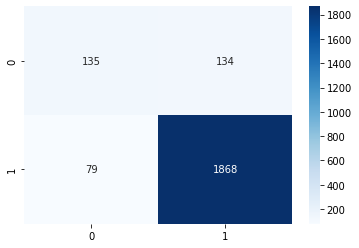

In [ ]:
import seaborn as sns

TPsum = np.sum(TPs)
TNsum = np.sum(TNs)
FPsum = np.sum(FPs)
FNsum = np.sum(FNs)


cm_data = [[TPsum, FNsum], [FPsum, TNsum]]
sns.heatmap(cm_data, annot=True, cmap='Blues', fmt='d')

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
RFWithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([RFWithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC        F1  ...   TP         TN        FP        FN
Average  15.5  0.903937  0.726723  0.540097  ...  4.5  62.266667  2.633333  4.466667

[1 rows x 11 columns]


In [ ]:
RFWithSMOTE = RFWithSMOTE.append(df_temp)

In [ ]:
print(RFWithSMOTE)
RFWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/Personalized/RFPersonalizedSMOTE.csv', index = True)

         User  Accuracy   ROC_AUC  ...         TN        FP        FN
0         1.0  0.918919  0.742188  ...  63.000000  1.000000  5.000000
1         2.0  0.918919  0.879902  ...  63.000000  5.000000  1.000000
2         3.0  0.918919  0.784375  ...  62.000000  2.000000  4.000000
3         4.0  0.959459  0.908602  ...  61.000000  1.000000  2.000000
4         5.0  0.864865  0.733045  ...  58.000000  5.000000  5.000000
5         6.0  0.905405  0.782197  ...  62.000000  4.000000  3.000000
6         7.0  0.972603  0.888889  ...  64.000000  0.000000  2.000000
7         8.0  0.905405  0.706838  ...  63.000000  2.000000  5.000000
8         9.0  0.945946  0.842187  ...  63.000000  1.000000  3.000000
9        10.0  0.904110  0.627706  ...  64.000000  2.000000  5.000000
10       11.0  0.918919  0.679924  ...  65.000000  1.000000  5.000000
11       12.0  0.878378  0.643590  ...  62.000000  3.000000  6.000000
12       13.0  0.932432  0.742424  ...  65.000000  1.000000  4.000000
13       14.0  0.932

###Descision Tree

####Model

In [ ]:
from sklearn.tree import DecisionTreeClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_dt = DecisionTreeClassifier()
    tic = time.time()
    model_dt.fit(X_train, y_train) 
    toc = time.time()
    print("Decision Tree Train time = " + str(toc-tic))
    print("Decision Tree Accuracy = "+ str(model_dt.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_dt.predict(X_test)
    yhat_classes = (model_dt.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Decision Tree Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Decision Tree Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

Decision Tree Train time = 0.006510734558105469
Decision Tree Accuracy = 0.8378378378378378
Decision Tree Test time = 0.005105018615722656
(74,)
(74,)
___________________Decision Tree Stats _____________________
Accuracy: 0.837838
True negatives: 57
True positives: 5
False positives: 7
False negatives: 5
ROC AUC: 0.695312
F1 Score: 0.454545
Precision: 0.416667
TPR: 0.500000
FPR: 0.109375
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.007089376449584961
Decision Tree Accuracy = 0.8513513513513513
Decision Tree Test time = 0.004432201385498047
(74,)
(74,)
___________________Decision Tree Stats _____________________
Accuracy: 0.851351
True negatives: 61
True positives: 2
False positives: 7
False negatives: 4
ROC AUC: 0.615196
F1 Score: 0.266667
Precision: 0.222222
TPR: 0.333333
FPR: 0.102941
____________________________________________________________
___________________________________

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
DTWithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DTWithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC  ...         TN        FP        FN
Average  15.5  0.889467  0.736777  ...  60.866667  4.033333  4.133333

[1 rows x 11 columns]


In [ ]:
DTWithSMOTE = DTWithSMOTE.append(df_temp)

In [ ]:
print(DTWithSMOTE)
DTWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/Personalized/DTPersonalizedSMOTE.csv', index = True)

         User  Accuracy   ROC_AUC  ...         TN        FP         FN
0         1.0  0.837838  0.695312  ...  57.000000  7.000000   5.000000
1         2.0  0.851351  0.615196  ...  61.000000  7.000000   4.000000
2         3.0  0.932432  0.792188  ...  63.000000  1.000000   4.000000
3         4.0  0.918919  0.850806  ...  59.000000  3.000000   3.000000
4         5.0  0.878378  0.778499  ...  58.000000  5.000000   4.000000
5         6.0  0.891892  0.774621  ...  61.000000  5.000000   3.000000
6         7.0  0.958904  0.881076  ...  63.000000  1.000000   2.000000
7         8.0  0.932432  0.770085  ...  64.000000  1.000000   4.000000
8         9.0  0.891892  0.684375  ...  62.000000  2.000000   6.000000
9        10.0  0.835616  0.589827  ...  59.000000  7.000000   5.000000
10       11.0  0.945946  0.859848  ...  64.000000  2.000000   2.000000
11       12.0  0.837838  0.620513  ...  59.000000  6.000000   6.000000
12       13.0  0.945946  0.750000  ...  66.000000  0.000000   4.000000
13    

###Gradient Boost

####Model

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_gb = GradientBoostingClassifier(n_estimators = 1000) 
    tic = time.time()
    model_gb.fit(X_train, y_train) 
    toc = time.time()
    print("Gradient Boost Train time = " + str(toc-tic))
    print("Gradient Boost Accuracy = "+ str(model_gb.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_gb.predict(X_test)
    yhat_classes = (model_gb.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Gradient Boost Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Gradient Boost Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.4638214111328125
Gradient Boost Accuracy = 0.8918918918918919
Gradient Boost Test time = 0.009495019912719727
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.891892
True negatives: 60
True positives: 6
False positives: 4
False negatives: 4
ROC AUC: 0.768750
F1 Score: 0.600000
Precision: 0.600000
TPR: 0.600000
FPR: 0.062500
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.1133151054382324
Gradient Boost Accuracy = 0.9054054054054054
Gradient Boost Test time = 0.011788129806518555
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.905405
True negatives: 63
True positives: 4
False positives: 5
False negatives: 2
ROC AUC: 0.796569
F1 Score: 0.533333
Precision: 0.444444
TPR: 0.666667
FPR: 0.073529
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.5193417072296143
Gradient Boost Accuracy = 0.9594594594594594
Gradient Boost Test time = 0.012352228164672852
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.959459
True negatives: 63
True positives: 8
False positives: 1
False negatives: 2
ROC AUC: 0.892188
F1 Score: 0.842105
Precision: 0.888889
TPR: 0.800000
FPR: 0.015625
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.8517186641693115
Gradient Boost Accuracy = 0.918918918918919
Gradient Boost Test time = 0.008161544799804688
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.918919
True negatives: 59
True positives: 9
False positives: 3
False negatives: 3
ROC AUC: 0.850806
F1 Score: 0.750000
Precision: 0.750000
TPR: 0.750000
FPR: 0.048387
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.5863661766052246
Gradient Boost Accuracy = 0.918918918918919
Gradient Boost Test time = 0.01015329360961914
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.918919
True negatives: 59
True positives: 9
False positives: 4
False negatives: 2
ROC AUC: 0.877345
F1 Score: 0.750000
Precision: 0.692308
TPR: 0.818182
FPR: 0.063492
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.6360466480255127
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.01080179214477539
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 63
True positives: 7
False positives: 3
False negatives: 1
ROC AUC: 0.914773
F1 Score: 0.777778
Precision: 0.700000
TPR: 0.875000
FPR: 0.045455
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.55362868309021
Gradient Boost Accuracy = 0.9726027397260274
Gradient Boost Test time = 0.010222911834716797
(73,)
(73,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.972603
True negatives: 64
True positives: 7
False positives: 0
False negatives: 2
ROC AUC: 0.888889
F1 Score: 0.875000
Precision: 1.000000
TPR: 0.777778
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.417189121246338
Gradient Boost Accuracy = 0.9864864864864865
Gradient Boost Test time = 0.010197877883911133
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.986486
True negatives: 65
True positives: 8
False positives: 0
False negatives: 1
ROC AUC: 0.944444
F1 Score: 0.941176
Precision: 1.000000
TPR: 0.888889
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.312000036239624
Gradient Boost Accuracy = 0.9594594594594594
Gradient Boost Test time = 0.009623050689697266
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.959459
True negatives: 64
True positives: 7
False positives: 0
False negatives: 3
ROC AUC: 0.850000
F1 Score: 0.823529
Precision: 1.000000
TPR: 0.700000
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.614595651626587
Gradient Boost Accuracy = 0.9726027397260274
Gradient Boost Test time = 0.010738849639892578
(73,)
(73,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.972603
True negatives: 65
True positives: 6
False positives: 1
False negatives: 1
ROC AUC: 0.920996
F1 Score: 0.857143
Precision: 0.857143
TPR: 0.857143
FPR: 0.015152
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.296440839767456
Gradient Boost Accuracy = 0.9324324324324325
Gradient Boost Test time = 0.009976625442504883
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.932432
True negatives: 65
True positives: 4
False positives: 1
False negatives: 4
ROC AUC: 0.742424
F1 Score: 0.615385
Precision: 0.800000
TPR: 0.500000
FPR: 0.015152
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.3963630199432373
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.010858774185180664
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 63
True positives: 7
False positives: 2
False negatives: 2
ROC AUC: 0.873504
F1 Score: 0.777778
Precision: 0.777778
TPR: 0.777778
FPR: 0.030769
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.62270188331604
Gradient Boost Accuracy = 0.9594594594594594
Gradient Boost Test time = 0.010221481323242188
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.959459
True negatives: 66
True positives: 5
False positives: 0
False negatives: 3
ROC AUC: 0.812500
F1 Score: 0.769231
Precision: 1.000000
TPR: 0.625000
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.3470377922058105
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.010799884796142578
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 67
True positives: 3
False positives: 0
False negatives: 4
ROC AUC: 0.714286
F1 Score: 0.600000
Precision: 1.000000
TPR: 0.428571
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.2912273406982422
Gradient Boost Accuracy = 0.972972972972973
Gradient Boost Test time = 0.009682655334472656
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.972973
True negatives: 64
True positives: 8
False positives: 1
False negatives: 1
ROC AUC: 0.936752
F1 Score: 0.888889
Precision: 0.888889
TPR: 0.888889
FPR: 0.015385
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.414259672164917
Gradient Boost Accuracy = 0.9054054054054054
Gradient Boost Test time = 0.010180473327636719
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.905405
True negatives: 61
True positives: 6
False positives: 5
False negatives: 2
ROC AUC: 0.837121
F1 Score: 0.631579
Precision: 0.545455
TPR: 0.750000
FPR: 0.075758
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.5638175010681152
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.010454654693603516
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 63
True positives: 7
False positives: 2
False negatives: 2
ROC AUC: 0.873504
F1 Score: 0.777778
Precision: 0.777778
TPR: 0.777778
FPR: 0.030769
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.4044744968414307
Gradient Boost Accuracy = 0.9452054794520548
Gradient Boost Test time = 0.010190010070800781
(73,)
(73,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945205
True negatives: 64
True positives: 5
False positives: 2
False negatives: 2
ROC AUC: 0.841991
F1 Score: 0.714286
Precision: 0.714286
TPR: 0.714286
FPR: 0.030303
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.6202917098999023
Gradient Boost Accuracy = 0.918918918918919
Gradient Boost Test time = 0.012026309967041016
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.918919
True negatives: 58
True positives: 10
False positives: 4
False negatives: 2
ROC AUC: 0.884409
F1 Score: 0.769231
Precision: 0.714286
TPR: 0.833333
FPR: 0.064516
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.402846097946167
Gradient Boost Accuracy = 0.9324324324324325
Gradient Boost Test time = 0.010272502899169922
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.932432
True negatives: 61
True positives: 8
False positives: 3
False negatives: 2
ROC AUC: 0.876563
F1 Score: 0.761905
Precision: 0.727273
TPR: 0.800000
FPR: 0.046875
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.8797156810760498
Gradient Boost Accuracy = 0.8783783783783784
Gradient Boost Test time = 0.01251840591430664
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.878378
True negatives: 63
True positives: 2
False positives: 1
False negatives: 8
ROC AUC: 0.592187
F1 Score: 0.307692
Precision: 0.666667
TPR: 0.200000
FPR: 0.015625
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.1250009536743164
Gradient Boost Accuracy = 0.9594594594594594
Gradient Boost Test time = 0.009478330612182617
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.959459
True negatives: 63
True positives: 8
False positives: 3
False negatives: 0
ROC AUC: 0.977273
F1 Score: 0.842105
Precision: 0.727273
TPR: 1.000000
FPR: 0.045455
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.5851140022277832
Gradient Boost Accuracy = 0.9054054054054054
Gradient Boost Test time = 0.010190486907958984
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.905405
True negatives: 62
True positives: 5
False positives: 2
False negatives: 5
ROC AUC: 0.734375
F1 Score: 0.588235
Precision: 0.714286
TPR: 0.500000
FPR: 0.031250
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.527937889099121
Gradient Boost Accuracy = 0.8378378378378378
Gradient Boost Test time = 0.010304689407348633
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.837838
True negatives: 58
True positives: 4
False positives: 7
False negatives: 5
ROC AUC: 0.668376
F1 Score: 0.400000
Precision: 0.363636
TPR: 0.444444
FPR: 0.107692
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.7746162414550781
Gradient Boost Accuracy = 0.8648648648648649
Gradient Boost Test time = 0.010701179504394531
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.864865
True negatives: 59
True positives: 5
False positives: 4
False negatives: 6
ROC AUC: 0.695527
F1 Score: 0.500000
Precision: 0.555556
TPR: 0.454545
FPR: 0.063492
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.1043837070465088
Gradient Boost Accuracy = 0.9452054794520548
Gradient Boost Test time = 0.009057044982910156
(73,)
(73,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945205
True negatives: 64
True positives: 5
False positives: 2
False negatives: 2
ROC AUC: 0.841991
F1 Score: 0.714286
Precision: 0.714286
TPR: 0.714286
FPR: 0.030303
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.2931640148162842
Gradient Boost Accuracy = 0.8783783783783784
Gradient Boost Test time = 0.009925365447998047
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.878378
True negatives: 58
True positives: 7
False positives: 6
False negatives: 3
ROC AUC: 0.803125
F1 Score: 0.608696
Precision: 0.538462
TPR: 0.700000
FPR: 0.093750
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.820239543914795
Gradient Boost Accuracy = 0.8513513513513513
Gradient Boost Test time = 0.01154184341430664
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.851351
True negatives: 61
True positives: 2
False positives: 5
False negatives: 6
ROC AUC: 0.587121
F1 Score: 0.266667
Precision: 0.285714
TPR: 0.250000
FPR: 0.075758
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.5769972801208496
Gradient Boost Accuracy = 0.972972972972973
Gradient Boost Test time = 0.010791778564453125
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.972973
True negatives: 65
True positives: 7
False positives: 1
False negatives: 1
ROC AUC: 0.929924
F1 Score: 0.875000
Precision: 0.875000
TPR: 0.875000
FPR: 0.015152
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.4586005210876465
Gradient Boost Accuracy = 0.918918918918919
Gradient Boost Test time = 0.01004481315612793
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.918919
True negatives: 65
True positives: 3
False positives: 0
False negatives: 6
ROC AUC: 0.666667
F1 Score: 0.500000
Precision: 1.000000
TPR: 0.333333
FPR: 0.000000
____________________________________________________________
____________________________________________________________


#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
GBWithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([GBWithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC        F1  ...        TP    TN   FP   FN
Average  15.5  0.928304  0.819813  0.688627  ...  6.066667  62.5  2.4  2.9

[1 rows x 11 columns]


In [ ]:
GBWithSMOTE = GBWithSMOTE.append(df_temp)

In [ ]:
print(GBWithSMOTE)
GBWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/Personalized/GBPersonalizedSMOTE.csv', index = True)

         User  Accuracy   ROC_AUC        F1  ...         TP    TN   FP   FN
0         1.0  0.891892  0.768750  0.600000  ...   6.000000  60.0  4.0  4.0
1         2.0  0.905405  0.796569  0.533333  ...   4.000000  63.0  5.0  2.0
2         3.0  0.959459  0.892188  0.842105  ...   8.000000  63.0  1.0  2.0
3         4.0  0.918919  0.850806  0.750000  ...   9.000000  59.0  3.0  3.0
4         5.0  0.918919  0.877345  0.750000  ...   9.000000  59.0  4.0  2.0
5         6.0  0.945946  0.914773  0.777778  ...   7.000000  63.0  3.0  1.0
6         7.0  0.972603  0.888889  0.875000  ...   7.000000  64.0  0.0  2.0
7         8.0  0.986486  0.944444  0.941176  ...   8.000000  65.0  0.0  1.0
8         9.0  0.959459  0.850000  0.823529  ...   7.000000  64.0  0.0  3.0
9        10.0  0.972603  0.920996  0.857143  ...   6.000000  65.0  1.0  1.0
10       11.0  0.932432  0.742424  0.615385  ...   4.000000  65.0  1.0  4.0
11       12.0  0.945946  0.873504  0.777778  ...   7.000000  63.0  2.0  2.0
12       13.

###3 DNN

#### Model

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model3 = Sequential()

    model3.add(Dense(64, activation='relu', input_shape=(15,)))
    model3.add(Dropout(0.3))
    model3.add(Dense(32, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(8, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(1, activation='sigmoid'))

    model3.compile(loss='binary_crossentropy',
                  optimizer='adam',
                  metrics=['accuracy'])
    reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=0.001)
    tic = time.time()
    model3.fit(X_train, y_train, batch_size=64, epochs=100, validation_split=0.1, callbacks=[reduce_lr])
    toc = time.time()
    print("3 DNN Train time = " + str(toc-tic))
    print("3 DNN Accuracy = "+ str(model3.evaluate(X_test, y_test, verbose=0)[1]))
    tic = time.time()
    yhat_probs = model3.predict(X_test, verbose=0)
    yhat_classes = (model3.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("3 DNN Test time = " + str(toc-tic))
    yhat_probs = yhat_probs[:, 0]
    yhat_classes = yhat_classes[:, 0]
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________3 DNN Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

Streaming output truncated to the last 5000 lines.
Epoch 8/100
5/5 [==============================] - 0s 18ms/step - loss: 0.6771 - accuracy: 0.6162 - val_loss: 0.6610 - val_accuracy: 0.6129 - lr: 0.0010
Epoch 9/100
5/5 [==============================] - 0s 17ms/step - loss: 0.6230 - accuracy: 0.6199 - val_loss: 0.6483 - val_accuracy: 0.6129 - lr: 0.0010
Epoch 10/100
5/5 [==============================] - 0s 20ms/step - loss: 0.6285 - accuracy: 0.6421 - val_loss: 0.6348 - val_accuracy: 0.6129 - lr: 0.0010
Epoch 11/100
5/5 [==============================] - 0s 20ms/step - loss: 0.6247 - accuracy: 0.6568 - val_loss: 0.6133 - val_accuracy: 0.6774 - lr: 0.0010
Epoch 12/100
5/5 [==============================] - 0s 18ms/step - loss: 0.6389 - accuracy: 0.6605 - val_loss: 0.5944 - val_accuracy: 0.7419 - lr: 0.0010
Epoch 13/100
5/5 [==============================] - 0s 19ms/step - loss: 0.6208 - accuracy: 0.6679 - val_loss: 0.5870 - val_accuracy: 0.8065 - lr: 0.0010
Epoch 14/100
5/5 [=========

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
DNN3WithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DNN3WithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC        F1  ...   TP    TN   FP        FN
Average  15.5  0.915186  0.897373  0.670936  ...  6.3  61.3  3.6  2.666667

[1 rows x 11 columns]


In [ ]:
DNN3WithSMOTE = DNN3WithSMOTE.append(df_temp)

In [ ]:
print(DNN3WithSMOTE)
DNN3WithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/Personalized/DNNPersonalizedSMOTE.csv', index = True)

         User  Accuracy   ROC_AUC        F1  ...    TP    TN    FP        FN
0         1.0  0.878378  0.871875  0.526316  ...   5.0  60.0   4.0  5.000000
1         2.0  0.918919  0.968137  0.571429  ...   4.0  64.0   4.0  2.000000
2         3.0  0.972973  0.992188  0.909091  ...  10.0  62.0   2.0  0.000000
3         4.0  0.918919  0.985215  0.800000  ...  12.0  56.0   6.0  0.000000
4         5.0  0.918919  0.870130  0.750000  ...   9.0  59.0   4.0  2.000000
5         6.0  0.945946  0.937500  0.750000  ...   6.0  64.0   2.0  2.000000
6         7.0  0.835616  0.921875  0.538462  ...   7.0  54.0  10.0  2.000000
7         8.0  0.959459  0.986325  0.823529  ...   7.0  64.0   1.0  2.000000
8         9.0  0.972973  0.978125  0.888889  ...   8.0  64.0   0.0  2.000000
9        10.0  0.972603  0.995671  0.857143  ...   6.0  65.0   1.0  1.000000
10       11.0  0.918919  0.918561  0.500000  ...   3.0  65.0   1.0  5.000000
11       12.0  0.891892  0.799145  0.500000  ...   4.0  62.0   3.0  5.000000

# Personalized models without SMOTE but with Normalisation

## Data Processing

### Import dataset

In [ ]:
directory_all = "/content/drive/MyDrive/Surjya Sir Work/5000"
directory_pbd = "/content/drive/MyDrive/Surjya Sir Work/5000_probed"

In [ ]:
videos = [1,2,3,4,5,6,7,8]

In [ ]:
all = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_all + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    all.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 5
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 6
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


In [ ]:
probed = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_pbd + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    probed.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 5
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 6
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


### Create df

In [ ]:
df = pd.DataFrame()
for i in range(len(all)):#per video = 8
  for j in range(len(all[i])): #per subject = 30
    df = df.append(all[i][j], ignore_index=True)

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8


In [ ]:
tester = pd.DataFrame()
for i in range(len(probed)):#per video = 8
  for j in range(len(probed[i])): #per subject = 30
    tester = tester.append(probed[i][j], ignore_index=True)

In [ ]:
tester

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1738876.01,1743876.01,1748876.01,6.309,5.096,0.013,0.106,5.632759,0.600,0.378,0.155,0.010,0.369,1.642,8.131,10,1
1,832168.01,837168.01,842168.01,6.488,5.290,0.012,0.159,1.883567,0.300,3.623,0.126,0.021,0.657,0.246,0.000,11,1
2,907168.01,912168.01,917168.01,5.330,4.958,0.394,0.082,3.340205,0.103,3.119,0.136,0.004,7.022,0.699,0.123,11,1
3,917168.01,922168.01,927168.01,6.046,5.011,0.767,0.003,2.078420,0.213,0.785,0.136,0.007,4.846,0.041,0.040,11,1
4,922168.01,927168.01,932168.01,6.476,5.014,0.430,0.022,2.208317,0.307,4.601,0.068,0.010,4.148,1.191,0.288,11,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
843,2282834.01,2287834.01,2292834.01,2.090,7.542,0.918,0.586,3.800016,3.170,4.349,0.261,0.003,0.082,2.916,1.602,8,8
844,2287834.01,2292834.01,2297834.01,1.199,8.115,1.181,0.661,5.052202,4.889,8.049,1.549,0.039,0.164,1.315,2.587,8,8
845,1166459.01,1171459.01,1176459.01,3.156,6.595,0.518,0.543,4.114055,0.256,0.368,4.792,0.011,2.998,3.368,13.429,9,8
846,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8


In [ ]:
temp = df[df.isin(tester)].dropna()

In [ ]:
temp = df.loc[df.set_index(list(df.columns)).index.isin(tester.set_index(list(tester.columns)).index)]

In [ ]:
temp.index

Int64Index([  35,   47,   62,   64,   65,   70,   99,  107,  117,  118,
            ...
            7191, 7212, 7231, 7234, 7239, 7255, 7256, 7284, 7285, 7286],
           dtype='int64', length=848)

In [ ]:
df['Probe'] = 0

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,0
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,0
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
for idx in temp.index:
  df.at[idx, 'Probe'] = 1

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


### Optimise df

In [ ]:
df = df.drop(columns=["Start", "Border", "End"], axis=1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
df['valence_acc_video'] = 0
df['arousal_acc_video'] = 0

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,0,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,0,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,0,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,0,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,0
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,0
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,0
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,0


I'm using the following encoding: 

1 - Low
2 - Mid/high
3 - High

In [ ]:
# def basedOnVideoValence(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 2
#     if int(video) == 6:
#         return 2
#     if int(video) == 7:
#         return 1
#     if int(video) == 8:
#         return 1
    
# def basedOnVideoArousal(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 1
#     if int(video) == 6:
#         return 1
#     if int(video) == 7:
#         return 3
#     if int(video) == 8:
#         return 3

New encoding, 
Low - 0 
Med / High - 1

In [ ]:
def basedOnVideoValence(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 1
    if int(video) == 6:
        return 1
    if int(video) == 7:
        return 0
    if int(video) == 8:
        return 0
    
def basedOnVideoArousal(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 0
    if int(video) == 6:
        return 0
    if int(video) == 7:
        return 1
    if int(video) == 8:
        return 1

In [ ]:
df['valence_acc_video'] = df.apply(lambda row : basedOnVideoValence(row['video']), axis = 1)
df['arousal_acc_video'] = df.apply(lambda row : basedOnVideoArousal(row['video']), axis = 1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1


### Normalize Scores across users

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1


In [ ]:
users = []
for i in range(1, 31):
  users.append(i)

print(users)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30]


In [ ]:
df_final = pd.DataFrame(columns=df.columns.values.tolist())

data = []

for user in users:
  #Score = []
  df_new = df[df['subject'] == str(user)]
  # for video in videos:
  #   df_selected = df_new[df_new['video'] == video]
  #   temp = df_selected['Score'].tolist()  
  #   Score.append(temp)
  score = df_new['Score'].tolist()
  norm = [(float(i)-min(score))/(max(score)-min(score)) for i in score]
  #print(df_new.Score)
  df_new['Score'] = norm
  #print(df_new.Score)
  df_final = df_final.append(df_new)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  from ipykernel import kernelapp as app


In [ ]:
df_final

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
360,6.888,5.266,2.231,0.739,0.054901,0.059,1.637,0.097,0.007,0.452,1.232,0.040,1,1,0,1,1
361,7.231,5.739,0.711,0.835,0.035254,0.067,0.368,0.029,0.021,0.739,0.000,0.082,1,1,0,1,1
362,7.599,6.101,0.603,0.468,0.105832,0.035,0.427,0.068,0.010,0.000,1.026,0.000,1,1,0,1,1
363,7.834,6.207,0.235,0.106,0.065427,0.067,2.751,0.049,0.011,0.944,0.164,0.329,1,1,0,1,1
364,7.834,6.207,0.000,0.011,0.074890,0.075,2.713,0.058,0.011,0.411,0.123,0.123,1,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7096,0.500,9.500,0.383,2.208,0.028595,0.331,1.134,1.810,0.000,3.491,4.887,0.493,30,8,0,0,1
7097,0.500,9.500,0.000,0.000,0.029820,0.312,0.474,1.094,0.007,0.452,4.805,0.821,30,8,0,0,1
7098,0.500,9.500,0.000,0.000,0.074199,0.047,1.153,1.297,0.000,2.875,2.834,1.109,30,8,0,0,1
7099,0.500,9.500,0.000,0.606,0.043119,0.059,0.678,0.164,0.017,2.546,3.039,1.889,30,8,0,0,1


In [ ]:
df = df_final

In [ ]:
df = df.dropna()

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
360,6.888,5.266,2.231,0.739,0.054901,0.059,1.637,0.097,0.007,0.452,1.232,0.040,1,1,0,1,1
361,7.231,5.739,0.711,0.835,0.035254,0.067,0.368,0.029,0.021,0.739,0.000,0.082,1,1,0,1,1
362,7.599,6.101,0.603,0.468,0.105832,0.035,0.427,0.068,0.010,0.000,1.026,0.000,1,1,0,1,1
363,7.834,6.207,0.235,0.106,0.065427,0.067,2.751,0.049,0.011,0.944,0.164,0.329,1,1,0,1,1
364,7.834,6.207,0.000,0.011,0.074890,0.075,2.713,0.058,0.011,0.411,0.123,0.123,1,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7096,0.500,9.500,0.383,2.208,0.028595,0.331,1.134,1.810,0.000,3.491,4.887,0.493,30,8,0,0,1
7097,0.500,9.500,0.000,0.000,0.029820,0.312,0.474,1.094,0.007,0.452,4.805,0.821,30,8,0,0,1
7098,0.500,9.500,0.000,0.000,0.074199,0.047,1.153,1.297,0.000,2.875,2.834,1.109,30,8,0,0,1
7099,0.500,9.500,0.000,0.606,0.043119,0.059,0.678,0.164,0.017,2.546,3.039,1.889,30,8,0,0,1


### X,y for personalized models

In [ ]:
X_train_all = []
y_train_all = []
X_test_all = []
y_test_all = []

In [ ]:
users = []
for i in range(1, 31):
  users.append(i)

print(users)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30]


In [ ]:
for user in users:
  print("User", user)
  X_train = pd.DataFrame()
  y_train = pd.DataFrame()
  X_test = pd.DataFrame()
  y_test = pd.DataFrame()
  df_new = df[df['subject'] == str(user)]
  df_probe = df_new[df_new['Probe'] == 1]
  df_nonprobe = df_new[df_new['Probe'] == 0]

  y_probe = df_probe['Probe']
  y_nonprobe = df_nonprobe['Probe']

  y_probe = pd.DataFrame(y_probe)
  y_nonprobe = pd.DataFrame(y_nonprobe)

  X_probe = df_probe.drop(columns=["Probe"], axis = 1)
  X_nonprobe = df_nonprobe.drop(columns=["Probe"], axis = 1)

  X_train_probe, X_test_probe, y_train_probe, y_test_probe = train_test_split(X_probe, y_probe, test_size = 0.3)
  X_train_nonprobe, X_test_nonprobe, y_train_nonprobe, y_test_nonprobe = train_test_split(X_nonprobe, y_nonprobe, test_size = 0.3)

  X_train = X_train.append(X_train_probe)
  X_train = X_train.append(X_train_nonprobe)
  X_test = X_test.append(X_test_probe)
  X_test = X_test.append(X_test_nonprobe)
  y_train = y_train.append(y_train_probe)
  y_train = y_train.append(y_train_nonprobe)
  y_test = y_test.append(y_test_probe)
  y_test = y_test.append(y_test_nonprobe)


  
  # for video in videos:
  #   print("    Video", video)
  #   df_selected = df_new[df_new['video'] == video]
  #   df_probe = df_selected[df_selected['Probe'] == 1]
  #   df_nonprobe = df_selected[df_selected['Probe'] == 0]

  #   y_probe = df_probe['Probe']
  #   y_nonprobe = df_nonprobe['Probe']

  #   y_probe = pd.DataFrame(y_probe)
  #   y_nonprobe = pd.DataFrame(y_nonprobe)

  #   X_probe = df_probe.drop(columns=["Probe"], axis = 1)
  #   X_nonprobe = df_nonprobe.drop(columns=["Probe"], axis = 1)

  #   X_train_probe, X_test_probe, y_train_probe, y_test_probe = train_test_split(X_probe, y_probe, test_size = 0.5)
  #   X_train_nonprobe, X_test_nonprobe, y_train_nonprobe, y_test_nonprobe = train_test_split(X_nonprobe, y_nonprobe, test_size = 0.2)
  
  #   X_train = X_train.append(X_train_probe)
  #   X_train = X_train.append(X_train_nonprobe)
  #   X_test = X_test.append(X_test_probe)
  #   X_test = X_test.append(X_test_nonprobe)
  #   y_train = y_train.append(y_train_probe)
  #   y_train = y_train.append(y_train_nonprobe)
  #   y_test = y_test.append(y_test_probe)
  #   y_test = y_test.append(y_test_nonprobe)
  X_train_all.append(X_train)
  y_train_all.append(y_train)
  X_test_all.append(X_test)
  y_test_all.append(y_test)

User 1
User 2
User 3
User 4
User 5
User 6
User 7
User 8
User 9
User 10
User 11
User 12
User 13
User 14
User 15
User 16
User 17
User 18
User 19
User 20
User 21
User 22
User 23
User 24
User 25
User 26
User 27
User 28
User 29
User 30


In [ ]:
print(len(X_train_all[29]['subject'].unique()))

1


In [ ]:
X_train_all[2]

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,valence_acc_video,arousal_acc_video
5169,6.061,4.824,0.011,0.072,0.397376,3.102,0.301,1.859,0.007,16.017,0.164,0.329,3,6,1,0
6244,2.000,8.741,0.005,0.096,0.577957,0.600,2.111,0.426,0.021,4.887,0.165,0.247,3,7,0,1
5171,5.954,5.014,0.415,0.194,0.699382,1.270,0.175,0.649,0.024,18.727,0.328,0.863,3,6,1,0
4314,6.089,4.165,0.169,0.908,0.310158,0.248,0.998,0.668,0.003,3.368,0.657,12.813,3,5,1,0
6240,1.532,9.500,0.218,0.000,0.730290,0.627,2.237,1.346,0.000,1.971,9.446,0.616,3,7,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5157,6.063,4.787,0.001,0.000,0.073292,0.638,0.407,0.009,0.014,0.247,0.041,0.124,3,6,1,0
1847,6.880,4.789,0.000,0.074,0.003028,0.292,0.223,1.268,0.018,0.206,0.328,0.124,3,2,1,1
7106,2.915,7.014,2.467,1.189,0.034536,0.505,0.280,0.348,0.007,0.081,2.833,0.041,3,8,0,1
6242,1.966,9.135,0.255,0.856,0.029007,1.002,2.576,0.426,0.010,1.150,0.411,0.411,3,7,0,1


In [ ]:
new_X_train_all = []

for i in range(len(X_train_all)):
    df_temp = X_train_all[i]
    df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    new_X_train_all.append(df_temp)

X_train_all = new_X_train_all

new_X_test_all = []

for i in range(len(X_test_all)):
    df_temp = X_test_all[i]
    df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    new_X_test_all.append(df_temp)

X_test_all = new_X_test_all

In [ ]:
for i in range(len(users)):
  X_train_all[i] = np.asarray(X_train_all[i]).astype('float32') 
  X_test_all[i] = np.asarray(X_test_all[i]).astype('float32') 
  y_train_all[i] = y_train_all[i].astype('int') 
  y_test_all[i] = y_test_all[i].astype('int') 

In [ ]:
X_train_all[2]

array([[6.061e+00, 4.824e+00, 1.100e-02, ..., 3.290e-01, 1.000e+00,
        0.000e+00],
       [2.000e+00, 8.741e+00, 5.000e-03, ..., 2.470e-01, 0.000e+00,
        1.000e+00],
       [5.954e+00, 5.014e+00, 4.150e-01, ..., 8.630e-01, 1.000e+00,
        0.000e+00],
       ...,
       [2.915e+00, 7.014e+00, 2.467e+00, ..., 4.100e-02, 0.000e+00,
        1.000e+00],
       [1.966e+00, 9.135e+00, 2.550e-01, ..., 4.110e-01, 0.000e+00,
        1.000e+00],
       [2.005e+00, 8.544e+00, 1.200e-02, ..., 1.240e-01, 0.000e+00,
        1.000e+00]], dtype=float32)

In [ ]:
y_test_all[7]

,Probe
1040,1
2022,1
4444,1
5296,1
2696,1
...,...
5293,0
3605,0
6423,0
2699,0


## Models

###RandomForest

#### Model

In [ ]:
from sklearn.ensemble import RandomForestClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []

TPs = []
FPs = []
FNs = []
TNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_rf = RandomForestClassifier() 
    tic = time.time()
    print("X_train_size = ", str(len(X_train)))
    print("X_test_size = ", str(len(X_test)))
    model_rf.fit(X_train, y_train) 
    toc = time.time()
    print("Random Forest Train time = " + str(toc-tic))
    print("Random Forest Accuracy = "+ str(model_rf.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_rf.predict(X_test)
    print("yhat_probs",yhat_probs)
    yhat_classes = (model_rf.predict(X_test) > 0.5).astype("int32")
    print("yhat_classes",yhat_classes)
    toc = time.time()
    print("Random Forest Test time = " + str(toc-tic))

    print("___________________Random Forest Stats _____________________")

    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.28036928176879883
Random Forest Accuracy = 0.8918918918918919
yhat_probs [1 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.06279182434082031
___________________Random Forest Stats _____________________
Accuracy: 0.891892
True negatives: 63
True positives: 3
False positives: 1
False negatives: 7
ROC AUC: 0.642188
F1 Score: 0.428571
Precision: 0.750000
TPR: 0.300000
FPR: 0.015625
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2744412422180176
Random Forest Accuracy = 0.9324324324324325
yhat_probs [1 1 1 1 1 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0
 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 1 1 1 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0
 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04595160484313965
___________________Random Forest Stats _____________________
Accuracy: 0.932432
True negatives: 63
True positives: 6
False positives: 5
False negatives: 0
ROC AUC: 0.963235
F1 Score: 0.705882
Precision: 0.545455
TPR: 1.000000
FPR: 0.073529
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2915468215942383
Random Forest Accuracy = 0.9054054054054054
yhat_probs [0 0 1 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04494452476501465
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 64
True positives: 3
False positives: 0
False negatives: 7
ROC AUC: 0.650000
F1 Score: 0.461538
Precision: 1.000000
TPR: 0.300000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.27411699295043945
Random Forest Accuracy = 0.9594594594594594
yhat_probs [1 0 1 1 1 0 1 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 1 1 1 0 1 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.044860124588012695
___________________Random Forest Stats _____________________
Accuracy: 0.959459
True negatives: 62
True positives: 9
False positives: 0
False negatives: 3
ROC AUC: 0.875000
F1 Score: 0.857143
Precision: 1.000000
TPR: 0.750000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2739999294281006
Random Forest Accuracy = 0.9054054054054054
yhat_probs [0 0 1 0 1 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 0 1 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04356241226196289
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 63
True positives: 4
False positives: 0
False negatives: 7
ROC AUC: 0.681818
F1 Score: 0.533333
Precision: 1.000000
TPR: 0.363636
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2872147560119629
Random Forest Accuracy = 0.918918918918919
yhat_probs [0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.043761491775512695
___________________Random Forest Stats _____________________
Accuracy: 0.918919
True negatives: 66
True positives: 2
False positives: 0
False negatives: 6
ROC AUC: 0.625000
F1 Score: 0.400000
Precision: 1.000000
TPR: 0.250000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  170
X_test_size =  73


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2845344543457031
Random Forest Accuracy = 0.9452054794520548
yhat_probs [0 0 1 1 0 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 1 0 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04876828193664551
___________________Random Forest Stats _____________________
Accuracy: 0.945205
True negatives: 64
True positives: 5
False positives: 0
False negatives: 4
ROC AUC: 0.777778
F1 Score: 0.714286
Precision: 1.000000
TPR: 0.555556
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2908012866973877
Random Forest Accuracy = 0.8918918918918919
yhat_probs [0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04169416427612305
___________________Random Forest Stats _____________________
Accuracy: 0.891892
True negatives: 65
True positives: 1
False positives: 0
False negatives: 8
ROC AUC: 0.555556
F1 Score: 0.200000
Precision: 1.000000
TPR: 0.111111
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.29228711128234863
Random Forest Accuracy = 0.918918918918919
yhat_probs [1 1 1 1 0 1 0 1 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0]
yhat_classes [1 1 1 1 0 1 0 1 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0]
Random Forest Test time = 0.04640364646911621
___________________Random Forest Stats _____________________
Accuracy: 0.918919
True negatives: 60
True positives: 8
False positives: 4
False negatives: 2
ROC AUC: 0.868750
F1 Score: 0.727273
Precision: 0.666667
TPR: 0.800000
FPR: 0.062500
____________________________________________________________
____________________________________________________________
X_train_size =  170
X_test_size =  73


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.28814053535461426
Random Forest Accuracy = 0.9041095890410958
yhat_probs [0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.052605628967285156
___________________Random Forest Stats _____________________
Accuracy: 0.904110
True negatives: 65
True positives: 1
False positives: 1
False negatives: 6
ROC AUC: 0.563853
F1 Score: 0.222222
Precision: 0.500000
TPR: 0.142857
FPR: 0.015152
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2827620506286621
Random Forest Accuracy = 0.9324324324324325
yhat_probs [1 0 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.048447370529174805
___________________Random Forest Stats _____________________
Accuracy: 0.932432
True negatives: 65
True positives: 4
False positives: 1
False negatives: 4
ROC AUC: 0.742424
F1 Score: 0.615385
Precision: 0.800000
TPR: 0.500000
FPR: 0.015152
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.29232144355773926
Random Forest Accuracy = 0.8783783783783784
yhat_probs [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.052927255630493164
___________________Random Forest Stats _____________________
Accuracy: 0.878378
True negatives: 65
True positives: 0
False positives: 0
False negatives: 9
ROC AUC: 0.500000
F1 Score: 0.000000
Precision: nan
TPR: 0.000000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:59: RuntimeWarning: invalid value encountered in long_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.27028965950012207
Random Forest Accuracy = 0.9324324324324325
yhat_probs [0 0 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04160809516906738
___________________Random Forest Stats _____________________
Accuracy: 0.932432
True negatives: 66
True positives: 3
False positives: 0
False negatives: 5
ROC AUC: 0.687500
F1 Score: 0.545455
Precision: 1.000000
TPR: 0.375000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.296497106552124
Random Forest Accuracy = 0.918918918918919
yhat_probs [0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04345893859863281
___________________Random Forest Stats _____________________
Accuracy: 0.918919
True negatives: 67
True positives: 1
False positives: 0
False negatives: 6
ROC AUC: 0.571429
F1 Score: 0.250000
Precision: 1.000000
TPR: 0.142857
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2700040340423584
Random Forest Accuracy = 0.9324324324324325
yhat_probs [0 1 0 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 0 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.046661376953125
___________________Random Forest Stats _____________________
Accuracy: 0.932432
True negatives: 65
True positives: 4
False positives: 0
False negatives: 5
ROC AUC: 0.722222
F1 Score: 0.615385
Precision: 1.000000
TPR: 0.444444
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.26862049102783203
Random Forest Accuracy = 0.9459459459459459
yhat_probs [0 0 1 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04303431510925293
___________________Random Forest Stats _____________________
Accuracy: 0.945946
True negatives: 66
True positives: 4
False positives: 0
False negatives: 4
ROC AUC: 0.750000
F1 Score: 0.666667
Precision: 1.000000
TPR: 0.500000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2945992946624756
Random Forest Accuracy = 0.8918918918918919
yhat_probs [0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.05675458908081055
___________________Random Forest Stats _____________________
Accuracy: 0.891892
True negatives: 65
True positives: 1
False positives: 0
False negatives: 8
ROC AUC: 0.555556
F1 Score: 0.200000
Precision: 1.000000
TPR: 0.111111
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  170
X_test_size =  73


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2667973041534424
Random Forest Accuracy = 0.958904109589041
yhat_probs [0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.050409555435180664
___________________Random Forest Stats _____________________
Accuracy: 0.958904
True negatives: 66
True positives: 4
False positives: 0
False negatives: 3
ROC AUC: 0.785714
F1 Score: 0.727273
Precision: 1.000000
TPR: 0.571429
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2721841335296631
Random Forest Accuracy = 0.9054054054054054
yhat_probs [1 1 0 0 0 0 1 0 1 1 1 1 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 0 0 0 0 1 0 1 1 1 1 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04404330253601074
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 60
True positives: 7
False positives: 2
False negatives: 5
ROC AUC: 0.775538
F1 Score: 0.666667
Precision: 0.777778
TPR: 0.583333
FPR: 0.032258
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2756531238555908
Random Forest Accuracy = 0.9324324324324325
yhat_probs [0 1 1 1 1 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0]
yhat_classes [0 1 1 1 1 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0]
Random Forest Test time = 0.05014395713806152
___________________Random Forest Stats _____________________
Accuracy: 0.932432
True negatives: 63
True positives: 6
False positives: 1
False negatives: 4
ROC AUC: 0.792188
F1 Score: 0.705882
Precision: 0.857143
TPR: 0.600000
FPR: 0.015625
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.28551650047302246
Random Forest Accuracy = 0.9054054054054054
yhat_probs [0 0 0 1 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 1 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04547262191772461
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 64
True positives: 3
False positives: 0
False negatives: 7
ROC AUC: 0.650000
F1 Score: 0.461538
Precision: 1.000000
TPR: 0.300000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.28571391105651855
Random Forest Accuracy = 0.9459459459459459
yhat_probs [1 0 1 1 0 1 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 1 1 0 1 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.047445058822631836
___________________Random Forest Stats _____________________
Accuracy: 0.945946
True negatives: 65
True positives: 5
False positives: 1
False negatives: 3
ROC AUC: 0.804924
F1 Score: 0.714286
Precision: 0.833333
TPR: 0.625000
FPR: 0.015152
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3179900646209717
Random Forest Accuracy = 0.8918918918918919
yhat_probs [1 0 0 1 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 1 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04351329803466797
___________________Random Forest Stats _____________________
Accuracy: 0.891892
True negatives: 62
True positives: 4
False positives: 2
False negatives: 6
ROC AUC: 0.684375
F1 Score: 0.500000
Precision: 0.666667
TPR: 0.400000
FPR: 0.031250
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.27647972106933594
Random Forest Accuracy = 0.8918918918918919
yhat_probs [0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04404282569885254
___________________Random Forest Stats _____________________
Accuracy: 0.891892
True negatives: 65
True positives: 1
False positives: 0
False negatives: 8
ROC AUC: 0.555556
F1 Score: 0.200000
Precision: 1.000000
TPR: 0.111111
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.34031057357788086
Random Forest Accuracy = 0.8243243243243243
yhat_probs [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0]
yhat_classes [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0]
Random Forest Test time = 0.048073768615722656
___________________Random Forest Stats _____________________
Accuracy: 0.824324
True negatives: 61
True positives: 0
False positives: 2
False negatives: 11
ROC AUC: 0.484127
F1 Score: 0.000000
Precision: 0.000000
TPR: 0.000000
FPR: 0.031746
____________________________________________________________
____________________________________________________________
X_train_size =  170
X_test_size =  73


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.27683591842651367
Random Forest Accuracy = 0.9315068493150684
yhat_probs [0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.042311906814575195
___________________Random Forest Stats _____________________
Accuracy: 0.931507
True negatives: 66
True positives: 2
False positives: 0
False negatives: 5
ROC AUC: 0.642857
F1 Score: 0.444444
Precision: 1.000000
TPR: 0.285714
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2896847724914551
Random Forest Accuracy = 0.9054054054054054
yhat_probs [0 0 1 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04432344436645508
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 64
True positives: 3
False positives: 0
False negatives: 7
ROC AUC: 0.650000
F1 Score: 0.461538
Precision: 1.000000
TPR: 0.300000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.30022716522216797
Random Forest Accuracy = 0.9054054054054054
yhat_probs [0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.041414737701416016
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 66
True positives: 1
False positives: 0
False negatives: 7
ROC AUC: 0.562500
F1 Score: 0.222222
Precision: 1.000000
TPR: 0.125000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.28374505043029785
Random Forest Accuracy = 0.9459459459459459
yhat_probs [1 0 0 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04266858100891113
___________________Random Forest Stats _____________________
Accuracy: 0.945946
True negatives: 66
True positives: 4
False positives: 0
False negatives: 4
ROC AUC: 0.750000
F1 Score: 0.666667
Precision: 1.000000
TPR: 0.500000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2742612361907959
Random Forest Accuracy = 0.918918918918919
yhat_probs [0 0 1 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04655957221984863
___________________Random Forest Stats _____________________
Accuracy: 0.918919
True negatives: 65
True positives: 3
False positives: 0
False negatives: 6
ROC AUC: 0.666667
F1 Score: 0.500000
Precision: 1.000000
TPR: 0.333333
FPR: 0.000000
____________________________________________________________
____________________________________________________________


#### Results

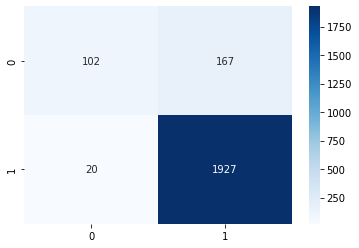

In [ ]:
import seaborn as sns

TPsum = np.sum(TPs)
TNsum = np.sum(TNs)
FPsum = np.sum(FPs)
FNsum = np.sum(FNs)

cm_data = [[TPsum, FNsum], [FPsum, TNsum]]
sns.heatmap(cm_data, annot=True, cmap='Blues', fmt='d')

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
RFWithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([RFWithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC        F1  ...   TP         TN        FP        FN
Average  15.5  0.915649  0.684558  0.480455  ...  3.4  64.233333  0.666667  5.566667

[1 rows x 11 columns]


In [ ]:
RFWithSMOTE = RFWithSMOTE.append(df_temp)

In [ ]:
print(RFWithSMOTE)
RFWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/PersonalizedNew/RFPersonalized.csv', index = True)

         User  Accuracy   ROC_AUC  ...         TN        FP         FN
0         1.0  0.891892  0.642188  ...  63.000000  1.000000   7.000000
1         2.0  0.932432  0.963235  ...  63.000000  5.000000   0.000000
2         3.0  0.905405  0.650000  ...  64.000000  0.000000   7.000000
3         4.0  0.959459  0.875000  ...  62.000000  0.000000   3.000000
4         5.0  0.905405  0.681818  ...  63.000000  0.000000   7.000000
5         6.0  0.918919  0.625000  ...  66.000000  0.000000   6.000000
6         7.0  0.945205  0.777778  ...  64.000000  0.000000   4.000000
7         8.0  0.891892  0.555556  ...  65.000000  0.000000   8.000000
8         9.0  0.918919  0.868750  ...  60.000000  4.000000   2.000000
9        10.0  0.904110  0.563853  ...  65.000000  1.000000   6.000000
10       11.0  0.932432  0.742424  ...  65.000000  1.000000   4.000000
11       12.0  0.878378  0.500000  ...  65.000000  0.000000   9.000000
12       13.0  0.932432  0.687500  ...  66.000000  0.000000   5.000000
13    

###Descision Tree

####Model

In [ ]:
from sklearn.tree import DecisionTreeClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_dt = DecisionTreeClassifier()
    tic = time.time()
    model_dt.fit(X_train, y_train) 
    toc = time.time()
    print("Decision Tree Train time = " + str(toc-tic))
    print("Decision Tree Accuracy = "+ str(model_dt.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_dt.predict(X_test)
    yhat_classes = (model_dt.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Decision Tree Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Decision Tree Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

Decision Tree Train time = 0.004128694534301758
Decision Tree Accuracy = 0.8513513513513513
Decision Tree Test time = 0.0004525184631347656
(74,)
(74,)
___________________Decision Tree Stats _____________________
Accuracy: 0.851351
True negatives: 59
True positives: 4
False positives: 5
False negatives: 6
ROC AUC: 0.660937
F1 Score: 0.421053
Precision: 0.444444
TPR: 0.400000
FPR: 0.078125
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.003553628921508789
Decision Tree Accuracy = 0.9324324324324325
Decision Tree Test time = 0.0004317760467529297
(74,)
(74,)
___________________Decision Tree Stats _____________________
Accuracy: 0.932432
True negatives: 63
True positives: 6
False positives: 5
False negatives: 0
ROC AUC: 0.963235
F1 Score: 0.705882
Precision: 0.545455
TPR: 1.000000
FPR: 0.073529
____________________________________________________________
_________________________________

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
DTWithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DTWithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC        F1  ...        TP         TN        FP   FN
Average  15.5  0.906152  0.782939  0.616086  ...  5.466667  61.466667  3.433333  3.5

[1 rows x 11 columns]


In [ ]:
DTWithSMOTE = DTWithSMOTE.append(df_temp)

In [ ]:
print(DTWithSMOTE)
DTWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/PersonalizedNew/DTPersonalized.csv', index = True)

         User  Accuracy   ROC_AUC        F1  ...        TP         TN        FP   FN
0         1.0  0.851351  0.660937  0.421053  ...  4.000000  59.000000  5.000000  6.0
1         2.0  0.932432  0.963235  0.705882  ...  6.000000  63.000000  5.000000  0.0
2         3.0  0.878378  0.634375  0.400000  ...  3.000000  62.000000  2.000000  7.0
3         4.0  0.918919  0.750000  0.666667  ...  6.000000  62.000000  0.000000  6.0
4         5.0  0.878378  0.740981  0.571429  ...  6.000000  59.000000  4.000000  5.0
5         6.0  0.932432  0.852273  0.705882  ...  6.000000  63.000000  3.000000  2.0
6         7.0  0.876712  0.834201  0.608696  ...  7.000000  57.000000  7.000000  2.0
7         8.0  0.945946  0.825641  0.750000  ...  6.000000  64.000000  1.000000  3.0
8         9.0  0.878378  0.845313  0.640000  ...  8.000000  57.000000  7.000000  2.0
9        10.0  0.931507  0.770563  0.615385  ...  4.000000  64.000000  2.000000  3.0
10       11.0  0.959459  0.867424  0.800000  ...  6.000000  65.00

###Gradient Boost

####Model

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_gb = GradientBoostingClassifier(n_estimators = 1000) 
    tic = time.time()
    model_gb.fit(X_train, y_train) 
    toc = time.time()
    print("Gradient Boost Train time = " + str(toc-tic))
    print("Gradient Boost Accuracy = "+ str(model_gb.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_gb.predict(X_test)
    yhat_classes = (model_gb.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Gradient Boost Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Gradient Boost Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9060072898864746
Gradient Boost Accuracy = 0.8648648648648649
Gradient Boost Test time = 0.003558635711669922
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.864865
True negatives: 61
True positives: 3
False positives: 3
False negatives: 7
ROC AUC: 0.626563
F1 Score: 0.375000
Precision: 0.500000
TPR: 0.300000
FPR: 0.046875
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.6395928859710693
Gradient Boost Accuracy = 0.9324324324324325
Gradient Boost Test time = 0.0027823448181152344
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.932432
True negatives: 63
True positives: 6
False positives: 5
False negatives: 0
ROC AUC: 0.963235
F1 Score: 0.705882
Precision: 0.545455
TPR: 1.000000
FPR: 0.073529
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.693056583404541
Gradient Boost Accuracy = 0.8918918918918919
Gradient Boost Test time = 0.003178834915161133
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.891892
True negatives: 61
True positives: 5
False positives: 3
False negatives: 5
ROC AUC: 0.726562
F1 Score: 0.555556
Precision: 0.625000
TPR: 0.500000
FPR: 0.046875
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.6630091667175293
Gradient Boost Accuracy = 0.9594594594594594
Gradient Boost Test time = 0.0031523704528808594
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.959459
True negatives: 62
True positives: 9
False positives: 0
False negatives: 3
ROC AUC: 0.875000
F1 Score: 0.857143
Precision: 1.000000
TPR: 0.750000
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0212581157684326
Gradient Boost Accuracy = 0.8918918918918919
Gradient Boost Test time = 0.0043718814849853516
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.891892
True negatives: 59
True positives: 7
False positives: 4
False negatives: 4
ROC AUC: 0.786436
F1 Score: 0.636364
Precision: 0.636364
TPR: 0.636364
FPR: 0.063492
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.030416488647461
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.0040569305419921875
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 65
True positives: 5
False positives: 1
False negatives: 3
ROC AUC: 0.804924
F1 Score: 0.714286
Precision: 0.833333
TPR: 0.625000
FPR: 0.015152
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9682092666625977
Gradient Boost Accuracy = 0.958904109589041
Gradient Boost Test time = 0.003861665725708008
(73,)
(73,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.958904
True negatives: 64
True positives: 6
False positives: 0
False negatives: 3
ROC AUC: 0.833333
F1 Score: 0.800000
Precision: 1.000000
TPR: 0.666667
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.1125743389129639
Gradient Boost Accuracy = 0.9324324324324325
Gradient Boost Test time = 0.004240751266479492
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.932432
True negatives: 63
True positives: 6
False positives: 2
False negatives: 3
ROC AUC: 0.817949
F1 Score: 0.705882
Precision: 0.750000
TPR: 0.666667
FPR: 0.030769
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.826723575592041
Gradient Boost Accuracy = 0.8918918918918919
Gradient Boost Test time = 0.003657102584838867
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.891892
True negatives: 58
True positives: 8
False positives: 6
False negatives: 2
ROC AUC: 0.853125
F1 Score: 0.666667
Precision: 0.571429
TPR: 0.800000
FPR: 0.093750
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9109535217285156
Gradient Boost Accuracy = 0.9178082191780822
Gradient Boost Test time = 0.004145622253417969
(73,)
(73,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.917808
True negatives: 64
True positives: 3
False positives: 2
False negatives: 4
ROC AUC: 0.699134
F1 Score: 0.500000
Precision: 0.600000
TPR: 0.428571
FPR: 0.030303
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9130816459655762
Gradient Boost Accuracy = 0.9594594594594594
Gradient Boost Test time = 0.0036525726318359375
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.959459
True negatives: 65
True positives: 6
False positives: 1
False negatives: 2
ROC AUC: 0.867424
F1 Score: 0.800000
Precision: 0.857143
TPR: 0.750000
FPR: 0.015152
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.8544132709503174
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.004716634750366211
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 63
True positives: 7
False positives: 2
False negatives: 2
ROC AUC: 0.873504
F1 Score: 0.777778
Precision: 0.777778
TPR: 0.777778
FPR: 0.030769
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.8875417709350586
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.0037877559661865234
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 66
True positives: 4
False positives: 0
False negatives: 4
ROC AUC: 0.750000
F1 Score: 0.666667
Precision: 1.000000
TPR: 0.500000
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9244418144226074
Gradient Boost Accuracy = 0.972972972972973
Gradient Boost Test time = 0.004688739776611328
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.972973
True negatives: 67
True positives: 5
False positives: 0
False negatives: 2
ROC AUC: 0.857143
F1 Score: 0.833333
Precision: 1.000000
TPR: 0.714286
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.98016357421875
Gradient Boost Accuracy = 0.9324324324324325
Gradient Boost Test time = 0.004523038864135742
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.932432
True negatives: 64
True positives: 5
False positives: 1
False negatives: 4
ROC AUC: 0.770085
F1 Score: 0.666667
Precision: 0.833333
TPR: 0.555556
FPR: 0.015385
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9318561553955078
Gradient Boost Accuracy = 0.9594594594594594
Gradient Boost Test time = 0.0046536922454833984
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.959459
True negatives: 65
True positives: 6
False positives: 1
False negatives: 2
ROC AUC: 0.867424
F1 Score: 0.800000
Precision: 0.857143
TPR: 0.750000
FPR: 0.015152
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.1082513332366943
Gradient Boost Accuracy = 0.9594594594594594
Gradient Boost Test time = 0.005131959915161133
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.959459
True negatives: 63
True positives: 8
False positives: 2
False negatives: 1
ROC AUC: 0.929060
F1 Score: 0.842105
Precision: 0.800000
TPR: 0.888889
FPR: 0.030769
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9063997268676758
Gradient Boost Accuracy = 0.9315068493150684
Gradient Boost Test time = 0.003847837448120117
(73,)
(73,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.931507
True negatives: 65
True positives: 3
False positives: 1
False negatives: 4
ROC AUC: 0.706710
F1 Score: 0.545455
Precision: 0.750000
TPR: 0.428571
FPR: 0.015152
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.209296703338623
Gradient Boost Accuracy = 0.8918918918918919
Gradient Boost Test time = 0.005074739456176758
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.891892
True negatives: 57
True positives: 9
False positives: 5
False negatives: 3
ROC AUC: 0.834677
F1 Score: 0.692308
Precision: 0.642857
TPR: 0.750000
FPR: 0.080645
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0562453269958496
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.00417637825012207
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 63
True positives: 7
False positives: 1
False negatives: 3
ROC AUC: 0.842187
F1 Score: 0.777778
Precision: 0.875000
TPR: 0.700000
FPR: 0.015625
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.1336336135864258
Gradient Boost Accuracy = 0.8918918918918919
Gradient Boost Test time = 0.005164384841918945
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.891892
True negatives: 61
True positives: 5
False positives: 3
False negatives: 5
ROC AUC: 0.726562
F1 Score: 0.555556
Precision: 0.625000
TPR: 0.500000
FPR: 0.046875
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.8277599811553955
Gradient Boost Accuracy = 0.9324324324324325
Gradient Boost Test time = 0.0038902759552001953
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.932432
True negatives: 62
True positives: 7
False positives: 4
False negatives: 1
ROC AUC: 0.907197
F1 Score: 0.736842
Precision: 0.636364
TPR: 0.875000
FPR: 0.060606
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9468159675598145
Gradient Boost Accuracy = 0.8783783783783784
Gradient Boost Test time = 0.004095792770385742
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.878378
True negatives: 60
True positives: 5
False positives: 4
False negatives: 5
ROC AUC: 0.718750
F1 Score: 0.526316
Precision: 0.555556
TPR: 0.500000
FPR: 0.062500
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.1534643173217773
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.006313800811767578
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 65
True positives: 5
False positives: 0
False negatives: 4
ROC AUC: 0.777778
F1 Score: 0.714286
Precision: 1.000000
TPR: 0.555556
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.14662504196167
Gradient Boost Accuracy = 0.8378378378378378
Gradient Boost Test time = 0.005007743835449219
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.837838
True negatives: 57
True positives: 5
False positives: 6
False negatives: 6
ROC AUC: 0.679654
F1 Score: 0.454545
Precision: 0.454545
TPR: 0.454545
FPR: 0.095238
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9515218734741211
Gradient Boost Accuracy = 0.9178082191780822
Gradient Boost Test time = 0.003909111022949219
(73,)
(73,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.917808
True negatives: 65
True positives: 2
False positives: 1
False negatives: 5
ROC AUC: 0.635281
F1 Score: 0.400000
Precision: 0.666667
TPR: 0.285714
FPR: 0.015152
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0057849884033203
Gradient Boost Accuracy = 0.9324324324324325
Gradient Boost Test time = 0.0045185089111328125
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.932432
True negatives: 63
True positives: 6
False positives: 1
False negatives: 4
ROC AUC: 0.792188
F1 Score: 0.705882
Precision: 0.857143
TPR: 0.600000
FPR: 0.015625
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.2777774333953857
Gradient Boost Accuracy = 0.8783783783783784
Gradient Boost Test time = 0.005637407302856445
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.878378
True negatives: 62
True positives: 3
False positives: 4
False negatives: 5
ROC AUC: 0.657197
F1 Score: 0.400000
Precision: 0.428571
TPR: 0.375000
FPR: 0.060606
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.7662863731384277
Gradient Boost Accuracy = 0.9324324324324325
Gradient Boost Test time = 0.003627300262451172
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.932432
True negatives: 64
True positives: 5
False positives: 2
False negatives: 3
ROC AUC: 0.797348
F1 Score: 0.666667
Precision: 0.714286
TPR: 0.625000
FPR: 0.030303
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9088501930236816
Gradient Boost Accuracy = 0.9054054054054054
Gradient Boost Test time = 0.004229307174682617
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.905405
True negatives: 64
True positives: 3
False positives: 1
False negatives: 6
ROC AUC: 0.658974
F1 Score: 0.461538
Precision: 0.750000
TPR: 0.333333
FPR: 0.015385
____________________________________________________________
____________________________________________________________


#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
GBWithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([GBWithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC       F1  ...        TP    TN   FP   FN
Average  15.5   0.92285  0.787847  0.65135  ...  5.466667  62.7  2.2  3.5

[1 rows x 11 columns]


In [ ]:
GBWithSMOTE = GBWithSMOTE.append(df_temp)

In [ ]:
print(GBWithSMOTE)
GBWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/PersonalizedNew/GBPersonalized.csv', index = True)

         User  Accuracy   ROC_AUC        F1  ...        TP    TN   FP   FN
0         1.0  0.864865  0.626563  0.375000  ...  3.000000  61.0  3.0  7.0
1         2.0  0.932432  0.963235  0.705882  ...  6.000000  63.0  5.0  0.0
2         3.0  0.891892  0.726562  0.555556  ...  5.000000  61.0  3.0  5.0
3         4.0  0.959459  0.875000  0.857143  ...  9.000000  62.0  0.0  3.0
4         5.0  0.891892  0.786436  0.636364  ...  7.000000  59.0  4.0  4.0
5         6.0  0.945946  0.804924  0.714286  ...  5.000000  65.0  1.0  3.0
6         7.0  0.958904  0.833333  0.800000  ...  6.000000  64.0  0.0  3.0
7         8.0  0.932432  0.817949  0.705882  ...  6.000000  63.0  2.0  3.0
8         9.0  0.891892  0.853125  0.666667  ...  8.000000  58.0  6.0  2.0
9        10.0  0.917808  0.699134  0.500000  ...  3.000000  64.0  2.0  4.0
10       11.0  0.959459  0.867424  0.800000  ...  6.000000  65.0  1.0  2.0
11       12.0  0.945946  0.873504  0.777778  ...  7.000000  63.0  2.0  2.0
12       13.0  0.945946  

###3 DNN

#### Model

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model3 = Sequential()

    model3.add(Dense(64, activation='relu', input_shape=(14,)))
    model3.add(Dropout(0.3))
    model3.add(Dense(32, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(8, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(1, activation='sigmoid'))

    model3.compile(loss='binary_crossentropy',
                  optimizer='adam',
                  metrics=['accuracy'])
    reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=0.001)
    tic = time.time()
    model3.fit(X_train, y_train, batch_size=64, epochs=100, validation_split=0.1, callbacks=[reduce_lr])
    toc = time.time()
    print("3 DNN Train time = " + str(toc-tic))
    print("3 DNN Accuracy = "+ str(model3.evaluate(X_test, y_test, verbose=0)[1]))
    tic = time.time()
    yhat_probs = model3.predict(X_test, verbose=0)
    yhat_classes = (model3.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("3 DNN Test time = " + str(toc-tic))
    yhat_probs = yhat_probs[:, 0]
    yhat_classes = yhat_classes[:, 0]
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________3 DNN Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

Epoch 1/100
3/3 [==============================] - 2s 177ms/step - loss: 1.0153 - accuracy: 0.4474 - val_loss: 0.8223 - val_accuracy: 0.1176 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 19ms/step - loss: 0.9618 - accuracy: 0.4803 - val_loss: 0.6940 - val_accuracy: 0.4118 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 21ms/step - loss: 0.8413 - accuracy: 0.5197 - val_loss: 0.5965 - val_accuracy: 0.8235 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 22ms/step - loss: 0.8048 - accuracy: 0.6118 - val_loss: 0.5212 - val_accuracy: 0.8235 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 22ms/step - loss: 0.6799 - accuracy: 0.6447 - val_loss: 0.4439 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 22ms/step - loss: 0.6975 - accuracy: 0.7039 - val_loss: 0.3732 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 20ms/step - loss: 0.5850 - 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


3/3 [==============================] - 1s 88ms/step - loss: 0.8329 - accuracy: 0.6118 - val_loss: 0.5535 - val_accuracy: 0.8235 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 14ms/step - loss: 0.6434 - accuracy: 0.6842 - val_loss: 0.3649 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 15ms/step - loss: 0.5929 - accuracy: 0.7566 - val_loss: 0.2425 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 16ms/step - loss: 0.4338 - accuracy: 0.8355 - val_loss: 0.1678 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 14ms/step - loss: 0.5146 - accuracy: 0.8026 - val_loss: 0.1240 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 15ms/step - loss: 0.4967 - accuracy: 0.8289 - val_loss: 0.0999 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 14ms/step - loss: 0.4361 - accuracy: 0.8

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


3/3 [==============================] - 1s 91ms/step - loss: 1.5602 - accuracy: 0.3618 - val_loss: 0.8647 - val_accuracy: 0.5882 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 15ms/step - loss: 1.3078 - accuracy: 0.4342 - val_loss: 0.6001 - val_accuracy: 0.8235 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 18ms/step - loss: 1.1057 - accuracy: 0.4211 - val_loss: 0.4401 - val_accuracy: 0.8824 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 14ms/step - loss: 0.7971 - accuracy: 0.5658 - val_loss: 0.3290 - val_accuracy: 0.9412 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 14ms/step - loss: 0.6970 - accuracy: 0.6118 - val_loss: 0.2700 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 18ms/step - loss: 0.6727 - accuracy: 0.6645 - val_loss: 0.2359 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 16ms/step - loss: 0.6722 - accuracy: 0.6

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


3/3 [==============================] - 1s 88ms/step - loss: 0.8359 - accuracy: 0.6053 - val_loss: 0.3236 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 15ms/step - loss: 0.8955 - accuracy: 0.6579 - val_loss: 0.2885 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 16ms/step - loss: 0.9532 - accuracy: 0.6513 - val_loss: 0.2721 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 15ms/step - loss: 0.9007 - accuracy: 0.6776 - val_loss: 0.2612 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 14ms/step - loss: 0.7733 - accuracy: 0.7500 - val_loss: 0.2514 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 15ms/step - loss: 0.7155 - accuracy: 0.7237 - val_loss: 0.2448 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 15ms/step - loss: 0.8328 - accuracy: 0.6

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


3/3 [==============================] - 1s 88ms/step - loss: 0.8770 - accuracy: 0.6184 - val_loss: 0.5514 - val_accuracy: 0.7647 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 16ms/step - loss: 0.5813 - accuracy: 0.7303 - val_loss: 0.3620 - val_accuracy: 0.9412 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 16ms/step - loss: 0.6945 - accuracy: 0.7303 - val_loss: 0.2605 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 15ms/step - loss: 0.5813 - accuracy: 0.7961 - val_loss: 0.2094 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 14ms/step - loss: 0.5881 - accuracy: 0.7961 - val_loss: 0.1787 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 15ms/step - loss: 0.6279 - accuracy: 0.8355 - val_loss: 0.1636 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 14ms/step - loss: 0.5616 - accuracy: 0.8

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


3/3 [==============================] - 1s 87ms/step - loss: 1.5403 - accuracy: 0.4671 - val_loss: 0.2775 - val_accuracy: 0.9412 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 17ms/step - loss: 0.9716 - accuracy: 0.6645 - val_loss: 0.1309 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 15ms/step - loss: 0.8339 - accuracy: 0.6447 - val_loss: 0.0839 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 14ms/step - loss: 0.8527 - accuracy: 0.7171 - val_loss: 0.0642 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 20ms/step - loss: 0.6664 - accuracy: 0.7566 - val_loss: 0.0570 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 19ms/step - loss: 0.5576 - accuracy: 0.7895 - val_loss: 0.0531 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 16ms/step - loss: 0.6729 - accuracy: 0.7

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


3/3 [==============================] - 1s 86ms/step - loss: 0.9566 - accuracy: 0.5921 - val_loss: 0.3274 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 16ms/step - loss: 0.6695 - accuracy: 0.7105 - val_loss: 0.2616 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 19ms/step - loss: 0.7865 - accuracy: 0.7105 - val_loss: 0.2243 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 18ms/step - loss: 0.5805 - accuracy: 0.7763 - val_loss: 0.2037 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 21ms/step - loss: 0.6565 - accuracy: 0.7105 - val_loss: 0.1949 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 23ms/step - loss: 0.6191 - accuracy: 0.7434 - val_loss: 0.1944 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 20ms/step - loss: 0.6681 - accuracy: 0.7

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


3/3 [==============================] - 1s 88ms/step - loss: 0.8321 - accuracy: 0.5294 - val_loss: 0.6811 - val_accuracy: 0.5882 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 18ms/step - loss: 0.7811 - accuracy: 0.5882 - val_loss: 0.5848 - val_accuracy: 0.9412 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 16ms/step - loss: 0.7528 - accuracy: 0.7059 - val_loss: 0.5292 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 16ms/step - loss: 0.5637 - accuracy: 0.7974 - val_loss: 0.4902 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 18ms/step - loss: 0.5151 - accuracy: 0.8105 - val_loss: 0.4385 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 19ms/step - loss: 0.5397 - accuracy: 0.8366 - val_loss: 0.3736 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 16ms/step - loss: 0.5344 - accuracy: 0.8

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


3/3 [==============================] - 1s 90ms/step - loss: 0.6651 - accuracy: 0.6908 - val_loss: 0.4170 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 16ms/step - loss: 0.5661 - accuracy: 0.7237 - val_loss: 0.3640 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 17ms/step - loss: 0.5156 - accuracy: 0.8289 - val_loss: 0.3205 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 16ms/step - loss: 0.5061 - accuracy: 0.8421 - val_loss: 0.2822 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 18ms/step - loss: 0.4292 - accuracy: 0.8553 - val_loss: 0.2489 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 17ms/step - loss: 0.5391 - accuracy: 0.8289 - val_loss: 0.2217 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 16ms/step - loss: 0.4319 - accuracy: 0.8

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


3/3 [==============================] - 1s 91ms/step - loss: 0.5679 - accuracy: 0.6776 - val_loss: 0.2312 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 16ms/step - loss: 0.5649 - accuracy: 0.8224 - val_loss: 0.2168 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 15ms/step - loss: 0.4579 - accuracy: 0.8289 - val_loss: 0.1986 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 15ms/step - loss: 0.4704 - accuracy: 0.8224 - val_loss: 0.1811 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 16ms/step - loss: 0.4504 - accuracy: 0.8487 - val_loss: 0.1622 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 17ms/step - loss: 0.4560 - accuracy: 0.8355 - val_loss: 0.1480 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 21ms/step - loss: 0.4352 - accuracy: 0.8

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


3/3 [==============================] - 1s 91ms/step - loss: 0.7783 - accuracy: 0.6250 - val_loss: 0.4010 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 16ms/step - loss: 0.5951 - accuracy: 0.7632 - val_loss: 0.3272 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 17ms/step - loss: 0.6146 - accuracy: 0.7697 - val_loss: 0.2677 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 19ms/step - loss: 0.4393 - accuracy: 0.8421 - val_loss: 0.2189 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 15ms/step - loss: 0.5162 - accuracy: 0.8158 - val_loss: 0.1843 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 17ms/step - loss: 0.4778 - accuracy: 0.8421 - val_loss: 0.1585 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 15ms/step - loss: 0.4910 - accuracy: 0.8

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


3/3 [==============================] - 1s 87ms/step - loss: 0.5997 - accuracy: 0.6908 - val_loss: 0.4222 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 16ms/step - loss: 0.5675 - accuracy: 0.7434 - val_loss: 0.3221 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 15ms/step - loss: 0.5534 - accuracy: 0.7763 - val_loss: 0.2518 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 17ms/step - loss: 0.4788 - accuracy: 0.7961 - val_loss: 0.2070 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 16ms/step - loss: 0.4547 - accuracy: 0.8289 - val_loss: 0.1814 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 16ms/step - loss: 0.4997 - accuracy: 0.8618 - val_loss: 0.1637 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 17ms/step - loss: 0.4023 - accuracy: 0.8

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


Epoch 1/100
3/3 [==============================] - 1s 93ms/step - loss: 0.7122 - accuracy: 0.6250 - val_loss: 0.4596 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 18ms/step - loss: 0.5749 - accuracy: 0.7039 - val_loss: 0.3504 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 18ms/step - loss: 0.5052 - accuracy: 0.7500 - val_loss: 0.2831 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 19ms/step - loss: 0.4559 - accuracy: 0.7961 - val_loss: 0.2366 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 18ms/step - loss: 0.4905 - accuracy: 0.8553 - val_loss: 0.2017 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 17ms/step - loss: 0.4238 - accuracy: 0.8553 - val_loss: 0.1779 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 19ms/step - loss: 0.4679 - a

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


3/3 [==============================] - 1s 99ms/step - loss: 0.9282 - accuracy: 0.4211 - val_loss: 0.6307 - val_accuracy: 0.8235 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 18ms/step - loss: 0.8467 - accuracy: 0.5000 - val_loss: 0.4694 - val_accuracy: 0.9412 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 19ms/step - loss: 0.7369 - accuracy: 0.6184 - val_loss: 0.3887 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 16ms/step - loss: 0.7465 - accuracy: 0.5658 - val_loss: 0.3512 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 19ms/step - loss: 0.6186 - accuracy: 0.6579 - val_loss: 0.3299 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 18ms/step - loss: 0.6537 - accuracy: 0.6053 - val_loss: 0.3172 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 18ms/step - loss: 0.6528 - accuracy: 0.5

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


3/3 [==============================] - 1s 90ms/step - loss: 0.8790 - accuracy: 0.4605 - val_loss: 0.6740 - val_accuracy: 0.5882 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 18ms/step - loss: 0.8034 - accuracy: 0.4671 - val_loss: 0.5604 - val_accuracy: 0.8824 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 16ms/step - loss: 0.6961 - accuracy: 0.6250 - val_loss: 0.4843 - val_accuracy: 0.9412 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 17ms/step - loss: 0.6401 - accuracy: 0.6579 - val_loss: 0.4404 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 20ms/step - loss: 0.5700 - accuracy: 0.7566 - val_loss: 0.4110 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 17ms/step - loss: 0.5709 - accuracy: 0.7632 - val_loss: 0.3848 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 22ms/step - loss: 0.5686 - accuracy: 0.7

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


3/3 [==============================] - 1s 106ms/step - loss: 0.6963 - accuracy: 0.6118 - val_loss: 0.4270 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 19ms/step - loss: 0.5810 - accuracy: 0.7303 - val_loss: 0.3387 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 29ms/step - loss: 0.5155 - accuracy: 0.7895 - val_loss: 0.2763 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 17ms/step - loss: 0.5663 - accuracy: 0.7500 - val_loss: 0.2349 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 18ms/step - loss: 0.5367 - accuracy: 0.7829 - val_loss: 0.2086 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 26ms/step - loss: 0.5050 - accuracy: 0.8026 - val_loss: 0.1939 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 20ms/step - loss: 0.4868 - accuracy: 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


3/3 [==============================] - 1s 96ms/step - loss: 1.3252 - accuracy: 0.4145 - val_loss: 0.8680 - val_accuracy: 0.0588 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 21ms/step - loss: 0.9834 - accuracy: 0.4671 - val_loss: 0.5943 - val_accuracy: 0.7647 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 18ms/step - loss: 0.8049 - accuracy: 0.5329 - val_loss: 0.4350 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 17ms/step - loss: 0.7181 - accuracy: 0.6184 - val_loss: 0.3673 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 19ms/step - loss: 0.5758 - accuracy: 0.7171 - val_loss: 0.3341 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 19ms/step - loss: 0.5129 - accuracy: 0.7566 - val_loss: 0.3054 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 19ms/step - loss: 0.5178 - accuracy: 0.7

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


3/3 [==============================] - 1s 93ms/step - loss: 0.7612 - accuracy: 0.5329 - val_loss: 0.4417 - val_accuracy: 0.9412 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 17ms/step - loss: 0.6783 - accuracy: 0.6645 - val_loss: 0.3675 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 19ms/step - loss: 0.5895 - accuracy: 0.6908 - val_loss: 0.3194 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 16ms/step - loss: 0.6083 - accuracy: 0.6579 - val_loss: 0.2888 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 21ms/step - loss: 0.6175 - accuracy: 0.6842 - val_loss: 0.2731 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 17ms/step - loss: 0.5571 - accuracy: 0.7368 - val_loss: 0.2621 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 19ms/step - loss: 0.5305 - accuracy: 0.7

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


3/3 [==============================] - 1s 93ms/step - loss: 1.9987 - accuracy: 0.3464 - val_loss: 0.7766 - val_accuracy: 0.3529 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 23ms/step - loss: 1.7547 - accuracy: 0.3922 - val_loss: 0.5946 - val_accuracy: 0.8824 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 18ms/step - loss: 1.2978 - accuracy: 0.5033 - val_loss: 0.4557 - val_accuracy: 0.9412 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 16ms/step - loss: 1.0667 - accuracy: 0.6144 - val_loss: 0.3573 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 18ms/step - loss: 0.8269 - accuracy: 0.7190 - val_loss: 0.2862 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 23ms/step - loss: 0.6260 - accuracy: 0.7320 - val_loss: 0.2390 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 16ms/step - loss: 0.7446 - accuracy: 0.7

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


3/3 [==============================] - 1s 96ms/step - loss: 0.9896 - accuracy: 0.4539 - val_loss: 0.6581 - val_accuracy: 0.6471 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 19ms/step - loss: 0.8923 - accuracy: 0.5592 - val_loss: 0.4068 - val_accuracy: 0.9412 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 18ms/step - loss: 0.7260 - accuracy: 0.6513 - val_loss: 0.2602 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 18ms/step - loss: 0.6672 - accuracy: 0.6776 - val_loss: 0.1765 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 22ms/step - loss: 0.5867 - accuracy: 0.6776 - val_loss: 0.1327 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 20ms/step - loss: 0.6676 - accuracy: 0.7632 - val_loss: 0.1179 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 28ms/step - loss: 0.6292 - accuracy: 0.8

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


3/3 [==============================] - 1s 96ms/step - loss: 0.8265 - accuracy: 0.4868 - val_loss: 0.5584 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 22ms/step - loss: 0.6587 - accuracy: 0.5921 - val_loss: 0.4073 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 26ms/step - loss: 0.6902 - accuracy: 0.5724 - val_loss: 0.3139 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 20ms/step - loss: 0.6324 - accuracy: 0.5789 - val_loss: 0.2563 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 23ms/step - loss: 0.5355 - accuracy: 0.7171 - val_loss: 0.2217 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 19ms/step - loss: 0.5698 - accuracy: 0.7237 - val_loss: 0.2019 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 17ms/step - loss: 0.4995 - accuracy: 0.7

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


3/3 [==============================] - 1s 100ms/step - loss: 1.4504 - accuracy: 0.4474 - val_loss: 0.8022 - val_accuracy: 0.2353 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 19ms/step - loss: 1.4352 - accuracy: 0.4868 - val_loss: 0.5622 - val_accuracy: 0.4706 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 18ms/step - loss: 1.6769 - accuracy: 0.5789 - val_loss: 0.3992 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 20ms/step - loss: 0.9301 - accuracy: 0.5724 - val_loss: 0.2827 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 21ms/step - loss: 0.7740 - accuracy: 0.7039 - val_loss: 0.2322 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 21ms/step - loss: 0.7727 - accuracy: 0.7171 - val_loss: 0.2001 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 28ms/step - loss: 0.9570 - accuracy: 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


3/3 [==============================] - 1s 95ms/step - loss: 0.8847 - accuracy: 0.6579 - val_loss: 0.3523 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 20ms/step - loss: 0.7063 - accuracy: 0.7105 - val_loss: 0.2802 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 19ms/step - loss: 0.8794 - accuracy: 0.6974 - val_loss: 0.2292 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 18ms/step - loss: 0.5816 - accuracy: 0.7434 - val_loss: 0.1917 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 18ms/step - loss: 0.6387 - accuracy: 0.8026 - val_loss: 0.1728 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 22ms/step - loss: 0.5076 - accuracy: 0.7895 - val_loss: 0.1608 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 20ms/step - loss: 0.7122 - accuracy: 0.8

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
DNN3WithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DNN3WithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC        F1  ...        TP    TN   FP   FN
Average  15.5  0.876836  0.693493  0.011189  ...  0.066667  64.7  0.2  8.9

[1 rows x 11 columns]


In [ ]:
DNN3WithSMOTE = DNN3WithSMOTE.append(df_temp)

In [ ]:
print(DNN3WithSMOTE)
DNN3WithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/PersonalizedNew/DNNPersonalized.csv', index = True)

         User  Accuracy   ROC_AUC        F1  ...        TP    TN   FP    FN
0         1.0  0.864865  0.675000  0.000000  ...  0.000000  64.0  0.0  10.0
1         2.0  0.918919  0.794118  0.000000  ...  0.000000  68.0  0.0   6.0
2         3.0  0.864865  0.573438  0.000000  ...  0.000000  64.0  0.0  10.0
3         4.0  0.851351  0.676075  0.153846  ...  1.000000  62.0  0.0  11.0
4         5.0  0.851351  0.600289  0.000000  ...  0.000000  63.0  0.0  11.0
5         6.0  0.878378  0.662879  0.000000  ...  0.000000  65.0  1.0   8.0
6         7.0  0.876712  0.756944  0.000000  ...  0.000000  64.0  0.0   9.0
7         8.0  0.878378  0.567521  0.000000  ...  0.000000  65.0  0.0   9.0
8         9.0  0.864865  0.814063  0.000000  ...  0.000000  64.0  0.0  10.0
9        10.0  0.890411  0.517316  0.000000  ...  0.000000  65.0  1.0   7.0
10       11.0  0.891892  0.785985  0.000000  ...  0.000000  66.0  0.0   8.0
11       12.0  0.878378  0.651282  0.000000  ...  0.000000  65.0  0.0   9.0
12       13.

# Personalized models with SMOTE and Normalisation

## Data Processing

### Import dataset

In [ ]:
directory_all = "/content/drive/MyDrive/Surjya Sir Work/5000"
directory_pbd = "/content/drive/MyDrive/Surjya Sir Work/5000_probed"

In [ ]:
videos = [1,2,3,4,5,6,7,8]

In [ ]:
all = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_all + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    all.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 5
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 6
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


In [ ]:
probed = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_pbd + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    probed.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 5
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 6
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


### Create df

In [ ]:
df = pd.DataFrame()
for i in range(len(all)):#per video = 8
  for j in range(len(all[i])): #per subject = 30
    df = df.append(all[i][j], ignore_index=True)

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8


In [ ]:
tester = pd.DataFrame()
for i in range(len(probed)):#per video = 8
  for j in range(len(probed[i])): #per subject = 30
    tester = tester.append(probed[i][j], ignore_index=True)

In [ ]:
tester

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1738876.01,1743876.01,1748876.01,6.309,5.096,0.013,0.106,5.632759,0.600,0.378,0.155,0.010,0.369,1.642,8.131,10,1
1,832168.01,837168.01,842168.01,6.488,5.290,0.012,0.159,1.883567,0.300,3.623,0.126,0.021,0.657,0.246,0.000,11,1
2,907168.01,912168.01,917168.01,5.330,4.958,0.394,0.082,3.340205,0.103,3.119,0.136,0.004,7.022,0.699,0.123,11,1
3,917168.01,922168.01,927168.01,6.046,5.011,0.767,0.003,2.078420,0.213,0.785,0.136,0.007,4.846,0.041,0.040,11,1
4,922168.01,927168.01,932168.01,6.476,5.014,0.430,0.022,2.208317,0.307,4.601,0.068,0.010,4.148,1.191,0.288,11,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
843,2282834.01,2287834.01,2292834.01,2.090,7.542,0.918,0.586,3.800016,3.170,4.349,0.261,0.003,0.082,2.916,1.602,8,8
844,2287834.01,2292834.01,2297834.01,1.199,8.115,1.181,0.661,5.052202,4.889,8.049,1.549,0.039,0.164,1.315,2.587,8,8
845,1166459.01,1171459.01,1176459.01,3.156,6.595,0.518,0.543,4.114055,0.256,0.368,4.792,0.011,2.998,3.368,13.429,9,8
846,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8


In [ ]:
temp = df[df.isin(tester)].dropna()

In [ ]:
temp = df.loc[df.set_index(list(df.columns)).index.isin(tester.set_index(list(tester.columns)).index)]

In [ ]:
temp.index

Int64Index([  35,   47,   62,   64,   65,   70,   99,  107,  117,  118,
            ...
            7191, 7212, 7231, 7234, 7239, 7255, 7256, 7284, 7285, 7286],
           dtype='int64', length=848)

In [ ]:
df['Probe'] = 0

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,0
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,0
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
for idx in temp.index:
  df.at[idx, 'Probe'] = 1

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


### Optimise df

In [ ]:
df = df.drop(columns=["Start", "Border", "End"], axis=1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
df['valence_acc_video'] = 0
df['arousal_acc_video'] = 0

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,0,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,0,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,0,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,0,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,0
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,0
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,0
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,0


I'm using the following encoding: 

1 - Low
2 - Mid/high
3 - High

In [ ]:
# def basedOnVideoValence(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 2
#     if int(video) == 6:
#         return 2
#     if int(video) == 7:
#         return 1
#     if int(video) == 8:
#         return 1
    
# def basedOnVideoArousal(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 1
#     if int(video) == 6:
#         return 1
#     if int(video) == 7:
#         return 3
#     if int(video) == 8:
#         return 3

New encoding, 
Low - 0 
Med / High - 1

In [ ]:
def basedOnVideoValence(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 1
    if int(video) == 6:
        return 1
    if int(video) == 7:
        return 0
    if int(video) == 8:
        return 0
    
def basedOnVideoArousal(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 0
    if int(video) == 6:
        return 0
    if int(video) == 7:
        return 1
    if int(video) == 8:
        return 1

In [ ]:
df['valence_acc_video'] = df.apply(lambda row : basedOnVideoValence(row['video']), axis = 1)
df['arousal_acc_video'] = df.apply(lambda row : basedOnVideoArousal(row['video']), axis = 1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1


### Normalize Scores across users

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1


In [ ]:
users = []
for i in range(1, 31):
  users.append(i)

print(users)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30]


In [ ]:
df_final = pd.DataFrame(columns=df.columns.values.tolist())

data = []

for user in users:
  #Score = []
  df_new = df[df['subject'] == str(user)]
  # for video in videos:
  #   df_selected = df_new[df_new['video'] == video]
  #   temp = df_selected['Score'].tolist()  
  #   Score.append(temp)
  score = df_new['Score'].tolist()
  norm = [(float(i)-min(score))/(max(score)-min(score)) for i in score]
  #print(df_new.Score)
  df_new['Score'] = norm
  #print(df_new.Score)
  df_final = df_final.append(df_new)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  from ipykernel import kernelapp as app


In [ ]:
df_final

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
360,6.888,5.266,2.231,0.739,0.054901,0.059,1.637,0.097,0.007,0.452,1.232,0.040,1,1,0,1,1
361,7.231,5.739,0.711,0.835,0.035254,0.067,0.368,0.029,0.021,0.739,0.000,0.082,1,1,0,1,1
362,7.599,6.101,0.603,0.468,0.105832,0.035,0.427,0.068,0.010,0.000,1.026,0.000,1,1,0,1,1
363,7.834,6.207,0.235,0.106,0.065427,0.067,2.751,0.049,0.011,0.944,0.164,0.329,1,1,0,1,1
364,7.834,6.207,0.000,0.011,0.074890,0.075,2.713,0.058,0.011,0.411,0.123,0.123,1,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7096,0.500,9.500,0.383,2.208,0.028595,0.331,1.134,1.810,0.000,3.491,4.887,0.493,30,8,0,0,1
7097,0.500,9.500,0.000,0.000,0.029820,0.312,0.474,1.094,0.007,0.452,4.805,0.821,30,8,0,0,1
7098,0.500,9.500,0.000,0.000,0.074199,0.047,1.153,1.297,0.000,2.875,2.834,1.109,30,8,0,0,1
7099,0.500,9.500,0.000,0.606,0.043119,0.059,0.678,0.164,0.017,2.546,3.039,1.889,30,8,0,0,1


In [ ]:
df = df_final

### X,y for personalized models

In [ ]:
X_train_all = []
y_train_all = []
X_test_all = []
y_test_all = []

In [ ]:
users = []
for i in range(1, 31):
  users.append(i)

print(users)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30]


In [ ]:
for user in users:
  print("User", user)
  X_train = pd.DataFrame()
  y_train = pd.DataFrame()
  X_test = pd.DataFrame()
  y_test = pd.DataFrame()
  df_new = df[df['subject'] == str(user)]
  df_probe = df_new[df_new['Probe'] == 1]
  df_nonprobe = df_new[df_new['Probe'] == 0]

  y_probe = df_probe['Probe']
  y_nonprobe = df_nonprobe['Probe']

  y_probe = pd.DataFrame(y_probe)
  y_nonprobe = pd.DataFrame(y_nonprobe)

  X_probe = df_probe.drop(columns=["Probe"], axis = 1)
  X_nonprobe = df_nonprobe.drop(columns=["Probe"], axis = 1)

  X_train_probe, X_test_probe, y_train_probe, y_test_probe = train_test_split(X_probe, y_probe, test_size = 0.3)
  X_train_nonprobe, X_test_nonprobe, y_train_nonprobe, y_test_nonprobe = train_test_split(X_nonprobe, y_nonprobe, test_size = 0.3)

  X_train = X_train.append(X_train_probe)
  X_train = X_train.append(X_train_nonprobe)
  X_test = X_test.append(X_test_probe)
  X_test = X_test.append(X_test_nonprobe)
  y_train = y_train.append(y_train_probe)
  y_train = y_train.append(y_train_nonprobe)
  y_test = y_test.append(y_test_probe)
  y_test = y_test.append(y_test_nonprobe)


  
  # for video in videos:
  #   print("    Video", video)
  #   df_selected = df_new[df_new['video'] == video]
  #   df_probe = df_selected[df_selected['Probe'] == 1]
  #   df_nonprobe = df_selected[df_selected['Probe'] == 0]

  #   y_probe = df_probe['Probe']
  #   y_nonprobe = df_nonprobe['Probe']

  #   y_probe = pd.DataFrame(y_probe)
  #   y_nonprobe = pd.DataFrame(y_nonprobe)

  #   X_probe = df_probe.drop(columns=["Probe"], axis = 1)
  #   X_nonprobe = df_nonprobe.drop(columns=["Probe"], axis = 1)

  #   X_train_probe, X_test_probe, y_train_probe, y_test_probe = train_test_split(X_probe, y_probe, test_size = 0.5)
  #   X_train_nonprobe, X_test_nonprobe, y_train_nonprobe, y_test_nonprobe = train_test_split(X_nonprobe, y_nonprobe, test_size = 0.2)
  
  #   X_train = X_train.append(X_train_probe)
  #   X_train = X_train.append(X_train_nonprobe)
  #   X_test = X_test.append(X_test_probe)
  #   X_test = X_test.append(X_test_nonprobe)
  #   y_train = y_train.append(y_train_probe)
  #   y_train = y_train.append(y_train_nonprobe)
  #   y_test = y_test.append(y_test_probe)
  #   y_test = y_test.append(y_test_nonprobe)
  X_train_all.append(X_train)
  y_train_all.append(y_train)
  X_test_all.append(X_test)
  y_test_all.append(y_test)

User 1
User 2
User 3
User 4
User 5
User 6
User 7
User 8
User 9
User 10
User 11
User 12
User 13
User 14
User 15
User 16
User 17
User 18
User 19
User 20
User 21
User 22
User 23
User 24
User 25
User 26
User 27
User 28
User 29
User 30


In [ ]:
print(len(X_train_all[29]['subject'].unique()))

1


In [ ]:
X_train_all[2]

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,valence_acc_video,arousal_acc_video
6221,4.584,7.063,0.707,1.024,0.801866,2.570,0.407,0.504,0.010,0.699,0.575,0.287,3,7,0,1
5171,5.954,5.014,0.415,0.194,0.699382,1.270,0.175,0.649,0.024,18.727,0.328,0.863,3,6,1,0
3459,4.964,4.552,0.003,0.000,0.286183,0.603,0.048,0.048,0.007,6.982,0.246,0.000,3,4,0,0
843,7.815,6.391,0.000,0.000,0.371308,0.099,0.164,0.920,0.007,14.620,1.355,0.247,3,1,1,1
4331,6.426,2.471,0.000,0.045,0.232140,0.304,0.116,0.610,0.003,0.123,0.246,8.994,3,5,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1850,6.143,5.110,0.077,0.243,0.128708,0.190,0.164,0.232,0.007,0.739,0.287,0.247,3,2,1,1
6243,2.005,8.644,0.034,0.394,0.060376,0.989,1.434,2.071,0.000,0.205,0.780,1.191,3,7,0,1
1856,5.967,6.267,0.000,0.036,0.171047,0.804,0.009,0.571,0.042,0.328,0.370,0.575,3,2,1,1
6226,2.087,9.500,1.275,0.620,0.208379,4.175,0.930,0.590,0.025,11.499,6.530,0.123,3,7,0,1


In [ ]:
new_X_train_all = []

for i in range(len(X_train_all)):
    df_temp = X_train_all[i]
    df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    new_X_train_all.append(df_temp)

X_train_all = new_X_train_all

new_X_test_all = []

for i in range(len(X_test_all)):
    df_temp = X_test_all[i]
    df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    new_X_test_all.append(df_temp)

X_test_all = new_X_test_all

In [ ]:
for i in range(len(users)):
  X_train_all[i] = np.asarray(X_train_all[i]).astype('float32') 
  X_test_all[i] = np.asarray(X_test_all[i]).astype('float32') 
  y_train_all[i] = y_train_all[i].astype('int') 
  y_test_all[i] = y_test_all[i].astype('int') 

In [ ]:
X_train_all[2]

array([[4.584e+00, 7.063e+00, 7.070e-01, ..., 2.870e-01, 0.000e+00,
        1.000e+00],
       [5.954e+00, 5.014e+00, 4.150e-01, ..., 8.630e-01, 1.000e+00,
        0.000e+00],
       [4.964e+00, 4.552e+00, 3.000e-03, ..., 0.000e+00, 0.000e+00,
        0.000e+00],
       ...,
       [5.967e+00, 6.267e+00, 0.000e+00, ..., 5.750e-01, 1.000e+00,
        1.000e+00],
       [2.087e+00, 9.500e+00, 1.275e+00, ..., 1.230e-01, 0.000e+00,
        1.000e+00],
       [7.896e+00, 6.274e+00, 0.000e+00, ..., 4.200e-02, 1.000e+00,
        1.000e+00]], dtype=float32)

In [ ]:
y_test_all[7]

,Probe
3626,1
2705,1
6424,1
5301,1
5296,1
...,...
3620,0
2704,0
4451,0
5293,0


### SMOTE

In [ ]:
print(X_train_all[0])

[[7.505e+00 5.098e+00 0.000e+00 ... 1.640e-01 0.000e+00 0.000e+00]
 [4.984e+00 4.464e+00 3.000e-03 ... 4.200e-02 1.000e+00 0.000e+00]
 [6.018e+00 5.896e+00 2.253e+00 ... 4.100e-02 1.000e+00 0.000e+00]
 ...
 [9.451e+00 7.280e+00 4.500e-02 ... 4.100e-02 1.000e+00 1.000e+00]
 [4.354e+00 7.082e+00 1.850e-01 ... 4.100e-02 1.000e+00 1.000e+00]
 [9.042e+00 5.831e+00 6.000e-02 ... 8.300e-02 1.000e+00 1.000e+00]]


In [ ]:
from imblearn.over_sampling import SMOTE
new_X_train_all = []
new_y_train_all = []

for i in range(len(X_train_all)):
  X_resampled, y_resampled = SMOTE('auto').fit_resample(X_train_all[i], y_train_all[i])
  new_X_train_all.append(X_resampled)
  new_y_train_all.append(y_resampled)

X_train_all = new_X_train_all
y_train_all = new_y_train_all

# new_X_test_all = []
# new_y_test_all = []

# for i in range(len(X_train_all)):
#   X_resampled, y_resampled = SMOTE('minority').fit_resample(X_test_all[i], y_test_all[i])
#   new_X_test_all.append(X_resampled)
#   new_y_test_all.append(y_resampled)

# X_test_all = new_X_test_all
# y_test_all = new_y_test_all

/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: Future

In [ ]:
print(X_train_all[0])

[[7.5050001e+00 5.0980000e+00 0.0000000e+00 ... 1.6400000e-01
  0.0000000e+00 0.0000000e+00]
 [4.9840002e+00 4.4640002e+00 3.0000000e-03 ... 4.1999999e-02
  1.0000000e+00 0.0000000e+00]
 [6.0180001e+00 5.8959999e+00 2.2530000e+00 ... 4.1000001e-02
  1.0000000e+00 0.0000000e+00]
 ...
 [5.1702375e+00 5.3324957e+00 1.4946583e-01 ... 4.4760484e-02
  1.0000000e+00 0.0000000e+00]
 [4.8712549e+00 5.7340055e+00 6.4753771e-02 ... 1.5269171e-01
  1.0000000e+00 0.0000000e+00]
 [9.1668320e+00 5.9854345e+00 3.4529251e-01 ... 3.5898879e-01
  1.0000000e+00 1.0000000e+00]]


## Models

###RandomForest

#### Model

In [ ]:
from sklearn.ensemble import RandomForestClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []

TPs = []
FPs = []
FNs = []
TNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_rf = RandomForestClassifier() 
    tic = time.time()
    print("X_train_size = ", str(len(X_train)))
    print("X_test_size = ", str(len(X_test)))
    model_rf.fit(X_train, y_train) 
    toc = time.time()
    print("Random Forest Train time = " + str(toc-tic))
    print("Random Forest Accuracy = "+ str(model_rf.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_rf.predict(X_test)
    print("yhat_probs",yhat_probs)
    yhat_classes = (model_rf.predict(X_test) > 0.5).astype("int32")
    print("yhat_classes",yhat_classes)
    toc = time.time()
    print("Random Forest Test time = " + str(toc-tic))

    print("___________________Random Forest Stats _____________________")

    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

X_train_size =  296
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.5187747478485107
Random Forest Accuracy = 0.9459459459459459
yhat_probs [1 1 0 1 1 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 0 1 1 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.030381441116333008
___________________Random Forest Stats _____________________
Accuracy: 0.945946
True negatives: 64
True positives: 6
False positives: 0
False negatives: 4
ROC AUC: 0.800000
F1 Score: 0.750000
Precision: 1.000000
TPR: 0.600000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  314
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.19580745697021484
Random Forest Accuracy = 0.9324324324324325
yhat_probs [1 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04179501533508301
___________________Random Forest Stats _____________________
Accuracy: 0.932432
True negatives: 64
True positives: 5
False positives: 4
False negatives: 1
ROC AUC: 0.887255
F1 Score: 0.666667
Precision: 0.555556
TPR: 0.833333
FPR: 0.058824
____________________________________________________________
____________________________________________________________
X_train_size =  296
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.19852280616760254
Random Forest Accuracy = 0.8513513513513513
yhat_probs [0 0 0 0 0 1 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0]
yhat_classes [0 0 0 0 0 1 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0]
Random Forest Test time = 0.041242122650146484
___________________Random Forest Stats _____________________
Accuracy: 0.851351
True negatives: 60
True positives: 3
False positives: 4
False negatives: 7
ROC AUC: 0.618750
F1 Score: 0.352941
Precision: 0.428571
TPR: 0.300000
FPR: 0.062500
____________________________________________________________
____________________________________________________________
X_train_size =  286
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.1855473518371582
Random Forest Accuracy = 0.9054054054054054
yhat_probs [1 1 0 0 1 1 0 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0]
yhat_classes [1 1 0 0 1 1 0 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0]
Random Forest Test time = 0.0452427864074707
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 59
True positives: 8
False positives: 3
False negatives: 4
ROC AUC: 0.809140
F1 Score: 0.695652
Precision: 0.727273
TPR: 0.666667
FPR: 0.048387
____________________________________________________________
____________________________________________________________
X_train_size =  288
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2089228630065918
Random Forest Accuracy = 0.8648648648648649
yhat_probs [0 1 0 1 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0
 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1]
yhat_classes [0 1 0 1 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0
 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1]
Random Forest Test time = 0.035703420639038086
___________________Random Forest Stats _____________________
Accuracy: 0.864865
True negatives: 59
True positives: 5
False positives: 4
False negatives: 6
ROC AUC: 0.695527
F1 Score: 0.500000
Precision: 0.555556
TPR: 0.454545
FPR: 0.063492
____________________________________________________________
____________________________________________________________
X_train_size =  304
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.18628168106079102
Random Forest Accuracy = 0.918918918918919
yhat_probs [0 0 0 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.039571285247802734
___________________Random Forest Stats _____________________
Accuracy: 0.918919
True negatives: 63
True positives: 5
False positives: 3
False negatives: 3
ROC AUC: 0.789773
F1 Score: 0.625000
Precision: 0.625000
TPR: 0.625000
FPR: 0.045455
____________________________________________________________
____________________________________________________________
X_train_size =  298
X_test_size =  73


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.20176053047180176
Random Forest Accuracy = 0.9041095890410958
yhat_probs [1 1 0 1 1 0 1 0 1 0 1 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 0 1 1 0 1 0 1 0 1 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04861164093017578
___________________Random Forest Stats _____________________
Accuracy: 0.904110
True negatives: 60
True positives: 6
False positives: 4
False negatives: 3
ROC AUC: 0.802083
F1 Score: 0.631579
Precision: 0.600000
TPR: 0.666667
FPR: 0.062500
____________________________________________________________
____________________________________________________________
X_train_size =  302
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.19936537742614746
Random Forest Accuracy = 0.9324324324324325
yhat_probs [0 1 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.045497894287109375
___________________Random Forest Stats _____________________
Accuracy: 0.932432
True negatives: 65
True positives: 4
False positives: 0
False negatives: 5
ROC AUC: 0.722222
F1 Score: 0.615385
Precision: 1.000000
TPR: 0.444444
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  294
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.18535828590393066
Random Forest Accuracy = 0.972972972972973
yhat_probs [1 1 1 1 1 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1]
yhat_classes [1 1 1 1 1 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1]
Random Forest Test time = 0.05140280723571777
___________________Random Forest Stats _____________________
Accuracy: 0.972973
True negatives: 63
True positives: 9
False positives: 1
False negatives: 1
ROC AUC: 0.942187
F1 Score: 0.900000
Precision: 0.900000
TPR: 0.900000
FPR: 0.015625
____________________________________________________________
____________________________________________________________
X_train_size =  308
X_test_size =  73


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.17968392372131348
Random Forest Accuracy = 0.9315068493150684
yhat_probs [1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.03864574432373047
___________________Random Forest Stats _____________________
Accuracy: 0.931507
True negatives: 66
True positives: 2
False positives: 0
False negatives: 5
ROC AUC: 0.642857
F1 Score: 0.444444
Precision: 1.000000
TPR: 0.285714
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  302
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.20985627174377441
Random Forest Accuracy = 0.9324324324324325
yhat_probs [1 1 0 1 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0]
yhat_classes [1 1 0 1 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0]
Random Forest Test time = 0.03470349311828613
___________________Random Forest Stats _____________________
Accuracy: 0.932432
True negatives: 64
True positives: 5
False positives: 2
False negatives: 3
ROC AUC: 0.797348
F1 Score: 0.666667
Precision: 0.714286
TPR: 0.625000
FPR: 0.030303
____________________________________________________________
____________________________________________________________
X_train_size =  300
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.22522878646850586
Random Forest Accuracy = 0.8648648648648649
yhat_probs [1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.025072097778320312
___________________Random Forest Stats _____________________
Accuracy: 0.864865
True negatives: 62
True positives: 2
False positives: 3
False negatives: 7
ROC AUC: 0.588034
F1 Score: 0.285714
Precision: 0.400000
TPR: 0.222222
FPR: 0.046154
____________________________________________________________
____________________________________________________________
X_train_size =  304
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2028942108154297
Random Forest Accuracy = 0.8783783783783784
yhat_probs [0 1 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.027040958404541016
___________________Random Forest Stats _____________________
Accuracy: 0.878378
True negatives: 63
True positives: 2
False positives: 3
False negatives: 6
ROC AUC: 0.602273
F1 Score: 0.307692
Precision: 0.400000
TPR: 0.250000
FPR: 0.045455
____________________________________________________________
____________________________________________________________
X_train_size =  310
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2049119472503662
Random Forest Accuracy = 0.9054054054054054
yhat_probs [1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0]
yhat_classes [1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0]
Random Forest Test time = 0.04776167869567871
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 65
True positives: 2
False positives: 2
False negatives: 5
ROC AUC: 0.627932
F1 Score: 0.363636
Precision: 0.500000
TPR: 0.285714
FPR: 0.029851
____________________________________________________________
____________________________________________________________
X_train_size =  302
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.19628620147705078
Random Forest Accuracy = 0.8918918918918919
yhat_probs [0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04057145118713379
___________________Random Forest Stats _____________________
Accuracy: 0.891892
True negatives: 64
True positives: 2
False positives: 1
False negatives: 7
ROC AUC: 0.603419
F1 Score: 0.333333
Precision: 0.666667
TPR: 0.222222
FPR: 0.015385
____________________________________________________________
____________________________________________________________
X_train_size =  302
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.28672361373901367
Random Forest Accuracy = 0.8918918918918919
yhat_probs [0 1 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.16382718086242676
___________________Random Forest Stats _____________________
Accuracy: 0.891892
True negatives: 63
True positives: 3
False positives: 3
False negatives: 5
ROC AUC: 0.664773
F1 Score: 0.428571
Precision: 0.500000
TPR: 0.375000
FPR: 0.045455
____________________________________________________________
____________________________________________________________
X_train_size =  302
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.7899858951568604
Random Forest Accuracy = 0.8648648648648649
yhat_probs [1 0 0 0 0 1 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0]
yhat_classes [1 0 0 0 0 1 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0]
Random Forest Test time = 0.034226417541503906
___________________Random Forest Stats _____________________
Accuracy: 0.864865
True negatives: 60
True positives: 4
False positives: 5
False negatives: 5
ROC AUC: 0.683761
F1 Score: 0.444444
Precision: 0.444444
TPR: 0.444444
FPR: 0.076923
____________________________________________________________
____________________________________________________________
X_train_size =  308
X_test_size =  73


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2036433219909668
Random Forest Accuracy = 0.9041095890410958
yhat_probs [0 0 0 0 0 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.038116455078125
___________________Random Forest Stats _____________________
Accuracy: 0.904110
True negatives: 64
True positives: 2
False positives: 2
False negatives: 5
ROC AUC: 0.627706
F1 Score: 0.363636
Precision: 0.500000
TPR: 0.285714
FPR: 0.030303
____________________________________________________________
____________________________________________________________
X_train_size =  288
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.19139957427978516
Random Forest Accuracy = 0.8648648648648649
yhat_probs [0 1 1 0 0 1 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0]
yhat_classes [0 1 1 0 0 1 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.042340993881225586
___________________Random Forest Stats _____________________
Accuracy: 0.864865
True negatives: 59
True positives: 5
False positives: 3
False negatives: 7
ROC AUC: 0.684140
F1 Score: 0.500000
Precision: 0.625000
TPR: 0.416667
FPR: 0.048387
____________________________________________________________
____________________________________________________________
X_train_size =  294
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.18381524085998535
Random Forest Accuracy = 0.8648648648648649
yhat_probs [1 0 1 1 1 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0]
yhat_classes [1 0 1 1 1 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0]
Random Forest Test time = 0.03939199447631836
___________________Random Forest Stats _____________________
Accuracy: 0.864865
True negatives: 59
True positives: 5
False positives: 5
False negatives: 5
ROC AUC: 0.710938
F1 Score: 0.500000
Precision: 0.500000
TPR: 0.500000
FPR: 0.078125
____________________________________________________________
____________________________________________________________
X_train_size =  296
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.19499635696411133
Random Forest Accuracy = 0.9054054054054054
yhat_probs [1 0 1 1 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 1 1 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.0452268123626709
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 61
True positives: 6
False positives: 3
False negatives: 4
ROC AUC: 0.776563
F1 Score: 0.631579
Precision: 0.666667
TPR: 0.600000
FPR: 0.046875
____________________________________________________________
____________________________________________________________
X_train_size =  302
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.18869543075561523
Random Forest Accuracy = 0.8918918918918919
yhat_probs [1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0
 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0
 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.03538107872009277
___________________Random Forest Stats _____________________
Accuracy: 0.891892
True negatives: 62
True positives: 4
False positives: 4
False negatives: 4
ROC AUC: 0.719697
F1 Score: 0.500000
Precision: 0.500000
TPR: 0.500000
FPR: 0.060606
____________________________________________________________
____________________________________________________________
X_train_size =  294
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.20007109642028809
Random Forest Accuracy = 0.9054054054054054
yhat_probs [1 1 0 1 1 0 1 1 1 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0]
yhat_classes [1 1 0 1 1 0 1 1 1 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0]
Random Forest Test time = 0.02963566780090332
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 59
True positives: 8
False positives: 5
False negatives: 2
ROC AUC: 0.860938
F1 Score: 0.695652
Precision: 0.615385
TPR: 0.800000
FPR: 0.078125
____________________________________________________________
____________________________________________________________
X_train_size =  298
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2007741928100586
Random Forest Accuracy = 0.8648648648648649
yhat_probs [0 1 0 0 1 0 1 1 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0]
yhat_classes [0 1 0 0 1 0 1 1 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0]
Random Forest Test time = 0.04032087326049805
___________________Random Forest Stats _____________________
Accuracy: 0.864865
True negatives: 60
True positives: 4
False positives: 5
False negatives: 5
ROC AUC: 0.683761
F1 Score: 0.444444
Precision: 0.444444
TPR: 0.444444
FPR: 0.076923
____________________________________________________________
____________________________________________________________
X_train_size =  292
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.18915581703186035
Random Forest Accuracy = 0.8513513513513513
yhat_probs [0 0 1 1 0 1 0 0 0 1 1 0 0 1 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 1 0 1 0 0 0 1 1 0 0 1 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.047959089279174805
___________________Random Forest Stats _____________________
Accuracy: 0.851351
True negatives: 58
True positives: 5
False positives: 5
False negatives: 6
ROC AUC: 0.687590
F1 Score: 0.476190
Precision: 0.500000
TPR: 0.454545
FPR: 0.079365
____________________________________________________________
____________________________________________________________
X_train_size =  308
X_test_size =  73


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2014915943145752
Random Forest Accuracy = 0.9041095890410958
yhat_probs [1 0 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.033983469009399414
___________________Random Forest Stats _____________________
Accuracy: 0.904110
True negatives: 62
True positives: 4
False positives: 4
False negatives: 3
ROC AUC: 0.755411
F1 Score: 0.533333
Precision: 0.500000
TPR: 0.571429
FPR: 0.060606
____________________________________________________________
____________________________________________________________
X_train_size =  296
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.19289684295654297
Random Forest Accuracy = 0.9324324324324325
yhat_probs [1 1 1 1 0 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 1 1 0 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04345560073852539
___________________Random Forest Stats _____________________
Accuracy: 0.932432
True negatives: 62
True positives: 7
False positives: 2
False negatives: 3
ROC AUC: 0.834375
F1 Score: 0.736842
Precision: 0.777778
TPR: 0.700000
FPR: 0.031250
____________________________________________________________
____________________________________________________________
X_train_size =  306
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.21394729614257812
Random Forest Accuracy = 0.8513513513513513
yhat_probs [0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0]
yhat_classes [0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0]
Random Forest Test time = 0.04430270195007324
___________________Random Forest Stats _____________________
Accuracy: 0.851351
True negatives: 61
True positives: 2
False positives: 5
False negatives: 6
ROC AUC: 0.587121
F1 Score: 0.266667
Precision: 0.285714
TPR: 0.250000
FPR: 0.075758
____________________________________________________________
____________________________________________________________
X_train_size =  302
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2011561393737793
Random Forest Accuracy = 0.918918918918919
yhat_probs [1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.035329341888427734
___________________Random Forest Stats _____________________
Accuracy: 0.918919
True negatives: 66
True positives: 2
False positives: 0
False negatives: 6
ROC AUC: 0.625000
F1 Score: 0.400000
Precision: 1.000000
TPR: 0.250000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  298
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.20016932487487793
Random Forest Accuracy = 0.9054054054054054
yhat_probs [1 1 1 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0]
yhat_classes [1 1 1 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0]
Random Forest Test time = 0.04073309898376465
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 62
True positives: 5
False positives: 3
False negatives: 4
ROC AUC: 0.754701
F1 Score: 0.588235
Precision: 0.625000
TPR: 0.555556
FPR: 0.046154
____________________________________________________________
____________________________________________________________


#### Results

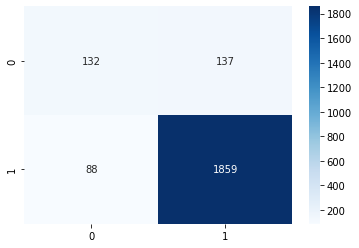

In [ ]:
import seaborn as sns

TPsum = np.sum(TPs)
TNsum = np.sum(TNs)
FPsum = np.sum(FPs)
FNsum = np.sum(FNs)


cm_data = [[TPsum, FNsum], [FPsum, TNsum]]
sns.heatmap(cm_data, annot=True, cmap='Blues', fmt='d')

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
RFWithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([RFWithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC       F1  ...   TP         TN        FP        FN
Average  15.5  0.898488  0.719509  0.52161  ...  4.4  61.966667  2.933333  4.566667

[1 rows x 11 columns]


In [ ]:
RFWithSMOTE = RFWithSMOTE.append(df_temp)

In [ ]:
print(RFWithSMOTE)
RFWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/PersonalizedNew/RFPersonalizedSMOTE.csv', index = True)

         User  Accuracy   ROC_AUC        F1  ...   TP         TN        FP        FN
0         1.0  0.945946  0.800000  0.750000  ...  6.0  64.000000  0.000000  4.000000
1         2.0  0.932432  0.887255  0.666667  ...  5.0  64.000000  4.000000  1.000000
2         3.0  0.851351  0.618750  0.352941  ...  3.0  60.000000  4.000000  7.000000
3         4.0  0.905405  0.809140  0.695652  ...  8.0  59.000000  3.000000  4.000000
4         5.0  0.864865  0.695527  0.500000  ...  5.0  59.000000  4.000000  6.000000
5         6.0  0.918919  0.789773  0.625000  ...  5.0  63.000000  3.000000  3.000000
6         7.0  0.904110  0.802083  0.631579  ...  6.0  60.000000  4.000000  3.000000
7         8.0  0.932432  0.722222  0.615385  ...  4.0  65.000000  0.000000  5.000000
8         9.0  0.972973  0.942187  0.900000  ...  9.0  63.000000  1.000000  1.000000
9        10.0  0.931507  0.642857  0.444444  ...  2.0  66.000000  0.000000  5.000000
10       11.0  0.932432  0.797348  0.666667  ...  5.0  64.000000 

###Descision Tree

####Model

In [ ]:
from sklearn.tree import DecisionTreeClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_dt = DecisionTreeClassifier()
    tic = time.time()
    model_dt.fit(X_train, y_train) 
    toc = time.time()
    print("Decision Tree Train time = " + str(toc-tic))
    print("Decision Tree Accuracy = "+ str(model_dt.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_dt.predict(X_test)
    yhat_classes = (model_dt.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Decision Tree Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Decision Tree Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

Decision Tree Train time = 0.00425267219543457
Decision Tree Accuracy = 0.9594594594594594
Decision Tree Test time = 0.0009417533874511719
(74,)
(74,)
___________________Decision Tree Stats _____________________
Accuracy: 0.959459
True negatives: 63
True positives: 8
False positives: 1
False negatives: 2
ROC AUC: 0.892188
F1 Score: 0.842105
Precision: 0.888889
TPR: 0.800000
FPR: 0.015625
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.009823083877563477
Decision Tree Accuracy = 0.9324324324324325
Decision Tree Test time = 0.0009453296661376953
(74,)
(74,)
___________________Decision Tree Stats _____________________
Accuracy: 0.932432
True negatives: 65
True positives: 4
False positives: 3
False negatives: 2
ROC AUC: 0.811275
F1 Score: 0.615385
Precision: 0.571429
TPR: 0.666667
FPR: 0.044118
____________________________________________________________
__________________________________

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
DTWithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DTWithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC        F1  ...        TP         TN        FP   FN
Average  15.5  0.890861  0.756159  0.562731  ...  5.166667  60.633333  4.266667  3.8

[1 rows x 11 columns]


In [ ]:
DTWithSMOTE = DTWithSMOTE.append(df_temp)

In [ ]:
print(DTWithSMOTE)
DTWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/PersonalizedNew/DTPersonalizedSMOTE.csv', index = True)

         User  Accuracy   ROC_AUC  ...         TN         FP   FN
0         1.0  0.959459  0.892188  ...  63.000000   1.000000  2.0
1         2.0  0.932432  0.811275  ...  65.000000   3.000000  2.0
2         3.0  0.824324  0.603125  ...  58.000000   6.000000  7.0
3         4.0  0.918919  0.850806  ...  59.000000   3.000000  3.0
4         5.0  0.864865  0.695527  ...  59.000000   4.000000  6.0
5         6.0  0.824324  0.791667  ...  55.000000  11.000000  2.0
6         7.0  0.917808  0.809896  ...  61.000000   3.000000  3.0
7         8.0  0.945946  0.825641  ...  64.000000   1.000000  3.0
8         9.0  0.918919  0.784375  ...  62.000000   2.000000  4.0
9        10.0  0.931507  0.898268  ...  62.000000   4.000000  1.0
10       11.0  0.945946  0.859848  ...  64.000000   2.000000  2.0
11       12.0  0.972973  0.888889  ...  65.000000   0.000000  2.0
12       13.0  0.878378  0.602273  ...  63.000000   3.000000  6.0
13       14.0  0.959459  0.849680  ...  66.000000   1.000000  2.0
14       1

###Gradient Boost

####Model

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_gb = GradientBoostingClassifier(n_estimators = 1000) 
    tic = time.time()
    model_gb.fit(X_train, y_train) 
    toc = time.time()
    print("Gradient Boost Train time = " + str(toc-tic))
    print("Gradient Boost Accuracy = "+ str(model_gb.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_gb.predict(X_test)
    yhat_classes = (model_gb.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Gradient Boost Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Gradient Boost Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9594769477844238
Gradient Boost Accuracy = 0.9054054054054054
Gradient Boost Test time = 0.0034999847412109375
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.905405
True negatives: 62
True positives: 5
False positives: 2
False negatives: 5
ROC AUC: 0.734375
F1 Score: 0.588235
Precision: 0.714286
TPR: 0.500000
FPR: 0.031250
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.7843294143676758
Gradient Boost Accuracy = 0.9324324324324325
Gradient Boost Test time = 0.005082130432128906
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.932432
True negatives: 65
True positives: 4
False positives: 3
False negatives: 2
ROC AUC: 0.811275
F1 Score: 0.615385
Precision: 0.571429
TPR: 0.666667
FPR: 0.044118
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.8300673961639404
Gradient Boost Accuracy = 0.8918918918918919
Gradient Boost Test time = 0.0031332969665527344
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.891892
True negatives: 62
True positives: 4
False positives: 2
False negatives: 6
ROC AUC: 0.684375
F1 Score: 0.500000
Precision: 0.666667
TPR: 0.400000
FPR: 0.031250
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.7181491851806641
Gradient Boost Accuracy = 0.9054054054054054
Gradient Boost Test time = 0.0040130615234375
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.905405
True negatives: 58
True positives: 9
False positives: 4
False negatives: 3
ROC AUC: 0.842742
F1 Score: 0.720000
Precision: 0.692308
TPR: 0.750000
FPR: 0.064516
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9390134811401367
Gradient Boost Accuracy = 0.8648648648648649
Gradient Boost Test time = 0.005215167999267578
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.864865
True negatives: 60
True positives: 4
False positives: 3
False negatives: 7
ROC AUC: 0.658009
F1 Score: 0.444444
Precision: 0.571429
TPR: 0.363636
FPR: 0.047619
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9925904273986816
Gradient Boost Accuracy = 0.9324324324324325
Gradient Boost Test time = 0.00485992431640625
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.932432
True negatives: 64
True positives: 5
False positives: 2
False negatives: 3
ROC AUC: 0.797348
F1 Score: 0.666667
Precision: 0.714286
TPR: 0.625000
FPR: 0.030303
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9418978691101074
Gradient Boost Accuracy = 0.9452054794520548
Gradient Boost Test time = 0.004515409469604492
(73,)
(73,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945205
True negatives: 61
True positives: 8
False positives: 3
False negatives: 1
ROC AUC: 0.921007
F1 Score: 0.800000
Precision: 0.727273
TPR: 0.888889
FPR: 0.046875
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.7886776924133301
Gradient Boost Accuracy = 0.972972972972973
Gradient Boost Test time = 0.0032896995544433594
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.972973
True negatives: 65
True positives: 7
False positives: 0
False negatives: 2
ROC AUC: 0.888889
F1 Score: 0.875000
Precision: 1.000000
TPR: 0.777778
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.8194963932037354
Gradient Boost Accuracy = 0.9594594594594594
Gradient Boost Test time = 0.004217386245727539
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.959459
True negatives: 62
True positives: 9
False positives: 2
False negatives: 1
ROC AUC: 0.934375
F1 Score: 0.857143
Precision: 0.818182
TPR: 0.900000
FPR: 0.031250
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0887095928192139
Gradient Boost Accuracy = 0.9315068493150684
Gradient Boost Test time = 0.0046901702880859375
(73,)
(73,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.931507
True negatives: 64
True positives: 4
False positives: 2
False negatives: 3
ROC AUC: 0.770563
F1 Score: 0.615385
Precision: 0.666667
TPR: 0.571429
FPR: 0.030303
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0578444004058838
Gradient Boost Accuracy = 0.9324324324324325
Gradient Boost Test time = 0.004792690277099609
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.932432
True negatives: 64
True positives: 5
False positives: 2
False negatives: 3
ROC AUC: 0.797348
F1 Score: 0.666667
Precision: 0.714286
TPR: 0.625000
FPR: 0.030303
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9375162124633789
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.005610227584838867
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 63
True positives: 7
False positives: 2
False negatives: 2
ROC AUC: 0.873504
F1 Score: 0.777778
Precision: 0.777778
TPR: 0.777778
FPR: 0.030769
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.7585756778717041
Gradient Boost Accuracy = 0.9054054054054054
Gradient Boost Test time = 0.0045087337493896484
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.905405
True negatives: 64
True positives: 3
False positives: 2
False negatives: 5
ROC AUC: 0.672348
F1 Score: 0.461538
Precision: 0.600000
TPR: 0.375000
FPR: 0.030303
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.8102803230285645
Gradient Boost Accuracy = 0.918918918918919
Gradient Boost Test time = 0.0041234493255615234
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.918919
True negatives: 64
True positives: 4
False positives: 3
False negatives: 3
ROC AUC: 0.763326
F1 Score: 0.571429
Precision: 0.571429
TPR: 0.571429
FPR: 0.044776
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.7750661373138428
Gradient Boost Accuracy = 0.9054054054054054
Gradient Boost Test time = 0.006875038146972656
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.905405
True negatives: 64
True positives: 3
False positives: 1
False negatives: 6
ROC AUC: 0.658974
F1 Score: 0.461538
Precision: 0.750000
TPR: 0.333333
FPR: 0.015385
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0416936874389648
Gradient Boost Accuracy = 0.9324324324324325
Gradient Boost Test time = 0.0058209896087646484
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.932432
True negatives: 64
True positives: 5
False positives: 2
False negatives: 3
ROC AUC: 0.797348
F1 Score: 0.666667
Precision: 0.714286
TPR: 0.625000
FPR: 0.030303
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.1623730659484863
Gradient Boost Accuracy = 0.8648648648648649
Gradient Boost Test time = 0.006743669509887695
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.864865
True negatives: 61
True positives: 3
False positives: 4
False negatives: 6
ROC AUC: 0.635897
F1 Score: 0.375000
Precision: 0.428571
TPR: 0.333333
FPR: 0.061538
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.8254489898681641
Gradient Boost Accuracy = 0.9452054794520548
Gradient Boost Test time = 0.004002571105957031
(73,)
(73,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945205
True negatives: 64
True positives: 5
False positives: 2
False negatives: 2
ROC AUC: 0.841991
F1 Score: 0.714286
Precision: 0.714286
TPR: 0.714286
FPR: 0.030303
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.2670948505401611
Gradient Boost Accuracy = 0.8648648648648649
Gradient Boost Test time = 0.004415273666381836
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.864865
True negatives: 59
True positives: 5
False positives: 3
False negatives: 7
ROC AUC: 0.684140
F1 Score: 0.500000
Precision: 0.625000
TPR: 0.416667
FPR: 0.048387
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9303708076477051
Gradient Boost Accuracy = 0.9324324324324325
Gradient Boost Test time = 0.004647016525268555
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.932432
True negatives: 60
True positives: 9
False positives: 4
False negatives: 1
ROC AUC: 0.918750
F1 Score: 0.782609
Precision: 0.692308
TPR: 0.900000
FPR: 0.062500
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.1801130771636963
Gradient Boost Accuracy = 0.918918918918919
Gradient Boost Test time = 0.005015134811401367
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.918919
True negatives: 60
True positives: 8
False positives: 4
False negatives: 2
ROC AUC: 0.868750
F1 Score: 0.727273
Precision: 0.666667
TPR: 0.800000
FPR: 0.062500
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.8013126850128174
Gradient Boost Accuracy = 0.9594594594594594
Gradient Boost Test time = 0.003721952438354492
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.959459
True negatives: 64
True positives: 7
False positives: 2
False negatives: 1
ROC AUC: 0.922348
F1 Score: 0.823529
Precision: 0.777778
TPR: 0.875000
FPR: 0.030303
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.013995885848999
Gradient Boost Accuracy = 0.918918918918919
Gradient Boost Test time = 0.004483222961425781
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.918919
True negatives: 61
True positives: 7
False positives: 3
False negatives: 3
ROC AUC: 0.826562
F1 Score: 0.700000
Precision: 0.700000
TPR: 0.700000
FPR: 0.046875
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9378750324249268
Gradient Boost Accuracy = 0.8783783783783784
Gradient Boost Test time = 0.004712104797363281
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.878378
True negatives: 61
True positives: 4
False positives: 4
False negatives: 5
ROC AUC: 0.691453
F1 Score: 0.470588
Precision: 0.500000
TPR: 0.444444
FPR: 0.061538
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.2111992835998535
Gradient Boost Accuracy = 0.8783783783783784
Gradient Boost Test time = 0.004966020584106445
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.878378
True negatives: 55
True positives: 10
False positives: 8
False negatives: 1
ROC AUC: 0.891053
F1 Score: 0.689655
Precision: 0.555556
TPR: 0.909091
FPR: 0.126984
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.8357052803039551
Gradient Boost Accuracy = 0.958904109589041
Gradient Boost Test time = 0.003476858139038086
(73,)
(73,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.958904
True negatives: 64
True positives: 6
False positives: 2
False negatives: 1
ROC AUC: 0.913420
F1 Score: 0.800000
Precision: 0.750000
TPR: 0.857143
FPR: 0.030303
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9995083808898926
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.004849433898925781
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 63
True positives: 7
False positives: 1
False negatives: 3
ROC AUC: 0.842187
F1 Score: 0.777778
Precision: 0.875000
TPR: 0.700000
FPR: 0.015625
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.1803667545318604
Gradient Boost Accuracy = 0.8513513513513513
Gradient Boost Test time = 0.005105733871459961
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.851351
True negatives: 59
True positives: 4
False positives: 7
False negatives: 4
ROC AUC: 0.696970
F1 Score: 0.421053
Precision: 0.363636
TPR: 0.500000
FPR: 0.106061
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.7231509685516357
Gradient Boost Accuracy = 0.8918918918918919
Gradient Boost Test time = 0.004052639007568359
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.891892
True negatives: 63
True positives: 3
False positives: 3
False negatives: 5
ROC AUC: 0.664773
F1 Score: 0.428571
Precision: 0.500000
TPR: 0.375000
FPR: 0.045455
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.011655569076538
Gradient Boost Accuracy = 0.8918918918918919
Gradient Boost Test time = 0.006364107131958008
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.891892
True negatives: 60
True positives: 6
False positives: 5
False negatives: 3
ROC AUC: 0.794872
F1 Score: 0.600000
Precision: 0.545455
TPR: 0.666667
FPR: 0.076923
____________________________________________________________
____________________________________________________________


#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
GBWithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([GBWithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC        F1  ...        TP    TN   FP   FN
Average  15.5  0.916117  0.793299  0.636607  ...  5.666667  62.0  2.9  3.3

[1 rows x 11 columns]


In [ ]:
GBWithSMOTE = GBWithSMOTE.append(df_temp)

In [ ]:
print(GBWithSMOTE)
GBWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/PersonalizedNew/GBPersonalizedSMOTE.csv', index = True)

         User  Accuracy   ROC_AUC        F1  ...         TP    TN   FP   FN
0         1.0  0.905405  0.734375  0.588235  ...   5.000000  62.0  2.0  5.0
1         2.0  0.932432  0.811275  0.615385  ...   4.000000  65.0  3.0  2.0
2         3.0  0.891892  0.684375  0.500000  ...   4.000000  62.0  2.0  6.0
3         4.0  0.905405  0.842742  0.720000  ...   9.000000  58.0  4.0  3.0
4         5.0  0.864865  0.658009  0.444444  ...   4.000000  60.0  3.0  7.0
5         6.0  0.932432  0.797348  0.666667  ...   5.000000  64.0  2.0  3.0
6         7.0  0.945205  0.921007  0.800000  ...   8.000000  61.0  3.0  1.0
7         8.0  0.972973  0.888889  0.875000  ...   7.000000  65.0  0.0  2.0
8         9.0  0.959459  0.934375  0.857143  ...   9.000000  62.0  2.0  1.0
9        10.0  0.931507  0.770563  0.615385  ...   4.000000  64.0  2.0  3.0
10       11.0  0.932432  0.797348  0.666667  ...   5.000000  64.0  2.0  3.0
11       12.0  0.945946  0.873504  0.777778  ...   7.000000  63.0  2.0  2.0
12       13.

###3 DNN

#### Model

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model3 = Sequential()

    model3.add(Dense(64, activation='relu', input_shape=(14,)))
    model3.add(Dropout(0.3))
    model3.add(Dense(32, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(8, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(1, activation='sigmoid'))

    model3.compile(loss='binary_crossentropy',
                  optimizer='adam',
                  metrics=['accuracy'])
    reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=0.001)
    tic = time.time()
    model3.fit(X_train, y_train, batch_size=64, epochs=100, validation_split=0.1, callbacks=[reduce_lr])
    toc = time.time()
    print("3 DNN Train time = " + str(toc-tic))
    print("3 DNN Accuracy = "+ str(model3.evaluate(X_test, y_test, verbose=0)[1]))
    tic = time.time()
    yhat_probs = model3.predict(X_test, verbose=0)
    yhat_classes = (model3.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("3 DNN Test time = " + str(toc-tic))
    yhat_probs = yhat_probs[:, 0]
    yhat_classes = yhat_classes[:, 0]
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________3 DNN Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

Streaming output truncated to the last 5000 lines.
Epoch 8/100
5/5 [==============================] - 0s 13ms/step - loss: 0.7074 - accuracy: 0.5461 - val_loss: 0.7485 - val_accuracy: 0.2581 - lr: 0.0010
Epoch 9/100
5/5 [==============================] - 0s 11ms/step - loss: 0.6877 - accuracy: 0.5387 - val_loss: 0.7483 - val_accuracy: 0.2581 - lr: 0.0010
Epoch 10/100
5/5 [==============================] - 0s 13ms/step - loss: 0.6777 - accuracy: 0.5572 - val_loss: 0.7545 - val_accuracy: 0.2581 - lr: 0.0010
Epoch 11/100
5/5 [==============================] - 0s 11ms/step - loss: 0.6906 - accuracy: 0.5498 - val_loss: 0.7555 - val_accuracy: 0.2581 - lr: 0.0010
Epoch 12/100
5/5 [==============================] - 0s 14ms/step - loss: 0.6831 - accuracy: 0.5461 - val_loss: 0.7553 - val_accuracy: 0.3226 - lr: 0.0010
Epoch 13/100
5/5 [==============================] - 0s 11ms/step - loss: 0.6761 - accuracy: 0.5424 - val_loss: 0.7520 - val_accuracy: 0.3548 - lr: 0.0010
Epoch 14/100
5/5 [=========

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
DNN3WithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DNN3WithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC        F1  ...   TP    TN    FP        FN
Average  15.5  0.774491  0.690759  0.295784  ...  3.5  53.7  11.2  5.466667

[1 rows x 11 columns]


In [ ]:
DNN3WithSMOTE = DNN3WithSMOTE.append(df_temp)

In [ ]:
print(DNN3WithSMOTE)
DNN3WithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/PersonalizedNew/DNNPersonalizedSMOTE.csv', index = True)

         User  Accuracy   ROC_AUC        F1  ...   TP    TN    FP         FN
0         1.0  0.783784  0.650000  0.272727  ...  3.0  55.0   9.0   7.000000
1         2.0  0.878378  0.632353  0.400000  ...  3.0  62.0   6.0   3.000000
2         3.0  0.783784  0.529688  0.000000  ...  0.0  58.0   6.0  10.000000
3         4.0  0.594595  0.525538  0.210526  ...  4.0  40.0  22.0   8.000000
4         5.0  0.770270  0.676768  0.320000  ...  4.0  53.0  10.0   7.000000
5         6.0  0.864865  0.795455  0.375000  ...  3.0  61.0   5.0   5.000000
6         7.0  0.863014  0.809028  0.000000  ...  0.0  63.0   1.0   9.000000
7         8.0  0.797297  0.779487  0.400000  ...  5.0  54.0  11.0   4.000000
8         9.0  0.851351  0.815625  0.560000  ...  7.0  56.0   8.0   3.000000
9        10.0  0.794521  0.688312  0.285714  ...  3.0  55.0  11.0   4.000000
10       11.0  0.864865  0.799242  0.500000  ...  5.0  59.0   7.0   3.000000
11       12.0  0.756757  0.661538  0.307692  ...  4.0  52.0  13.0   5.000000

# Misc 

## CSVs

### Data Processing

#### Import dataset

In [ ]:
directory_all = "/content/drive/MyDrive/Surjya Sir Work/5000"
directory_pbd = "/content/drive/MyDrive/Surjya Sir Work/5000_probed"

In [ ]:
videos = [1,2,3,4,5,6,7,8]

In [ ]:
all = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_all + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    all.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 5
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 6
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


In [ ]:
probed = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_pbd + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    probed.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 5
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 6
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


#### Create df

In [ ]:
df = pd.DataFrame()
for i in range(len(all)):#per video = 8
  for j in range(len(all[i])): #per subject = 30
    df = df.append(all[i][j], ignore_index=True)

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8


In [ ]:
tester = pd.DataFrame()
for i in range(len(probed)):#per video = 8
  for j in range(len(probed[i])): #per subject = 30
    tester = tester.append(probed[i][j], ignore_index=True)

In [ ]:
tester

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1738876.01,1743876.01,1748876.01,6.309,5.096,0.013,0.106,5.632759,0.600,0.378,0.155,0.010,0.369,1.642,8.131,10,1
1,832168.01,837168.01,842168.01,6.488,5.290,0.012,0.159,1.883567,0.300,3.623,0.126,0.021,0.657,0.246,0.000,11,1
2,907168.01,912168.01,917168.01,5.330,4.958,0.394,0.082,3.340205,0.103,3.119,0.136,0.004,7.022,0.699,0.123,11,1
3,917168.01,922168.01,927168.01,6.046,5.011,0.767,0.003,2.078420,0.213,0.785,0.136,0.007,4.846,0.041,0.040,11,1
4,922168.01,927168.01,932168.01,6.476,5.014,0.430,0.022,2.208317,0.307,4.601,0.068,0.010,4.148,1.191,0.288,11,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
843,2282834.01,2287834.01,2292834.01,2.090,7.542,0.918,0.586,3.800016,3.170,4.349,0.261,0.003,0.082,2.916,1.602,8,8
844,2287834.01,2292834.01,2297834.01,1.199,8.115,1.181,0.661,5.052202,4.889,8.049,1.549,0.039,0.164,1.315,2.587,8,8
845,1166459.01,1171459.01,1176459.01,3.156,6.595,0.518,0.543,4.114055,0.256,0.368,4.792,0.011,2.998,3.368,13.429,9,8
846,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8


In [ ]:
temp = df[df.isin(tester)].dropna()

In [ ]:
temp = df.loc[df.set_index(list(df.columns)).index.isin(tester.set_index(list(tester.columns)).index)]

In [ ]:
temp.index

Int64Index([  35,   47,   62,   64,   65,   70,   99,  107,  117,  118,
            ...
            7191, 7212, 7231, 7234, 7239, 7255, 7256, 7284, 7285, 7286],
           dtype='int64', length=848)

In [ ]:
df['Probe'] = 0

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,0
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,0
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
for idx in temp.index:
  df.at[idx, 'Probe'] = 1

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


#### Optimise df

In [ ]:
df = df.drop(columns=["Start", "Border", "End"], axis=1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
df['valence_acc_video'] = 0
df['arousal_acc_video'] = 0

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,0,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,0,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,0,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,0,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,0
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,0
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,0
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,0


I'm using the following encoding: 

1 - Low
2 - Mid/high
3 - High

In [ ]:
# def basedOnVideoValence(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 2
#     if int(video) == 6:
#         return 2
#     if int(video) == 7:
#         return 1
#     if int(video) == 8:
#         return 1
    
# def basedOnVideoArousal(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 1
#     if int(video) == 6:
#         return 1
#     if int(video) == 7:
#         return 3
#     if int(video) == 8:
#         return 3

New encoding, 
Low - 0 
Med / High - 1

In [ ]:
def basedOnVideoValence(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 1
    if int(video) == 6:
        return 1
    if int(video) == 7:
        return 0
    if int(video) == 8:
        return 0
    
def basedOnVideoArousal(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 0
    if int(video) == 6:
        return 0
    if int(video) == 7:
        return 1
    if int(video) == 8:
        return 1

In [ ]:
df['valence_acc_video'] = df.apply(lambda row : basedOnVideoValence(row['video']), axis = 1)
df['arousal_acc_video'] = df.apply(lambda row : basedOnVideoArousal(row['video']), axis = 1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1


### Generate csvs

In [ ]:
users = []
for i in range(1, 31):
  users.append(i)

print(users)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30]


In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1


In [ ]:
for user in users:
  df_new = df[df['subject'] == str(user)]
  df_newnew = df_new[['subject', 'video', 'Score', 'Probe']].copy()
  df_newnew.to_csv(f'/content/drive/MyDrive/Surjya Sir Work/Misc/UserSubjectProbe/user{user}.csv')

## PCA Plots

### Data Processing

#### Import dataset

In [ ]:
directory_all = "/content/drive/MyDrive/Surjya Sir Work/5000"
directory_pbd = "/content/drive/MyDrive/Surjya Sir Work/5000_probed"

In [ ]:
videos = [1,2,3,4,5,6,7,8]

In [ ]:
all = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_all + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    all.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 5
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 6
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


In [ ]:
probed = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_pbd + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    probed.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 5
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 6
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


#### Create df

In [ ]:
df = pd.DataFrame()
for i in range(len(all)):#per video = 8
  for j in range(len(all[i])): #per subject = 30
    df = df.append(all[i][j], ignore_index=True)

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8


In [ ]:
tester = pd.DataFrame()
for i in range(len(probed)):#per video = 8
  for j in range(len(probed[i])): #per subject = 30
    tester = tester.append(probed[i][j], ignore_index=True)

In [ ]:
tester

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1738876.01,1743876.01,1748876.01,6.309,5.096,0.013,0.106,5.632759,0.600,0.378,0.155,0.010,0.369,1.642,8.131,10,1
1,832168.01,837168.01,842168.01,6.488,5.290,0.012,0.159,1.883567,0.300,3.623,0.126,0.021,0.657,0.246,0.000,11,1
2,907168.01,912168.01,917168.01,5.330,4.958,0.394,0.082,3.340205,0.103,3.119,0.136,0.004,7.022,0.699,0.123,11,1
3,917168.01,922168.01,927168.01,6.046,5.011,0.767,0.003,2.078420,0.213,0.785,0.136,0.007,4.846,0.041,0.040,11,1
4,922168.01,927168.01,932168.01,6.476,5.014,0.430,0.022,2.208317,0.307,4.601,0.068,0.010,4.148,1.191,0.288,11,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
843,2282834.01,2287834.01,2292834.01,2.090,7.542,0.918,0.586,3.800016,3.170,4.349,0.261,0.003,0.082,2.916,1.602,8,8
844,2287834.01,2292834.01,2297834.01,1.199,8.115,1.181,0.661,5.052202,4.889,8.049,1.549,0.039,0.164,1.315,2.587,8,8
845,1166459.01,1171459.01,1176459.01,3.156,6.595,0.518,0.543,4.114055,0.256,0.368,4.792,0.011,2.998,3.368,13.429,9,8
846,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8


In [ ]:
temp = df[df.isin(tester)].dropna()

In [ ]:
temp = df.loc[df.set_index(list(df.columns)).index.isin(tester.set_index(list(tester.columns)).index)]

In [ ]:
temp.index

Int64Index([  35,   47,   62,   64,   65,   70,   99,  107,  117,  118,
            ...
            7191, 7212, 7231, 7234, 7239, 7255, 7256, 7284, 7285, 7286],
           dtype='int64', length=848)

In [ ]:
df['Probe'] = 0

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,0
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,0
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
for idx in temp.index:
  df.at[idx, 'Probe'] = 1

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


#### Optimise df

In [ ]:
df = df.drop(columns=["Start", "Border", "End"], axis=1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
df['valence_acc_video'] = 0
df['arousal_acc_video'] = 0

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,0,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,0,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,0,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,0,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,0
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,0
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,0
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,0


I'm using the following encoding: 

1 - Low
2 - Mid/high
3 - High

In [ ]:
# def basedOnVideoValence(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 2
#     if int(video) == 6:
#         return 2
#     if int(video) == 7:
#         return 1
#     if int(video) == 8:
#         return 1
    
# def basedOnVideoArousal(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 1
#     if int(video) == 6:
#         return 1
#     if int(video) == 7:
#         return 3
#     if int(video) == 8:
#         return 3

New encoding, 
Low - 0 
Med / High - 1

In [ ]:
def basedOnVideoValence(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 1
    if int(video) == 6:
        return 1
    if int(video) == 7:
        return 0
    if int(video) == 8:
        return 0
    
def basedOnVideoArousal(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 0
    if int(video) == 6:
        return 0
    if int(video) == 7:
        return 1
    if int(video) == 8:
        return 1

In [ ]:
df['valence_acc_video'] = df.apply(lambda row : basedOnVideoValence(row['video']), axis = 1)
df['arousal_acc_video'] = df.apply(lambda row : basedOnVideoArousal(row['video']), axis = 1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1


#### dfs into list

In [ ]:
probe = []
nonProbe = []

In [ ]:
users = []
for i in range(1, 31):
  users.append(i)

print(users)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30]


In [ ]:
for user in users:
  Score = []
  df_new = df[df['subject'] == str(user)]
  # for video in videos:
  #   df_selected = df_new[df_new['video'] == video]
  #   temp = df_selected['Score'].tolist()  
  #   Score.append(temp)
  temp1 = df_new[df_new['Probe'] == 1]
  # temp11 = temp1['Score'].tolist()
  probe.append(temp1)
  temp2 = df_new[df_new['Probe'] == 0]
  # temp22 = temp2['Score'].tolist()
  nonProbe.append(temp2)

In [ ]:
ScoresBackup = [probe, nonProbe]

In [ ]:
print(len(probe))
print(len(probe[0]))
print(probe)

30
31
[      Valence  Arousal  ...  valence_acc_video  arousal_acc_video
386     7.224    6.312  ...                  1                  1
389     8.621    6.021  ...                  1                  1
391     9.060    6.196  ...                  1                  1
1419    9.102    5.864  ...                  1                  1
1420    9.500    6.312  ...                  1                  1
1422    9.362    6.351  ...                  1                  1
1425    9.347    6.295  ...                  1                  1
1428    8.958    6.349  ...                  1                  1
1429    8.958    6.362  ...                  1                  1
1437    9.358    7.627  ...                  1                  1
2310    5.152    1.757  ...                  0                  0
3041    5.000    5.000  ...                  0                  0
3050    7.505    5.046  ...                  0                  0
3051    7.505    5.098  ...                  0                  0
305

### PCA plots

In [ ]:
print(len(probe))
print(len(nonProbe))

30
30


In [ ]:
tempdfs = []
tempdfsY = []
for i in range(len(probe)):
#for i in range(1):
    tempdf1 = probe[i]
    tempdf1['probe'] = 1
    tempdf2 = nonProbe[i]
    tempdf2['probe'] = 0
    tempdf = tempdf1.append(tempdf2)
    y = tempdf['probe'].tolist()
    tempdfsY.append(y)
    tempdfX = tempdf.drop(columns=['probe'])
    tempdfs.append(tempdfX)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [ ]:
from sklearn.decomposition import PCA

principalDfs = []

for i in range(len(tempdfs)):
    pca = PCA(n_components=2)
    principalComponents = pca.fit_transform(tempdfs[i])
    principalDf = pd.DataFrame(data = principalComponents, columns = ['principal component 1', 'principal component 2'])
    principalDfs.append(principalDf)

In [ ]:
finalDfs = []

for i in range(len(probe)):
    finaldf = principalDfs[i]
    finaldf['probe'] = tempdfsY[i]
    finalDfs.append(finaldf)

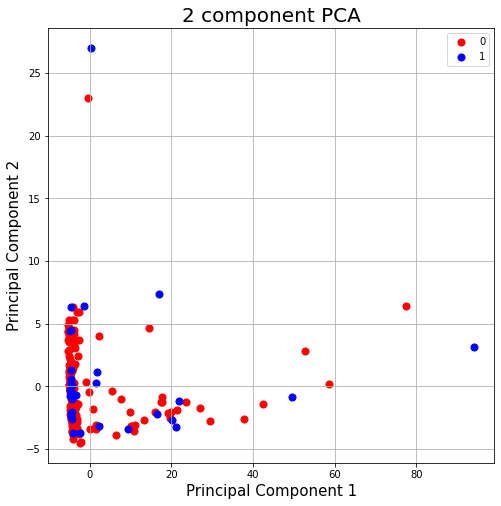

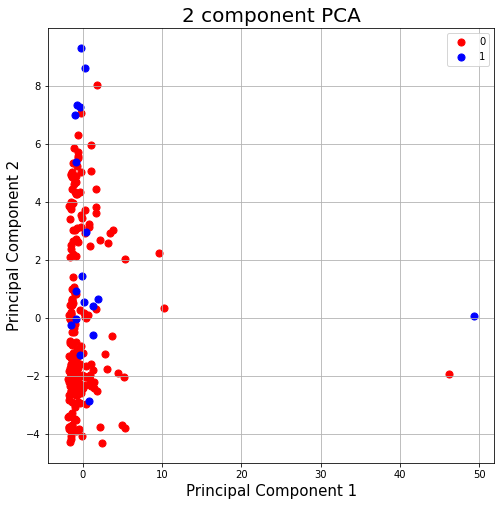

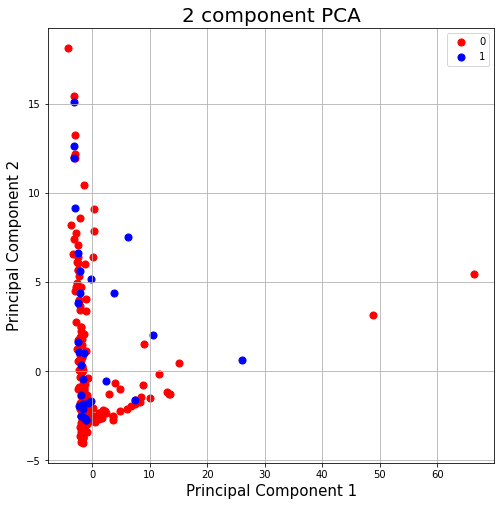

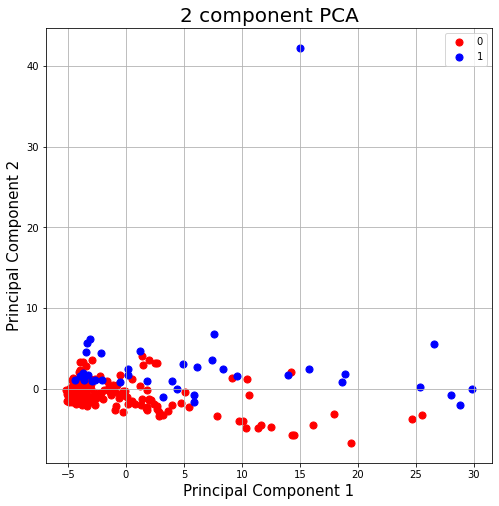

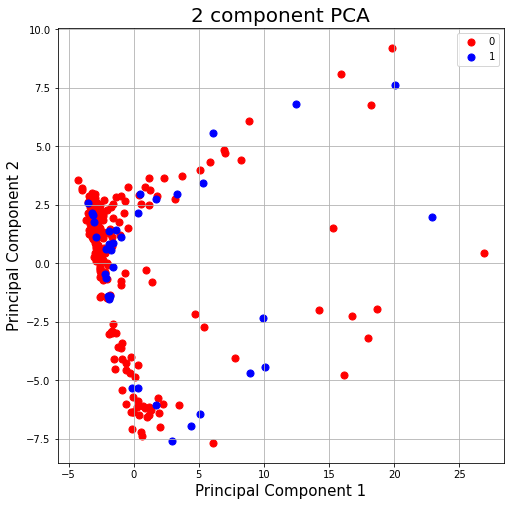

...

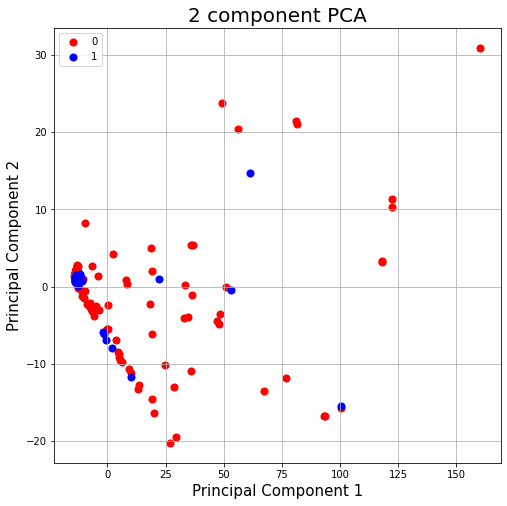

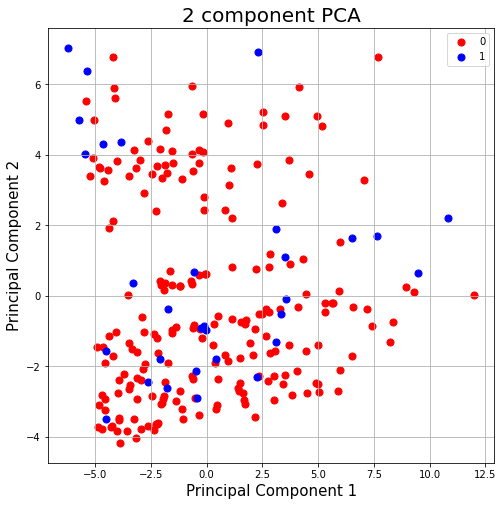

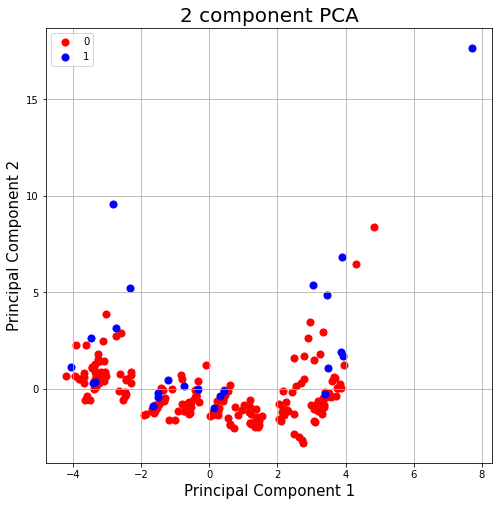

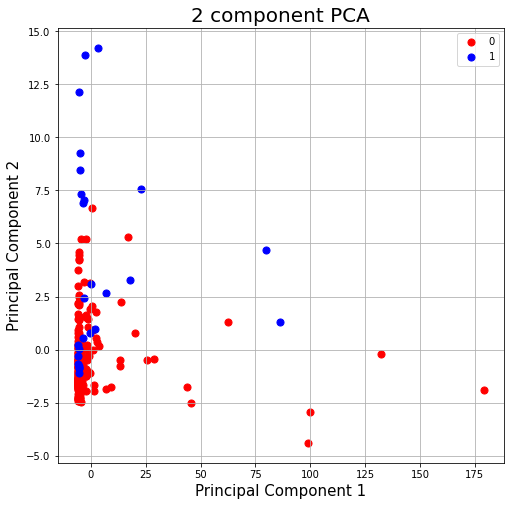

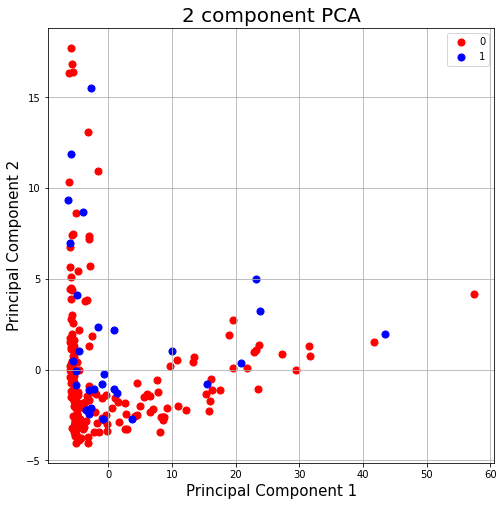

In [ ]:
for i in range(len(finalDfs)):

  fig = plt.figure(figsize = (8,8))
  ax = fig.add_subplot(1,1,1) 
  ax.set_xlabel('Principal Component 1', fontsize = 15)
  ax.set_ylabel('Principal Component 2', fontsize = 15)
  ax.set_title('2 component PCA', fontsize = 20)
  
  targets = [0, 1]
  colors = ['r', 'b']
  for target, color in zip(targets,colors):
      indicesToKeep = finalDfs[i]['probe'] == target
      ax.scatter(finalDfs[i].loc[indicesToKeep, 'principal component 1']
                , finalDfs[i].loc[indicesToKeep, 'principal component 2']
                , c = color
                , s = 50)
  ax.legend(targets)
  ax.grid()
  plt.savefig(f"/content/drive/MyDrive/Surjya Sir Work/PCA/User{i}PCA.jpg")
  plt.show()

In [ ]:
pca.explained_variance_ratio_

array([0.72611906, 0.11215186])

# Personalized models without SMOTE and without video 6

## Data Processing

### Import dataset

In [ ]:
directory_all = "/content/drive/MyDrive/Surjya Sir Work/5000"
directory_pbd = "/content/drive/MyDrive/Surjya Sir Work/5000_probed"

In [ ]:
# videos = [1,2,3,4,5,6,7,8]
videos = [1,2,3,4,7,8]

In [ ]:
all = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_all + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    all.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


In [ ]:
probed = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_pbd + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    probed.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


### Create df

In [ ]:
df = pd.DataFrame()
for i in range(len(all)):#per video = 8
  for j in range(len(all[i])): #per subject = 30
    df = df.append(all[i][j], ignore_index=True)

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8
5606,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8
5607,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8
5608,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8


In [ ]:
tester = pd.DataFrame()
for i in range(len(probed)):#per video = 8
  for j in range(len(probed[i])): #per subject = 30
    tester = tester.append(probed[i][j], ignore_index=True)

In [ ]:
tester

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1738876.01,1743876.01,1748876.01,6.309,5.096,0.013,0.106,5.632759,0.600,0.378,0.155,0.010,0.369,1.642,8.131,10,1
1,832168.01,837168.01,842168.01,6.488,5.290,0.012,0.159,1.883567,0.300,3.623,0.126,0.021,0.657,0.246,0.000,11,1
2,907168.01,912168.01,917168.01,5.330,4.958,0.394,0.082,3.340205,0.103,3.119,0.136,0.004,7.022,0.699,0.123,11,1
3,917168.01,922168.01,927168.01,6.046,5.011,0.767,0.003,2.078420,0.213,0.785,0.136,0.007,4.846,0.041,0.040,11,1
4,922168.01,927168.01,932168.01,6.476,5.014,0.430,0.022,2.208317,0.307,4.601,0.068,0.010,4.148,1.191,0.288,11,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
653,2282834.01,2287834.01,2292834.01,2.090,7.542,0.918,0.586,3.800016,3.170,4.349,0.261,0.003,0.082,2.916,1.602,8,8
654,2287834.01,2292834.01,2297834.01,1.199,8.115,1.181,0.661,5.052202,4.889,8.049,1.549,0.039,0.164,1.315,2.587,8,8
655,1166459.01,1171459.01,1176459.01,3.156,6.595,0.518,0.543,4.114055,0.256,0.368,4.792,0.011,2.998,3.368,13.429,9,8
656,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8


In [ ]:
temp = df[df.isin(tester)].dropna()

In [ ]:
temp = df.loc[df.set_index(list(df.columns)).index.isin(tester.set_index(list(tester.columns)).index)]

In [ ]:
temp.index

Int64Index([  35,   47,   62,   64,   65,   70,   99,  107,  117,  118,
            ...
            5511, 5532, 5551, 5554, 5559, 5575, 5576, 5604, 5605, 5606],
           dtype='int64', length=658)

In [ ]:
df['Probe'] = 0

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,0
5606,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,0
5607,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
5608,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
for idx in temp.index:
  df.at[idx, 'Probe'] = 1

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
5606,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
5607,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
5608,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


### Optimise df

In [ ]:
df = df.drop(columns=["Start", "Border", "End"], axis=1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
5606,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
5607,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
5608,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
df['valence_acc_video'] = 0
df['arousal_acc_video'] = 0

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,0,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,0,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,0,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,0,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,0
5606,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,0
5607,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,0
5608,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,0


I'm using the following encoding: 

1 - Low
2 - Mid/high
3 - High

In [ ]:
# def basedOnVideoValence(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 2
#     if int(video) == 6:
#         return 2
#     if int(video) == 7:
#         return 1
#     if int(video) == 8:
#         return 1
    
# def basedOnVideoArousal(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 1
#     if int(video) == 6:
#         return 1
#     if int(video) == 7:
#         return 3
#     if int(video) == 8:
#         return 3

New encoding, 
Low - 0 
Med / High - 1

In [ ]:
def basedOnVideoValence(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 1
    if int(video) == 6:
        return 1
    if int(video) == 7:
        return 0
    if int(video) == 8:
        return 0
    
def basedOnVideoArousal(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 0
    if int(video) == 6:
        return 0
    if int(video) == 7:
        return 1
    if int(video) == 8:
        return 1

In [ ]:
df['valence_acc_video'] = df.apply(lambda row : basedOnVideoValence(row['video']), axis = 1)
df['arousal_acc_video'] = df.apply(lambda row : basedOnVideoArousal(row['video']), axis = 1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1
5606,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1
5607,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1
5608,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1


### X,y for personalized models

In [ ]:
X_train_all = []
y_train_all = []
X_test_all = []
y_test_all = []

In [ ]:
users = []
for i in range(1, 31):
  users.append(i)

print(users)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30]


In [ ]:
for user in users:
  print("User", user)
  X_train = pd.DataFrame()
  y_train = pd.DataFrame()
  X_test = pd.DataFrame()
  y_test = pd.DataFrame()
  df_new = df[df['subject'] == str(user)]
  df_probe = df_new[df_new['Probe'] == 1]
  df_nonprobe = df_new[df_new['Probe'] == 0]

  y_probe = df_probe['Probe']
  y_nonprobe = df_nonprobe['Probe']

  y_probe = pd.DataFrame(y_probe)
  y_nonprobe = pd.DataFrame(y_nonprobe)

  X_probe = df_probe.drop(columns=["Probe"], axis = 1)
  X_nonprobe = df_nonprobe.drop(columns=["Probe"], axis = 1)

  X_train_probe, X_test_probe, y_train_probe, y_test_probe = train_test_split(X_probe, y_probe, test_size = 0.3)
  X_train_nonprobe, X_test_nonprobe, y_train_nonprobe, y_test_nonprobe = train_test_split(X_nonprobe, y_nonprobe, test_size = 0.3)

  X_train = X_train.append(X_train_probe)
  X_train = X_train.append(X_train_nonprobe)
  X_test = X_test.append(X_test_probe)
  X_test = X_test.append(X_test_nonprobe)
  y_train = y_train.append(y_train_probe)
  y_train = y_train.append(y_train_nonprobe)
  y_test = y_test.append(y_test_probe)
  y_test = y_test.append(y_test_nonprobe)


  
  # for video in videos:
  #   print("    Video", video)
  #   df_selected = df_new[df_new['video'] == video]
  #   df_probe = df_selected[df_selected['Probe'] == 1]
  #   df_nonprobe = df_selected[df_selected['Probe'] == 0]

  #   y_probe = df_probe['Probe']
  #   y_nonprobe = df_nonprobe['Probe']

  #   y_probe = pd.DataFrame(y_probe)
  #   y_nonprobe = pd.DataFrame(y_nonprobe)

  #   X_probe = df_probe.drop(columns=["Probe"], axis = 1)
  #   X_nonprobe = df_nonprobe.drop(columns=["Probe"], axis = 1)

  #   X_train_probe, X_test_probe, y_train_probe, y_test_probe = train_test_split(X_probe, y_probe, test_size = 0.5)
  #   X_train_nonprobe, X_test_nonprobe, y_train_nonprobe, y_test_nonprobe = train_test_split(X_nonprobe, y_nonprobe, test_size = 0.2)
  
  #   X_train = X_train.append(X_train_probe)
  #   X_train = X_train.append(X_train_nonprobe)
  #   X_test = X_test.append(X_test_probe)
  #   X_test = X_test.append(X_test_nonprobe)
  #   y_train = y_train.append(y_train_probe)
  #   y_train = y_train.append(y_train_nonprobe)
  #   y_test = y_test.append(y_test_probe)
  #   y_test = y_test.append(y_test_nonprobe)
  X_train_all.append(X_train)
  y_train_all.append(y_train)
  X_test_all.append(X_test)
  y_test_all.append(y_test)

User 1
User 2
User 3
User 4
User 5
User 6
User 7
User 8
User 9
User 10
User 11
User 12
User 13
User 14
User 15
User 16
User 17
User 18
User 19
User 20
User 21
User 22
User 23
User 24
User 25
User 26
User 27
User 28
User 29
User 30


In [ ]:
print(len(X_train_all[29]['subject'].unique()))

1


In [ ]:
X_train_all[2]

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,valence_acc_video,arousal_acc_video
1839,5.000,5.000,1.520,0.039,5.749306,2.870,0.377,1.181,0.007,0.411,0.287,4.189,3,2,1,1
3447,4.977,4.105,0.020,0.747,1.488032,0.769,0.038,0.145,0.000,0.042,1.150,0.123,3,4,0,0
3448,5.000,4.829,0.023,0.642,1.521831,0.579,0.203,0.910,0.000,0.082,0.329,0.370,3,4,0,0
3468,5.684,4.537,0.032,0.051,1.652376,0.469,0.562,0.901,0.004,0.904,0.246,0.164,3,4,0,0
3459,4.964,4.552,0.003,0.000,3.543979,0.603,0.048,0.048,0.007,6.982,0.246,0.000,3,4,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
837,8.173,6.385,0.144,0.134,0.364584,0.390,0.233,0.000,0.039,1.602,0.041,0.000,3,1,1,1
2589,4.986,1.434,0.000,0.120,0.598826,0.438,0.736,0.019,0.007,0.287,0.328,0.000,3,3,0,0
4562,1.966,9.135,0.255,0.856,0.399982,1.002,2.576,0.426,0.010,1.150,0.411,0.411,3,7,0,1
3449,5.000,4.747,0.000,0.086,1.370337,0.563,0.523,0.136,0.000,0.000,0.657,0.123,3,4,0,0


In [ ]:
new_X_train_all = []

for i in range(len(X_train_all)):
    df_temp = X_train_all[i]
    df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    new_X_train_all.append(df_temp)

X_train_all = new_X_train_all

new_X_test_all = []

for i in range(len(X_test_all)):
    df_temp = X_test_all[i]
    df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    new_X_test_all.append(df_temp)

X_test_all = new_X_test_all

In [ ]:
X_train_all[2]

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,valence_acc_video,arousal_acc_video
1839,5.000,5.000,1.520,0.039,5.749306,2.870,0.377,1.181,0.007,0.411,0.287,4.189,1,1
3447,4.977,4.105,0.020,0.747,1.488032,0.769,0.038,0.145,0.000,0.042,1.150,0.123,0,0
3448,5.000,4.829,0.023,0.642,1.521831,0.579,0.203,0.910,0.000,0.082,0.329,0.370,0,0
3468,5.684,4.537,0.032,0.051,1.652376,0.469,0.562,0.901,0.004,0.904,0.246,0.164,0,0
3459,4.964,4.552,0.003,0.000,3.543979,0.603,0.048,0.048,0.007,6.982,0.246,0.000,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
837,8.173,6.385,0.144,0.134,0.364584,0.390,0.233,0.000,0.039,1.602,0.041,0.000,1,1
2589,4.986,1.434,0.000,0.120,0.598826,0.438,0.736,0.019,0.007,0.287,0.328,0.000,0,0
4562,1.966,9.135,0.255,0.856,0.399982,1.002,2.576,0.426,0.010,1.150,0.411,0.411,0,1
3449,5.000,4.747,0.000,0.086,1.370337,0.563,0.523,0.136,0.000,0.000,0.657,0.123,0,0


In [ ]:
y_test_all[7]

,Probe
3626,1
5575,1
2014,1
1040,1
2004,1
2022,1
4744,1
3615,0
2035,0
4741,0


## Models

###RandomForest

#### Model

In [ ]:
from sklearn.ensemble import RandomForestClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []

TPs = []
FPs = []
FNs = []
TNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_rf = RandomForestClassifier() 
    tic = time.time()
    print("X_train_size = ", str(len(X_train)))
    print("X_test_size = ", str(len(X_test)))
    model_rf.fit(X_train, y_train) 
    toc = time.time()
    print("Random Forest Train time = " + str(toc-tic))
    print("Random Forest Accuracy = "+ str(model_rf.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_rf.predict(X_test)
    print("yhat_probs",yhat_probs)
    yhat_classes = (model_rf.predict(X_test) > 0.5).astype("int32")
    print("yhat_classes",yhat_classes)
    toc = time.time()
    print("Random Forest Test time = " + str(toc-tic))

    print("___________________Random Forest Stats _____________________")

    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

X_train_size =  130
X_test_size =  57
Random Forest Train time = 0.1554880142211914
Random Forest Accuracy = 0.9122807017543859
yhat_probs [1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


yhat_classes [1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04292488098144531
___________________Random Forest Stats _____________________
Accuracy: 0.912281
True negatives: 50
True positives: 2
False positives: 0
False negatives: 5
ROC AUC: 0.642857
F1 Score: 0.444444
Precision: 1.000000
TPR: 0.285714
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  130
X_test_size =  57
Random Forest Train time = 0.17311382293701172
Random Forest Accuracy = 0.9473684210526315


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


yhat_probs [0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04314017295837402
___________________Random Forest Stats _____________________
Accuracy: 0.947368
True negatives: 52
True positives: 2
False positives: 0
False negatives: 3
ROC AUC: 0.700000
F1 Score: 0.571429
Precision: 1.000000
TPR: 0.400000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  130
X_test_size =  57
Random Forest Train time = 0.15178275108337402
Random Forest Accuracy = 0.8771929824561403
yhat_probs [0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


yhat_classes [0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.03782033920288086
___________________Random Forest Stats _____________________
Accuracy: 0.877193
True negatives: 49
True positives: 1
False positives: 0
False negatives: 7
ROC AUC: 0.562500
F1 Score: 0.222222
Precision: 1.000000
TPR: 0.125000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  130
X_test_size =  57
Random Forest Train time = 0.16471481323242188
Random Forest Accuracy = 0.9122807017543859
yhat_probs [1 1 1 1 1 0 1 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 1 1 1 0 1 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04013633728027344
___________________Random For

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


yhat_classes [0 1 1 0 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.033237457275390625
___________________Random Forest Stats _____________________
Accuracy: 0.929825
True negatives: 48
True positives: 5
False positives: 0
False negatives: 4
ROC AUC: 0.777778
F1 Score: 0.714286
Precision: 1.000000
TPR: 0.555556
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  130
X_test_size =  57
Random Forest Train time = 0.16402983665466309
Random Forest Accuracy = 0.8947368421052632
yhat_probs [1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04402470588684082
___________________Random Fo

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


yhat_probs [0 1 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04119253158569336
___________________Random Forest Stats _____________________
Accuracy: 0.894737
True negatives: 48
True positives: 3
False positives: 2
False negatives: 4
ROC AUC: 0.694286
F1 Score: 0.500000
Precision: 0.600000
TPR: 0.428571
FPR: 0.040000
____________________________________________________________
____________________________________________________________
X_train_size =  130
X_test_size =  57
Random Forest Train time = 0.15637850761413574
Random Forest Accuracy = 0.9298245614035088
yhat_probs [0 0 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


 [0 0 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.03458142280578613
___________________Random Forest Stats _____________________
Accuracy: 0.929825
True negatives: 50
True positives: 3
False positives: 0
False negatives: 4
ROC AUC: 0.714286
F1 Score: 0.600000
Precision: 1.000000
TPR: 0.428571
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  130
X_test_size =  57
Random Forest Train time = 0.15928363800048828
Random Forest Accuracy = 0.9473684210526315
yhat_probs [0 1 1 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


 [0 1 1 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.03870034217834473
___________________Random Forest Stats _____________________
Accuracy: 0.947368
True negatives: 48
True positives: 6
False positives: 1
False negatives: 2
ROC AUC: 0.864796
F1 Score: 0.800000
Precision: 0.857143
TPR: 0.750000
FPR: 0.020408
____________________________________________________________
____________________________________________________________
X_train_size =  130
X_test_size =  57
Random Forest Train time = 0.1564037799835205
Random Forest Accuracy = 0.8947368421052632
yhat_probs [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.02959728240966797
___________________Random Forest Stats ___

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:59: RuntimeWarning: invalid value encountered in long_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


True negatives: 51
True positives: 0
False positives: 0
False negatives: 6
ROC AUC: 0.500000
F1 Score: 0.000000
Precision: nan
TPR: 0.000000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  130
X_test_size =  57
Random Forest Train time = 0.16567587852478027
Random Forest Accuracy = 0.9473684210526315
yhat_probs [1 1 1 1 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 1 1 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.046440839767456055
___________________Random Forest Stats _____________________
Accuracy: 0.947368
True negatives: 49
True positives: 5
False positives: 1
False negatives: 2
ROC AUC: 0.847143
F1 Score: 0.769231
Precision: 0.833333
TPR: 0.714286
FPR: 0.020000
_________________________________________________

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


yhat_classes [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.03739643096923828
___________________Random Forest Stats _____________________
Accuracy: 0.894737
True negatives: 51
True positives: 0
False positives: 0
False negatives: 6
ROC AUC: 0.500000
F1 Score: 0.000000
Precision: nan
TPR: 0.000000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  130
X_test_size =  57
Random Forest Train time = 0.15248823165893555
Random Forest Accuracy = 0.8947368421052632
yhat_probs [1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:59: RuntimeWarning: invalid value encountered in long_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


yhat_classes [1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.031548500061035156
___________________Random Forest Stats _____________________
Accuracy: 0.894737
True negatives: 49
True positives: 2
False positives: 1
False negatives: 5
ROC AUC: 0.632857
F1 Score: 0.400000
Precision: 0.666667
TPR: 0.285714
FPR: 0.020000
____________________________________________________________
____________________________________________________________
X_train_size =  130
X_test_size =  57
Random Forest Train time = 0.1633162498474121
Random Forest Accuracy = 0.9122807017543859
yhat_probs [0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.029258251190185547
___________________Random Fo

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.16032910346984863
Random Forest Accuracy = 0.9298245614035088
yhat_probs [0 1 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04193472862243652
___________________Random Forest Stats _____________________
Accuracy: 0.929825
True negatives: 50
True positives: 3
False positives: 0
False negatives: 4
ROC AUC: 0.714286
F1 Score: 0.600000
Precision: 1.000000
TPR: 0.428571
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  130
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.16491222381591797
Random Forest Accuracy = 0.9122807017543859
yhat_probs [0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.0404665470123291
___________________Random Forest Stats _____________________
Accuracy: 0.912281
True negatives: 50
True positives: 2
False positives: 1
False negatives: 4
ROC AUC: 0.656863
F1 Score: 0.444444
Precision: 0.666667
TPR: 0.333333
FPR: 0.019608
____________________________________________________________
____________________________________________________________
X_train_size =  130
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.15714120864868164
Random Forest Accuracy = 0.8771929824561403
yhat_probs [0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0]
yhat_classes [0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0]
Random Forest Test time = 0.03666543960571289
___________________Random Forest Stats _____________________
Accuracy: 0.877193
True negatives: 48
True positives: 2
False positives: 2
False negatives: 5
ROC AUC: 0.622857
F1 Score: 0.363636
Precision: 0.500000
TPR: 0.285714
FPR: 0.040000
____________________________________________________________
____________________________________________________________
X_train_size =  130
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.15523099899291992
Random Forest Accuracy = 0.9298245614035088
yhat_probs [0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04194474220275879
___________________Random Forest Stats _____________________
Accuracy: 0.929825
True negatives: 52
True positives: 1
False positives: 0
False negatives: 4
ROC AUC: 0.600000
F1 Score: 0.333333
Precision: 1.000000
TPR: 0.200000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  130
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.15195131301879883
Random Forest Accuracy = 0.8596491228070176
yhat_probs [0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.02866196632385254
___________________Random Forest Stats _____________________
Accuracy: 0.859649
True negatives: 48
True positives: 1
False positives: 0
False negatives: 8
ROC AUC: 0.555556
F1 Score: 0.200000
Precision: 1.000000
TPR: 0.111111
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  130
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.15771150588989258
Random Forest Accuracy = 0.9649122807017544
yhat_probs [0 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.02954888343811035
___________________Random Forest Stats _____________________
Accuracy: 0.964912
True negatives: 49
True positives: 6
False positives: 0
False negatives: 2
ROC AUC: 0.875000
F1 Score: 0.857143
Precision: 1.000000
TPR: 0.750000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  130
X_test_size =  57
Random Forest Train time = 0.1675713062286377
Random Forest Accuracy = 0.8596491228070176
yhat_probs [0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Accuracy = 0.8947368421052632
yhat_probs [0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.0424036979675293
___________________Random Forest Stats _____________________
Accuracy: 0.894737
True negatives: 50
True positives: 1
False positives: 0
False negatives: 6
ROC AUC: 0.571429
F1 Score: 0.250000
Precision: 1.000000
TPR: 0.142857
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  130
X_test_size =  57
Random Forest Train time = 0.1501789093017578
Random Forest Accuracy = 0.8596491228070176
yhat_probs [0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0]


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


yhat_classes [0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.03783988952636719
___________________Random Forest Stats _____________________
Accuracy: 0.859649
True negatives: 47
True positives: 2
False positives: 2
False negatives: 6
ROC AUC: 0.604592
F1 Score: 0.333333
Precision: 0.500000
TPR: 0.250000
FPR: 0.040816
____________________________________________________________
____________________________________________________________
X_train_size =  130
X_test_size =  57
Random Forest Train time = 0.15802574157714844
Random Forest Accuracy = 0.9122807017543859
yhat_probs [1 1 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.03467679023742676
___________________Random For

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.15874767303466797
Random Forest Accuracy = 0.8421052631578947
yhat_probs [0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.040404558181762695
___________________Random Forest Stats _____________________
Accuracy: 0.842105
True negatives: 47
True positives: 1
False positives: 2
False negatives: 7
ROC AUC: 0.542092
F1 Score: 0.181818
Precision: 0.333333
TPR: 0.125000
FPR: 0.040816
____________________________________________________________
____________________________________________________________
X_train_size =  130
X_test_size =  57
Random Forest Train time = 0.14188313484191895


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Accuracy = 0.9298245614035088
yhat_probs [1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.03713059425354004
___________________Random Forest Stats _____________________
Accuracy: 0.929825
True negatives: 51
True positives: 2
False positives: 0
False negatives: 4
ROC AUC: 0.666667
F1 Score: 0.500000
Precision: 1.000000
TPR: 0.333333
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  130
X_test_size =  57
Random Forest Train time = 0.15928053855895996
Random Forest Accuracy = 0.8947368421052632
yhat_probs [1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 0 0 1 0 0 0 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:59: RuntimeWarning: invalid value encountered in long_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


ROC AUC: 0.500000
F1 Score: 0.000000
Precision: nan
TPR: 0.000000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  130
X_test_size =  57
Random Forest Train time = 0.15415620803833008
Random Forest Accuracy = 0.9824561403508771
yhat_probs [1 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.043581485748291016
___________________Random Forest Stats _____________________
Accuracy: 0.982456
True negatives: 51
True positives: 5
False positives: 0
False negatives: 1


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


ROC AUC: 0.916667
F1 Score: 0.909091
Precision: 1.000000
TPR: 0.833333
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  130
X_test_size =  57
Random Forest Train time = 0.17296934127807617
Random Forest Accuracy = 0.9473684210526315
yhat_probs [1 0 0 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04074454307556152
___________________Random Forest Stats _____________________
Accuracy: 0.947368
True negatives: 50
True positives: 4
False positives: 0
False negatives: 3
ROC AUC: 0.785714
F1 Score: 0.727273
Precision: 1.000000
TPR: 0.571429
FPR: 0.000000
____________________________________________________________
___________________________________________________________

#### Results

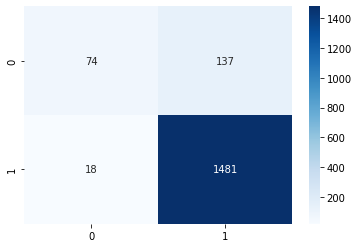

In [ ]:
import seaborn as sns

TPsum = np.sum(TPs)
TNsum = np.sum(TNs)
FPsum = np.sum(FPs)
FNsum = np.sum(FNs)

cm_data = [[TPsum, FNsum], [FPsum, TNsum]]
sns.heatmap(cm_data, annot=True, cmap='Blues', fmt='d')

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
RFWithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([RFWithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC       F1  ...        TP         TN   FP        FN
Average  15.5  0.909357  0.664108  0.43799  ...  2.466667  49.366667  0.6  4.566667

[1 rows x 11 columns]


In [ ]:
RFWithSMOTE = RFWithSMOTE.append(df_temp)

In [ ]:
print(RFWithSMOTE)
RFWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/Personalized/RFPersonalized.csv', index = True)

         User  Accuracy   ROC_AUC        F1  ...        TP         TN   FP        FN
0         1.0  0.912281  0.642857  0.444444  ...  2.000000  50.000000  0.0  5.000000
1         2.0  0.947368  0.700000  0.571429  ...  2.000000  52.000000  0.0  3.000000
2         3.0  0.877193  0.562500  0.222222  ...  1.000000  49.000000  0.0  7.000000
3         4.0  0.912281  0.828723  0.736842  ...  7.000000  45.000000  2.0  3.000000
4         5.0  0.929825  0.777778  0.714286  ...  5.000000  48.000000  0.0  4.000000
5         6.0  0.894737  0.573529  0.250000  ...  1.000000  50.000000  1.0  5.000000
6         7.0  0.894737  0.694286  0.500000  ...  3.000000  48.000000  2.0  4.000000
7         8.0  0.929825  0.714286  0.600000  ...  3.000000  50.000000  0.0  4.000000
8         9.0  0.947368  0.864796  0.800000  ...  6.000000  48.000000  1.0  2.000000
9        10.0  0.894737  0.500000  0.000000  ...  0.000000  51.000000  0.0  6.000000
10       11.0  0.947368  0.847143  0.769231  ...  5.000000  49.00

###Descision Tree

####Model

In [ ]:
from sklearn.tree import DecisionTreeClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_dt = DecisionTreeClassifier()
    tic = time.time()
    model_dt.fit(X_train, y_train) 
    toc = time.time()
    print("Decision Tree Train time = " + str(toc-tic))
    print("Decision Tree Accuracy = "+ str(model_dt.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_dt.predict(X_test)
    yhat_classes = (model_dt.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Decision Tree Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Decision Tree Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

Decision Tree Train time = 0.0032854080200195312
Decision Tree Accuracy = 0.9473684210526315
Decision Tree Test time = 0.0032503604888916016
(57,)
(57,)
___________________Decision Tree Stats _____________________
Accuracy: 0.947368
True negatives: 50
True positives: 4
False positives: 0
False negatives: 3
ROC AUC: 0.785714
F1 Score: 0.727273
Precision: 1.000000
TPR: 0.571429
FPR: 0.000000
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.005162477493286133
Decision Tree Accuracy = 0.9122807017543859
Decision Tree Test time = 0.0031108856201171875
(57,)
(57,)
___________________Decision Tree Stats _____________________
Accuracy: 0.912281
True negatives: 49
True positives: 3
False positives: 3
False negatives: 2
ROC AUC: 0.771154
F1 Score: 0.545455
Precision: 0.500000
TPR: 0.600000
FPR: 0.057692
____________________________________________________________
________________________________

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
DTWithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DTWithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC        F1  ...        TP         TN   FP        FN
Average  15.5  0.909357  0.795506  0.640021  ...  4.566667  47.266667  2.7  2.466667

[1 rows x 11 columns]


In [ ]:
DTWithSMOTE = DTWithSMOTE.append(df_temp)

In [ ]:
print(DTWithSMOTE)
DTWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/Personalized/DTPersonalized.csv', index = True)

         User  Accuracy   ROC_AUC  ...         TN   FP        FN
0         1.0  0.947368  0.785714  ...  50.000000  0.0  3.000000
1         2.0  0.912281  0.771154  ...  49.000000  3.0  2.000000
2         3.0  0.947368  0.812500  ...  49.000000  0.0  3.000000
3         4.0  0.947368  0.968085  ...  44.000000  3.0  0.000000
4         5.0  0.894737  0.802083  ...  45.000000  3.0  3.000000
5         6.0  0.929825  0.740196  ...  50.000000  1.0  3.000000
6         7.0  0.894737  0.755714  ...  47.000000  3.0  3.000000
7         8.0  0.964912  0.918571  ...  49.000000  1.0  1.000000
8         9.0  0.912281  0.844388  ...  46.000000  3.0  2.000000
9        10.0  0.912281  0.656863  ...  50.000000  1.0  4.000000
10       11.0  0.859649  0.674286  ...  46.000000  4.0  4.000000
11       12.0  0.964912  0.906863  ...  50.000000  1.0  1.000000
12       13.0  0.824561  0.654286  ...  44.000000  6.0  4.000000
13       14.0  0.929825  0.813725  ...  49.000000  2.0  2.000000
14       15.0  0.947368  

###Gradient Boost

####Model

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_gb = GradientBoostingClassifier(n_estimators = 1000) 
    tic = time.time()
    model_gb.fit(X_train, y_train) 
    toc = time.time()
    print("Gradient Boost Train time = " + str(toc-tic))
    print("Gradient Boost Accuracy = "+ str(model_gb.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_gb.predict(X_test)
    yhat_classes = (model_gb.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Gradient Boost Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Gradient Boost Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.39122605323791504
Gradient Boost Accuracy = 0.8771929824561403
Gradient Boost Test time = 0.0054874420166015625
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.877193
True negatives: 47
True positives: 3
False positives: 3
False negatives: 4
ROC AUC: 0.684286
F1 Score: 0.461538
Precision: 0.500000
TPR: 0.428571
FPR: 0.060000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.3715176582336426
Gradient Boost Accuracy = 0.9824561403508771
Gradient Boost Test time = 0.0047817230224609375
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.982456
True negatives: 51
True positives: 5
False positives: 1
False negatives: 0
ROC AUC: 0.990385
F1 Score: 0.909091
Precision: 0.833333
TPR: 1.000000
FPR: 0.019231
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.5057394504547119
Gradient Boost Accuracy = 0.9298245614035088
Gradient Boost Test time = 0.005371809005737305
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.929825
True negatives: 49
True positives: 4
False positives: 0
False negatives: 4
ROC AUC: 0.750000
F1 Score: 0.666667
Precision: 1.000000
TPR: 0.500000
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.48575639724731445
Gradient Boost Accuracy = 0.9473684210526315
Gradient Boost Test time = 0.005822896957397461
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.947368
True negatives: 45
True positives: 9
False positives: 2
False negatives: 1
ROC AUC: 0.928723
F1 Score: 0.857143
Precision: 0.818182
TPR: 0.900000
FPR: 0.042553
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.55545973777771
Gradient Boost Accuracy = 0.9473684210526315
Gradient Boost Test time = 0.0056531429290771484
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.947368
True negatives: 48
True positives: 6
False positives: 0
False negatives: 3
ROC AUC: 0.833333
F1 Score: 0.800000
Precision: 1.000000
TPR: 0.666667
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.47182250022888184
Gradient Boost Accuracy = 0.9473684210526315
Gradient Boost Test time = 0.0053861141204833984
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.947368
True negatives: 50
True positives: 4
False positives: 1
False negatives: 2
ROC AUC: 0.823529
F1 Score: 0.727273
Precision: 0.800000
TPR: 0.666667
FPR: 0.019608
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.37228894233703613
Gradient Boost Accuracy = 0.9473684210526315
Gradient Boost Test time = 0.0046923160552978516
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.947368
True negatives: 47
True positives: 7
False positives: 3
False negatives: 0
ROC AUC: 0.970000
F1 Score: 0.823529
Precision: 0.700000
TPR: 1.000000
FPR: 0.060000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.3773376941680908
Gradient Boost Accuracy = 0.9649122807017544
Gradient Boost Test time = 0.005616188049316406
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.964912
True negatives: 49
True positives: 6
False positives: 1
False negatives: 1
ROC AUC: 0.918571
F1 Score: 0.857143
Precision: 0.857143
TPR: 0.857143
FPR: 0.020000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.4982161521911621
Gradient Boost Accuracy = 0.9649122807017544
Gradient Boost Test time = 0.00550079345703125
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.964912
True negatives: 48
True positives: 7
False positives: 1
False negatives: 1
ROC AUC: 0.927296
F1 Score: 0.875000
Precision: 0.875000
TPR: 0.875000
FPR: 0.020408
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.4797534942626953
Gradient Boost Accuracy = 0.9122807017543859
Gradient Boost Test time = 0.007535219192504883
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.912281
True negatives: 51
True positives: 1
False positives: 0
False negatives: 5
ROC AUC: 0.583333
F1 Score: 0.285714
Precision: 1.000000
TPR: 0.166667
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.5453641414642334
Gradient Boost Accuracy = 0.9122807017543859
Gradient Boost Test time = 0.007020235061645508
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.912281
True negatives: 47
True positives: 5
False positives: 3
False negatives: 2
ROC AUC: 0.827143
F1 Score: 0.666667
Precision: 0.625000
TPR: 0.714286
FPR: 0.060000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.522773027420044
Gradient Boost Accuracy = 0.9649122807017544
Gradient Boost Test time = 0.005722761154174805
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.964912
True negatives: 50
True positives: 5
False positives: 1
False negatives: 1
ROC AUC: 0.906863
F1 Score: 0.833333
Precision: 0.833333
TPR: 0.833333
FPR: 0.019608
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.3741629123687744
Gradient Boost Accuracy = 0.9122807017543859
Gradient Boost Test time = 0.0060765743255615234
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.912281
True negatives: 48
True positives: 4
False positives: 2
False negatives: 3
ROC AUC: 0.765714
F1 Score: 0.615385
Precision: 0.666667
TPR: 0.571429
FPR: 0.040000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.3878166675567627
Gradient Boost Accuracy = 0.9649122807017544
Gradient Boost Test time = 0.007860660552978516
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.964912
True negatives: 50
True positives: 5
False positives: 1
False negatives: 1
ROC AUC: 0.906863
F1 Score: 0.833333
Precision: 0.833333
TPR: 0.833333
FPR: 0.019608
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.48067784309387207
Gradient Boost Accuracy = 0.9649122807017544
Gradient Boost Test time = 0.005526304244995117
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.964912
True negatives: 49
True positives: 6
False positives: 1
False negatives: 1
ROC AUC: 0.918571
F1 Score: 0.857143
Precision: 0.857143
TPR: 0.857143
FPR: 0.020000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.46015286445617676
Gradient Boost Accuracy = 0.8421052631578947
Gradient Boost Test time = 0.006739377975463867
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.842105
True negatives: 46
True positives: 2
False positives: 5
False negatives: 4
ROC AUC: 0.617647
F1 Score: 0.307692
Precision: 0.285714
TPR: 0.333333
FPR: 0.098039
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.586493730545044
Gradient Boost Accuracy = 0.8947368421052632
Gradient Boost Test time = 0.006396770477294922
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.894737
True negatives: 48
True positives: 3
False positives: 2
False negatives: 4
ROC AUC: 0.694286
F1 Score: 0.500000
Precision: 0.600000
TPR: 0.428571
FPR: 0.040000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.5418379306793213
Gradient Boost Accuracy = 0.9649122807017544
Gradient Boost Test time = 0.0069272518157958984
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.964912
True negatives: 52
True positives: 3
False positives: 0
False negatives: 2
ROC AUC: 0.800000
F1 Score: 0.750000
Precision: 1.000000
TPR: 0.600000
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.5791170597076416
Gradient Boost Accuracy = 0.9122807017543859
Gradient Boost Test time = 0.006563663482666016
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.912281
True negatives: 47
True positives: 5
False positives: 1
False negatives: 4
ROC AUC: 0.767361
F1 Score: 0.666667
Precision: 0.833333
TPR: 0.555556
FPR: 0.020833
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.5293560028076172
Gradient Boost Accuracy = 0.9473684210526315
Gradient Boost Test time = 0.005700111389160156
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.947368
True negatives: 48
True positives: 6
False positives: 1
False negatives: 2
ROC AUC: 0.864796
F1 Score: 0.800000
Precision: 0.857143
TPR: 0.750000
FPR: 0.020408
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.5458009243011475
Gradient Boost Accuracy = 0.9122807017543859
Gradient Boost Test time = 0.0062563419342041016
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.912281
True negatives: 48
True positives: 4
False positives: 1
False negatives: 4
ROC AUC: 0.739796
F1 Score: 0.615385
Precision: 0.800000
TPR: 0.500000
FPR: 0.020408
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.48522043228149414
Gradient Boost Accuracy = 0.9473684210526315
Gradient Boost Test time = 0.005980253219604492
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.947368
True negatives: 49
True positives: 5
False positives: 1
False negatives: 2
ROC AUC: 0.847143
F1 Score: 0.769231
Precision: 0.833333
TPR: 0.714286
FPR: 0.020000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.4937760829925537
Gradient Boost Accuracy = 0.8947368421052632
Gradient Boost Test time = 0.006514787673950195
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.894737
True negatives: 45
True positives: 6
False positives: 4
False negatives: 2
ROC AUC: 0.834184
F1 Score: 0.666667
Precision: 0.600000
TPR: 0.750000
FPR: 0.081633
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.40341782569885254
Gradient Boost Accuracy = 0.9122807017543859
Gradient Boost Test time = 0.005739688873291016
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.912281
True negatives: 47
True positives: 5
False positives: 3
False negatives: 2
ROC AUC: 0.827143
F1 Score: 0.666667
Precision: 0.625000
TPR: 0.714286
FPR: 0.060000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.5665931701660156
Gradient Boost Accuracy = 0.8596491228070176
Gradient Boost Test time = 0.0062255859375
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.859649
True negatives: 46
True positives: 3
False positives: 3
False negatives: 5
ROC AUC: 0.656888
F1 Score: 0.428571
Precision: 0.500000
TPR: 0.375000
FPR: 0.061224
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.36855506896972656
Gradient Boost Accuracy = 0.9649122807017544
Gradient Boost Test time = 0.007782936096191406
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.964912
True negatives: 50
True positives: 5
False positives: 1
False negatives: 1
ROC AUC: 0.906863
F1 Score: 0.833333
Precision: 0.833333
TPR: 0.833333
FPR: 0.019608
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.4806694984436035
Gradient Boost Accuracy = 0.9473684210526315
Gradient Boost Test time = 0.006168842315673828
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.947368
True negatives: 48
True positives: 6
False positives: 2
False negatives: 1
ROC AUC: 0.908571
F1 Score: 0.800000
Precision: 0.750000
TPR: 0.857143
FPR: 0.040000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.5492732524871826
Gradient Boost Accuracy = 0.8421052631578947
Gradient Boost Test time = 0.005109310150146484
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.842105
True negatives: 45
True positives: 3
False positives: 6
False negatives: 3
ROC AUC: 0.691176
F1 Score: 0.400000
Precision: 0.333333
TPR: 0.500000
FPR: 0.117647
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.44349122047424316
Gradient Boost Accuracy = 0.9649122807017544
Gradient Boost Test time = 0.007787466049194336
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.964912
True negatives: 50
True positives: 5
False positives: 1
False negatives: 1
ROC AUC: 0.906863
F1 Score: 0.833333
Precision: 0.833333
TPR: 0.833333
FPR: 0.019608
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.497406005859375
Gradient Boost Accuracy = 0.9298245614035088
Gradient Boost Test time = 0.007065534591674805
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.929825
True negatives: 48
True positives: 5
False positives: 2
False negatives: 2
ROC AUC: 0.837143
F1 Score: 0.714286
Precision: 0.714286
TPR: 0.714286
FPR: 0.040000
____________________________________________________________
____________________________________________________________


#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
GBWithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([GBWithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC        F1  ...        TP    TN        FP        FN
Average  15.5   0.92924  0.821149  0.694026  ...  4.766667  48.2  1.766667  2.266667

[1 rows x 11 columns]


In [ ]:
GBWithSMOTE = GBWithSMOTE.append(df_temp)

In [ ]:
print(GBWithSMOTE)
GBWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/Personalized/GBPersonalized.csv', index = True)

         User  Accuracy   ROC_AUC        F1  ...        TP    TN        FP        FN
0         1.0  0.877193  0.684286  0.461538  ...  3.000000  47.0  3.000000  4.000000
1         2.0  0.982456  0.990385  0.909091  ...  5.000000  51.0  1.000000  0.000000
2         3.0  0.929825  0.750000  0.666667  ...  4.000000  49.0  0.000000  4.000000
3         4.0  0.947368  0.928723  0.857143  ...  9.000000  45.0  2.000000  1.000000
4         5.0  0.947368  0.833333  0.800000  ...  6.000000  48.0  0.000000  3.000000
5         6.0  0.947368  0.823529  0.727273  ...  4.000000  50.0  1.000000  2.000000
6         7.0  0.947368  0.970000  0.823529  ...  7.000000  47.0  3.000000  0.000000
7         8.0  0.964912  0.918571  0.857143  ...  6.000000  49.0  1.000000  1.000000
8         9.0  0.964912  0.927296  0.875000  ...  7.000000  48.0  1.000000  1.000000
9        10.0  0.912281  0.583333  0.285714  ...  1.000000  51.0  0.000000  5.000000
10       11.0  0.912281  0.827143  0.666667  ...  5.000000  47.0 

###3 DNN

#### Model

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model3 = Sequential()

    model3.add(Dense(64, activation='relu', input_shape=(14,)))
    model3.add(Dropout(0.3))
    model3.add(Dense(32, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(8, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(1, activation='sigmoid'))

    model3.compile(loss='binary_crossentropy',
                  optimizer='adam',
                  metrics=['accuracy'])
    reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=0.001)
    tic = time.time()
    model3.fit(X_train, y_train, batch_size=64, epochs=100, validation_split=0.1, callbacks=[reduce_lr])
    toc = time.time()
    print("3 DNN Train time = " + str(toc-tic))
    print("3 DNN Accuracy = "+ str(model3.evaluate(X_test, y_test, verbose=0)[1]))
    tic = time.time()
    yhat_probs = model3.predict(X_test, verbose=0)
    yhat_classes = (model3.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("3 DNN Test time = " + str(toc-tic))
    yhat_probs = yhat_probs[:, 0]
    yhat_classes = yhat_classes[:, 0]
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________3 DNN Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

Epoch 1/100
2/2 [==============================] - 1s 207ms/step - loss: 1.2859 - accuracy: 0.5128 - val_loss: 0.9705 - val_accuracy: 0.7692 - lr: 0.0010
Epoch 2/100
2/2 [==============================] - 0s 29ms/step - loss: 1.6891 - accuracy: 0.6752 - val_loss: 0.6991 - val_accuracy: 0.7692 - lr: 0.0010
Epoch 3/100
2/2 [==============================] - 0s 27ms/step - loss: 1.1033 - accuracy: 0.6496 - val_loss: 0.4919 - val_accuracy: 0.7692 - lr: 0.0010
Epoch 4/100
2/2 [==============================] - 0s 25ms/step - loss: 0.8341 - accuracy: 0.7265 - val_loss: 0.3379 - val_accuracy: 0.9231 - lr: 0.0010
Epoch 5/100
2/2 [==============================] - 0s 26ms/step - loss: 0.7975 - accuracy: 0.7265 - val_loss: 0.2618 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
2/2 [==============================] - 0s 31ms/step - loss: 0.9603 - accuracy: 0.7436 - val_loss: 0.2384 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
2/2 [==============================] - 0s 51ms/step - loss: 0.7949 - 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


Epoch 1/100
2/2 [==============================] - 1s 195ms/step - loss: 0.8143 - accuracy: 0.6410 - val_loss: 0.2833 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 2/100
2/2 [==============================] - 0s 25ms/step - loss: 0.6857 - accuracy: 0.7436 - val_loss: 0.2439 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 3/100
2/2 [==============================] - 0s 29ms/step - loss: 0.5684 - accuracy: 0.7607 - val_loss: 0.2146 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
2/2 [==============================] - 0s 33ms/step - loss: 0.5511 - accuracy: 0.8120 - val_loss: 0.1919 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
2/2 [==============================] - 0s 28ms/step - loss: 0.4940 - accuracy: 0.7521 - val_loss: 0.1732 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
2/2 [==============================] - 0s 25ms/step - loss: 0.4398 - accuracy: 0.8632 - val_loss: 0.1563 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
2/2 [==============================] - 0s 26ms/step - loss: 0.3786 - 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


2/2 [==============================] - 1s 182ms/step - loss: 2.7238 - accuracy: 0.2051 - val_loss: 3.7818 - val_accuracy: 0.0000e+00 - lr: 0.0010
Epoch 2/100
2/2 [==============================] - 0s 28ms/step - loss: 2.9362 - accuracy: 0.2308 - val_loss: 3.2334 - val_accuracy: 0.0000e+00 - lr: 0.0010
Epoch 3/100
2/2 [==============================] - 0s 27ms/step - loss: 2.0233 - accuracy: 0.2308 - val_loss: 2.7447 - val_accuracy: 0.0000e+00 - lr: 0.0010
Epoch 4/100
2/2 [==============================] - 0s 25ms/step - loss: 1.8041 - accuracy: 0.2479 - val_loss: 2.2946 - val_accuracy: 0.0000e+00 - lr: 0.0010
Epoch 5/100
2/2 [==============================] - 0s 25ms/step - loss: 1.8572 - accuracy: 0.2821 - val_loss: 1.8971 - val_accuracy: 0.0000e+00 - lr: 0.0010
Epoch 6/100
2/2 [==============================] - 0s 26ms/step - loss: 1.6003 - accuracy: 0.3333 - val_loss: 1.5239 - val_accuracy: 0.0769 - lr: 0.0010
Epoch 7/100
2/2 [==============================] - 0s 26ms/step - loss: 1

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


2/2 [==============================] - 1s 186ms/step - loss: 1.5860 - accuracy: 0.3077 - val_loss: 1.0810 - val_accuracy: 0.1538 - lr: 0.0010
Epoch 2/100
2/2 [==============================] - 0s 31ms/step - loss: 1.2449 - accuracy: 0.3419 - val_loss: 0.8625 - val_accuracy: 0.2308 - lr: 0.0010
Epoch 3/100
2/2 [==============================] - 0s 31ms/step - loss: 1.3586 - accuracy: 0.2906 - val_loss: 0.6891 - val_accuracy: 0.4615 - lr: 0.0010
Epoch 4/100
2/2 [==============================] - 0s 31ms/step - loss: 0.9359 - accuracy: 0.4701 - val_loss: 0.5737 - val_accuracy: 0.7692 - lr: 0.0010
Epoch 5/100
2/2 [==============================] - 0s 25ms/step - loss: 0.8755 - accuracy: 0.5299 - val_loss: 0.4874 - val_accuracy: 0.8462 - lr: 0.0010
Epoch 6/100
2/2 [==============================] - 0s 25ms/step - loss: 0.8798 - accuracy: 0.5128 - val_loss: 0.4193 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
2/2 [==============================] - 0s 25ms/step - loss: 0.7322 - accuracy: 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


2/2 [==============================] - 1s 183ms/step - loss: 0.6585 - accuracy: 0.6325 - val_loss: 0.5657 - val_accuracy: 0.9231 - lr: 0.0010
Epoch 2/100
2/2 [==============================] - 0s 35ms/step - loss: 0.6019 - accuracy: 0.6838 - val_loss: 0.4976 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 3/100
2/2 [==============================] - 0s 33ms/step - loss: 0.6126 - accuracy: 0.7265 - val_loss: 0.4380 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
2/2 [==============================] - 0s 29ms/step - loss: 0.6081 - accuracy: 0.7350 - val_loss: 0.3910 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
2/2 [==============================] - 0s 25ms/step - loss: 0.5749 - accuracy: 0.7094 - val_loss: 0.3492 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
2/2 [==============================] - 0s 29ms/step - loss: 0.5609 - accuracy: 0.7778 - val_loss: 0.3146 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
2/2 [==============================] - 0s 27ms/step - loss: 0.5169 - accuracy: 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


2/2 [==============================] - 1s 188ms/step - loss: 0.7758 - accuracy: 0.7265 - val_loss: 0.5796 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 2/100
2/2 [==============================] - 0s 28ms/step - loss: 0.8205 - accuracy: 0.6581 - val_loss: 0.5421 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 3/100
2/2 [==============================] - 0s 26ms/step - loss: 0.5871 - accuracy: 0.7094 - val_loss: 0.5026 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
2/2 [==============================] - 0s 30ms/step - loss: 0.7514 - accuracy: 0.7265 - val_loss: 0.4654 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
2/2 [==============================] - 0s 50ms/step - loss: 0.6359 - accuracy: 0.7521 - val_loss: 0.4287 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
2/2 [==============================] - 0s 46ms/step - loss: 0.5283 - accuracy: 0.8205 - val_loss: 0.3978 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
2/2 [==============================] - 0s 35ms/step - loss: 0.6130 - accuracy: 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


2/2 [==============================] - 1s 672ms/step - loss: 0.7533 - accuracy: 0.4701 - val_loss: 0.5618 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 2/100
2/2 [==============================] - 0s 26ms/step - loss: 0.6850 - accuracy: 0.6325 - val_loss: 0.5307 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 3/100
2/2 [==============================] - 0s 31ms/step - loss: 0.6917 - accuracy: 0.6410 - val_loss: 0.5129 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
2/2 [==============================] - 0s 30ms/step - loss: 0.6482 - accuracy: 0.6496 - val_loss: 0.4980 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
2/2 [==============================] - 0s 30ms/step - loss: 0.6018 - accuracy: 0.7436 - val_loss: 0.4832 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
2/2 [==============================] - 0s 45ms/step - loss: 0.6012 - accuracy: 0.7607 - val_loss: 0.4673 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
2/2 [==============================] - 0s 28ms/step - loss: 0.5984 - accuracy: 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


2/2 [==============================] - 1s 186ms/step - loss: 2.1055 - accuracy: 0.2308 - val_loss: 0.9648 - val_accuracy: 0.0000e+00 - lr: 0.0010
Epoch 2/100
2/2 [==============================] - 0s 30ms/step - loss: 1.8785 - accuracy: 0.2564 - val_loss: 0.8049 - val_accuracy: 0.0000e+00 - lr: 0.0010
Epoch 3/100
2/2 [==============================] - 0s 29ms/step - loss: 1.1561 - accuracy: 0.3333 - val_loss: 0.6873 - val_accuracy: 0.5385 - lr: 0.0010
Epoch 4/100
2/2 [==============================] - 0s 29ms/step - loss: 1.1582 - accuracy: 0.3675 - val_loss: 0.5979 - val_accuracy: 0.8462 - lr: 0.0010
Epoch 5/100
2/2 [==============================] - 0s 29ms/step - loss: 1.0402 - accuracy: 0.5299 - val_loss: 0.5247 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
2/2 [==============================] - 0s 30ms/step - loss: 1.1458 - accuracy: 0.4444 - val_loss: 0.4659 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
2/2 [==============================] - 0s 33ms/step - loss: 1.0038 - accu

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


2/2 [==============================] - 1s 186ms/step - loss: 0.7617 - accuracy: 0.5726 - val_loss: 0.5121 - val_accuracy: 0.8462 - lr: 0.0010
Epoch 2/100
2/2 [==============================] - 0s 27ms/step - loss: 0.6405 - accuracy: 0.6667 - val_loss: 0.4295 - val_accuracy: 0.9231 - lr: 0.0010
Epoch 3/100
2/2 [==============================] - 0s 29ms/step - loss: 0.7551 - accuracy: 0.5726 - val_loss: 0.3669 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
2/2 [==============================] - 0s 51ms/step - loss: 0.7665 - accuracy: 0.6752 - val_loss: 0.3176 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
2/2 [==============================] - 0s 30ms/step - loss: 0.6203 - accuracy: 0.6325 - val_loss: 0.2701 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
2/2 [==============================] - 0s 32ms/step - loss: 0.4996 - accuracy: 0.7949 - val_loss: 0.2305 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
2/2 [==============================] - 0s 50ms/step - loss: 0.6121 - accuracy: 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


2/2 [==============================] - 1s 181ms/step - loss: 1.0056 - accuracy: 0.3761 - val_loss: 0.5825 - val_accuracy: 0.9231 - lr: 0.0010
Epoch 2/100
2/2 [==============================] - 0s 30ms/step - loss: 0.8567 - accuracy: 0.5299 - val_loss: 0.4586 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 3/100
2/2 [==============================] - 0s 37ms/step - loss: 0.7265 - accuracy: 0.6325 - val_loss: 0.3657 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
2/2 [==============================] - 0s 28ms/step - loss: 0.6796 - accuracy: 0.6068 - val_loss: 0.2989 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
2/2 [==============================] - 0s 31ms/step - loss: 0.6432 - accuracy: 0.6410 - val_loss: 0.2596 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
2/2 [==============================] - 0s 32ms/step - loss: 0.5631 - accuracy: 0.7350 - val_loss: 0.2295 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
2/2 [==============================] - 0s 40ms/step - loss: 0.5298 - accuracy: 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


2/2 [==============================] - 1s 189ms/step - loss: 0.7224 - accuracy: 0.6838 - val_loss: 0.5887 - val_accuracy: 0.4615 - lr: 0.0010
Epoch 2/100
2/2 [==============================] - 0s 30ms/step - loss: 0.6251 - accuracy: 0.6752 - val_loss: 0.5419 - val_accuracy: 0.6923 - lr: 0.0010
Epoch 3/100
2/2 [==============================] - 0s 39ms/step - loss: 0.8160 - accuracy: 0.7179 - val_loss: 0.5068 - val_accuracy: 0.7692 - lr: 0.0010
Epoch 4/100
2/2 [==============================] - 0s 32ms/step - loss: 0.6647 - accuracy: 0.7436 - val_loss: 0.4832 - val_accuracy: 0.9231 - lr: 0.0010
Epoch 5/100
2/2 [==============================] - 0s 27ms/step - loss: 0.6147 - accuracy: 0.7863 - val_loss: 0.4551 - val_accuracy: 0.9231 - lr: 0.0010
Epoch 6/100
2/2 [==============================] - 0s 34ms/step - loss: 0.5730 - accuracy: 0.8291 - val_loss: 0.4175 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
2/2 [==============================] - 0s 34ms/step - loss: 0.5743 - accuracy: 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
DNN3WithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DNN3WithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC        F1  ...        TP    TN        FP        FN
Average  15.5  0.899415  0.911269  0.334531  ...  1.866667  49.4  0.566667  5.166667

[1 rows x 11 columns]


In [ ]:
DNN3WithSMOTE = DNN3WithSMOTE.append(df_temp)

In [ ]:
print(DNN3WithSMOTE)
DNN3WithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/Personalized/DNNPersonalized.csv', index = True)

         User  Accuracy   ROC_AUC        F1  ...        TP    TN        FP        FN
0         1.0  0.877193  0.885714  0.000000  ...  0.000000  50.0  0.000000  7.000000
1         2.0  0.964912  0.980769  0.800000  ...  4.000000  51.0  1.000000  1.000000
2         3.0  0.894737  0.882653  0.500000  ...  3.000000  48.0  1.000000  5.000000
3         4.0  0.877193  0.963830  0.588235  ...  5.000000  45.0  2.000000  5.000000
4         5.0  0.929825  0.886574  0.714286  ...  5.000000  48.0  0.000000  4.000000
5         6.0  0.894737  0.771242  0.000000  ...  0.000000  51.0  0.000000  6.000000
6         7.0  0.824561  0.817143  0.166667  ...  1.000000  46.0  4.000000  6.000000
7         8.0  0.877193  0.880000  0.000000  ...  0.000000  50.0  0.000000  7.000000
8         9.0  0.929825  0.978316  0.714286  ...  5.000000  48.0  1.000000  3.000000
9        10.0  0.894737  0.892157  0.000000  ...  0.000000  51.0  0.000000  6.000000
10       11.0  0.894737  0.960000  0.500000  ...  3.000000  48.0 

# Personalized models with SMOTE and without video 6

## Data Processing

### Import dataset

In [ ]:
directory_all = "/content/drive/MyDrive/Surjya Sir Work/5000"
directory_pbd = "/content/drive/MyDrive/Surjya Sir Work/5000_probed"

In [ ]:
# videos = [1,2,3,4,5,6,7,8]
videos = [1,2,3,4,7,8]

In [ ]:
all = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_all + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    all.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


In [ ]:
probed = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_pbd + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    probed.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


### Create df

In [ ]:
df = pd.DataFrame()
for i in range(len(all)):#per video = 8
  for j in range(len(all[i])): #per subject = 30
    df = df.append(all[i][j], ignore_index=True)

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8
5606,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8
5607,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8
5608,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8


In [ ]:
tester = pd.DataFrame()
for i in range(len(probed)):#per video = 8
  for j in range(len(probed[i])): #per subject = 30
    tester = tester.append(probed[i][j], ignore_index=True)

In [ ]:
tester

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1738876.01,1743876.01,1748876.01,6.309,5.096,0.013,0.106,5.632759,0.600,0.378,0.155,0.010,0.369,1.642,8.131,10,1
1,832168.01,837168.01,842168.01,6.488,5.290,0.012,0.159,1.883567,0.300,3.623,0.126,0.021,0.657,0.246,0.000,11,1
2,907168.01,912168.01,917168.01,5.330,4.958,0.394,0.082,3.340205,0.103,3.119,0.136,0.004,7.022,0.699,0.123,11,1
3,917168.01,922168.01,927168.01,6.046,5.011,0.767,0.003,2.078420,0.213,0.785,0.136,0.007,4.846,0.041,0.040,11,1
4,922168.01,927168.01,932168.01,6.476,5.014,0.430,0.022,2.208317,0.307,4.601,0.068,0.010,4.148,1.191,0.288,11,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
653,2282834.01,2287834.01,2292834.01,2.090,7.542,0.918,0.586,3.800016,3.170,4.349,0.261,0.003,0.082,2.916,1.602,8,8
654,2287834.01,2292834.01,2297834.01,1.199,8.115,1.181,0.661,5.052202,4.889,8.049,1.549,0.039,0.164,1.315,2.587,8,8
655,1166459.01,1171459.01,1176459.01,3.156,6.595,0.518,0.543,4.114055,0.256,0.368,4.792,0.011,2.998,3.368,13.429,9,8
656,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8


In [ ]:
temp = df[df.isin(tester)].dropna()

In [ ]:
temp = df.loc[df.set_index(list(df.columns)).index.isin(tester.set_index(list(tester.columns)).index)]

In [ ]:
temp.index

Int64Index([  35,   47,   62,   64,   65,   70,   99,  107,  117,  118,
            ...
            5511, 5532, 5551, 5554, 5559, 5575, 5576, 5604, 5605, 5606],
           dtype='int64', length=658)

In [ ]:
df['Probe'] = 0

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,0
5606,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,0
5607,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
5608,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
for idx in temp.index:
  df.at[idx, 'Probe'] = 1

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
5606,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
5607,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
5608,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


### Optimise df

In [ ]:
df = df.drop(columns=["Start", "Border", "End"], axis=1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
5606,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
5607,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
5608,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
df['valence_acc_video'] = 0
df['arousal_acc_video'] = 0

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,0,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,0,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,0,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,0,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,0
5606,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,0
5607,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,0
5608,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,0


I'm using the following encoding: 

1 - Low
2 - Mid/high
3 - High

In [ ]:
# def basedOnVideoValence(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 2
#     if int(video) == 6:
#         return 2
#     if int(video) == 7:
#         return 1
#     if int(video) == 8:
#         return 1
    
# def basedOnVideoArousal(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 1
#     if int(video) == 6:
#         return 1
#     if int(video) == 7:
#         return 3
#     if int(video) == 8:
#         return 3

New encoding, 
Low - 0 
Med / High - 1

In [ ]:
def basedOnVideoValence(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 1
    if int(video) == 6:
        return 1
    if int(video) == 7:
        return 0
    if int(video) == 8:
        return 0
    
def basedOnVideoArousal(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 0
    if int(video) == 6:
        return 0
    if int(video) == 7:
        return 1
    if int(video) == 8:
        return 1

In [ ]:
df['valence_acc_video'] = df.apply(lambda row : basedOnVideoValence(row['video']), axis = 1)
df['arousal_acc_video'] = df.apply(lambda row : basedOnVideoArousal(row['video']), axis = 1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1
5606,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1
5607,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1
5608,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1


### X,y for personalized models

In [ ]:
X_train_all = []
y_train_all = []
X_test_all = []
y_test_all = []

In [ ]:
users = []
for i in range(1, 31):
  users.append(i)

print(users)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30]


In [ ]:
for user in users:
  print("User", user)
  X_train = pd.DataFrame()
  y_train = pd.DataFrame()
  X_test = pd.DataFrame()
  y_test = pd.DataFrame()
  df_new = df[df['subject'] == str(user)]
  df_probe = df_new[df_new['Probe'] == 1]
  df_nonprobe = df_new[df_new['Probe'] == 0]

  y_probe = df_probe['Probe']
  y_nonprobe = df_nonprobe['Probe']

  y_probe = pd.DataFrame(y_probe)
  y_nonprobe = pd.DataFrame(y_nonprobe)

  X_probe = df_probe.drop(columns=["Probe"], axis = 1)
  X_nonprobe = df_nonprobe.drop(columns=["Probe"], axis = 1)

  X_train_probe, X_test_probe, y_train_probe, y_test_probe = train_test_split(X_probe, y_probe, test_size = 0.3)
  X_train_nonprobe, X_test_nonprobe, y_train_nonprobe, y_test_nonprobe = train_test_split(X_nonprobe, y_nonprobe, test_size = 0.3)

  X_train = X_train.append(X_train_probe)
  X_train = X_train.append(X_train_nonprobe)
  X_test = X_test.append(X_test_probe)
  X_test = X_test.append(X_test_nonprobe)
  y_train = y_train.append(y_train_probe)
  y_train = y_train.append(y_train_nonprobe)
  y_test = y_test.append(y_test_probe)
  y_test = y_test.append(y_test_nonprobe)


  
  # for video in videos:
  #   print("    Video", video)
  #   df_selected = df_new[df_new['video'] == video]
  #   df_probe = df_selected[df_selected['Probe'] == 1]
  #   df_nonprobe = df_selected[df_selected['Probe'] == 0]

  #   y_probe = df_probe['Probe']
  #   y_nonprobe = df_nonprobe['Probe']

  #   y_probe = pd.DataFrame(y_probe)
  #   y_nonprobe = pd.DataFrame(y_nonprobe)

  #   X_probe = df_probe.drop(columns=["Probe"], axis = 1)
  #   X_nonprobe = df_nonprobe.drop(columns=["Probe"], axis = 1)

  #   X_train_probe, X_test_probe, y_train_probe, y_test_probe = train_test_split(X_probe, y_probe, test_size = 0.5)
  #   X_train_nonprobe, X_test_nonprobe, y_train_nonprobe, y_test_nonprobe = train_test_split(X_nonprobe, y_nonprobe, test_size = 0.2)
  
  #   X_train = X_train.append(X_train_probe)
  #   X_train = X_train.append(X_train_nonprobe)
  #   X_test = X_test.append(X_test_probe)
  #   X_test = X_test.append(X_test_nonprobe)
  #   y_train = y_train.append(y_train_probe)
  #   y_train = y_train.append(y_train_nonprobe)
  #   y_test = y_test.append(y_test_probe)
  #   y_test = y_test.append(y_test_nonprobe)
  X_train_all.append(X_train)
  y_train_all.append(y_train)
  X_test_all.append(X_test)
  y_test_all.append(y_test)

User 1
User 2
User 3
User 4
User 5
User 6
User 7
User 8
User 9
User 10
User 11
User 12
User 13
User 14
User 15
User 16
User 17
User 18
User 19
User 20
User 21
User 22
User 23
User 24
User 25
User 26
User 27
User 28
User 29
User 30


In [ ]:
print(len(X_train_all[29]['subject'].unique()))

1


In [ ]:
X_train_all[2]

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,valence_acc_video,arousal_acc_video
843,7.815,6.391,0.000,0.000,4.584636,0.099,0.164,0.920,0.007,14.620,1.355,0.247,3,1,1,1
4541,4.584,7.063,0.707,1.024,9.848254,2.570,0.407,0.504,0.010,0.699,0.575,0.287,3,7,0,1
4545,3.215,8.880,1.164,0.628,6.924313,3.572,0.272,2.536,0.021,7.721,2.464,3.080,3,7,0,1
833,7.769,6.395,0.512,0.439,12.270461,0.457,2.063,0.242,0.024,3.943,2.546,0.205,3,1,1,1
4560,1.532,9.500,0.218,0.000,8.973229,0.627,2.237,1.346,0.000,1.971,9.446,0.616,3,7,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5432,3.717,7.334,0.633,0.269,0.803926,1.064,1.337,1.239,0.000,0.287,0.082,0.041,3,8,0,1
839,8.008,6.482,0.473,0.026,1.986844,0.094,0.300,0.388,0.010,3.861,0.123,0.082,3,1,1,1
3470,5.662,4.502,0.049,0.007,0.264983,0.541,0.194,0.116,0.007,0.124,0.246,0.000,3,4,0,0
4557,1.754,9.500,0.176,0.000,3.371898,3.994,0.862,0.397,0.000,1.150,2.423,1.027,3,7,0,1


In [ ]:
new_X_train_all = []

for i in range(len(X_train_all)):
    df_temp = X_train_all[i]
    df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    new_X_train_all.append(df_temp)

X_train_all = new_X_train_all

new_X_test_all = []

for i in range(len(X_test_all)):
    df_temp = X_test_all[i]
    df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    new_X_test_all.append(df_temp)

X_test_all = new_X_test_all

In [ ]:
X_train_all[2]

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,valence_acc_video,arousal_acc_video
843,7.815,6.391,0.000,0.000,4.584636,0.099,0.164,0.920,0.007,14.620,1.355,0.247,1,1
4541,4.584,7.063,0.707,1.024,9.848254,2.570,0.407,0.504,0.010,0.699,0.575,0.287,0,1
4545,3.215,8.880,1.164,0.628,6.924313,3.572,0.272,2.536,0.021,7.721,2.464,3.080,0,1
833,7.769,6.395,0.512,0.439,12.270461,0.457,2.063,0.242,0.024,3.943,2.546,0.205,1,1
4560,1.532,9.500,0.218,0.000,8.973229,0.627,2.237,1.346,0.000,1.971,9.446,0.616,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5432,3.717,7.334,0.633,0.269,0.803926,1.064,1.337,1.239,0.000,0.287,0.082,0.041,0,1
839,8.008,6.482,0.473,0.026,1.986844,0.094,0.300,0.388,0.010,3.861,0.123,0.082,1,1
3470,5.662,4.502,0.049,0.007,0.264983,0.541,0.194,0.116,0.007,0.124,0.246,0.000,0,0
4557,1.754,9.500,0.176,0.000,3.371898,3.994,0.862,0.397,0.000,1.150,2.423,1.027,0,1


In [ ]:
y_test_all[7]

,Probe
2004,1
4746,1
2706,1
5576,1
4758,1
3617,1
4744,1
2694,0
4739,0
3609,0


### SMOTE

In [ ]:
print(X_train_all[0])

      Valence  Arousal  ...  valence_acc_video  arousal_acc_video
1425    9.347    6.295  ...                  1                  1
2310    5.152    1.757  ...                  0                  0
1419    9.102    5.864  ...                  1                  1
1428    8.958    6.349  ...                  1                  1
386     7.224    6.312  ...                  1                  1
...       ...      ...  ...                ...                ...
4066    0.500    9.500  ...                  0                  1
2304    5.184    2.528  ...                  0                  0
366     7.688    5.627  ...                  1                  1
3068    6.035    4.013  ...                  0                  0
3059    7.040    5.112  ...                  0                  0

[130 rows x 14 columns]


In [ ]:
from imblearn.over_sampling import SMOTE
new_X_train_all = []
new_y_train_all = []

for i in range(len(X_train_all)):
  X_resampled, y_resampled = SMOTE('auto').fit_resample(X_train_all[i], y_train_all[i])
  new_X_train_all.append(X_resampled)
  new_y_train_all.append(y_resampled)

X_train_all = new_X_train_all
y_train_all = new_y_train_all

# new_X_test_all = []
# new_y_test_all = []

# for i in range(len(X_train_all)):
#   X_resampled, y_resampled = SMOTE('minority').fit_resample(X_test_all[i], y_test_all[i])
#   new_X_test_all.append(X_resampled)
#   new_y_test_all.append(y_resampled)

# X_test_all = new_X_test_all
# y_test_all = new_y_test_all

/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: Future

In [ ]:
print(X_train_all[0])

      Valence   Arousal  ...  valence_acc_video  arousal_acc_video
0    9.347000  6.295000  ...                  1                  1
1    5.152000  1.757000  ...                  0                  0
2    9.102000  5.864000  ...                  1                  1
3    8.958000  6.349000  ...                  1                  1
4    7.224000  6.312000  ...                  1                  1
..        ...       ...  ...                ...                ...
227  9.289403  7.407831  ...                  1                  1
228  2.717353  7.282647  ...                  0                  0
229  9.215179  6.063102  ...                  1                  1
230  9.299320  6.350690  ...                  1                  1
231  9.156292  6.296527  ...                  1                  1

[232 rows x 14 columns]


## Models

###RandomForest

#### Model

In [ ]:
from sklearn.ensemble import RandomForestClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []

TPs = []
FPs = []
FNs = []
TNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_rf = RandomForestClassifier() 
    tic = time.time()
    print("X_train_size = ", str(len(X_train)))
    print("X_test_size = ", str(len(X_test)))
    model_rf.fit(X_train, y_train) 
    toc = time.time()
    print("Random Forest Train time = " + str(toc-tic))
    print("Random Forest Accuracy = "+ str(model_rf.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_rf.predict(X_test)
    print("yhat_probs",yhat_probs)
    yhat_classes = (model_rf.predict(X_test) > 0.5).astype("int32")
    print("yhat_classes",yhat_classes)
    toc = time.time()
    print("Random Forest Test time = " + str(toc-tic))

    print("___________________Random Forest Stats _____________________")

    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

X_train_size =  232
X_test_size =  57
Random Forest Train time = 0.17328381538391113
Random Forest Accuracy = 0.8947368421052632


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


yhat_probs [0 0 0 0 1 1 1 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 1 1 1 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04828453063964844
___________________Random Forest Stats _____________________
Accuracy: 0.894737
True negatives: 48
True positives: 3
False positives: 2
False negatives: 4
ROC AUC: 0.694286
F1 Score: 0.500000
Precision: 0.600000
TPR: 0.428571
FPR: 0.040000
____________________________________________________________
____________________________________________________________
X_train_size =  240
X_test_size =  57
Random Forest Train time = 0.15798068046569824
Random Forest Accuracy = 0.8947368421052632


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


yhat_probs [0 1 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0]
yhat_classes [0 1 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0]
Random Forest Test time = 0.04417276382446289
___________________Random Forest Stats _____________________
Accuracy: 0.894737
True negatives: 49
True positives: 2
False positives: 3
False negatives: 3
ROC AUC: 0.671154
F1 Score: 0.400000
Precision: 0.400000
TPR: 0.400000
FPR: 0.057692
____________________________________________________________
____________________________________________________________
X_train_size =  226
X_test_size =  57
Random Forest Train time = 0.18860292434692383


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Accuracy = 0.8947368421052632
yhat_probs [0 0 1 0 1 1 0 1 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 0 1 1 0 1 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04012465476989746
___________________Random Forest Stats _____________________
Accuracy: 0.894737
True negatives: 47
True positives: 4
False positives: 2
False negatives: 4
ROC AUC: 0.729592
F1 Score: 0.571429
Precision: 0.666667
TPR: 0.500000
FPR: 0.040816
____________________________________________________________
____________________________________________________________
X_train_size =  216
X_test_size =  57
Random Forest Train time = 0.17254257202148438
Random Forest Accuracy = 0.9473684210526315


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


yhat_probs [1 1 1 1 1 0 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 1 1 1 0 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04809165000915527
___________________Random Forest Stats _____________________
Accuracy: 0.947368
True negatives: 46
True positives: 8
False positives: 1
False negatives: 2
ROC AUC: 0.889362
F1 Score: 0.842105
Precision: 0.888889
TPR: 0.800000
FPR: 0.021277
____________________________________________________________
____________________________________________________________
X_train_size =  224
X_test_size =  57
Random Forest Train time = 0.16492915153503418


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Accuracy = 0.8070175438596491
yhat_probs [0 1 0 0 0 1 0 1 0 0 0 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0]
yhat_classes [0 1 0 0 0 1 0 1 0 0 0 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0]
Random Forest Test time = 0.05289030075073242
___________________Random Forest Stats _____________________
Accuracy: 0.807018
True negatives: 43
True positives: 3
False positives: 5
False negatives: 6
ROC AUC: 0.614583
F1 Score: 0.352941
Precision: 0.375000
TPR: 0.333333
FPR: 0.104167
____________________________________________________________
____________________________________________________________
X_train_size =  234
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.17422151565551758
Random Forest Accuracy = 0.8947368421052632
yhat_probs [0 0 1 1 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 1 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04324603080749512
___________________Random Forest Stats _____________________
Accuracy: 0.894737
True negatives: 48
True positives: 3
False positives: 3
False negatives: 3
ROC AUC: 0.720588
F1 Score: 0.500000
Precision: 0.500000
TPR: 0.500000
FPR: 0.058824
____________________________________________________________
____________________________________________________________
X_train_size =  228
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.16521239280700684
Random Forest Accuracy = 1.0
yhat_probs [1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.041539907455444336
___________________Random Forest Stats _____________________
Accuracy: 1.000000
True negatives: 50
True positives: 7
False positives: 0
False negatives: 0
ROC AUC: 1.000000
F1 Score: 1.000000
Precision: 1.000000
TPR: 1.000000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  232
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.17419075965881348
Random Forest Accuracy = 0.9298245614035088
yhat_probs [0 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.045725345611572266
___________________Random Forest Stats _____________________
Accuracy: 0.929825
True negatives: 49
True positives: 4
False positives: 1
False negatives: 3
ROC AUC: 0.775714
F1 Score: 0.666667
Precision: 0.800000
TPR: 0.571429
FPR: 0.020000
____________________________________________________________
____________________________________________________________
X_train_size =  226
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.1628711223602295
Random Forest Accuracy = 0.9122807017543859
yhat_probs [1 0 0 1 1 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 1 1 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.03478717803955078
___________________Random Forest Stats _____________________
Accuracy: 0.912281
True negatives: 48
True positives: 4
False positives: 1
False negatives: 4
ROC AUC: 0.739796
F1 Score: 0.615385
Precision: 0.800000
TPR: 0.500000
FPR: 0.020408
____________________________________________________________
____________________________________________________________
X_train_size =  234
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.18155980110168457
Random Forest Accuracy = 0.9122807017543859
yhat_probs [0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.045270442962646484
___________________Random Forest Stats _____________________
Accuracy: 0.912281
True negatives: 50
True positives: 2
False positives: 1
False negatives: 4
ROC AUC: 0.656863
F1 Score: 0.444444
Precision: 0.666667
TPR: 0.333333
FPR: 0.019608
____________________________________________________________
____________________________________________________________
X_train_size =  230
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.16904759407043457
Random Forest Accuracy = 0.9122807017543859
yhat_probs [1 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0]
yhat_classes [1 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0]
Random Forest Test time = 0.04176807403564453
___________________Random Forest Stats _____________________
Accuracy: 0.912281
True negatives: 49
True positives: 3
False positives: 1
False negatives: 4
ROC AUC: 0.704286
F1 Score: 0.545455
Precision: 0.750000
TPR: 0.428571
FPR: 0.020000
____________________________________________________________
____________________________________________________________
X_train_size =  236
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.16799569129943848
Random Forest Accuracy = 0.8771929824561403
yhat_probs [0 0 0 0 0 1 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 1 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.040757179260253906
___________________Random Forest Stats _____________________
Accuracy: 0.877193
True negatives: 49
True positives: 1
False positives: 2
False negatives: 5
ROC AUC: 0.563725
F1 Score: 0.222222
Precision: 0.333333
TPR: 0.166667
FPR: 0.039216
____________________________________________________________
____________________________________________________________
X_train_size =  230
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.17384123802185059
Random Forest Accuracy = 0.8947368421052632
yhat_probs [1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.036299705505371094
___________________Random Forest Stats _____________________
Accuracy: 0.894737
True negatives: 50
True positives: 1
False positives: 0
False negatives: 6
ROC AUC: 0.571429
F1 Score: 0.250000
Precision: 1.000000
TPR: 0.142857
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  236
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.18438005447387695
Random Forest Accuracy = 0.9298245614035088
yhat_probs [1 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04144024848937988
___________________Random Forest Stats _____________________
Accuracy: 0.929825
True negatives: 50
True positives: 3
False positives: 1
False negatives: 3
ROC AUC: 0.740196
F1 Score: 0.600000
Precision: 0.750000
TPR: 0.500000
FPR: 0.019608
____________________________________________________________
____________________________________________________________
X_train_size =  228
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.17404723167419434
Random Forest Accuracy = 0.9649122807017544
yhat_probs [1 1 1 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0]
yhat_classes [1 1 1 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0]
Random Forest Test time = 0.04068350791931152
___________________Random Forest Stats _____________________
Accuracy: 0.964912
True negatives: 49
True positives: 6
False positives: 1
False negatives: 1
ROC AUC: 0.918571
F1 Score: 0.857143
Precision: 0.857143
TPR: 0.857143
FPR: 0.020000
____________________________________________________________
____________________________________________________________
X_train_size =  232
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.1673586368560791
Random Forest Accuracy = 0.9122807017543859
yhat_probs [1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0
 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0
 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.0413966178894043
___________________Random Forest Stats _____________________
Accuracy: 0.912281
True negatives: 49
True positives: 3
False positives: 2
False negatives: 3
ROC AUC: 0.730392
F1 Score: 0.545455
Precision: 0.600000
TPR: 0.500000
FPR: 0.039216
____________________________________________________________
____________________________________________________________
X_train_size =  230
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.1612236499786377
Random Forest Accuracy = 0.8421052631578947
yhat_probs [0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 1]
yhat_classes [0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 1]
Random Forest Test time = 0.038368940353393555
___________________Random Forest Stats _____________________
Accuracy: 0.842105
True negatives: 47
True positives: 1
False positives: 3
False negatives: 6
ROC AUC: 0.541429
F1 Score: 0.181818
Precision: 0.250000
TPR: 0.142857
FPR: 0.060000
____________________________________________________________
____________________________________________________________
X_train_size =  238
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.19223928451538086
Random Forest Accuracy = 0.8596491228070176
yhat_probs [0 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0
 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 1 0]
yhat_classes [0 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0
 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 1 0]
Random Forest Test time = 0.04628753662109375
___________________Random Forest Stats _____________________
Accuracy: 0.859649
True negatives: 47
True positives: 2
False positives: 5
False negatives: 3
ROC AUC: 0.651923
F1 Score: 0.333333
Precision: 0.285714
TPR: 0.400000
FPR: 0.096154
____________________________________________________________
____________________________________________________________
X_train_size =  222
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.17208051681518555
Random Forest Accuracy = 0.8947368421052632
yhat_probs [1 1 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0]
yhat_classes [1 1 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0]
Random Forest Test time = 0.03502798080444336
___________________Random Forest Stats _____________________
Accuracy: 0.894737
True negatives: 47
True positives: 4
False positives: 1
False negatives: 5
ROC AUC: 0.711806
F1 Score: 0.571429
Precision: 0.800000
TPR: 0.444444
FPR: 0.020833
____________________________________________________________
____________________________________________________________
X_train_size =  228
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.16653919219970703
Random Forest Accuracy = 1.0
yhat_probs [1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.03885340690612793
___________________Random Forest Stats _____________________
Accuracy: 1.000000
True negatives: 49
True positives: 8
False positives: 0
False negatives: 0
ROC AUC: 1.000000
F1 Score: 1.000000
Precision: 1.000000
TPR: 1.000000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  224
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.16652679443359375
Random Forest Accuracy = 0.9122807017543859
yhat_probs [0 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.03007984161376953
___________________Random Forest Stats _____________________
Accuracy: 0.912281
True negatives: 49
True positives: 3
False positives: 0
False negatives: 5
ROC AUC: 0.687500
F1 Score: 0.545455
Precision: 1.000000
TPR: 0.375000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  232
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.17727947235107422
Random Forest Accuracy = 0.8771929824561403
yhat_probs [0 0 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.05021977424621582
___________________Random Forest Stats _____________________
Accuracy: 0.877193
True negatives: 47
True positives: 3
False positives: 3
False negatives: 4
ROC AUC: 0.684286
F1 Score: 0.461538
Precision: 0.500000
TPR: 0.428571
FPR: 0.060000
____________________________________________________________
____________________________________________________________
X_train_size =  226
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.17412829399108887
Random Forest Accuracy = 0.9473684210526315
yhat_probs [0 1 1 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 1 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.050341129302978516
___________________Random Forest Stats _____________________
Accuracy: 0.947368
True negatives: 48
True positives: 6
False positives: 1
False negatives: 2
ROC AUC: 0.864796
F1 Score: 0.800000
Precision: 0.857143
TPR: 0.750000
FPR: 0.020408
____________________________________________________________
____________________________________________________________
X_train_size =  230
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.16340160369873047
Random Forest Accuracy = 0.8947368421052632
yhat_probs [1 0 0 0 1 0 1 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 0 1 0 1 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04123067855834961
___________________Random Forest Stats _____________________
Accuracy: 0.894737
True negatives: 48
True positives: 3
False positives: 2
False negatives: 4
ROC AUC: 0.694286
F1 Score: 0.500000
Precision: 0.600000
TPR: 0.428571
FPR: 0.040000
____________________________________________________________
____________________________________________________________
X_train_size =  228
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.18535280227661133
Random Forest Accuracy = 0.7894736842105263
yhat_probs [0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0]
Random Forest Test time = 0.04380464553833008
___________________Random Forest Stats _____________________
Accuracy: 0.789474
True negatives: 45
True positives: 0
False positives: 4
False negatives: 8
ROC AUC: 0.459184
F1 Score: 0.000000
Precision: 0.000000
TPR: 0.000000
FPR: 0.081633
____________________________________________________________
____________________________________________________________
X_train_size =  236
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.1799924373626709
Random Forest Accuracy = 0.9298245614035088
yhat_probs [1 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0]
yhat_classes [1 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0]
Random Forest Test time = 0.05075693130493164
___________________Random Forest Stats _____________________
Accuracy: 0.929825
True negatives: 50
True positives: 3
False positives: 1
False negatives: 3
ROC AUC: 0.740196
F1 Score: 0.600000
Precision: 0.750000
TPR: 0.500000
FPR: 0.019608
____________________________________________________________
____________________________________________________________
X_train_size =  230
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.192643404006958
Random Forest Accuracy = 0.9473684210526315
yhat_probs [1 0 0 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04091763496398926
___________________Random Forest Stats _____________________
Accuracy: 0.947368
True negatives: 50
True positives: 4
False positives: 0
False negatives: 3
ROC AUC: 0.785714
F1 Score: 0.727273
Precision: 1.000000
TPR: 0.571429
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  236
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.16943907737731934
Random Forest Accuracy = 0.8421052631578947
yhat_probs [0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0
 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0
 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.038573503494262695
___________________Random Forest Stats _____________________
Accuracy: 0.842105
True negatives: 47
True positives: 1
False positives: 4
False negatives: 5
ROC AUC: 0.544118
F1 Score: 0.181818
Precision: 0.200000
TPR: 0.166667
FPR: 0.078431
____________________________________________________________
____________________________________________________________
X_train_size =  232
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.17081737518310547
Random Forest Accuracy = 0.9122807017543859
yhat_probs [1 0 0 1 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 1 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04326224327087402
___________________Random Forest Stats _____________________
Accuracy: 0.912281
True negatives: 49
True positives: 3
False positives: 2
False negatives: 3
ROC AUC: 0.730392
F1 Score: 0.545455
Precision: 0.600000
TPR: 0.500000
FPR: 0.039216
____________________________________________________________
____________________________________________________________
X_train_size =  230
X_test_size =  57


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.16635417938232422
Random Forest Accuracy = 0.8947368421052632
yhat_probs [0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.03651261329650879
___________________Random Forest Stats _____________________
Accuracy: 0.894737
True negatives: 49
True positives: 2
False positives: 1
False negatives: 5
ROC AUC: 0.632857
F1 Score: 0.400000
Precision: 0.666667
TPR: 0.285714
FPR: 0.020000
____________________________________________________________
____________________________________________________________


#### Results

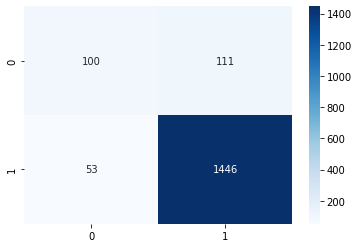

In [ ]:
import seaborn as sns

TPsum = np.sum(TPs)
TNsum = np.sum(TNs)
FPsum = np.sum(FPs)
FNsum = np.sum(FNs)


cm_data = [[TPsum, FNsum], [FPsum, TNsum]]
sns.heatmap(cm_data, annot=True, cmap='Blues', fmt='d')

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
RFWithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([RFWithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC        F1  ...        TP    TN        FP   FN
Average  15.5  0.904094  0.714967  0.525379  ...  3.333333  48.2  1.766667  3.7

[1 rows x 11 columns]


In [ ]:
RFWithSMOTE = RFWithSMOTE.append(df_temp)

In [ ]:
print(RFWithSMOTE)
RFWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/Personalized/RFPersonalizedSMOTE.csv', index = True)

         User  Accuracy   ROC_AUC        F1  ...        TP    TN        FP   FN
0         1.0  0.894737  0.694286  0.500000  ...  3.000000  48.0  2.000000  4.0
1         2.0  0.894737  0.671154  0.400000  ...  2.000000  49.0  3.000000  3.0
2         3.0  0.894737  0.729592  0.571429  ...  4.000000  47.0  2.000000  4.0
3         4.0  0.947368  0.889362  0.842105  ...  8.000000  46.0  1.000000  2.0
4         5.0  0.807018  0.614583  0.352941  ...  3.000000  43.0  5.000000  6.0
5         6.0  0.894737  0.720588  0.500000  ...  3.000000  48.0  3.000000  3.0
6         7.0  1.000000  1.000000  1.000000  ...  7.000000  50.0  0.000000  0.0
7         8.0  0.929825  0.775714  0.666667  ...  4.000000  49.0  1.000000  3.0
8         9.0  0.912281  0.739796  0.615385  ...  4.000000  48.0  1.000000  4.0
9        10.0  0.912281  0.656863  0.444444  ...  2.000000  50.0  1.000000  4.0
10       11.0  0.912281  0.704286  0.545455  ...  3.000000  49.0  1.000000  4.0
11       12.0  0.877193  0.563725  0.222

###Descision Tree

####Model

In [ ]:
from sklearn.tree import DecisionTreeClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_dt = DecisionTreeClassifier()
    tic = time.time()
    model_dt.fit(X_train, y_train) 
    toc = time.time()
    print("Decision Tree Train time = " + str(toc-tic))
    print("Decision Tree Accuracy = "+ str(model_dt.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_dt.predict(X_test)
    yhat_classes = (model_dt.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Decision Tree Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Decision Tree Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

Decision Tree Train time = 0.005232095718383789
Decision Tree Accuracy = 0.8596491228070176
Decision Tree Test time = 0.002933502197265625
(57,)
(57,)
___________________Decision Tree Stats _____________________
Accuracy: 0.859649
True negatives: 45
True positives: 4
False positives: 5
False negatives: 3
ROC AUC: 0.735714
F1 Score: 0.500000
Precision: 0.444444
TPR: 0.571429
FPR: 0.100000
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.0063211917877197266
Decision Tree Accuracy = 0.9122807017543859
Decision Tree Test time = 0.0034914016723632812
(57,)
(57,)
___________________Decision Tree Stats _____________________
Accuracy: 0.912281
True negatives: 49
True positives: 3
False positives: 3
False negatives: 2
ROC AUC: 0.771154
F1 Score: 0.545455
Precision: 0.500000
TPR: 0.600000
FPR: 0.057692
____________________________________________________________
_________________________________

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
DTWithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DTWithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC        F1  ...   TP         TN   FP        FN
Average  15.5  0.878363  0.740853  0.527659  ...  4.0  46.066667  3.9  3.033333

[1 rows x 11 columns]


In [ ]:
DTWithSMOTE = DTWithSMOTE.append(df_temp)

In [ ]:
print(DTWithSMOTE)
DTWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/Personalized/DTPersonalizedSMOTE.csv', index = True)

         User  Accuracy   ROC_AUC        F1  ...    TP         TN    FP        FN
0         1.0  0.859649  0.735714  0.500000  ...   4.0  45.000000   5.0  3.000000
1         2.0  0.912281  0.771154  0.545455  ...   3.0  49.000000   3.0  2.000000
2         3.0  0.929825  0.906888  0.777778  ...   7.0  46.000000   3.0  1.000000
3         4.0  0.894737  0.936170  0.769231  ...  10.0  41.000000   6.0  0.000000
4         5.0  0.789474  0.694444  0.454545  ...   5.0  40.000000   8.0  4.000000
5         6.0  0.807018  0.598039  0.266667  ...   2.0  44.000000   7.0  4.000000
6         7.0  0.929825  0.898571  0.750000  ...   6.0  47.000000   3.0  1.000000
7         8.0  0.877193  0.684286  0.461538  ...   3.0  47.000000   3.0  4.000000
8         9.0  0.877193  0.719388  0.533333  ...   4.0  46.000000   3.0  4.000000
9        10.0  0.894737  0.794118  0.571429  ...   4.0  47.000000   4.0  2.000000
10       11.0  0.929825  0.775714  0.666667  ...   4.0  49.000000   1.0  3.000000
11       12.0  0

###Gradient Boost

####Model

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_gb = GradientBoostingClassifier(n_estimators = 1000) 
    tic = time.time()
    model_gb.fit(X_train, y_train) 
    toc = time.time()
    print("Gradient Boost Train time = " + str(toc-tic))
    print("Gradient Boost Accuracy = "+ str(model_gb.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_gb.predict(X_test)
    yhat_classes = (model_gb.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Gradient Boost Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Gradient Boost Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.7776315212249756
Gradient Boost Accuracy = 0.8771929824561403
Gradient Boost Test time = 0.006298542022705078
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.877193
True negatives: 46
True positives: 4
False positives: 4
False negatives: 3
ROC AUC: 0.745714
F1 Score: 0.533333
Precision: 0.500000
TPR: 0.571429
FPR: 0.080000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.5679545402526855
Gradient Boost Accuracy = 0.9473684210526315
Gradient Boost Test time = 0.006040334701538086
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.947368
True negatives: 50
True positives: 4
False positives: 2
False negatives: 1
ROC AUC: 0.880769
F1 Score: 0.727273
Precision: 0.666667
TPR: 0.800000
FPR: 0.038462
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.7248191833496094
Gradient Boost Accuracy = 0.9298245614035088
Gradient Boost Test time = 0.0068438053131103516
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.929825
True negatives: 46
True positives: 7
False positives: 3
False negatives: 1
ROC AUC: 0.906888
F1 Score: 0.777778
Precision: 0.700000
TPR: 0.875000
FPR: 0.061224
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.44834303855895996
Gradient Boost Accuracy = 0.8947368421052632
Gradient Boost Test time = 0.006216764450073242
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.894737
True negatives: 41
True positives: 10
False positives: 6
False negatives: 0
ROC AUC: 0.936170
F1 Score: 0.769231
Precision: 0.625000
TPR: 1.000000
FPR: 0.127660
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.735795259475708
Gradient Boost Accuracy = 0.8596491228070176
Gradient Boost Test time = 0.006616830825805664
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.859649
True negatives: 43
True positives: 6
False positives: 5
False negatives: 3
ROC AUC: 0.781250
F1 Score: 0.600000
Precision: 0.545455
TPR: 0.666667
FPR: 0.104167
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.6768856048583984
Gradient Boost Accuracy = 0.8245614035087719
Gradient Boost Test time = 0.006982564926147461
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.824561
True negatives: 45
True positives: 2
False positives: 6
False negatives: 4
ROC AUC: 0.607843
F1 Score: 0.285714
Precision: 0.250000
TPR: 0.333333
FPR: 0.117647
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.42554712295532227
Gradient Boost Accuracy = 1.0
Gradient Boost Test time = 0.008682727813720703
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 1.000000
True negatives: 50
True positives: 7
False positives: 0
False negatives: 0
ROC AUC: 1.000000
F1 Score: 1.000000
Precision: 1.000000
TPR: 1.000000
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.48122358322143555
Gradient Boost Accuracy = 0.8421052631578947
Gradient Boost Test time = 0.005620241165161133
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.842105
True negatives: 45
True positives: 3
False positives: 5
False negatives: 4
ROC AUC: 0.664286
F1 Score: 0.400000
Precision: 0.375000
TPR: 0.428571
FPR: 0.100000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.5766761302947998
Gradient Boost Accuracy = 0.8947368421052632
Gradient Boost Test time = 0.008394479751586914
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.894737
True negatives: 46
True positives: 5
False positives: 3
False negatives: 3
ROC AUC: 0.781888
F1 Score: 0.625000
Precision: 0.625000
TPR: 0.625000
FPR: 0.061224
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.7177741527557373
Gradient Boost Accuracy = 0.9122807017543859
Gradient Boost Test time = 0.009661674499511719
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.912281
True negatives: 48
True positives: 4
False positives: 3
False negatives: 2
ROC AUC: 0.803922
F1 Score: 0.615385
Precision: 0.571429
TPR: 0.666667
FPR: 0.058824
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.6113946437835693
Gradient Boost Accuracy = 0.8947368421052632
Gradient Boost Test time = 0.005929708480834961
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.894737
True negatives: 47
True positives: 4
False positives: 3
False negatives: 3
ROC AUC: 0.755714
F1 Score: 0.571429
Precision: 0.571429
TPR: 0.571429
FPR: 0.060000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.5857923030853271
Gradient Boost Accuracy = 0.8421052631578947
Gradient Boost Test time = 0.006155490875244141
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.842105
True negatives: 45
True positives: 3
False positives: 6
False negatives: 3
ROC AUC: 0.691176
F1 Score: 0.400000
Precision: 0.333333
TPR: 0.500000
FPR: 0.117647
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.5968806743621826
Gradient Boost Accuracy = 0.9473684210526315
Gradient Boost Test time = 0.006759166717529297
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.947368
True negatives: 50
True positives: 4
False positives: 0
False negatives: 3
ROC AUC: 0.785714
F1 Score: 0.727273
Precision: 1.000000
TPR: 0.571429
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.7030129432678223
Gradient Boost Accuracy = 0.9473684210526315
Gradient Boost Test time = 0.007741451263427734
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.947368
True negatives: 49
True positives: 5
False positives: 2
False negatives: 1
ROC AUC: 0.897059
F1 Score: 0.769231
Precision: 0.714286
TPR: 0.833333
FPR: 0.039216
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.6369426250457764
Gradient Boost Accuracy = 0.9649122807017544
Gradient Boost Test time = 0.007671833038330078
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.964912
True negatives: 48
True positives: 7
False positives: 2
False negatives: 0
ROC AUC: 0.980000
F1 Score: 0.875000
Precision: 0.777778
TPR: 1.000000
FPR: 0.040000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.6993112564086914
Gradient Boost Accuracy = 0.9473684210526315
Gradient Boost Test time = 0.00815725326538086
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.947368
True negatives: 50
True positives: 4
False positives: 1
False negatives: 2
ROC AUC: 0.823529
F1 Score: 0.727273
Precision: 0.800000
TPR: 0.666667
FPR: 0.019608
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.8591122627258301
Gradient Boost Accuracy = 0.8070175438596491
Gradient Boost Test time = 0.007697343826293945
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.807018
True negatives: 45
True positives: 1
False positives: 5
False negatives: 6
ROC AUC: 0.521429
F1 Score: 0.153846
Precision: 0.166667
TPR: 0.142857
FPR: 0.100000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.7176051139831543
Gradient Boost Accuracy = 0.8771929824561403
Gradient Boost Test time = 0.007114410400390625
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.877193
True negatives: 47
True positives: 3
False positives: 5
False negatives: 2
ROC AUC: 0.751923
F1 Score: 0.461538
Precision: 0.375000
TPR: 0.600000
FPR: 0.096154
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.7906370162963867
Gradient Boost Accuracy = 0.9298245614035088
Gradient Boost Test time = 0.008211135864257812
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.929825
True negatives: 46
True positives: 7
False positives: 2
False negatives: 2
ROC AUC: 0.868056
F1 Score: 0.777778
Precision: 0.777778
TPR: 0.777778
FPR: 0.041667
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.6940257549285889
Gradient Boost Accuracy = 1.0
Gradient Boost Test time = 0.007715702056884766
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 1.000000
True negatives: 49
True positives: 8
False positives: 0
False negatives: 0
ROC AUC: 1.000000
F1 Score: 1.000000
Precision: 1.000000
TPR: 1.000000
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.8118183612823486
Gradient Boost Accuracy = 0.8421052631578947
Gradient Boost Test time = 0.0073893070220947266
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.842105
True negatives: 45
True positives: 3
False positives: 4
False negatives: 5
ROC AUC: 0.646684
F1 Score: 0.400000
Precision: 0.428571
TPR: 0.375000
FPR: 0.081633
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.6289370059967041
Gradient Boost Accuracy = 0.9473684210526315
Gradient Boost Test time = 0.006038188934326172
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.947368
True negatives: 50
True positives: 4
False positives: 0
False negatives: 3
ROC AUC: 0.785714
F1 Score: 0.727273
Precision: 1.000000
TPR: 0.571429
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.6872632503509521
Gradient Boost Accuracy = 0.9122807017543859
Gradient Boost Test time = 0.008919954299926758
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.912281
True negatives: 47
True positives: 5
False positives: 2
False negatives: 3
ROC AUC: 0.792092
F1 Score: 0.666667
Precision: 0.714286
TPR: 0.625000
FPR: 0.040816
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.6863701343536377
Gradient Boost Accuracy = 0.8771929824561403
Gradient Boost Test time = 0.0062978267669677734
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.877193
True negatives: 47
True positives: 3
False positives: 3
False negatives: 4
ROC AUC: 0.684286
F1 Score: 0.461538
Precision: 0.500000
TPR: 0.428571
FPR: 0.060000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0085735321044922
Gradient Boost Accuracy = 0.8070175438596491
Gradient Boost Test time = 0.007996559143066406
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.807018
True negatives: 45
True positives: 1
False positives: 4
False negatives: 7
ROC AUC: 0.521684
F1 Score: 0.153846
Precision: 0.200000
TPR: 0.125000
FPR: 0.081633
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.46452927589416504
Gradient Boost Accuracy = 0.9824561403508771
Gradient Boost Test time = 0.0060122013092041016
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.982456
True negatives: 50
True positives: 6
False positives: 1
False negatives: 0
ROC AUC: 0.990196
F1 Score: 0.923077
Precision: 0.857143
TPR: 1.000000
FPR: 0.019608
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.7099118232727051
Gradient Boost Accuracy = 0.9473684210526315
Gradient Boost Test time = 0.0071446895599365234
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.947368
True negatives: 49
True positives: 5
False positives: 1
False negatives: 2
ROC AUC: 0.847143
F1 Score: 0.769231
Precision: 0.833333
TPR: 0.714286
FPR: 0.020000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.8507516384124756
Gradient Boost Accuracy = 0.8245614035087719
Gradient Boost Test time = 0.0076525211334228516
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.824561
True negatives: 44
True positives: 3
False positives: 7
False negatives: 3
ROC AUC: 0.681373
F1 Score: 0.375000
Precision: 0.300000
TPR: 0.500000
FPR: 0.137255
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.589911937713623
Gradient Boost Accuracy = 0.9649122807017544
Gradient Boost Test time = 0.011717796325683594
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.964912
True negatives: 51
True positives: 4
False positives: 0
False negatives: 2
ROC AUC: 0.833333
F1 Score: 0.800000
Precision: 1.000000
TPR: 0.666667
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.7383928298950195
Gradient Boost Accuracy = 0.9298245614035088
Gradient Boost Test time = 0.007584810256958008
(57,)
(57,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.929825
True negatives: 48
True positives: 5
False positives: 2
False negatives: 2
ROC AUC: 0.837143
F1 Score: 0.714286
Precision: 0.714286
TPR: 0.714286
FPR: 0.040000
____________________________________________________________
____________________________________________________________


#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
GBWithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([GBWithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC        F1  ...        TP         TN   FP        FN
Average  15.5  0.905848  0.793433  0.626267  ...  4.566667  47.066667  2.9  2.466667

[1 rows x 11 columns]


In [ ]:
GBWithSMOTE = GBWithSMOTE.append(df_temp)

In [ ]:
print(GBWithSMOTE)
GBWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/Personalized/GBPersonalizedSMOTE.csv', index = True)

         User  Accuracy   ROC_AUC  ...         TN   FP        FN
0         1.0  0.877193  0.745714  ...  46.000000  4.0  3.000000
1         2.0  0.947368  0.880769  ...  50.000000  2.0  1.000000
2         3.0  0.929825  0.906888  ...  46.000000  3.0  1.000000
3         4.0  0.894737  0.936170  ...  41.000000  6.0  0.000000
4         5.0  0.859649  0.781250  ...  43.000000  5.0  3.000000
5         6.0  0.824561  0.607843  ...  45.000000  6.0  4.000000
6         7.0  1.000000  1.000000  ...  50.000000  0.0  0.000000
7         8.0  0.842105  0.664286  ...  45.000000  5.0  4.000000
8         9.0  0.894737  0.781888  ...  46.000000  3.0  3.000000
9        10.0  0.912281  0.803922  ...  48.000000  3.0  2.000000
10       11.0  0.894737  0.755714  ...  47.000000  3.0  3.000000
11       12.0  0.842105  0.691176  ...  45.000000  6.0  3.000000
12       13.0  0.947368  0.785714  ...  50.000000  0.0  3.000000
13       14.0  0.947368  0.897059  ...  49.000000  2.0  1.000000
14       15.0  0.964912  

###3 DNN

#### Model

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model3 = Sequential()

    model3.add(Dense(64, activation='relu', input_shape=(14,)))
    model3.add(Dropout(0.3))
    model3.add(Dense(32, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(8, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(1, activation='sigmoid'))

    model3.compile(loss='binary_crossentropy',
                  optimizer='adam',
                  metrics=['accuracy'])
    reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=0.001)
    tic = time.time()
    model3.fit(X_train, y_train, batch_size=64, epochs=100, validation_split=0.1, callbacks=[reduce_lr])
    toc = time.time()
    print("3 DNN Train time = " + str(toc-tic))
    print("3 DNN Accuracy = "+ str(model3.evaluate(X_test, y_test, verbose=0)[1]))
    tic = time.time()
    yhat_probs = model3.predict(X_test, verbose=0)
    yhat_classes = (model3.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("3 DNN Test time = " + str(toc-tic))
    yhat_probs = yhat_probs[:, 0]
    yhat_classes = yhat_classes[:, 0]
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________3 DNN Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

Streaming output truncated to the last 5000 lines.
Epoch 8/100
4/4 [==============================] - 0s 16ms/step - loss: 0.7155 - accuracy: 0.5481 - val_loss: 0.7920 - val_accuracy: 0.2083 - lr: 0.0010
Epoch 9/100
4/4 [==============================] - 0s 17ms/step - loss: 0.6658 - accuracy: 0.5962 - val_loss: 0.7749 - val_accuracy: 0.2500 - lr: 0.0010
Epoch 10/100
4/4 [==============================] - 0s 14ms/step - loss: 0.6645 - accuracy: 0.5769 - val_loss: 0.7626 - val_accuracy: 0.2917 - lr: 0.0010
Epoch 11/100
4/4 [==============================] - 0s 16ms/step - loss: 0.6984 - accuracy: 0.5769 - val_loss: 0.7450 - val_accuracy: 0.3333 - lr: 0.0010
Epoch 12/100
4/4 [==============================] - 0s 16ms/step - loss: 0.6498 - accuracy: 0.6154 - val_loss: 0.7308 - val_accuracy: 0.4583 - lr: 0.0010
Epoch 13/100
4/4 [==============================] - 0s 15ms/step - loss: 0.6267 - accuracy: 0.6442 - val_loss: 0.7121 - val_accuracy: 0.5000 - lr: 0.0010
Epoch 14/100
4/4 [=========

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
DNN3WithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DNN3WithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC        F1  ...        TP    TN        FP   FN
Average  15.5  0.900585  0.887178  0.623906  ...  4.633333  46.7  3.266667  2.4

[1 rows x 11 columns]


In [ ]:
DNN3WithSMOTE = DNN3WithSMOTE.append(df_temp)

In [ ]:
print(DNN3WithSMOTE)
DNN3WithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/Personalized/DNNPersonalizedSMOTE.csv', index = True)

         User  Accuracy   ROC_AUC        F1  ...        TP    TN        FP   FN
0         1.0  0.859649  0.920000  0.428571  ...  3.000000  46.0  4.000000  4.0
1         2.0  0.947368  0.965385  0.769231  ...  5.000000  49.0  3.000000  0.0
2         3.0  0.982456  0.982143  0.941176  ...  8.000000  48.0  1.000000  0.0
3         4.0  0.859649  0.902128  0.600000  ...  6.000000  43.0  4.000000  4.0
4         5.0  0.894737  0.898148  0.700000  ...  7.000000  44.0  4.000000  2.0
5         6.0  0.877193  0.944444  0.533333  ...  4.000000  46.0  5.000000  2.0
6         7.0  0.964912  0.991429  0.857143  ...  6.000000  49.0  1.000000  1.0
7         8.0  0.842105  0.974286  0.608696  ...  7.000000  41.0  9.000000  0.0
8         9.0  0.929825  0.928571  0.666667  ...  4.000000  49.0  0.000000  4.0
9        10.0  0.912281  0.957516  0.615385  ...  4.000000  48.0  3.000000  2.0
10       11.0  0.929825  0.951429  0.714286  ...  5.000000  48.0  2.000000  2.0
11       12.0  0.894737  0.767974  0.500

# Video wise models without SMOTE

## Data Processing

### Import dataset

In [ ]:
directory_all = "/content/drive/MyDrive/Surjya Sir Work/5000"
directory_pbd = "/content/drive/MyDrive/Surjya Sir Work/5000_probed"

In [ ]:
videos = [1,2,3,4,5,6,7,8]
#videos = [1,2,3,4,5,7,8]

In [ ]:
all = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_all + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    all.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 5
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 6
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


In [ ]:
probed = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_pbd + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    probed.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 5
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 6
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


### Create df

In [ ]:
df = pd.DataFrame()
for i in range(len(all)):#per video = 8
  for j in range(len(all[i])): #per subject = 30
    df = df.append(all[i][j], ignore_index=True)

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8


In [ ]:
tester = pd.DataFrame()
for i in range(len(probed)):#per video = 8
  for j in range(len(probed[i])): #per subject = 30
    tester = tester.append(probed[i][j], ignore_index=True)

In [ ]:
tester

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1738876.01,1743876.01,1748876.01,6.309,5.096,0.013,0.106,5.632759,0.600,0.378,0.155,0.010,0.369,1.642,8.131,10,1
1,832168.01,837168.01,842168.01,6.488,5.290,0.012,0.159,1.883567,0.300,3.623,0.126,0.021,0.657,0.246,0.000,11,1
2,907168.01,912168.01,917168.01,5.330,4.958,0.394,0.082,3.340205,0.103,3.119,0.136,0.004,7.022,0.699,0.123,11,1
3,917168.01,922168.01,927168.01,6.046,5.011,0.767,0.003,2.078420,0.213,0.785,0.136,0.007,4.846,0.041,0.040,11,1
4,922168.01,927168.01,932168.01,6.476,5.014,0.430,0.022,2.208317,0.307,4.601,0.068,0.010,4.148,1.191,0.288,11,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
843,2282834.01,2287834.01,2292834.01,2.090,7.542,0.918,0.586,3.800016,3.170,4.349,0.261,0.003,0.082,2.916,1.602,8,8
844,2287834.01,2292834.01,2297834.01,1.199,8.115,1.181,0.661,5.052202,4.889,8.049,1.549,0.039,0.164,1.315,2.587,8,8
845,1166459.01,1171459.01,1176459.01,3.156,6.595,0.518,0.543,4.114055,0.256,0.368,4.792,0.011,2.998,3.368,13.429,9,8
846,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8


In [ ]:
temp = df[df.isin(tester)].dropna()

In [ ]:
temp = df.loc[df.set_index(list(df.columns)).index.isin(tester.set_index(list(tester.columns)).index)]

In [ ]:
temp.index

Int64Index([  35,   47,   62,   64,   65,   70,   99,  107,  117,  118,
            ...
            7191, 7212, 7231, 7234, 7239, 7255, 7256, 7284, 7285, 7286],
           dtype='int64', length=848)

In [ ]:
df['Probe'] = 0

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,0
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,0
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
for idx in temp.index:
  df.at[idx, 'Probe'] = 1

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


### Optimise df

In [ ]:
df = df.drop(columns=["Start", "Border", "End"], axis=1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
df['valence_acc_video'] = 0
df['arousal_acc_video'] = 0

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,0,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,0,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,0,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,0,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,0
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,0
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,0
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,0


I'm using the following encoding: 

1 - Low
2 - Mid/high
3 - High

In [ ]:
# def basedOnVideoValence(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 2
#     if int(video) == 6:
#         return 2
#     if int(video) == 7:
#         return 1
#     if int(video) == 8:
#         return 1
    
# def basedOnVideoArousal(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 1
#     if int(video) == 6:
#         return 1
#     if int(video) == 7:
#         return 3
#     if int(video) == 8:
#         return 3

New encoding, 
Low - 0 
Med / High - 1

In [ ]:
def basedOnVideoValence(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 1
    if int(video) == 6:
        return 1
    if int(video) == 7:
        return 0
    if int(video) == 8:
        return 0
    
def basedOnVideoArousal(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 0
    if int(video) == 6:
        return 0
    if int(video) == 7:
        return 1
    if int(video) == 8:
        return 1

In [ ]:
df['valence_acc_video'] = df.apply(lambda row : basedOnVideoValence(row['video']), axis = 1)
df['arousal_acc_video'] = df.apply(lambda row : basedOnVideoArousal(row['video']), axis = 1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1


### X,y for personalized models

In [ ]:
X_train_all = []
y_train_all = []
X_test_all = []
y_test_all = []

In [ ]:
users = []
for i in range(1, 31):
  users.append(i)

print(users)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30]


In [ ]:
for video in videos:
  print("Video", video)
  X_train = pd.DataFrame()
  y_train = pd.DataFrame()
  X_test = pd.DataFrame()
  y_test = pd.DataFrame()
  df_new = df[df['video'] == (video)]
  print(df_new)
  df_probe = df_new[df_new['Probe'] == 1]
  df_nonprobe = df_new[df_new['Probe'] == 0]

  y_probe = df_probe['Probe']
  y_nonprobe = df_nonprobe['Probe']

  y_probe = pd.DataFrame(y_probe)
  y_nonprobe = pd.DataFrame(y_nonprobe)

  X_probe = df_probe.drop(columns=["Probe"], axis = 1)
  X_nonprobe = df_nonprobe.drop(columns=["Probe"], axis = 1)

  X_train_probe, X_test_probe, y_train_probe, y_test_probe = train_test_split(X_probe, y_probe, test_size = 0.3)
  X_train_nonprobe, X_test_nonprobe, y_train_nonprobe, y_test_nonprobe = train_test_split(X_nonprobe, y_nonprobe, test_size = 0.3)

  X_train = X_train.append(X_train_probe)
  X_train = X_train.append(X_train_nonprobe)
  X_test = X_test.append(X_test_probe)
  X_test = X_test.append(X_test_nonprobe)
  y_train = y_train.append(y_train_probe)
  y_train = y_train.append(y_train_nonprobe)
  y_test = y_test.append(y_test_probe)
  y_test = y_test.append(y_test_nonprobe)


  X_train_all.append(X_train)
  y_train_all.append(y_train)
  X_test_all.append(X_test)
  y_test_all.append(y_test)

Video 1
      Valence  Arousal  ...  valence_acc_video  arousal_acc_video
0       5.000    5.000  ...                  1                  1
1       5.000    5.209  ...                  1                  1
2       4.824    6.102  ...                  1                  1
3       4.870    6.170  ...                  1                  1
4       4.870    6.170  ...                  1                  1
...       ...      ...  ...                ...                ...
1075    7.424    4.503  ...                  1                  1
1076    7.542    4.355  ...                  1                  1
1077    7.152    4.137  ...                  1                  1
1078    7.430    3.750  ...                  1                  1
1079    7.454    3.750  ...                  1                  1

[1080 rows x 17 columns]
Video 2
      Valence  Arousal  ...  valence_acc_video  arousal_acc_video
1080    5.000    5.000  ...                  1                  1
1081    5.000    5.011  ...       

In [ ]:
print(len(X_train_all[3]['subject'].unique()))
print(len(X_train_all[3]['video'].unique()))

30
1


In [ ]:
X_train_all[2]

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,valence_acc_video,arousal_acc_video
2163,5.036,4.081,0.000,0.011,0.512398,0.366,0.087,0.465,0.004,0.041,0.493,1.191,14,3,0,0
2708,5.000,5.000,0.000,0.036,5.509215,2.425,0.543,0.475,0.007,0.247,0.246,3.490,9,3,0,0
2482,5.128,1.888,0.256,0.000,0.334963,0.493,0.329,1.432,0.014,0.000,0.411,2.136,27,3,0,0
2071,5.000,5.000,0.000,0.000,2.127014,0.264,1.666,0.194,0.011,0.082,0.904,3.902,10,3,0,0
2375,5.000,5.050,0.000,0.000,1.718703,0.087,3.235,0.184,0.011,0.246,0.411,0.000,22,3,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2203,5.000,5.000,0.000,0.000,0.033151,0.280,0.465,1.142,0.059,0.123,0.000,0.656,16,3,0,0
2130,5.036,2.634,0.000,0.065,0.213538,0.469,1.327,0.252,0.007,0.575,1.643,0.123,12,3,0,0
2330,5.212,4.453,0.238,0.294,0.859059,0.323,2.354,0.068,0.014,0.123,0.205,4.970,20,3,0,0
2118,5.092,4.285,0.078,1.221,0.071158,0.300,1.056,0.058,0.028,0.041,1.191,0.123,12,3,0,0


In [ ]:
new_X_train_all = []

for i in range(len(X_train_all)):
    df_temp = X_train_all[i]
    df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    new_X_train_all.append(df_temp)

X_train_all = new_X_train_all

new_X_test_all = []

for i in range(len(X_test_all)):
    df_temp = X_test_all[i]
    df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    new_X_test_all.append(df_temp)

X_test_all = new_X_test_all

In [ ]:
X_train_all[2]

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,valence_acc_video,arousal_acc_video
2163,5.036,4.081,0.000,0.011,0.512398,0.366,0.087,0.465,0.004,0.041,0.493,1.191,0,0
2708,5.000,5.000,0.000,0.036,5.509215,2.425,0.543,0.475,0.007,0.247,0.246,3.490,0,0
2482,5.128,1.888,0.256,0.000,0.334963,0.493,0.329,1.432,0.014,0.000,0.411,2.136,0,0
2071,5.000,5.000,0.000,0.000,2.127014,0.264,1.666,0.194,0.011,0.082,0.904,3.902,0,0
2375,5.000,5.050,0.000,0.000,1.718703,0.087,3.235,0.184,0.011,0.246,0.411,0.000,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2203,5.000,5.000,0.000,0.000,0.033151,0.280,0.465,1.142,0.059,0.123,0.000,0.656,0,0
2130,5.036,2.634,0.000,0.065,0.213538,0.469,1.327,0.252,0.007,0.575,1.643,0.123,0,0
2330,5.212,4.453,0.238,0.294,0.859059,0.323,2.354,0.068,0.014,0.123,0.205,4.970,0,0
2118,5.092,4.285,0.078,1.221,0.071158,0.300,1.056,0.058,0.028,0.041,1.191,0.123,0,0


In [ ]:
y_test_all[7]

,Probe
7231,1
7123,1
6831,1
6610,1
6775,1
...,...
6791,0
6771,0
6608,0
6785,0


## Models

###RandomForest

#### Model

In [ ]:
from sklearn.ensemble import RandomForestClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []

TPs = []
FPs = []
FNs = []
TNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_rf = RandomForestClassifier() 
    tic = time.time()
    print("X_train_size = ", str(len(X_train)))
    print("X_test_size = ", str(len(X_test)))
    model_rf.fit(X_train, y_train) 
    toc = time.time()
    print("Random Forest Train time = " + str(toc-tic))
    print("Random Forest Accuracy = "+ str(model_rf.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_rf.predict(X_test)
    print("yhat_probs",yhat_probs)
    yhat_classes = (model_rf.predict(X_test) > 0.5).astype("int32")
    print("yhat_classes",yhat_classes)
    toc = time.time()
    print("Random Forest Test time = " + str(toc-tic))

    print("___________________Random Forest Stats _____________________")

    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

X_train_size =  755
X_test_size =  325


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.37062835693359375
Random Forest Accuracy = 0.9076923076923077
yhat_probs [0 1 0 0 0 0 0 0 1 0 0 0 1 1 0 0 1 0 0 0 0 0 1 0 0 0 1 0 1 1 0 0 0 0 0 1 0
 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 0 0 0 0 0 0 1 0 0 0 1 1 0 0 1 0 0 0 0 0 1 0 0 0 1 0 1 1 0 0 0 0 0 1 0
 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3705174922943115
Random Forest Accuracy = 0.9261744966442953
yhat_probs [1 1 0 0 1 1 1 0 1 0 0 1 0 1 0 0 1 1 0 1 1 0 1 1 0 0 0 1 1 1 1 0 0 1 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0]
yhat_classes [1 1 0 0 1 1 1 0 1 0 0 1 0 1 0 0 1 1 0 1 1 0 1 1 0 0 0 1 1 1 1 0 0 1 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2987496852874756
Random Forest Accuracy = 0.9141414141414141
yhat_probs [1 0 0 1 1 1 0 0 0 1 1 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 1 1 1 0 0 0 1 1 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.05163145065307617
___________________Random Forest S

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.348433256149292
Random Forest Accuracy = 0.9
yhat_probs [1 0 0 0 1 0 0 0 1 1 1 0 0 0 1 0 0 0 0 0 1 0 1 1 0 1 0 0 0 0 0 0 0 0 1 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 0 1 0 0 0 1 1 1 0 0 0 1 0 0 0 0 0 1 0 1 1 0 1 0 0 0 0 0 0 0 0 1 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.33580517768859863
Random Forest Accuracy = 0.9090909090909091
yhat_probs [0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 0 0 1 0 0 1 0 1 0 1 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 0 0 1 0 0 1 0 1 0 1 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3504221439361572
Random Forest Accuracy = 0.9011857707509882
yhat_probs [0 1 1 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 1 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.42614030838012695
Random Forest Accuracy = 0.9590643274853801
yhat_probs [0 1 0 1 0 1 1 1 1 1 0 1 1 1 1 1 0 1 0 1 1 0 1 1 1 0 1 0 1 1 1 1 1 0 1 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 0 1 0 1 1 1 1 1 0 1 1 1 1 1 0 1 0 1 1 0 1 1 1 0 1 0 1 1 1 1 1 0 1 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.32240891456604004
Random Forest Accuracy = 0.8975409836065574
yhat_probs [1 1 0 1 0 0 1 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0]
yhat_classes [1 1 0 1 0 0 1 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0

#### Results

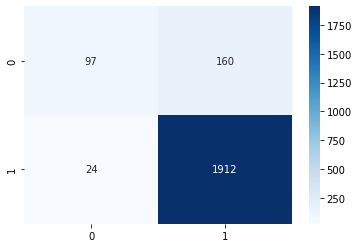

In [ ]:
import seaborn as sns

TPsum = np.sum(TPs)
TNsum = np.sum(TNs)
FPsum = np.sum(FPs)
FNsum = np.sum(FNs)

cm_data = [[TPsum, FNsum], [FPsum, TNsum]]
sns.heatmap(cm_data, annot=True, cmap='Blues', fmt='d')

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([videos[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
RFWithSMOTE = pd.DataFrame(data, columns=['Video', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([RFWithSMOTE.mean(axis=0).values],  columns=['Video', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         Video  Accuracy   ROC_AUC        F1  ...      TP     TN   FP    FN
Average    4.5  0.914361  0.678877  0.488865  ...  12.125  239.0  3.0  20.0

[1 rows x 11 columns]


In [ ]:
RFWithSMOTE = RFWithSMOTE.append(df_temp)

In [ ]:
print(RFWithSMOTE)
RFWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/User/RFUser.csv', index = True)

         Video  Accuracy   ROC_AUC        F1  ...      TP     TN   FP    FN
0          1.0  0.907692  0.639510  0.423077  ...  11.000  284.0  3.0  27.0
1          2.0  0.926174  0.766154  0.633333  ...  19.000  257.0  7.0  15.0
2          3.0  0.914141  0.663793  0.484848  ...   8.000  173.0  1.0  16.0
3          4.0  0.900000  0.641026  0.440000  ...  11.000  241.0  0.0  28.0
4          5.0  0.909091  0.663485  0.465116  ...  10.000  220.0  4.0  19.0
5          6.0  0.901186  0.598984  0.324324  ...   6.000  222.0  2.0  23.0
6          7.0  0.959064  0.842320  0.781250  ...  25.000  303.0  3.0  11.0
7          8.0  0.897541  0.615741  0.358974  ...   7.000  212.0  4.0  21.0
Average    4.5  0.914361  0.678877  0.488865  ...  12.125  239.0  3.0  20.0

[9 rows x 11 columns]


###Descision Tree

####Model

In [ ]:
from sklearn.tree import DecisionTreeClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_dt = DecisionTreeClassifier()
    tic = time.time()
    model_dt.fit(X_train, y_train) 
    toc = time.time()
    print("Decision Tree Train time = " + str(toc-tic))
    print("Decision Tree Accuracy = "+ str(model_dt.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_dt.predict(X_test)
    yhat_classes = (model_dt.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Decision Tree Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Decision Tree Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

Decision Tree Train time = 0.010319709777832031
Decision Tree Accuracy = 0.8953846153846153
Decision Tree Test time = 0.004266262054443359
(325,)
(325,)
___________________Decision Tree Stats _____________________
Accuracy: 0.895385
True negatives: 270
True positives: 21
False positives: 17
False negatives: 17
ROC AUC: 0.746699
F1 Score: 0.552632
Precision: 0.552632
TPR: 0.552632
FPR: 0.059233
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.010522842407226562
Decision Tree Accuracy = 0.9228187919463087
Decision Tree Test time = 0.0050165653228759766
(298,)
(298,)
___________________Decision Tree Stats _____________________
Accuracy: 0.922819
True negatives: 255
True positives: 20
False positives: 9
False negatives: 14
ROC AUC: 0.777072
F1 Score: 0.634921
Precision: 0.689655
TPR: 0.588235
FPR: 0.034091
____________________________________________________________
_______________________

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([videos[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
DTWithSMOTE = pd.DataFrame(data, columns=['Video', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DTWithSMOTE.mean(axis=0).values],  columns=['Video', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         Video  Accuracy   ROC_AUC        F1  ...      TP     TN    FP     FN
Average    4.5  0.889833  0.720391  0.514571  ...  16.375  228.5  13.5  15.75

[1 rows x 11 columns]


In [ ]:
DTWithSMOTE = DTWithSMOTE.append(df_temp)

In [ ]:
print(DTWithSMOTE)
DTWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/User/DTUser.csv', index = True)

         Video  Accuracy   ROC_AUC        F1  ...      TP     TN    FP     FN
0          1.0  0.895385  0.746699  0.552632  ...  21.000  270.0  17.0  17.00
1          2.0  0.922819  0.777072  0.634921  ...  20.000  255.0   9.0  14.00
2          3.0  0.873737  0.676724  0.444444  ...  10.000  163.0  11.0  14.00
3          4.0  0.885714  0.707948  0.529412  ...  18.000  230.0  11.0  21.00
4          5.0  0.833992  0.636084  0.343750  ...  11.000  200.0  24.0  18.00
5          6.0  0.881423  0.737916  0.516129  ...  16.000  207.0  17.0  13.00
6          7.0  0.944444  0.858660  0.739726  ...  27.000  296.0  10.0   9.00
7          8.0  0.881148  0.622024  0.355556  ...   8.000  207.0   9.0  20.00
Average    4.5  0.889833  0.720391  0.514571  ...  16.375  228.5  13.5  15.75

[9 rows x 11 columns]


###Gradient Boost

####Model

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_gb = GradientBoostingClassifier(n_estimators = 1000) 
    tic = time.time()
    model_gb.fit(X_train, y_train) 
    toc = time.time()
    print("Gradient Boost Train time = " + str(toc-tic))
    print("Gradient Boost Accuracy = "+ str(model_gb.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_gb.predict(X_test)
    yhat_classes = (model_gb.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Gradient Boost Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Gradient Boost Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 4.035226821899414
Gradient Boost Accuracy = 0.9292307692307692
Gradient Boost Test time = 0.021516799926757812
(325,)
(325,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.929231
True negatives: 282
True positives: 20
False positives: 5
False negatives: 18
ROC AUC: 0.754447
F1 Score: 0.634921
Precision: 0.800000
TPR: 0.526316
FPR: 0.017422
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 3.6881022453308105
Gradient Boost Accuracy = 0.9362416107382551
Gradient Boost Test time = 0.02591085433959961
(298,)
(298,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.936242
True negatives: 257
True positives: 22
False positives: 7
False negatives: 12
ROC AUC: 0.810272
F1 Score: 0.698413
Precision: 0.758621
TPR: 0.647059
FPR: 0.026515
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 2.6600911617279053
Gradient Boost Accuracy = 0.9191919191919192
Gradient Boost Test time = 0.018019676208496094
(198,)
(198,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.919192
True negatives: 168
True positives: 14
False positives: 6
False negatives: 10
ROC AUC: 0.774425
F1 Score: 0.636364
Precision: 0.700000
TPR: 0.583333
FPR: 0.034483
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 3.3513405323028564
Gradient Boost Accuracy = 0.8964285714285715
Gradient Boost Test time = 0.020275115966796875
(280,)
(280,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.896429
True negatives: 236
True positives: 15
False positives: 5
False negatives: 24
ROC AUC: 0.681934
F1 Score: 0.508475
Precision: 0.750000
TPR: 0.384615
FPR: 0.020747
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 3.2501060962677
Gradient Boost Accuracy = 0.9169960474308301
Gradient Boost Test time = 0.01846933364868164
(253,)
(253,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.916996
True negatives: 218
True positives: 14
False positives: 6
False negatives: 15
ROC AUC: 0.727986
F1 Score: 0.571429
Precision: 0.700000
TPR: 0.482759
FPR: 0.026786
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 3.250251054763794
Gradient Boost Accuracy = 0.9169960474308301
Gradient Boost Test time = 0.017993450164794922
(253,)
(253,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.916996
True negatives: 216
True positives: 16
False positives: 8
False negatives: 13
ROC AUC: 0.758005
F1 Score: 0.603774
Precision: 0.666667
TPR: 0.551724
FPR: 0.035714
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 4.220181465148926
Gradient Boost Accuracy = 0.9590643274853801
Gradient Boost Test time = 0.018733978271484375
(342,)
(342,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.959064
True negatives: 303
True positives: 25
False positives: 3
False negatives: 11
ROC AUC: 0.842320
F1 Score: 0.781250
Precision: 0.892857
TPR: 0.694444
FPR: 0.009804
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 3.2007064819335938
Gradient Boost Accuracy = 0.8975409836065574
Gradient Boost Test time = 0.017393112182617188
(244,)
(244,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.897541
True negatives: 209
True positives: 10
False positives: 7
False negatives: 18
ROC AUC: 0.662368
F1 Score: 0.444444
Precision: 0.588235
TPR: 0.357143
FPR: 0.032407
____________________________________________________________
____________________________________________________________


#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([videos[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
GBWithSMOTE = pd.DataFrame(data, columns=['Video', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([GBWithSMOTE.mean(axis=0).values],  columns=['Video', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         Video  Accuracy  ROC_AUC        F1  ...    TP       TN     FP      FN
Average    4.5  0.921461  0.75147  0.609884  ...  17.0  236.125  5.875  15.125

[1 rows x 11 columns]


In [ ]:
GBWithSMOTE = GBWithSMOTE.append(df_temp)

In [ ]:
print(GBWithSMOTE)
GBWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/User/GBUser.csv', index = True)

         Video  Accuracy   ROC_AUC        F1  ...    TP       TN     FP      FN
0          1.0  0.929231  0.754447  0.634921  ...  20.0  282.000  5.000  18.000
1          2.0  0.936242  0.810272  0.698413  ...  22.0  257.000  7.000  12.000
2          3.0  0.919192  0.774425  0.636364  ...  14.0  168.000  6.000  10.000
3          4.0  0.896429  0.681934  0.508475  ...  15.0  236.000  5.000  24.000
4          5.0  0.916996  0.727986  0.571429  ...  14.0  218.000  6.000  15.000
5          6.0  0.916996  0.758005  0.603774  ...  16.0  216.000  8.000  13.000
6          7.0  0.959064  0.842320  0.781250  ...  25.0  303.000  3.000  11.000
7          8.0  0.897541  0.662368  0.444444  ...  10.0  209.000  7.000  18.000
Average    4.5  0.921461  0.751470  0.609884  ...  17.0  236.125  5.875  15.125

[9 rows x 11 columns]


###3 DNN

#### Model

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model3 = Sequential()

    model3.add(Dense(64, activation='relu', input_shape=(14,)))
    model3.add(Dropout(0.3))
    model3.add(Dense(32, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(8, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(1, activation='sigmoid'))

    model3.compile(loss='binary_crossentropy',
                  optimizer='adam',
                  metrics=['accuracy'])
    reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=0.001)
    tic = time.time()
    model3.fit(X_train, y_train, batch_size=64, epochs=100, validation_split=0.1, callbacks=[reduce_lr])
    toc = time.time()
    print("3 DNN Train time = " + str(toc-tic))
    print("3 DNN Accuracy = "+ str(model3.evaluate(X_test, y_test, verbose=0)[1]))
    tic = time.time()
    yhat_probs = model3.predict(X_test, verbose=0)
    yhat_classes = (model3.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("3 DNN Test time = " + str(toc-tic))
    yhat_probs = yhat_probs[:, 0]
    yhat_classes = yhat_classes[:, 0]
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________3 DNN Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

Epoch 1/100
11/11 [==============================] - 1s 32ms/step - loss: 1.8852 - accuracy: 0.1959 - val_loss: 0.7249 - val_accuracy: 0.1579 - lr: 0.0010
Epoch 2/100
11/11 [==============================] - 0s 6ms/step - loss: 0.9657 - accuracy: 0.3667 - val_loss: 0.6289 - val_accuracy: 0.8158 - lr: 0.0010
Epoch 3/100
11/11 [==============================] - 0s 6ms/step - loss: 0.7812 - accuracy: 0.5552 - val_loss: 0.5706 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
11/11 [==============================] - 0s 6ms/step - loss: 0.7591 - accuracy: 0.6465 - val_loss: 0.5106 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
11/11 [==============================] - 0s 8ms/step - loss: 0.6200 - accuracy: 0.7378 - val_loss: 0.4567 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
11/11 [==============================] - 0s 6ms/step - loss: 0.5894 - accuracy: 0.7806 - val_loss: 0.3998 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
11/11 [==============================] - 0s 6ms/step - loss: 0.

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([videos[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
DNN3WithSMOTE = pd.DataFrame(data, columns=['Video', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DNN3WithSMOTE.mean(axis=0).values],  columns=['Video', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         Video  Accuracy   ROC_AUC        F1  ...      TP      TN    FP    FN
Average    4.5  0.908164  0.899817  0.520398  ...  14.125  235.25  6.75  18.0

[1 rows x 11 columns]


In [ ]:
DNN3WithSMOTE = DNN3WithSMOTE.append(df_temp)

In [ ]:
print(DNN3WithSMOTE)
DNN3WithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/User/DNNUser.csv', index = True)

         Video  Accuracy   ROC_AUC        F1  ...      TP      TN     FP    FN
0          1.0  0.910769  0.928296  0.524590  ...  16.000  280.00   7.00  22.0
1          2.0  0.932886  0.952317  0.666667  ...  20.000  258.00   6.00  14.0
2          3.0  0.924242  0.880747  0.571429  ...  10.000  173.00   1.00  14.0
3          4.0  0.867857  0.832429  0.350877  ...  10.000  233.00   8.00  29.0
4          5.0  0.869565  0.885160  0.421053  ...  12.000  208.00  16.00  17.0
5          6.0  0.905138  0.921182  0.428571  ...   9.000  220.00   4.00  20.0
6          7.0  0.953216  0.969862  0.771429  ...  27.000  299.00   7.00   9.0
7          8.0  0.901639  0.828538  0.428571  ...   9.000  211.00   5.00  19.0
Average    4.5  0.908164  0.899817  0.520398  ...  14.125  235.25   6.75  18.0

[9 rows x 11 columns]


# Video wise models with SMOTE

## Data Processing

### Import dataset

In [ ]:
directory_all = "/content/drive/MyDrive/Surjya Sir Work/5000"
directory_pbd = "/content/drive/MyDrive/Surjya Sir Work/5000_probed"

In [ ]:
videos = [1,2,3,4,5,6,7,8]
#videos = [1,2,3,4,5,7,8]

In [ ]:
all = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_all + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    all.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 5
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 6
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


In [ ]:
probed = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_pbd + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    probed.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 5
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 6
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


### Create df

In [ ]:
df = pd.DataFrame()
for i in range(len(all)):#per video = 8
  for j in range(len(all[i])): #per subject = 30
    df = df.append(all[i][j], ignore_index=True)

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8


In [ ]:
tester = pd.DataFrame()
for i in range(len(probed)):#per video = 8
  for j in range(len(probed[i])): #per subject = 30
    tester = tester.append(probed[i][j], ignore_index=True)

In [ ]:
tester

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1738876.01,1743876.01,1748876.01,6.309,5.096,0.013,0.106,5.632759,0.600,0.378,0.155,0.010,0.369,1.642,8.131,10,1
1,832168.01,837168.01,842168.01,6.488,5.290,0.012,0.159,1.883567,0.300,3.623,0.126,0.021,0.657,0.246,0.000,11,1
2,907168.01,912168.01,917168.01,5.330,4.958,0.394,0.082,3.340205,0.103,3.119,0.136,0.004,7.022,0.699,0.123,11,1
3,917168.01,922168.01,927168.01,6.046,5.011,0.767,0.003,2.078420,0.213,0.785,0.136,0.007,4.846,0.041,0.040,11,1
4,922168.01,927168.01,932168.01,6.476,5.014,0.430,0.022,2.208317,0.307,4.601,0.068,0.010,4.148,1.191,0.288,11,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
843,2282834.01,2287834.01,2292834.01,2.090,7.542,0.918,0.586,3.800016,3.170,4.349,0.261,0.003,0.082,2.916,1.602,8,8
844,2287834.01,2292834.01,2297834.01,1.199,8.115,1.181,0.661,5.052202,4.889,8.049,1.549,0.039,0.164,1.315,2.587,8,8
845,1166459.01,1171459.01,1176459.01,3.156,6.595,0.518,0.543,4.114055,0.256,0.368,4.792,0.011,2.998,3.368,13.429,9,8
846,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8


In [ ]:
temp = df[df.isin(tester)].dropna()

In [ ]:
temp = df.loc[df.set_index(list(df.columns)).index.isin(tester.set_index(list(tester.columns)).index)]

In [ ]:
temp.index

Int64Index([  35,   47,   62,   64,   65,   70,   99,  107,  117,  118,
            ...
            7191, 7212, 7231, 7234, 7239, 7255, 7256, 7284, 7285, 7286],
           dtype='int64', length=848)

In [ ]:
df['Probe'] = 0

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,0
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,0
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
for idx in temp.index:
  df.at[idx, 'Probe'] = 1

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


### Optimise df

In [ ]:
df = df.drop(columns=["Start", "Border", "End"], axis=1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
df['valence_acc_video'] = 0
df['arousal_acc_video'] = 0

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,0,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,0,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,0,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,0,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,0
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,0
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,0
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,0


I'm using the following encoding: 

1 - Low
2 - Mid/high
3 - High

In [ ]:
# def basedOnVideoValence(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 2
#     if int(video) == 6:
#         return 2
#     if int(video) == 7:
#         return 1
#     if int(video) == 8:
#         return 1
    
# def basedOnVideoArousal(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 1
#     if int(video) == 6:
#         return 1
#     if int(video) == 7:
#         return 3
#     if int(video) == 8:
#         return 3

New encoding, 
Low - 0 
Med / High - 1

In [ ]:
def basedOnVideoValence(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 1
    if int(video) == 6:
        return 1
    if int(video) == 7:
        return 0
    if int(video) == 8:
        return 0
    
def basedOnVideoArousal(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 0
    if int(video) == 6:
        return 0
    if int(video) == 7:
        return 1
    if int(video) == 8:
        return 1

In [ ]:
df['valence_acc_video'] = df.apply(lambda row : basedOnVideoValence(row['video']), axis = 1)
df['arousal_acc_video'] = df.apply(lambda row : basedOnVideoArousal(row['video']), axis = 1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1


### X,y for personalized models

In [ ]:
X_train_all = []
y_train_all = []
X_test_all = []
y_test_all = []

In [ ]:
users = []
for i in range(1, 31):
  users.append(i)

print(users)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30]


In [ ]:
for video in videos:
  print("Video", video)
  X_train = pd.DataFrame()
  y_train = pd.DataFrame()
  X_test = pd.DataFrame()
  y_test = pd.DataFrame()
  df_new = df[df['video'] == (video)]
  print(df_new)
  df_probe = df_new[df_new['Probe'] == 1]
  df_nonprobe = df_new[df_new['Probe'] == 0]

  y_probe = df_probe['Probe']
  y_nonprobe = df_nonprobe['Probe']

  y_probe = pd.DataFrame(y_probe)
  y_nonprobe = pd.DataFrame(y_nonprobe)

  X_probe = df_probe.drop(columns=["Probe"], axis = 1)
  X_nonprobe = df_nonprobe.drop(columns=["Probe"], axis = 1)

  X_train_probe, X_test_probe, y_train_probe, y_test_probe = train_test_split(X_probe, y_probe, test_size = 0.3)
  X_train_nonprobe, X_test_nonprobe, y_train_nonprobe, y_test_nonprobe = train_test_split(X_nonprobe, y_nonprobe, test_size = 0.3)

  X_train = X_train.append(X_train_probe)
  X_train = X_train.append(X_train_nonprobe)
  X_test = X_test.append(X_test_probe)
  X_test = X_test.append(X_test_nonprobe)
  y_train = y_train.append(y_train_probe)
  y_train = y_train.append(y_train_nonprobe)
  y_test = y_test.append(y_test_probe)
  y_test = y_test.append(y_test_nonprobe)


  X_train_all.append(X_train)
  y_train_all.append(y_train)
  X_test_all.append(X_test)
  y_test_all.append(y_test)

Video 1
      Valence  Arousal  ...  valence_acc_video  arousal_acc_video
0       5.000    5.000  ...                  1                  1
1       5.000    5.209  ...                  1                  1
2       4.824    6.102  ...                  1                  1
3       4.870    6.170  ...                  1                  1
4       4.870    6.170  ...                  1                  1
...       ...      ...  ...                ...                ...
1075    7.424    4.503  ...                  1                  1
1076    7.542    4.355  ...                  1                  1
1077    7.152    4.137  ...                  1                  1
1078    7.430    3.750  ...                  1                  1
1079    7.454    3.750  ...                  1                  1

[1080 rows x 17 columns]
Video 2
      Valence  Arousal  ...  valence_acc_video  arousal_acc_video
1080    5.000    5.000  ...                  1                  1
1081    5.000    5.011  ...       

In [ ]:
print(len(X_train_all[3]['subject'].unique()))
print(len(X_train_all[3]['video'].unique()))

30
1


In [ ]:
X_train_all[2]

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,valence_acc_video,arousal_acc_video
2246,5.000,5.000,0.000,0.251,0.586284,1.912,2.683,0.174,0.011,0.082,0.452,0.205,18,3,0,0
2401,5.000,5.000,0.000,0.000,0.490790,0.079,0.707,1.481,0.004,0.656,1.027,2.505,24,3,0,0
2219,5.000,5.000,0.000,0.000,0.595161,0.532,1.124,1.200,0.070,0.123,0.780,0.329,16,3,0,0
2093,5.004,3.292,0.004,2.006,2.407131,0.178,3.681,0.716,0.004,4.066,2.670,0.411,11,3,0,0
2190,6.672,5.485,0.511,0.107,6.925553,0.450,0.523,0.765,0.029,6.447,1.232,2.382,15,3,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2261,5.318,3.985,0.170,0.388,0.159716,0.205,0.688,0.319,0.042,0.082,0.040,0.780,18,3,0,0
2403,5.000,5.000,0.000,0.000,0.153831,0.182,1.220,0.020,0.010,0.862,0.863,0.041,24,3,0,0
2518,5.000,5.000,0.000,0.000,0.165334,0.402,4.010,0.552,0.056,0.041,0.493,0.369,29,3,0,0
2434,2.973,2.751,0.007,0.000,0.162209,0.252,0.087,0.387,0.000,0.247,0.123,0.370,25,3,0,0


In [ ]:
new_X_train_all = []

for i in range(len(X_train_all)):
    df_temp = X_train_all[i]
    df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    new_X_train_all.append(df_temp)

X_train_all = new_X_train_all

new_X_test_all = []

for i in range(len(X_test_all)):
    df_temp = X_test_all[i]
    df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    new_X_test_all.append(df_temp)

X_test_all = new_X_test_all

In [ ]:
X_train_all[2]

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,valence_acc_video,arousal_acc_video
2246,5.000,5.000,0.000,0.251,0.586284,1.912,2.683,0.174,0.011,0.082,0.452,0.205,0,0
2401,5.000,5.000,0.000,0.000,0.490790,0.079,0.707,1.481,0.004,0.656,1.027,2.505,0,0
2219,5.000,5.000,0.000,0.000,0.595161,0.532,1.124,1.200,0.070,0.123,0.780,0.329,0,0
2093,5.004,3.292,0.004,2.006,2.407131,0.178,3.681,0.716,0.004,4.066,2.670,0.411,0,0
2190,6.672,5.485,0.511,0.107,6.925553,0.450,0.523,0.765,0.029,6.447,1.232,2.382,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2261,5.318,3.985,0.170,0.388,0.159716,0.205,0.688,0.319,0.042,0.082,0.040,0.780,0,0
2403,5.000,5.000,0.000,0.000,0.153831,0.182,1.220,0.020,0.010,0.862,0.863,0.041,0,0
2518,5.000,5.000,0.000,0.000,0.165334,0.402,4.010,0.552,0.056,0.041,0.493,0.369,0,0
2434,2.973,2.751,0.007,0.000,0.162209,0.252,0.087,0.387,0.000,0.247,0.123,0.370,0,0


In [ ]:
y_test_all[7]

,Probe
6975,1
6661,1
6973,1
7100,1
6502,1
...,...
7022,0
6574,0
6643,0
6662,0


### SMOTE

In [ ]:
print(X_train_all[0])

     Valence  Arousal  ...  valence_acc_video  arousal_acc_video
118    8.173    5.140  ...                  1                  1
35     6.309    5.096  ...                  1                  1
473    8.205    6.033  ...                  1                  1
467    5.159    5.790  ...                  1                  1
386    7.224    6.312  ...                  1                  1
..       ...      ...  ...                ...                ...
115    7.503    4.906  ...                  1                  1
537    7.130    5.094  ...                  1                  1
494    5.932    5.424  ...                  1                  1
955    6.840    5.434  ...                  1                  1
338    2.946    5.212  ...                  1                  1

[755 rows x 14 columns]


In [ ]:
from imblearn.over_sampling import SMOTE
new_X_train_all = []
new_y_train_all = []

for i in range(len(X_train_all)):
  X_resampled, y_resampled = SMOTE('auto').fit_resample(X_train_all[i], y_train_all[i])
  new_X_train_all.append(X_resampled)
  new_y_train_all.append(y_resampled)

X_train_all = new_X_train_all
y_train_all = new_y_train_all

# new_X_test_all = []
# new_y_test_all = []

# for i in range(len(X_train_all)):
#   X_resampled, y_resampled = SMOTE('minority').fit_resample(X_test_all[i], y_test_all[i])
#   new_X_test_all.append(X_resampled)
#   new_y_test_all.append(y_resampled)

# X_test_all = new_X_test_all
# y_test_all = new_y_test_all

/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: Future

In [ ]:
print(X_train_all[0])

       Valence   Arousal  ...  valence_acc_video  arousal_acc_video
0     8.173000  5.140000  ...                  1                  1
1     6.309000  5.096000  ...                  1                  1
2     8.205000  6.033000  ...                  1                  1
3     5.159000  5.790000  ...                  1                  1
4     7.224000  6.312000  ...                  1                  1
...        ...       ...  ...                ...                ...
1331  5.138409  5.816356  ...                  1                  1
1332  5.745294  5.495182  ...                  1                  1
1333  6.973620  7.260229  ...                  1                  1
1334  4.747658  5.359790  ...                  1                  1
1335  6.047297  5.188628  ...                  1                  1

[1336 rows x 14 columns]


## Models

###RandomForest

#### Model

In [ ]:
from sklearn.ensemble import RandomForestClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []

TPs = []
FPs = []
FNs = []
TNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_rf = RandomForestClassifier() 
    tic = time.time()
    print("X_train_size = ", str(len(X_train)))
    print("X_test_size = ", str(len(X_test)))
    model_rf.fit(X_train, y_train) 
    toc = time.time()
    print("Random Forest Train time = " + str(toc-tic))
    print("Random Forest Accuracy = "+ str(model_rf.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_rf.predict(X_test)
    print("yhat_probs",yhat_probs)
    yhat_classes = (model_rf.predict(X_test) > 0.5).astype("int32")
    print("yhat_classes",yhat_classes)
    toc = time.time()
    print("Random Forest Test time = " + str(toc-tic))

    print("___________________Random Forest Stats _____________________")

    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

X_train_size =  1336
X_test_size =  325


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.5477108955383301
Random Forest Accuracy = 0.9353846153846154
yhat_probs [0 1 1 0 1 1 1 1 1 1 1 0 1 0 1 1 1 1 1 1 0 1 0 0 1 1 0 1 0 1 1 1 1 0 0 1 1
 1 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 1
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0]
yhat_classes [0 1 1 0 1 1 1 1 1 1 1 0 1 0 1 1 1 1 1 1 0 1 0 0 1 1 0 1 0 1 1 1 1 0 0 1 1
 1 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 1
 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.5012173652648926
Random Forest Accuracy = 0.9093959731543624
yhat_probs [1 1 1 1 1 0 0 1 0 1 1 1 1 1 0 1 1 1 0 1 1 0 0 0 0 0 1 0 1 1 1 1 1 1 1 0 0
 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0]
yhat_classes [1 1 1 1 1 0 0 1 0 1 1 1 1 1 0 1 1 1 0 1 1 0 0 0 0 0 1 0 1 1 1 1 1 1 1 0 0
 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3852832317352295
Random Forest Accuracy = 0.8636363636363636
yhat_probs [1 1 0 0 1 1 1 0 0 0 0 1 1 1 0 0 1 0 1 1 0 1 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 1 0 0 0 0 0 0
 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 1
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 0 0 1 1 1 0 0 0 0 1 1 1 0 0 1 0 1 1 0 1 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 1 0 0 0 0 0 0
 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 1
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.06986355781555176
___________________Random Forest S

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.49971699714660645
Random Forest Accuracy = 0.8964285714285715
yhat_probs [0 0 1 0 0 1 1 0 1 0 1 1 0 0 1 0 0 1 0 1 0 1 1 1 1 1 0 1 0 0 1 1 1 1 1 1 1
 1 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1
 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0
 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 0 0 1 1 0 1 0 1 1 0 0 1 0 0 1 0 1 0 1 1 1 1 1 0 1 0 0 1 1 1 1 1 1 1
 1 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1
 0 0 0 0 1 0 0 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.44914793968200684
Random Forest Accuracy = 0.8853754940711462
yhat_probs [0 0 0 1 1 0 0 1 1 1 0 1 1 0 0 0 0 1 1 1 0 1 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0
 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 1 1 0 0 1 1 1 0 1 1 0 0 0 0 1 1 1 0 1 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0
 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.4562876224517822
Random Forest Accuracy = 0.8893280632411067
yhat_probs [1 0 1 1 0 1 1 1 1 0 1 0 0 1 0 1 1 1 1 0 0 0 1 0 0 0 0 1 1 0 0 0 0 0 0 1 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0]
yhat_classes [1 0 1 1 0 1 1 1 1 0 1 0 0 1 0 1 1 1 1 0 0 0 1 0 0 0 0 1 1 0 0 0 0 0 0 1 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.5289928913116455
Random Forest Accuracy = 0.9502923976608187
yhat_probs [1 1 1 1 1 0 1 0 0 0 1 0 0 1 0 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 1 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 1 1 1 0 1 0 0 0 1 0 0 1 0 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.41925549507141113
Random Forest Accuracy = 0.9057377049180327
yhat_probs [1 1 0 0 1 1 1 0 0 1 0 0 0 0 1 1 1 0 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1
 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 0 0 1 1 1 0 0 1 0 0 0 0 1 1 1 0 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1
 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 1 0

#### Results

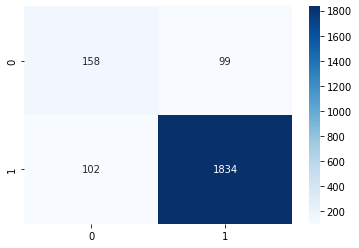

In [ ]:
import seaborn as sns

TPsum = np.sum(TPs)
TNsum = np.sum(TNs)
FPsum = np.sum(FPs)
FNsum = np.sum(FNs)

cm_data = [[TPsum, FNsum], [FPsum, TNsum]]
sns.heatmap(cm_data, annot=True, cmap='Blues', fmt='d')

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([videos[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
RFWithSMOTE = pd.DataFrame(data, columns=['Video', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([RFWithSMOTE.mean(axis=0).values],  columns=['Video', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         Video  Accuracy   ROC_AUC        F1  ...     TP      TN     FP      FN
Average    4.5  0.904447  0.773766  0.598285  ...  19.75  229.25  12.75  12.375

[1 rows x 11 columns]


In [ ]:
RFWithSMOTE = RFWithSMOTE.append(df_temp)

In [ ]:
print(RFWithSMOTE)
RFWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/User/RFUserSMOTE.csv', index = True)

         Video  Accuracy   ROC_AUC        F1  ...     TP      TN     FP      FN
0          1.0  0.935385  0.837842  0.720000  ...  27.00  277.00  10.00  11.000
1          2.0  0.909396  0.807932  0.630137  ...  23.00  248.00  16.00  11.000
2          3.0  0.863636  0.724856  0.490566  ...  13.00  158.00  16.00  11.000
3          4.0  0.896429  0.778647  0.623377  ...  24.00  227.00  14.00  15.000
4          5.0  0.885375  0.695120  0.472727  ...  13.00  211.00  13.00  16.000
5          6.0  0.889328  0.742380  0.533333  ...  16.00  209.00  15.00  13.000
6          7.0  0.950292  0.874183  0.767123  ...  28.00  297.00   9.00   8.000
7          8.0  0.905738  0.729167  0.549020  ...  14.00  207.00   9.00  14.000
Average    4.5  0.904447  0.773766  0.598285  ...  19.75  229.25  12.75  12.375

[9 rows x 11 columns]


###Descision Tree

####Model

In [ ]:
from sklearn.tree import DecisionTreeClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_dt = DecisionTreeClassifier()
    tic = time.time()
    model_dt.fit(X_train, y_train) 
    toc = time.time()
    print("Decision Tree Train time = " + str(toc-tic))
    print("Decision Tree Accuracy = "+ str(model_dt.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_dt.predict(X_test)
    yhat_classes = (model_dt.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Decision Tree Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Decision Tree Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

Decision Tree Train time = 0.02109360694885254
Decision Tree Accuracy = 0.8892307692307693
Decision Tree Test time = 0.005140066146850586
(325,)
(325,)
___________________Decision Tree Stats _____________________
Accuracy: 0.889231
True negatives: 261
True positives: 28
False positives: 26
False negatives: 10
ROC AUC: 0.823125
F1 Score: 0.608696
Precision: 0.518519
TPR: 0.736842
FPR: 0.090592
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.019691944122314453
Decision Tree Accuracy = 0.8590604026845637
Decision Tree Test time = 0.004525899887084961
(298,)
(298,)
___________________Decision Tree Stats _____________________
Accuracy: 0.859060
True negatives: 234
True positives: 22
False positives: 30
False negatives: 12
ROC AUC: 0.766711
F1 Score: 0.511628
Precision: 0.423077
TPR: 0.647059
FPR: 0.113636
____________________________________________________________
________________________

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([videos[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
DTWithSMOTE = pd.DataFrame(data, columns=['Video', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DTWithSMOTE.mean(axis=0).values],  columns=['Video', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         Video  Accuracy   ROC_AUC        F1  ...    TP       TN      FP      FN
Average    4.5  0.859401  0.739472  0.502691  ...  19.0  217.875  24.125  13.125

[1 rows x 11 columns]


In [ ]:
DTWithSMOTE = DTWithSMOTE.append(df_temp)

In [ ]:
print(DTWithSMOTE)
DTWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/User/DTUserSMOTE.csv', index = True)

         Video  Accuracy   ROC_AUC        F1  ...    TP       TN      FP      FN
0          1.0  0.889231  0.823125  0.608696  ...  28.0  261.000  26.000  10.000
1          2.0  0.859060  0.766711  0.511628  ...  22.0  234.000  30.000  12.000
2          3.0  0.823232  0.683908  0.406780  ...  12.0  151.000  23.000  12.000
3          4.0  0.800000  0.679647  0.416667  ...  20.0  204.000  37.000  19.000
4          5.0  0.877470  0.750693  0.523077  ...  17.0  205.000  19.000  12.000
5          6.0  0.849802  0.690040  0.424242  ...  14.0  201.000  23.000  15.000
6          7.0  0.944444  0.834150  0.724638  ...  25.0  298.000   8.000  11.000
7          8.0  0.831967  0.687500  0.405797  ...  14.0  189.000  27.000  14.000
Average    4.5  0.859401  0.739472  0.502691  ...  19.0  217.875  24.125  13.125

[9 rows x 11 columns]


###Gradient Boost

####Model

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_gb = GradientBoostingClassifier(n_estimators = 1000) 
    tic = time.time()
    model_gb.fit(X_train, y_train) 
    toc = time.time()
    print("Gradient Boost Train time = " + str(toc-tic))
    print("Gradient Boost Accuracy = "+ str(model_gb.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_gb.predict(X_test)
    yhat_classes = (model_gb.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Gradient Boost Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Gradient Boost Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 11.108547449111938
Gradient Boost Accuracy = 0.9261538461538461
Gradient Boost Test time = 0.05234956741333008
(325,)
(325,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.926154
True negatives: 272
True positives: 29
False positives: 15
False negatives: 9
ROC AUC: 0.855447
F1 Score: 0.707317
Precision: 0.659091
TPR: 0.763158
FPR: 0.052265
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 8.249710321426392
Gradient Boost Accuracy = 0.9093959731543624
Gradient Boost Test time = 0.022895336151123047
(298,)
(298,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.909396
True negatives: 247
True positives: 24
False positives: 17
False negatives: 10
ROC AUC: 0.820744
F1 Score: 0.640000
Precision: 0.585366
TPR: 0.705882
FPR: 0.064394
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 4.591287136077881
Gradient Boost Accuracy = 0.8686868686868687
Gradient Boost Test time = 0.017351865768432617
(198,)
(198,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.868687
True negatives: 158
True positives: 14
False positives: 16
False negatives: 10
ROC AUC: 0.745690
F1 Score: 0.518519
Precision: 0.466667
TPR: 0.583333
FPR: 0.091954
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 5.891427516937256
Gradient Boost Accuracy = 0.9142857142857143
Gradient Boost Test time = 0.021045207977294922
(280,)
(280,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.914286
True negatives: 227
True positives: 29
False positives: 14
False negatives: 10
ROC AUC: 0.842749
F1 Score: 0.707317
Precision: 0.674419
TPR: 0.743590
FPR: 0.058091
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 5.992894411087036
Gradient Boost Accuracy = 0.8774703557312253
Gradient Boost Test time = 0.020354032516479492
(253,)
(253,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.877470
True negatives: 208
True positives: 14
False positives: 16
False negatives: 15
ROC AUC: 0.705665
F1 Score: 0.474576
Precision: 0.466667
TPR: 0.482759
FPR: 0.071429
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 5.961019992828369
Gradient Boost Accuracy = 0.9130434782608695
Gradient Boost Test time = 0.018830537796020508
(253,)
(253,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.913043
True negatives: 214
True positives: 17
False positives: 10
False negatives: 12
ROC AUC: 0.770782
F1 Score: 0.607143
Precision: 0.629630
TPR: 0.586207
FPR: 0.044643
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 7.969816207885742
Gradient Boost Accuracy = 0.956140350877193
Gradient Boost Test time = 0.022678375244140625
(342,)
(342,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.956140
True negatives: 299
True positives: 28
False positives: 7
False negatives: 8
ROC AUC: 0.877451
F1 Score: 0.788732
Precision: 0.800000
TPR: 0.777778
FPR: 0.022876
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 5.78339409828186
Gradient Boost Accuracy = 0.9016393442622951
Gradient Boost Test time = 0.021747589111328125
(244,)
(244,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.901639
True negatives: 207
True positives: 13
False positives: 9
False negatives: 15
ROC AUC: 0.711310
F1 Score: 0.520000
Precision: 0.590909
TPR: 0.464286
FPR: 0.041667
____________________________________________________________
____________________________________________________________


#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([videos[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
GBWithSMOTE = pd.DataFrame(data, columns=['Video', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([GBWithSMOTE.mean(axis=0).values],  columns=['Video', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         Video  Accuracy  ROC_AUC        F1  ...    TP     TN    FP      FN
Average    4.5  0.908352  0.79123  0.620451  ...  21.0  229.0  13.0  11.125

[1 rows x 11 columns]


In [ ]:
GBWithSMOTE = GBWithSMOTE.append(df_temp)

In [ ]:
print(GBWithSMOTE)
GBWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/User/GBUserSMOTE.csv', index = True)

         Video  Accuracy   ROC_AUC        F1  ...    TP     TN    FP      FN
0          1.0  0.926154  0.855447  0.707317  ...  29.0  272.0  15.0   9.000
1          2.0  0.909396  0.820744  0.640000  ...  24.0  247.0  17.0  10.000
2          3.0  0.868687  0.745690  0.518519  ...  14.0  158.0  16.0  10.000
3          4.0  0.914286  0.842749  0.707317  ...  29.0  227.0  14.0  10.000
4          5.0  0.877470  0.705665  0.474576  ...  14.0  208.0  16.0  15.000
5          6.0  0.913043  0.770782  0.607143  ...  17.0  214.0  10.0  12.000
6          7.0  0.956140  0.877451  0.788732  ...  28.0  299.0   7.0   8.000
7          8.0  0.901639  0.711310  0.520000  ...  13.0  207.0   9.0  15.000
Average    4.5  0.908352  0.791230  0.620451  ...  21.0  229.0  13.0  11.125

[9 rows x 11 columns]


###3 DNN

#### Model

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model3 = Sequential()

    model3.add(Dense(64, activation='relu', input_shape=(14,)))
    model3.add(Dropout(0.3))
    model3.add(Dense(32, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(8, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(1, activation='sigmoid'))

    model3.compile(loss='binary_crossentropy',
                  optimizer='adam',
                  metrics=['accuracy'])
    reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=0.001)
    tic = time.time()
    model3.fit(X_train, y_train, batch_size=64, epochs=100, validation_split=0.1, callbacks=[reduce_lr])
    toc = time.time()
    print("3 DNN Train time = " + str(toc-tic))
    print("3 DNN Accuracy = "+ str(model3.evaluate(X_test, y_test, verbose=0)[1]))
    tic = time.time()
    yhat_probs = model3.predict(X_test, verbose=0)
    yhat_classes = (model3.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("3 DNN Test time = " + str(toc-tic))
    yhat_probs = yhat_probs[:, 0]
    yhat_classes = yhat_classes[:, 0]
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________3 DNN Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

Epoch 1/100
19/19 [==============================] - 1s 21ms/step - loss: 0.7806 - accuracy: 0.4867 - val_loss: 0.6747 - val_accuracy: 0.7537 - lr: 0.0010
Epoch 2/100
19/19 [==============================] - 0s 6ms/step - loss: 0.7020 - accuracy: 0.5516 - val_loss: 0.7029 - val_accuracy: 0.2239 - lr: 0.0010
Epoch 3/100
19/19 [==============================] - 0s 4ms/step - loss: 0.6797 - accuracy: 0.5574 - val_loss: 0.7364 - val_accuracy: 0.1418 - lr: 0.0010
Epoch 4/100
19/19 [==============================] - 0s 5ms/step - loss: 0.6471 - accuracy: 0.6073 - val_loss: 0.7714 - val_accuracy: 0.1866 - lr: 0.0010
Epoch 5/100
19/19 [==============================] - 0s 7ms/step - loss: 0.6380 - accuracy: 0.6290 - val_loss: 0.7237 - val_accuracy: 0.3657 - lr: 0.0010
Epoch 6/100
19/19 [==============================] - 0s 7ms/step - loss: 0.6103 - accuracy: 0.6730 - val_loss: 0.5980 - val_accuracy: 0.5672 - lr: 0.0010
Epoch 7/100
19/19 [==============================] - 0s 7ms/step - loss: 0.

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([videos[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
DNN3WithSMOTE = pd.DataFrame(data, columns=['Video', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DNN3WithSMOTE.mean(axis=0).values],  columns=['Video', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         Video  Accuracy   ROC_AUC        F1  ...      TP       TN      FP    FN
Average    4.5  0.861119  0.873658  0.541588  ...  22.375  214.875  27.125  9.75

[1 rows x 11 columns]


In [ ]:
DNN3WithSMOTE = DNN3WithSMOTE.append(df_temp)

In [ ]:
print(DNN3WithSMOTE)
DNN3WithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/User/DNNUserSMOTE.csv', index = True)

         Video  Accuracy   ROC_AUC        F1  ...      TP       TN      FP     FN
0          1.0  0.880000  0.915551  0.606061  ...  30.000  256.000  31.000   8.00
1          2.0  0.842282  0.865029  0.515464  ...  25.000  226.000  38.000   9.00
2          3.0  0.797980  0.833333  0.444444  ...  16.000  142.000  32.000   8.00
3          4.0  0.835714  0.864879  0.540000  ...  27.000  207.000  34.000  12.00
4          5.0  0.849802  0.855757  0.457143  ...  16.000  199.000  25.000  13.00
5          6.0  0.877470  0.898322  0.597403  ...  23.000  199.000  25.000   6.00
6          7.0  0.932749  0.944717  0.716049  ...  29.000  290.000  16.000   7.00
7          8.0  0.872951  0.811673  0.456140  ...  13.000  200.000  16.000  15.00
Average    4.5  0.861119  0.873658  0.541588  ...  22.375  214.875  27.125   9.75

[9 rows x 11 columns]


# Without SMOTE last N

## Data Processing

### Import dataset

In [ ]:
directory_all = "/content/drive/MyDrive/Surjya Sir Work/5000"
directory_pbd = "/content/drive/MyDrive/Surjya Sir Work/5000_probed"

In [ ]:
# videos = [1,2,3,4,5,6,7,8]
videos = [1,2,3,4,7,8]

In [ ]:
all = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_all + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    all.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


In [ ]:
probed = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_pbd + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    probed.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


### Create df

In [ ]:
df = pd.DataFrame()
for i in range(len(all)):#per video = 8
  for j in range(len(all[i])): #per subject = 30
    df = df.append(all[i][j], ignore_index=True)

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8
5606,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8
5607,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8
5608,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8


In [ ]:
tester = pd.DataFrame()
for i in range(len(probed)):#per video = 8
  for j in range(len(probed[i])): #per subject = 30
    tester = tester.append(probed[i][j], ignore_index=True)

In [ ]:
tester

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1738876.01,1743876.01,1748876.01,6.309,5.096,0.013,0.106,5.632759,0.600,0.378,0.155,0.010,0.369,1.642,8.131,10,1
1,832168.01,837168.01,842168.01,6.488,5.290,0.012,0.159,1.883567,0.300,3.623,0.126,0.021,0.657,0.246,0.000,11,1
2,907168.01,912168.01,917168.01,5.330,4.958,0.394,0.082,3.340205,0.103,3.119,0.136,0.004,7.022,0.699,0.123,11,1
3,917168.01,922168.01,927168.01,6.046,5.011,0.767,0.003,2.078420,0.213,0.785,0.136,0.007,4.846,0.041,0.040,11,1
4,922168.01,927168.01,932168.01,6.476,5.014,0.430,0.022,2.208317,0.307,4.601,0.068,0.010,4.148,1.191,0.288,11,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
653,2282834.01,2287834.01,2292834.01,2.090,7.542,0.918,0.586,3.800016,3.170,4.349,0.261,0.003,0.082,2.916,1.602,8,8
654,2287834.01,2292834.01,2297834.01,1.199,8.115,1.181,0.661,5.052202,4.889,8.049,1.549,0.039,0.164,1.315,2.587,8,8
655,1166459.01,1171459.01,1176459.01,3.156,6.595,0.518,0.543,4.114055,0.256,0.368,4.792,0.011,2.998,3.368,13.429,9,8
656,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8


In [ ]:
temp = df[df.isin(tester)].dropna()

In [ ]:
temp = df.loc[df.set_index(list(df.columns)).index.isin(tester.set_index(list(tester.columns)).index)]

In [ ]:
temp.index

Int64Index([  35,   47,   62,   64,   65,   70,   99,  107,  117,  118,
            ...
            5511, 5532, 5551, 5554, 5559, 5575, 5576, 5604, 5605, 5606],
           dtype='int64', length=658)

In [ ]:
df['Probe'] = 0

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,0
5606,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,0
5607,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
5608,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
for idx in temp.index:
  df.at[idx, 'Probe'] = 1

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
5606,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
5607,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
5608,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


### Optimise df

In [ ]:
df = df.drop(columns=["Start", "Border", "End"], axis=1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
5606,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
5607,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
5608,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
df['valence_acc_video'] = 0
df['arousal_acc_video'] = 0

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,0,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,0,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,0,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,0,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,0
5606,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,0
5607,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,0
5608,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,0


I'm using the following encoding: 

1 - Low
2 - Mid/high
3 - High

In [ ]:
# def basedOnVideoValence(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 2
#     if int(video) == 6:
#         return 2
#     if int(video) == 7:
#         return 1
#     if int(video) == 8:
#         return 1
    
# def basedOnVideoArousal(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 1
#     if int(video) == 6:
#         return 1
#     if int(video) == 7:
#         return 3
#     if int(video) == 8:
#         return 3

New encoding, 
Low - 0 
Med / High - 1

In [ ]:
def basedOnVideoValence(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 1
    if int(video) == 6:
        return 1
    if int(video) == 7:
        return 0
    if int(video) == 8:
        return 0
    
def basedOnVideoArousal(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 0
    if int(video) == 6:
        return 0
    if int(video) == 7:
        return 1
    if int(video) == 8:
        return 1

In [ ]:
df['valence_acc_video'] = df.apply(lambda row : basedOnVideoValence(row['video']), axis = 1)
df['arousal_acc_video'] = df.apply(lambda row : basedOnVideoArousal(row['video']), axis = 1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1
5606,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1
5607,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1
5608,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1


### Last N

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1
5606,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1
5607,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1
5608,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1


In [ ]:
df['last1'] = np.where(df['Probe'].shift(1) == 1,1,0)
df['last2'] = np.where(df['Probe'].shift(2) == 1,1,0)
df['last3'] = np.where(df['Probe'].shift(3) == 1,1,0)
df['last4'] = np.where(df['Probe'].shift(4) == 1,1,0)
df['last5'] = np.where(df['Probe'].shift(5) == 1,1,0)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video,last1,last2,last3,last4,last5
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1,0,0,0,0,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1,0,0,0,0,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1,0,0,0,0,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1,0,0,0,0,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1,1,0,0,0,0
5606,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1,1,1,0,0,0
5607,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1,1,1,1,0,0
5608,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1,0,1,1,1,0


In [ ]:
# df['Last1'] = 0
# df['Last2'] = 0
# df['Last3'] = 0
# df['Last4'] = 0
# df['Last5'] = 0

df['Last1'] = df.apply(lambda row: (row.last1)/1, axis=1)
df['Last2'] = df.apply(lambda row: (row.last1 + row.last2)/2, axis=1)
df['Last3'] = df.apply(lambda row: (row.last1 + row.last2 + row.last3)/3, axis=1)
df['Last4'] = df.apply(lambda row: (row.last1 + row.last2 + row.last3 + row.last4)/4, axis=1)
df['Last5'] = df.apply(lambda row: (row.last1 + row.last2 + row.last3 + row.last4 + row.last5)/5, axis=1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video,last1,last2,last3,last4,last5,Last1,Last2,Last3,Last4,Last5
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1,0,0,0,0,0,0.0,0.0,0.000000,0.00,0.0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1,0,0,0,0,0,0.0,0.0,0.000000,0.00,0.0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1,0,0,0,0,0,0.0,0.0,0.000000,0.00,0.0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1,0,0,0,0,0,0.0,0.0,0.000000,0.00,0.0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1,0,0,0,0,0,0.0,0.0,0.000000,0.00,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1,1,0,0,0,0,1.0,0.5,0.333333,0.25,0.2
5606,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1,1,1,0,0,0,1.0,1.0,0.666667,0.50,0.4
5607,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1,1,1,1,0,0,1.0,1.0,1.000000,0.75,0.6
5608,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1,0,1,1,1,0,0.0,0.5,0.666667,0.75,0.6


In [ ]:
df = df.drop(columns=["last1", "last2", "last3", "last4", "last5"], axis = 1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video,Last1,Last2,Last3,Last4,Last5
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1,0.0,0.0,0.000000,0.00,0.0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1,0.0,0.0,0.000000,0.00,0.0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1,0.0,0.0,0.000000,0.00,0.0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1,0.0,0.0,0.000000,0.00,0.0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1,0.0,0.0,0.000000,0.00,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1,1.0,0.5,0.333333,0.25,0.2
5606,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1,1.0,1.0,0.666667,0.50,0.4
5607,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1,1.0,1.0,1.000000,0.75,0.6
5608,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1,0.0,0.5,0.666667,0.75,0.6


### Create X,y

In [ ]:
#df

In [ ]:
# X_train = pd.DataFrame()
# y_train = pd.DataFrame()
# X_test = pd.DataFrame()
# y_test = pd.DataFrame()

In [ ]:
# for video in videos:
#     df_selected = df[df['video'] == video]
#     y = df_selected['Probe']
#     y = pd.DataFrame(y)
#     X = df_selected.drop(columns=["Probe"], axis = 1)
#     X_train_new, X_test_new, y_train_new, y_test_new = train_test_split(X, y, test_size=0.2, random_state=42)
#     X_train = X_train.append(X_train_new, ignore_index=True)
#     y_train = y_train.append(y_train_new, ignore_index=True)
#     X_test = X_test.append(X_test_new, ignore_index=True)
#     y_test = y_test.append(y_test_new, ignore_index=True)

In [ ]:
# X_train

In [ ]:
# y_test

In [ ]:
# X_train = X_train.drop(columns=['video', 'subject'])
# X_test = X_test.drop(columns=['video', 'subject'])

In [ ]:
# X_train

### X,y using leave 1 use rest

In [ ]:
X_train_all = []
y_train_all = []
X_test_all = []
y_test_all = []

In [ ]:
users = []
for i in range(1, 31):
  users.append(i)

print(users)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30]


In [ ]:
for testuser in users:
  X_train = pd.DataFrame()
  y_train = pd.DataFrame()
  X_test = pd.DataFrame()
  y_test = pd.DataFrame()
  df_new = df[df['subject'] != str(testuser)]
  for video in videos:
    df_selected = df_new[df_new['video'] == video]
    y = df_selected['Probe']
    y = pd.DataFrame(y)
    X = df_selected.drop(columns=["Probe"], axis = 1)
    X_train = X_train.append(X, ignore_index=True)
    y_train = y_train.append(y, ignore_index=True)
  df_new = df[df['subject'] == str(testuser)]
  # print(df_new)
  for video in videos:
    df_selected = df_new[df_new['video'] == video]
    y = df_selected['Probe']
    y = pd.DataFrame(y)
    X = df_selected.drop(columns=["Probe"], axis = 1)
    X_test = X_test.append(X, ignore_index=True)
    y_test = y_test.append(y, ignore_index=True)  
  X_train_all.append(X_train)
  y_train_all.append(y_train)
  X_test_all.append(X_test)
  y_test_all.append(y_test)

In [ ]:
print(len(X_train_all[29]['subject'].unique()))

29


In [ ]:
new_X_train_all = []

for i in range(len(X_train_all)):
    df_temp = X_train_all[i]
    #df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    df_temp = df_temp.drop(columns=["subject"], axis = 1)
    new_X_train_all.append(df_temp)

X_train_all = new_X_train_all

new_X_test_all = []

for i in range(len(X_test_all)):
    df_temp = X_test_all[i]
    #df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    df_temp = df_temp.drop(columns=["subject"], axis = 1)
    new_X_test_all.append(df_temp)

X_test_all = new_X_test_all

In [ ]:
X_train_all[2]

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,video,valence_acc_video,arousal_acc_video,Last1,Last2,Last3,Last4,Last5
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,1,1,1,0.0,0.0,0.000000,0.00,0.0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,1,1,1,0.0,0.0,0.000000,0.00,0.0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,1,1,1,0.0,0.0,0.000000,0.00,0.0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,1,1,1,0.0,0.0,0.000000,0.00,0.0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,1,1,1,0.0,0.0,0.000000,0.00,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5418,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,8,0,1,1.0,0.5,0.333333,0.25,0.2
5419,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,8,0,1,1.0,1.0,0.666667,0.50,0.4
5420,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,8,0,1,1.0,1.0,1.000000,0.75,0.6
5421,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,8,0,1,0.0,0.5,0.666667,0.75,0.6


In [ ]:
y_test_all[7]

,Probe
0,0
1,0
2,0
3,0
4,0
...,...
182,0
183,0
184,0
185,0


## Models

###RandomForest

#### Model

In [ ]:
from sklearn.ensemble import RandomForestClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []

TPs = []
FPs = []
TNs = []
FNs = []


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6635761260986328
Random Forest Accuracy = 0.9358288770053476
Random Forest Test time = 0.0564577579498291
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.935829
[[164   2]
 [ 10  11]]
True negatives: 164
True positives: 11
False positives: 2
False negatives: 10
ROC AUC: 0.755881
F1 Score: 0.647059
Precision: 0.846154
TPR: 0.523810
FPR: 0.012048
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6345202922821045
Random Forest Accuracy = 0.9411764705882353
Random Forest Test time = 0.05691218376159668
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.941176
[[165   7]
 [  4  11]]
True negatives: 165
True positives: 11
False positives: 7
False negatives: 4
ROC AUC: 0.846318
F1 Score: 0.666667
Precision: 0.611111
TPR: 0.733333
FPR: 0.040698
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6168982982635498
Random Forest Accuracy = 0.93048128342246
Random Forest Test time = 0.05831789970397949
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.930481
[[157   5]
 [  8  17]]
True negatives: 157
True positives: 17
False positives: 5
False negatives: 8
ROC AUC: 0.824568
F1 Score: 0.723404
Precision: 0.772727
TPR: 0.680000
FPR: 0.030864
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6231019496917725
Random Forest Accuracy = 0.8823529411764706
Random Forest Test time = 0.056877851486206055
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.882353
[[154   1]
 [ 21  11]]
True negatives: 154
True positives: 11
False positives: 1
False negatives: 21
ROC AUC: 0.668649
F1 Score: 0.500000
Precision: 0.916667
TPR: 0.343750
FPR: 0.006452
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.620269775390625
Random Forest Accuracy = 0.8983957219251337
Random Forest Test time = 0.05691194534301758
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.898396
[[153   7]
 [ 12  15]]
True negatives: 153
True positives: 15
False positives: 7
False negatives: 12
ROC AUC: 0.755903
F1 Score: 0.612245
Precision: 0.681818
TPR: 0.555556
FPR: 0.043750
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6126365661621094
Random Forest Accuracy = 0.93048128342246
Random Forest Test time = 0.0635836124420166
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.930481
[[167   1]
 [ 12   7]]
True negatives: 167
True positives: 7
False positives: 1
False negatives: 12
ROC AUC: 0.681234
F1 Score: 0.518519
Precision: 0.875000
TPR: 0.368421
FPR: 0.005952
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6103808879852295
Random Forest Accuracy = 0.9197860962566845
Random Forest Test time = 0.055434465408325195
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.919786
[[156   8]
 [  7  16]]
True negatives: 156
True positives: 16
False positives: 8
False negatives: 7
ROC AUC: 0.823436
F1 Score: 0.680851
Precision: 0.666667
TPR: 0.695652
FPR: 0.048780
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6358177661895752
Random Forest Accuracy = 0.9037433155080213
Random Forest Test time = 0.05563473701477051
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.903743
[[160   6]
 [ 12   9]]
True negatives: 160
True positives: 9
False positives: 6
False negatives: 12
ROC AUC: 0.696213
F1 Score: 0.500000
Precision: 0.600000
TPR: 0.428571
FPR: 0.036145
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6342661380767822
Random Forest Accuracy = 0.9251336898395722
Random Forest Test time = 0.05639338493347168
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.925134
[[160   2]
 [ 12  13]]
True negatives: 160
True positives: 13
False positives: 2
False negatives: 12
ROC AUC: 0.753827
F1 Score: 0.650000
Precision: 0.866667
TPR: 0.520000
FPR: 0.012346
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6693000793457031
Random Forest Accuracy = 0.9144385026737968
Random Forest Test time = 0.07097029685974121
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.914439
[[168   0]
 [ 16   3]]
True negatives: 168
True positives: 3
False positives: 0
False negatives: 16
ROC AUC: 0.578947
F1 Score: 0.272727
Precision: 1.000000
TPR: 0.157895
FPR: 0.000000


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6527183055877686
Random Forest Accuracy = 0.8983957219251337
Random Forest Test time = 0.05406308174133301
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.898396
[[165   0]
 [ 19   3]]
True negatives: 165
True positives: 3
False positives: 0
False negatives: 19
ROC AUC: 0.568182
F1 Score: 0.240000
Precision: 1.000000
TPR: 0.136364
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.658454179763794
Random Forest Accuracy = 0.9358288770053476
Random Forest Test time = 0.07347273826599121
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.935829
[[169   0]
 [ 12   6]]
True negatives: 169
True positives: 6
False positives: 0
False negatives: 12
ROC AUC: 0.666667
F1 Score: 0.500000
Precision: 1.000000
TPR: 0.333333
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.5915892124176025
Random Forest Accuracy = 0.9090909090909091
Random Forest Test time = 0.062192440032958984
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.909091
[[157   8]
 [  9  13]]
True negatives: 157
True positives: 13
False positives: 8
False negatives: 9
ROC AUC: 0.771212
F1 Score: 0.604651
Precision: 0.619048
TPR: 0.590909
FPR: 0.048485
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6722960472106934
Random Forest Accuracy = 0.9411764705882353
Random Forest Test time = 0.05581402778625488
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.941176
[[164   5]
 [  6  12]]
True negatives: 164
True positives: 12
False positives: 5
False negatives: 6
ROC AUC: 0.818540
F1 Score: 0.685714
Precision: 0.705882
TPR: 0.666667
FPR: 0.029586
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6358888149261475
Random Forest Accuracy = 0.9411764705882353
Random Forest Test time = 0.055500030517578125
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.941176
[[160   4]
 [  7  16]]
True negatives: 160
True positives: 16
False positives: 4
False negatives: 7
ROC AUC: 0.835631
F1 Score: 0.744186
Precision: 0.800000
TPR: 0.695652
FPR: 0.024390
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.641845703125
Random Forest Accuracy = 0.9090909090909091
Random Forest Test time = 0.0587010383605957
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.909091
[[167   0]
 [ 17   3]]
True negatives: 167
True positives: 3
False positives: 0
False negatives: 17
ROC AUC: 0.575000
F1 Score: 0.260870
Precision: 1.000000
TPR: 0.150000
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6124322414398193
Random Forest Accuracy = 0.9037433155080213
Random Forest Test time = 0.05968213081359863
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.903743
[[164   1]
 [ 17   5]]
True negatives: 164
True positives: 5
False positives: 1
False negatives: 17
ROC AUC: 0.610606
F1 Score: 0.357143
Precision: 0.833333
TPR: 0.227273
FPR: 0.006061
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.612273931503296
Random Forest Accuracy = 0.946524064171123
Random Forest Test time = 0.052778005599975586
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.946524
[[170   1]
 [  9   7]]
True negatives: 170
True positives: 7
False positives: 1
False negatives: 9
ROC AUC: 0.715826
F1 Score: 0.583333
Precision: 0.875000
TPR: 0.437500
FPR: 0.005848
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6372265815734863
Random Forest Accuracy = 0.8823529411764706
Random Forest Test time = 0.058908700942993164
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.882353
[[153   6]
 [ 16  12]]
True negatives: 153
True positives: 12
False positives: 6
False negatives: 16
ROC AUC: 0.695418
F1 Score: 0.521739
Precision: 0.666667
TPR: 0.428571
FPR: 0.037736
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6440868377685547
Random Forest Accuracy = 0.9679144385026738
Random Forest Test time = 0.056064605712890625
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.967914
[[162   1]
 [  5  19]]
True negatives: 162
True positives: 19
False positives: 1
False negatives: 5
ROC AUC: 0.892766
F1 Score: 0.863636
Precision: 0.950000
TPR: 0.791667
FPR: 0.006135
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6105201244354248
Random Forest Accuracy = 0.8609625668449198
Random Forest Test time = 0.051645517349243164
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.860963
[[161   0]
 [ 26   0]]
True negatives: 161
True positives: 0
False positives: 0
False negatives: 26
ROC AUC: 0.500000
F1 Score: 0.000000
Precision: nan
TPR: 0.000000
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:58: RuntimeWarning: invalid value encountered in long_scalars
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y w

Random Forest Train time = 1.6261789798736572
Random Forest Accuracy = 0.9411764705882353
Random Forest Test time = 0.05888652801513672
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.941176
[[166   0]
 [ 11  10]]
True negatives: 166
True positives: 10
False positives: 0
False negatives: 11
ROC AUC: 0.738095
F1 Score: 0.645161
Precision: 1.000000
TPR: 0.476190
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.594559669494629
Random Forest Accuracy = 0.893048128342246
Random Forest Test time = 0.05810809135437012
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.893048
[[162   0]
 [ 20   5]]
True negatives: 162
True positives: 5
False positives: 0
False negatives: 20
ROC AUC: 0.600000
F1 Score: 0.333333
Precision: 1.000000
TPR: 0.200000
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.628857135772705
Random Forest Accuracy = 0.9037433155080213
Random Forest Test time = 0.05680584907531738
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.903743
[[165   0]
 [ 18   4]]
True negatives: 165
True positives: 4
False positives: 0
False negatives: 18
ROC AUC: 0.590909
F1 Score: 0.307692
Precision: 1.000000
TPR: 0.181818
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6175270080566406
Random Forest Accuracy = 0.8770053475935828
Random Forest Test time = 0.05367136001586914
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.877005
[[161   2]
 [ 21   3]]
True negatives: 161
True positives: 3
False positives: 2
False negatives: 21
ROC AUC: 0.556365
F1 Score: 0.206897
Precision: 0.600000
TPR: 0.125000
FPR: 0.012270
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.634706974029541
Random Forest Accuracy = 0.9679144385026738
Random Forest Test time = 0.06936526298522949
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.967914
[[165   4]
 [  2  16]]
True negatives: 165
True positives: 16
False positives: 4
False negatives: 2
ROC AUC: 0.932610
F1 Score: 0.842105
Precision: 0.800000
TPR: 0.888889
FPR: 0.023669
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.5941917896270752
Random Forest Accuracy = 0.8983957219251337
Random Forest Test time = 0.05397820472717285
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.898396
[[162   3]
 [ 16   6]]
True negatives: 162
True positives: 6
False positives: 3
False negatives: 16
ROC AUC: 0.627273
F1 Score: 0.387097
Precision: 0.666667
TPR: 0.272727
FPR: 0.018182
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.60137939453125
Random Forest Accuracy = 0.9251336898395722
Random Forest Test time = 0.054023027420043945
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.925134
[[168   1]
 [ 13   5]]
True negatives: 168
True positives: 5
False positives: 1
False negatives: 13
ROC AUC: 0.635930
F1 Score: 0.416667
Precision: 0.833333
TPR: 0.277778
FPR: 0.005917
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.635232925415039
Random Forest Accuracy = 0.9411764705882353
Random Forest Test time = 0.0550229549407959
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.941176
[[163   4]
 [  7  13]]
True negatives: 163
True positives: 13
False positives: 4
False negatives: 7
ROC AUC: 0.813024
F1 Score: 0.702703
Precision: 0.764706
TPR: 0.650000
FPR: 0.023952
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.6269519329071045
Random Forest Accuracy = 0.9251336898395722
Random Forest Test time = 0.054749250411987305
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.925134
[[158   7]
 [  7  15]]
True negatives: 158
True positives: 15
False positives: 7
False negatives: 7
ROC AUC: 0.819697
F1 Score: 0.681818
Precision: 0.681818
TPR: 0.681818
FPR: 0.042424
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


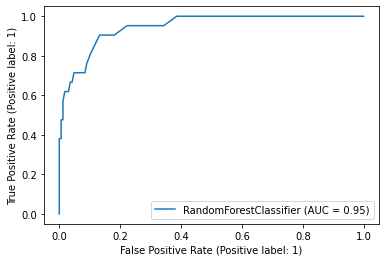

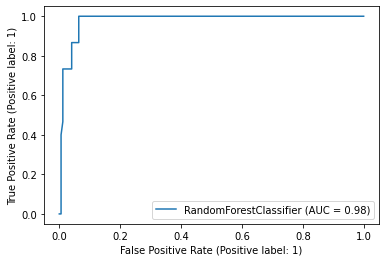

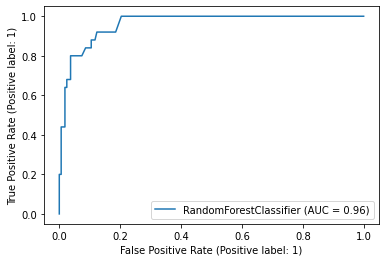

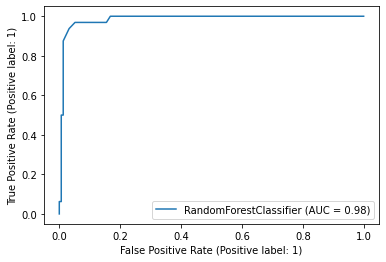

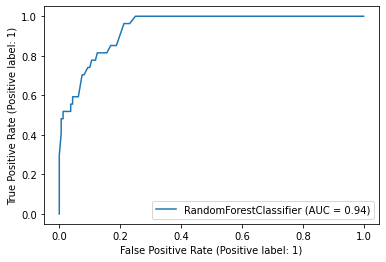

...

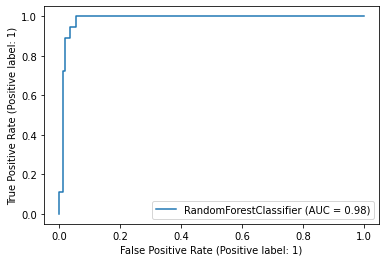

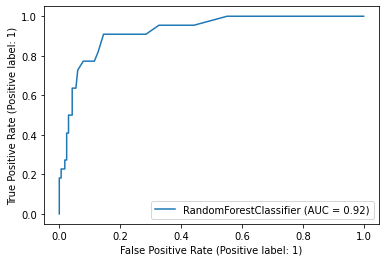

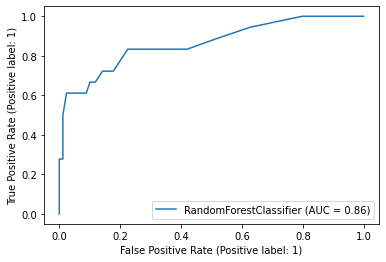

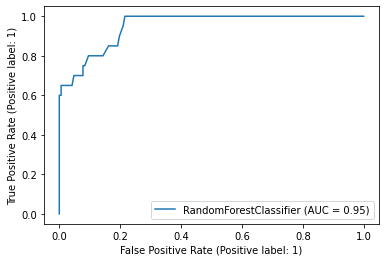

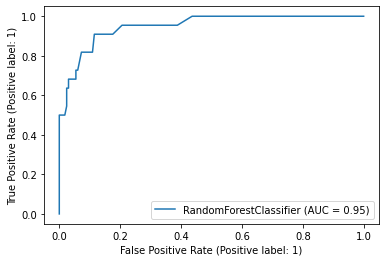

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_rf = RandomForestClassifier() 
    tic = time.time()
    model_rf.fit(X_train, y_train) 
    toc = time.time()
    print("Random Forest Train time = " + str(toc-tic))
    print("Random Forest Accuracy = "+ str(model_rf.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_rf.predict(X_test)
    yhat_classes = (model_rf.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Random Forest Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Random Forest Stats _____________________")

    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    CM = confusion_matrix(y_test, yhat_classes)
    print(CM)
    TN = CM[0][0]
    FN = CM[1][0]
    TP = CM[1][1]
    FP = CM[0][1]
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)

    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    auc = roc_auc_score(y_test, yhat_probs)
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    #AUC
    from sklearn.metrics import plot_roc_curve
    plot_roc_curve(model_rf, X_test, y_test)

    print("____________________________________________________________")
    print("____________________________________________________________")

#### Results

286


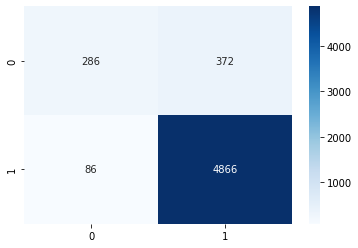

In [ ]:
import seaborn as sns

TPsum = np.sum(TPs)
TNsum = np.sum(TNs)
FPsum = np.sum(FPs)
FNsum = np.sum(FNs)

print(TPsum)

cm_data = [[TPsum, FNsum], [FPsum, TNsum]]
sns.heatmap(cm_data, annot=True, cmap='Blues', fmt='d')

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
RFWithoutSMOTE = pd.DataFrame(data, columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([RFWithoutSMOTE.mean(axis=0).values],  columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User Left Out  Accuracy   ROC_AUC  ...     TN        FP    FN
Average           15.5   0.91836  0.711624  ...  162.2  2.866667  12.4

[1 rows x 11 columns]


In [ ]:
RFWithoutSMOTE = RFWithoutSMOTE.append(df_temp)

In [ ]:
print(RFWithoutSMOTE)
RFWithoutSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/RFWithoutSMOTE.csv', index = True)

         User Left Out  Accuracy   ROC_AUC  ...     TN        FP    FN
0                  1.0  0.935829  0.755881  ...  164.0  2.000000  10.0
1                  2.0  0.941176  0.846318  ...  165.0  7.000000   4.0
2                  3.0  0.930481  0.824568  ...  157.0  5.000000   8.0
3                  4.0  0.882353  0.668649  ...  154.0  1.000000  21.0
4                  5.0  0.898396  0.755903  ...  153.0  7.000000  12.0
5                  6.0  0.930481  0.681234  ...  167.0  1.000000  12.0
6                  7.0  0.919786  0.823436  ...  156.0  8.000000   7.0
7                  8.0  0.903743  0.696213  ...  160.0  6.000000  12.0
8                  9.0  0.925134  0.753827  ...  160.0  2.000000  12.0
9                 10.0  0.914439  0.578947  ...  168.0  0.000000  16.0
10                11.0  0.898396  0.568182  ...  165.0  0.000000  19.0
11                12.0  0.935829  0.666667  ...  169.0  0.000000  12.0
12                13.0  0.909091  0.771212  ...  157.0  8.000000   9.0
13    

###Descision Tree

####Model

In [ ]:
from sklearn.tree import DecisionTreeClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

Decision Tree Train time = 0.07822680473327637
Decision Tree Accuracy = 0.8983957219251337
Decision Tree Test time = 0.005136251449584961
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.898396
[[158   8]
 [ 11  10]]
True negatives: 158
True positives: 10
False positives: 8
False negatives: 11
ROC AUC: 0.713999
F1 Score: 0.512821
Precision: 0.555556
TPR: 0.476190
FPR: 0.048193
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.0790719985961914
Decision Tree Accuracy = 0.9037433155080213
Decision Tree Test time = 0.0051364898681640625
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.903743
[[156  16]
 [  2  13]]
True negatives: 156
True positives: 13
False positives: 16
False negatives: 2
ROC AUC: 0.886822
F1 Score: 0.590909
Precision: 0.448276
TPR: 0.866667
FPR: 0.093023
__________________________________________

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


Decision Tree Train time = 0.08343338966369629
Decision Tree Accuracy = 0.8770053475935828
Decision Tree Test time = 0.0056645870208740234
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.877005
[[145  17]
 [  6  19]]
True negatives: 145
True positives: 19
False positives: 17
False negatives: 6
ROC AUC: 0.827531
F1 Score: 0.622951
Precision: 0.527778
TPR: 0.760000
FPR: 0.104938
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.0854341983795166
Decision Tree Accuracy = 0.8235294117647058
Decision Tree Test time = 0.010472774505615234
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.823529
[[133  22]
 [ 11  21]]
True negatives: 133
True positives: 21
False positives: 22
False negatives: 11
ROC AUC: 0.757157
F1 Score: 0.560000
Precision: 0.488372
TPR: 0.656250
FPR: 0.141935
_________________________________________

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


Decision Tree Train time = 0.08515262603759766
Decision Tree Accuracy = 0.8235294117647058
Decision Tree Test time = 0.004963874816894531
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.823529
[[137  23]
 [ 10  17]]
True negatives: 137
True positives: 17
False positives: 23
False negatives: 10
ROC AUC: 0.742940
F1 Score: 0.507463
Precision: 0.425000
TPR: 0.629630
FPR: 0.143750
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.08254480361938477
Decision Tree Accuracy = 0.8877005347593583
Decision Tree Test time = 0.0051915645599365234
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.887701
[[156  12]
 [  9  10]]
True negatives: 156
True positives: 10
False positives: 12
False negatives: 9
ROC AUC: 0.727444
F1 Score: 0.487805
Precision: 0.454545
TPR: 0.526316
FPR: 0.071429
________________________________________

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


Decision Tree Train time = 0.0886528491973877
Decision Tree Accuracy = 0.8770053475935828
Decision Tree Test time = 0.005001544952392578
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.877005
[[148  16]
 [  7  16]]
True negatives: 148
True positives: 16
False positives: 16
False negatives: 7
ROC AUC: 0.799046
F1 Score: 0.581818
Precision: 0.500000
TPR: 0.695652
FPR: 0.097561
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.07903170585632324
Decision Tree Accuracy = 0.8449197860962567
Decision Tree Test time = 0.005033254623413086
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.844920
[[152  14]
 [ 15   6]]
True negatives: 152
True positives: 6
False positives: 14
False negatives: 15
ROC AUC: 0.600688
F1 Score: 0.292683
Precision: 0.300000
TPR: 0.285714
FPR: 0.084337
___________________________________________

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


Decision Tree Train time = 0.08828163146972656
Decision Tree Accuracy = 0.8556149732620321
Decision Tree Test time = 0.0049746036529541016
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.855615
[[146  16]
 [ 11  14]]
True negatives: 146
True positives: 14
False positives: 16
False negatives: 11
ROC AUC: 0.730617
F1 Score: 0.509091
Precision: 0.466667
TPR: 0.560000
FPR: 0.098765
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.07662343978881836
Decision Tree Accuracy = 0.8877005347593583
Decision Tree Test time = 0.0051403045654296875
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.887701
[[159   9]
 [ 12   7]]
True negatives: 159
True positives: 7
False positives: 9
False negatives: 12
ROC AUC: 0.657425
F1 Score: 0.400000
Precision: 0.437500
TPR: 0.368421
FPR: 0.053571
________________________________________

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


Decision Tree Train time = 0.10198497772216797
Decision Tree Accuracy = 0.9144385026737968
Decision Tree Test time = 0.005021810531616211
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.914439
[[163   2]
 [ 14   8]]
True negatives: 163
True positives: 8
False positives: 2
False negatives: 14
ROC AUC: 0.675758
F1 Score: 0.500000
Precision: 0.800000
TPR: 0.363636
FPR: 0.012121
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.09303998947143555
Decision Tree Accuracy = 0.9197860962566845
Decision Tree Test time = 0.004823923110961914
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.919786
[[167   2]
 [ 13   5]]
True negatives: 167
True positives: 5
False positives: 2
False negatives: 13
ROC AUC: 0.632972
F1 Score: 0.400000
Precision: 0.714286
TPR: 0.277778
FPR: 0.011834


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.08385396003723145
Decision Tree Accuracy = 0.8823529411764706
Decision Tree Test time = 0.004854679107666016
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.882353
[[152  13]
 [  9  13]]
True negatives: 152
True positives: 13
False positives: 13
False negatives: 9
ROC AUC: 0.756061
F1 Score: 0.541667
Precision: 0.500000
TPR: 0.590909
FPR: 0.078788
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


Decision Tree Train time = 0.0833740234375
Decision Tree Accuracy = 0.893048128342246
Decision Tree Test time = 0.0050542354583740234
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.893048
[[155  14]
 [  6  12]]
True negatives: 155
True positives: 12
False positives: 14
False negatives: 6
ROC AUC: 0.791913
F1 Score: 0.545455
Precision: 0.461538
TPR: 0.666667
FPR: 0.082840
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.08808016777038574
Decision Tree Accuracy = 0.8983957219251337
Decision Tree Test time = 0.004941225051879883
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.898396
[[152  12]
 [  7  16]]
True negatives: 152
True positives: 16
False positives: 12
False negatives: 7
ROC AUC: 0.811241
F1 Score: 0.627451
Precision: 0.571429
TPR: 0.695652
FPR: 0.073171
______________________________________________

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


Decision Tree Train time = 0.08399319648742676
Decision Tree Accuracy = 0.9090909090909091
Decision Tree Test time = 0.004931926727294922
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.909091
[[163   4]
 [ 13   7]]
True negatives: 163
True positives: 7
False positives: 4
False negatives: 13
ROC AUC: 0.663024
F1 Score: 0.451613
Precision: 0.636364
TPR: 0.350000
FPR: 0.023952
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.1008901596069336
Decision Tree Accuracy = 0.893048128342246
Decision Tree Test time = 0.004966020584106445
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.893048
[[159   6]
 [ 14   8]]
True negatives: 159
True positives: 8
False positives: 6
False negatives: 14
ROC AUC: 0.663636
F1 Score: 0.444444
Precision: 0.571429
TPR: 0.363636
FPR: 0.036364
______________________________________________

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


Decision Tree Train time = 0.08444046974182129
Decision Tree Accuracy = 0.9411764705882353
Decision Tree Test time = 0.004903078079223633
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.941176
[[168   3]
 [  8   8]]
True negatives: 168
True positives: 8
False positives: 3
False negatives: 8
ROC AUC: 0.741228
F1 Score: 0.592593
Precision: 0.727273
TPR: 0.500000
FPR: 0.017544
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.10321497917175293
Decision Tree Accuracy = 0.786096256684492
Decision Tree Test time = 0.005082130432128906
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.786096
[[132  27]
 [ 13  15]]
True negatives: 132
True positives: 15
False positives: 27
False negatives: 13
ROC AUC: 0.682951
F1 Score: 0.428571
Precision: 0.357143
TPR: 0.535714
FPR: 0.169811


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.07727456092834473
Decision Tree Accuracy = 0.8663101604278075
Decision Tree Test time = 0.005173921585083008
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.866310
[[143  20]
 [  5  19]]
True negatives: 143
True positives: 19
False positives: 20
False negatives: 5
ROC AUC: 0.834484
F1 Score: 0.603175
Precision: 0.487179
TPR: 0.791667
FPR: 0.122699
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.08574390411376953
Decision Tree Accuracy = 0.8342245989304813
Decision Tree Test time = 0.005002021789550781
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.834225
[[151  10]
 [ 21   5]]
True negatives: 151
True positives: 5
False positives: 10
False negatives: 21
ROC A

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.07839107513427734
Decision Tree Accuracy = 0.9251336898395722
Decision Tree Test time = 0.00496673583984375
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.925134
[[162   4]
 [ 10  11]]
True negatives: 162
True positives: 11
False positives: 4
False negatives: 10
ROC AUC: 0.749857
F1 Score: 0.611111
Precision: 0.733333
TPR: 0.523810
FPR: 0.024096
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class m

Decision Tree Train time = 0.08987784385681152
Decision Tree Accuracy = 0.8609625668449198
Decision Tree Test time = 0.004999637603759766
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.860963
[[150  12]
 [ 14  11]]
True negatives: 150
True positives: 11
False positives: 12
False negatives: 14
ROC AUC: 0.682963
F1 Score: 0.458333
Precision: 0.478261
TPR: 0.440000
FPR: 0.074074
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.09200572967529297
Decision Tree Accuracy = 0.9197860962566845
Decision Tree Test time = 0.004998683929443359
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.919786
[[161   4]
 [ 11  11]]
True negatives: 161
True positives: 11
False positives: 4
False negatives: 11
ROC AUC: 0.737879
F1 Score: 0.594595
Precision: 0.733333
TPR: 0.500000
FPR: 0.024242
_________________________________________

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class m

Decision Tree Train time = 0.08516407012939453
Decision Tree Accuracy = 0.8663101604278075
Decision Tree Test time = 0.005031108856201172
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.866310
[[154   9]
 [ 16   8]]
True negatives: 154
True positives: 8
False positives: 9
False negatives: 16
ROC AUC: 0.639059
F1 Score: 0.390244
Precision: 0.470588
TPR: 0.333333
FPR: 0.055215
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.08874821662902832
Decision Tree Accuracy = 0.9037433155080213
Decision Tree Test time = 0.0048980712890625
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.903743
[[153  16]
 [  2  16]]
True negatives: 153
True positives: 16
False positives: 16
False negatives: 2
ROC AUC: 0.897107
F1 Score: 0.640000
Precision: 0.500000
TPR: 0.888889
FPR: 0.094675
_____________________________________________

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class m

Decision Tree Train time = 0.0845792293548584
Decision Tree Accuracy = 0.8823529411764706
Decision Tree Test time = 0.005206584930419922
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.882353
[[157   8]
 [ 14   8]]
True negatives: 157
True positives: 8
False positives: 8
False negatives: 14
ROC AUC: 0.657576
F1 Score: 0.421053
Precision: 0.500000
TPR: 0.363636
FPR: 0.048485
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.08372139930725098
Decision Tree Accuracy = 0.9572192513368984
Decision Tree Test time = 0.004941225051879883
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.957219
[[168   1]
 [  7  11]]
True negatives: 168
True positives: 11
False positives: 1
False negatives: 7
ROC AUC: 0.802597
F1 Score: 0.733333
Precision: 0.916667
TPR: 0.611111
FPR: 0.005917
_____________________________________________

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class m

Decision Tree Train time = 0.08438658714294434
Decision Tree Accuracy = 0.8877005347593583
Decision Tree Test time = 0.005030155181884766
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.887701
[[155  12]
 [  9  11]]
True negatives: 155
True positives: 11
False positives: 12
False negatives: 9
ROC AUC: 0.739072
F1 Score: 0.511628
Precision: 0.478261
TPR: 0.550000
FPR: 0.071856
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.08439135551452637
Decision Tree Accuracy = 0.839572192513369
Decision Tree Test time = 0.004975795745849609
(187,)
(187,)
___________________Decision Tree Stats _____________________
Accuracy: 0.839572
[[142  23]
 [  7  15]]
True negatives: 142
True positives: 15
False positives: 23
False negatives: 7
ROC AUC: 0.771212
F1 Score: 0.500000
Precision: 0.394737
TPR: 0.681818
FPR: 0.139394
___________________________________________

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


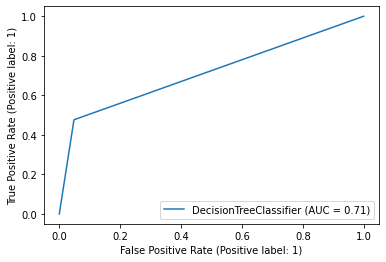

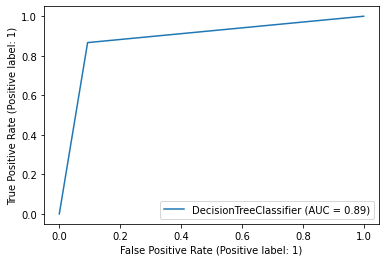

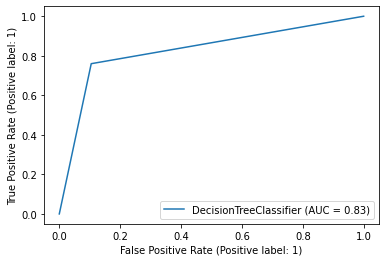

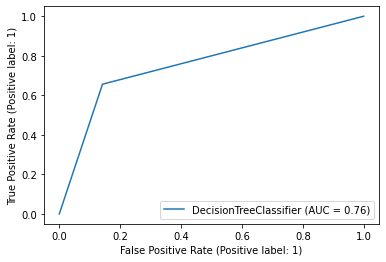

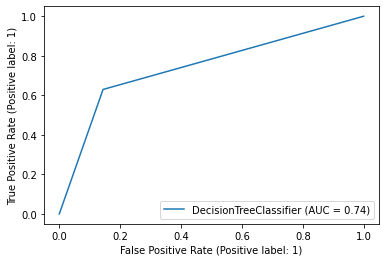

...

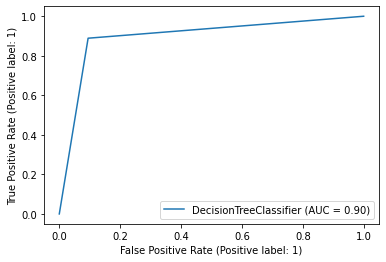

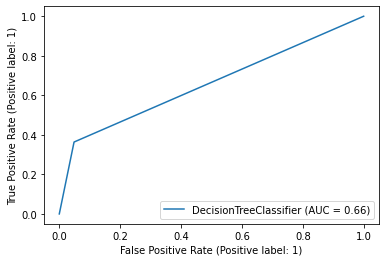

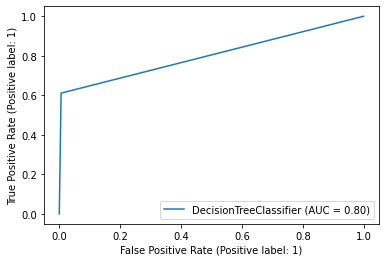

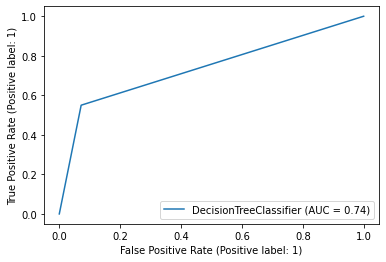

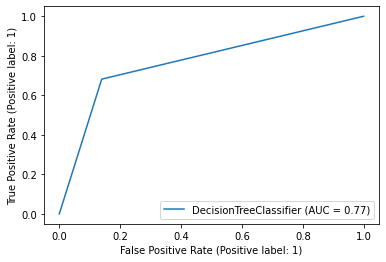

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_dt = DecisionTreeClassifier()
    tic = time.time()
    model_dt.fit(X_train, y_train) 
    toc = time.time()
    print("Decision Tree Train time = " + str(toc-tic))
    print("Decision Tree Accuracy = "+ str(model_dt.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_dt.predict(X_test)
    yhat_classes = (model_dt.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Decision Tree Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Decision Tree Stats _____________________")

    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    CM = confusion_matrix(y_test, yhat_classes)
    print(CM)
    TN = CM[0][0]
    FN = CM[1][0]
    TP = CM[1][1]
    FP = CM[0][1]
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)

    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    auc = roc_auc_score(y_test, yhat_probs)
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    #AUC
    from sklearn.metrics import plot_roc_curve
    plot_roc_curve(model_dt, X_test, y_test)

    print("____________________________________________________________")
    print("____________________________________________________________")

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
DTWithoutSMOTE = pd.DataFrame(data, columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DTWithoutSMOTE.mean(axis=0).values],  columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User Left Out  Accuracy   ROC_AUC  ...          TN         FP         FN
Average           15.5  0.881996  0.731312  ...  153.233333  11.833333  10.233333

[1 rows x 11 columns]


In [ ]:
DTWithoutSMOTE = DTWithoutSMOTE.append(df_temp)

In [ ]:
print(DTWithoutSMOTE)
DTWithoutSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/DTWithoutSMOTE.csv', index = True)

         User Left Out  Accuracy   ROC_AUC  ...          TN         FP         FN
0                  1.0  0.898396  0.713999  ...  158.000000   8.000000  11.000000
1                  2.0  0.903743  0.886822  ...  156.000000  16.000000   2.000000
2                  3.0  0.877005  0.827531  ...  145.000000  17.000000   6.000000
3                  4.0  0.823529  0.757157  ...  133.000000  22.000000  11.000000
4                  5.0  0.823529  0.742940  ...  137.000000  23.000000  10.000000
5                  6.0  0.887701  0.727444  ...  156.000000  12.000000   9.000000
6                  7.0  0.877005  0.799046  ...  148.000000  16.000000   7.000000
7                  8.0  0.844920  0.600688  ...  152.000000  14.000000  15.000000
8                  9.0  0.855615  0.730617  ...  146.000000  16.000000  11.000000
9                 10.0  0.887701  0.657425  ...  159.000000   9.000000  12.000000
10                11.0  0.914439  0.675758  ...  163.000000   2.000000  14.000000
11              

###Gradient Boost

####Model

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 25.197040796279907
Gradient Boost Accuracy = 0.9251336898395722
Gradient Boost Test time = 0.015938520431518555
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.925134
[[159   7]
 [  7  14]]
True negatives: 159
True positives: 14
False positives: 7
False negatives: 7
ROC AUC: 0.812249
F1 Score: 0.666667
Precision: 0.666667
TPR: 0.666667
FPR: 0.042169
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 25.00883173942566
Gradient Boost Accuracy = 0.946524064171123
Gradient Boost Test time = 0.014742851257324219
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.946524
[[162  10]
 [  0  15]]
True negatives: 162
True positives: 15
False positives: 10
False negatives: 0
ROC AUC: 0.970930
F1 Score: 0.750000
Precision: 0.600000
TPR: 1.000000
FPR: 0.058140
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 25.477782249450684
Gradient Boost Accuracy = 0.9037433155080213
Gradient Boost Test time = 0.01739788055419922
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.903743
[[151  11]
 [  7  18]]
True negatives: 151
True positives: 18
False positives: 11
False negatives: 7
ROC AUC: 0.826049
F1 Score: 0.666667
Precision: 0.620690
TPR: 0.720000
FPR: 0.067901
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 26.5746750831604
Gradient Boost Accuracy = 0.8983957219251337
Gradient Boost Test time = 0.016667842864990234
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.898396
[[152   3]
 [ 16  16]]
True negatives: 152
True positives: 16
False positives: 3
False negatives: 16
ROC AUC: 0.740323
F1 Score: 0.627451
Precision: 0.842105
TPR: 0.500000
FPR: 0.019355
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 25.13926076889038
Gradient Boost Accuracy = 0.9037433155080213
Gradient Boost Test time = 0.01728510856628418
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.903743
[[146  14]
 [  4  23]]
True negatives: 146
True positives: 23
False positives: 14
False negatives: 4
ROC AUC: 0.882176
F1 Score: 0.718750
Precision: 0.621622
TPR: 0.851852
FPR: 0.087500
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 25.16729187965393
Gradient Boost Accuracy = 0.9251336898395722
Gradient Boost Test time = 0.017542600631713867
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.925134
[[163   5]
 [  9  10]]
True negatives: 163
True positives: 10
False positives: 5
False negatives: 9
ROC AUC: 0.748277
F1 Score: 0.588235
Precision: 0.666667
TPR: 0.526316
FPR: 0.029762
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 25.177525281906128
Gradient Boost Accuracy = 0.9358288770053476
Gradient Boost Test time = 0.016118288040161133
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.935829
[[159   5]
 [  7  16]]
True negatives: 159
True positives: 16
False positives: 5
False negatives: 7
ROC AUC: 0.832582
F1 Score: 0.727273
Precision: 0.761905
TPR: 0.695652
FPR: 0.030488
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 25.012860774993896
Gradient Boost Accuracy = 0.8983957219251337
Gradient Boost Test time = 0.015406131744384766
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.898396
[[161   5]
 [ 14   7]]
True negatives: 161
True positives: 7
False positives: 5
False negatives: 14
ROC AUC: 0.651606
F1 Score: 0.424242
Precision: 0.583333
TPR: 0.333333
FPR: 0.030120
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 25.731314420700073
Gradient Boost Accuracy = 0.9197860962566845
Gradient Boost Test time = 0.04409003257751465
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.919786
[[157   5]
 [ 10  15]]
True negatives: 157
True positives: 15
False positives: 5
False negatives: 10
ROC AUC: 0.784568
F1 Score: 0.666667
Precision: 0.750000
TPR: 0.600000
FPR: 0.030864


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


____________________________________________________________
____________________________________________________________
Gradient Boost Train time = 27.07775068283081
Gradient Boost Accuracy = 0.9197860962566845
Gradient Boost Test time = 0.015268325805664062
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.919786
[[166   2]
 [ 13   6]]
True negatives: 166
True positives: 6
False positives: 2
False negatives: 13
ROC AUC: 0.651942
F1 Score: 0.444444
Precision: 0.750000
TPR: 0.315789
FPR: 0.011905
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 25.123221158981323
Gradient Boost Accuracy = 0.9090909090909091
Gradient Boost Test time = 0.015532493591308594
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.909091
[[165   0]
 [ 17   5]]
True negatives: 165
True positives: 5
False positives: 0
False negatives: 17
ROC AUC: 0.613636
F1 Score: 0.370370
Precision: 1.000000
TPR: 0.227273
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 25.241948127746582
Gradient Boost Accuracy = 0.9411764705882353
Gradient Boost Test time = 0.015631437301635742
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.941176
[[169   0]
 [ 11   7]]
True negatives: 169
True positives: 7
False positives: 0
False negatives: 11
ROC AUC: 0.694444
F1 Score: 0.560000
Precision: 1.000000
TPR: 0.388889
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 25.167580127716064
Gradient Boost Accuracy = 0.9037433155080213
Gradient Boost Test time = 0.015669822692871094
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.903743
[[155  10]
 [  8  14]]
True negatives: 155
True positives: 14
False positives: 10
False negatives: 8
ROC AUC: 0.787879
F1 Score: 0.608696
Precision: 0.583333
TPR: 0.636364
FPR: 0.060606
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 25.373655557632446
Gradient Boost Accuracy = 0.93048128342246
Gradient Boost Test time = 0.016916275024414062
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.930481
[[162   7]
 [  6  12]]
True negatives: 162
True positives: 12
False positives: 7
False negatives: 6
ROC AUC: 0.812623
F1 Score: 0.648649
Precision: 0.631579
TPR: 0.666667
FPR: 0.041420
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 26.184907913208008
Gradient Boost Accuracy = 0.93048128342246
Gradient Boost Test time = 0.01582813262939453
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.930481
[[156   8]
 [  5  18]]
True negatives: 156
True positives: 18
False positives: 8
False negatives: 5
ROC AUC: 0.866914
F1 Score: 0.734694
Precision: 0.692308
TPR: 0.782609
FPR: 0.048780
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 25.468924045562744
Gradient Boost Accuracy = 0.9090909090909091
Gradient Boost Test time = 0.015690088272094727
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.909091
[[167   0]
 [ 17   3]]
True negatives: 167
True positives: 3
False positives: 0
False negatives: 17
ROC AUC: 0.575000
F1 Score: 0.260870
Precision: 1.000000
TPR: 0.150000
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 25.11795711517334
Gradient Boost Accuracy = 0.8983957219251337
Gradient Boost Test time = 0.015723228454589844
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.898396
[[163   2]
 [ 17   5]]
True negatives: 163
True positives: 5
False positives: 2
False negatives: 17
ROC AUC: 0.607576
F1 Score: 0.344828
Precision: 0.714286
TPR: 0.227273
FPR: 0.012121
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 25.09861421585083
Gradient Boost Accuracy = 0.9411764705882353
Gradient Boost Test time = 0.015177726745605469
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.941176
[[169   2]
 [  9   7]]
True negatives: 169
True positives: 7
False positives: 2
False negatives: 9
ROC AUC: 0.712902
F1 Score: 0.560000
Precision: 0.777778
TPR: 0.437500
FPR: 0.011696
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 23.53189253807068
Gradient Boost Accuracy = 0.8235294117647058
Gradient Boost Test time = 0.010127544403076172
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.823529
[[135  24]
 [  9  19]]
True negatives: 135
True positives: 19
False positives: 24
False negatives: 9
ROC AUC: 0.763814
F1 Score: 0.535211
Precision: 0.441860
TPR: 0.678571
FPR: 0.150943
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 17.345051527023315
Gradient Boost Accuracy = 0.9572192513368984
Gradient Boost Test time = 0.010966300964355469
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.957219
[[157   6]
 [  2  22]]
True negatives: 157
True positives: 22
False positives: 6
False negatives: 2
ROC AUC: 0.939928
F1 Score: 0.846154
Precision: 0.785714
TPR: 0.916667
FPR: 0.036810
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 17.459888458251953
Gradient Boost Accuracy = 0.8716577540106952
Gradient Boost Test time = 0.010149955749511719
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.871658
[[157   4]
 [ 20   6]]
True negatives: 157
True positives: 6
False positives: 4
False negatives: 20
ROC AUC: 0.602962
F1 Score: 0.333333
Precision: 0.600000
TPR: 0.230769
FPR: 0.024845
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 17.462322473526
Gradient Boost Accuracy = 0.946524064171123
Gradient Boost Test time = 0.010510683059692383
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.946524
[[162   4]
 [  6  15]]
True negatives: 162
True positives: 15
False positives: 4
False negatives: 6
ROC AUC: 0.845095
F1 Score: 0.750000
Precision: 0.789474
TPR: 0.714286
FPR: 0.024096
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 17.505287408828735
Gradient Boost Accuracy = 0.9090909090909091
Gradient Boost Test time = 0.009711265563964844
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.909091
[[162   0]
 [ 17   8]]
True negatives: 162
True positives: 8
False positives: 0
False negatives: 17
ROC AUC: 0.660000
F1 Score: 0.484848
Precision: 1.000000
TPR: 0.320000
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 17.46492910385132
Gradient Boost Accuracy = 0.9144385026737968
Gradient Boost Test time = 0.010129928588867188
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.914439
[[164   1]
 [ 15   7]]
True negatives: 164
True positives: 7
False positives: 1
False negatives: 15
ROC AUC: 0.656061
F1 Score: 0.466667
Precision: 0.875000
TPR: 0.318182
FPR: 0.006061
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 17.37264847755432
Gradient Boost Accuracy = 0.8716577540106952
Gradient Boost Test time = 0.009664773941040039
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.871658
[[159   4]
 [ 20   4]]
True negatives: 159
True positives: 4
False positives: 4
False negatives: 20
ROC AUC: 0.571063
F1 Score: 0.250000
Precision: 0.500000
TPR: 0.166667
FPR: 0.024540
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 17.356096029281616
Gradient Boost Accuracy = 0.93048128342246
Gradient Boost Test time = 0.010054349899291992
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.930481
[[161   8]
 [  5  13]]
True negatives: 161
True positives: 13
False positives: 8
False negatives: 5
ROC AUC: 0.837442
F1 Score: 0.666667
Precision: 0.619048
TPR: 0.722222
FPR: 0.047337
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 17.63944387435913
Gradient Boost Accuracy = 0.8877005347593583
Gradient Boost Test time = 0.010435819625854492
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.887701
[[161   4]
 [ 17   5]]
True negatives: 161
True positives: 5
False positives: 4
False negatives: 17
ROC AUC: 0.601515
F1 Score: 0.322581
Precision: 0.555556
TPR: 0.227273
FPR: 0.024242
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 17.385865688323975
Gradient Boost Accuracy = 0.93048128342246
Gradient Boost Test time = 0.010248422622680664
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.930481
[[166   3]
 [ 10   8]]
True negatives: 166
True positives: 8
False positives: 3
False negatives: 10
ROC AUC: 0.713346
F1 Score: 0.551724
Precision: 0.727273
TPR: 0.444444
FPR: 0.017751
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 17.386853456497192
Gradient Boost Accuracy = 0.9197860962566845
Gradient Boost Test time = 0.010634899139404297
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.919786
[[158   9]
 [  6  14]]
True negatives: 158
True positives: 14
False positives: 9
False negatives: 6
ROC AUC: 0.823054
F1 Score: 0.651163
Precision: 0.608696
TPR: 0.700000
FPR: 0.053892
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 17.340567588806152
Gradient Boost Accuracy = 0.9090909090909091
Gradient Boost Test time = 0.012307167053222656
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.909091
[[152  13]
 [  4  18]]
True negatives: 152
True positives: 18
False positives: 13
False negatives: 4
ROC AUC: 0.869697
F1 Score: 0.679245
Precision: 0.580645
TPR: 0.818182
FPR: 0.078788
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


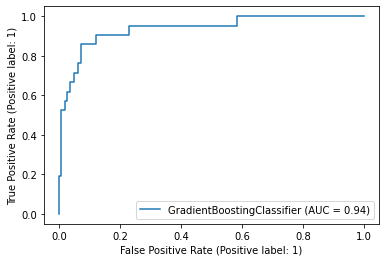

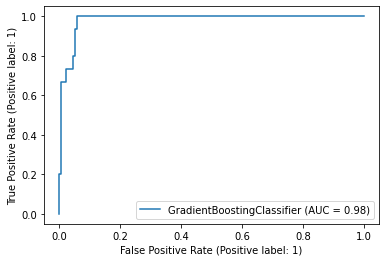

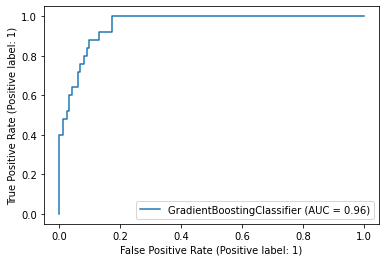

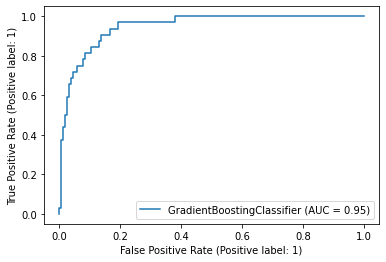

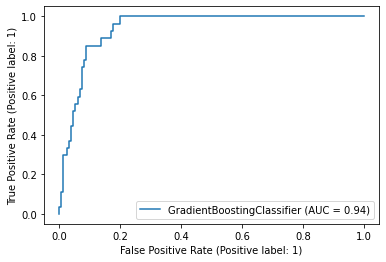

...

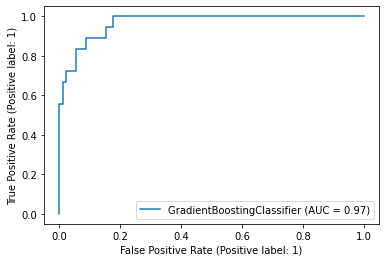

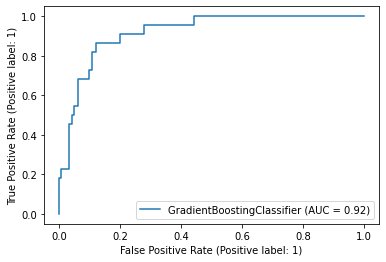

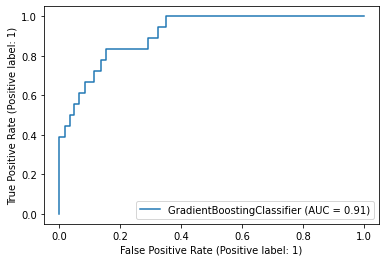

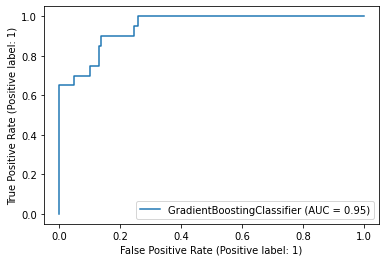

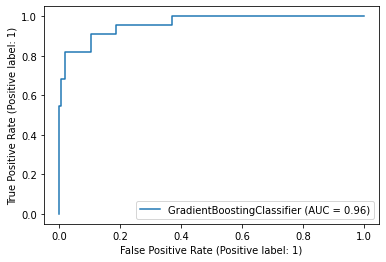

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_gb = GradientBoostingClassifier(n_estimators = 1000) 
    tic = time.time()
    model_gb.fit(X_train, y_train) 
    toc = time.time()
    print("Gradient Boost Train time = " + str(toc-tic))
    print("Gradient Boost Accuracy = "+ str(model_gb.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_gb.predict(X_test)
    yhat_classes = (model_gb.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Gradient Boost Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Gradient Boost Stats _____________________")

    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    CM = confusion_matrix(y_test, yhat_classes)
    print(CM)
    TN = CM[0][0]
    FN = CM[1][0]
    TP = CM[1][1]
    FP = CM[0][1]
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)

    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)
    # ROC AUC
    auc = roc_auc_score(y_test, yhat_probs)
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    #AUC
    from sklearn.metrics import plot_roc_curve
    plot_roc_curve(model_gb, X_test, y_test)

    print("____________________________________________________________")
    print("____________________________________________________________")

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
GBWithoutSMOTE = pd.DataFrame(data, columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([GBWithoutSMOTE.mean(axis=0).values],  columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User Left Out  Accuracy   ROC_AUC  ...     TN        FP         FN
Average           15.5  0.913725  0.748522  ...  159.2  5.866667  10.266667

[1 rows x 11 columns]


In [ ]:
GBWithoutSMOTE = GBWithoutSMOTE.append(df_temp)

In [ ]:
print(GBWithoutSMOTE)
GBWithoutSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/GBWithoutSMOTE.csv', index = True)

         User Left Out  Accuracy   ROC_AUC  ...     TN         FP         FN
0                  1.0  0.925134  0.812249  ...  159.0   7.000000   7.000000
1                  2.0  0.946524  0.970930  ...  162.0  10.000000   0.000000
2                  3.0  0.903743  0.826049  ...  151.0  11.000000   7.000000
3                  4.0  0.898396  0.740323  ...  152.0   3.000000  16.000000
4                  5.0  0.903743  0.882176  ...  146.0  14.000000   4.000000
5                  6.0  0.925134  0.748277  ...  163.0   5.000000   9.000000
6                  7.0  0.935829  0.832582  ...  159.0   5.000000   7.000000
7                  8.0  0.898396  0.651606  ...  161.0   5.000000  14.000000
8                  9.0  0.919786  0.784568  ...  157.0   5.000000  10.000000
9                 10.0  0.919786  0.651942  ...  166.0   2.000000  13.000000
10                11.0  0.909091  0.613636  ...  165.0   0.000000  17.000000
11                12.0  0.941176  0.694444  ...  169.0   0.000000  11.000000

###3 DNN

#### Model

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
print(X_train.shape[1])

20


Epoch 1/100
77/77 [==============================] - 1s 4ms/step - loss: 0.4734 - accuracy: 0.8342 - val_loss: 0.2652 - val_accuracy: 0.8950 - lr: 0.0010
Epoch 2/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3814 - accuracy: 0.8773 - val_loss: 0.2534 - val_accuracy: 0.9098 - lr: 0.0010
Epoch 3/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3537 - accuracy: 0.8846 - val_loss: 0.2533 - val_accuracy: 0.9116 - lr: 0.0010
Epoch 4/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3301 - accuracy: 0.8877 - val_loss: 0.2447 - val_accuracy: 0.9116 - lr: 0.0010
Epoch 5/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3000 - accuracy: 0.8941 - val_loss: 0.2480 - val_accuracy: 0.9116 - lr: 0.0010
Epoch 6/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2889 - accuracy: 0.8908 - val_loss: 0.2331 - val_accuracy: 0.9208 - lr: 0.0010
Epoch 7/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


77/77 [==============================] - 1s 7ms/step - loss: 0.5357 - accuracy: 0.8189 - val_loss: 0.3359 - val_accuracy: 0.8858 - lr: 0.0010
Epoch 2/100
77/77 [==============================] - 0s 4ms/step - loss: 0.4275 - accuracy: 0.8744 - val_loss: 0.2715 - val_accuracy: 0.8895 - lr: 0.0010
Epoch 3/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3730 - accuracy: 0.8834 - val_loss: 0.2506 - val_accuracy: 0.8913 - lr: 0.0010
Epoch 4/100
77/77 [==============================] - 0s 4ms/step - loss: 0.3328 - accuracy: 0.8875 - val_loss: 0.2418 - val_accuracy: 0.9190 - lr: 0.0010
Epoch 5/100
77/77 [==============================] - 0s 4ms/step - loss: 0.3102 - accuracy: 0.8936 - val_loss: 0.2375 - val_accuracy: 0.9227 - lr: 0.0010
Epoch 6/100
77/77 [==============================] - 0s 4ms/step - loss: 0.2855 - accuracy: 0.8992 - val_loss: 0.2418 - val_accuracy: 0.9190 - lr: 0.0010
Epoch 7/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2784 - accura

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


77/77 [==============================] - 1s 5ms/step - loss: 0.5936 - accuracy: 0.7984 - val_loss: 0.3512 - val_accuracy: 0.9024 - lr: 0.0010
Epoch 2/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3945 - accuracy: 0.8752 - val_loss: 0.2869 - val_accuracy: 0.9079 - lr: 0.0010
Epoch 3/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3572 - accuracy: 0.8832 - val_loss: 0.2412 - val_accuracy: 0.8987 - lr: 0.0010
Epoch 4/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3289 - accuracy: 0.8822 - val_loss: 0.2565 - val_accuracy: 0.8913 - lr: 0.0010
Epoch 5/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3089 - accuracy: 0.8867 - val_loss: 0.2400 - val_accuracy: 0.9042 - lr: 0.0010
Epoch 6/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2877 - accuracy: 0.8928 - val_loss: 0.2356 - val_accuracy: 0.9153 - lr: 0.0010
Epoch 7/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2904 - accura

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


77/77 [==============================] - 1s 5ms/step - loss: 0.5047 - accuracy: 0.8398 - val_loss: 0.3349 - val_accuracy: 0.8821 - lr: 0.0010
Epoch 2/100
77/77 [==============================] - 0s 3ms/step - loss: 0.4005 - accuracy: 0.8760 - val_loss: 0.2653 - val_accuracy: 0.9098 - lr: 0.0010
Epoch 3/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3387 - accuracy: 0.8846 - val_loss: 0.2538 - val_accuracy: 0.9061 - lr: 0.0010
Epoch 4/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3125 - accuracy: 0.8871 - val_loss: 0.2501 - val_accuracy: 0.9116 - lr: 0.0010
Epoch 5/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2911 - accuracy: 0.8955 - val_loss: 0.2436 - val_accuracy: 0.9153 - lr: 0.0010
Epoch 6/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2797 - accuracy: 0.8982 - val_loss: 0.2414 - val_accuracy: 0.9171 - lr: 0.0010
Epoch 7/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2683 - accura

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


77/77 [==============================] - 1s 5ms/step - loss: 0.5375 - accuracy: 0.8486 - val_loss: 0.2825 - val_accuracy: 0.8821 - lr: 0.0010
Epoch 2/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3917 - accuracy: 0.8754 - val_loss: 0.2714 - val_accuracy: 0.8821 - lr: 0.0010
Epoch 3/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3299 - accuracy: 0.8820 - val_loss: 0.2718 - val_accuracy: 0.8821 - lr: 0.0010
Epoch 4/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3124 - accuracy: 0.8828 - val_loss: 0.2711 - val_accuracy: 0.8821 - lr: 0.0010
Epoch 5/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2943 - accuracy: 0.8863 - val_loss: 0.2823 - val_accuracy: 0.8877 - lr: 0.0010
Epoch 6/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2797 - accuracy: 0.8902 - val_loss: 0.2700 - val_accuracy: 0.8895 - lr: 0.0010
Epoch 7/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2711 - accura

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


77/77 [==============================] - 1s 5ms/step - loss: 0.5946 - accuracy: 0.8355 - val_loss: 0.4331 - val_accuracy: 0.8858 - lr: 0.0010
Epoch 2/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3874 - accuracy: 0.8822 - val_loss: 0.2791 - val_accuracy: 0.8895 - lr: 0.0010
Epoch 3/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3544 - accuracy: 0.8908 - val_loss: 0.2645 - val_accuracy: 0.9098 - lr: 0.0010
Epoch 4/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3140 - accuracy: 0.8934 - val_loss: 0.2539 - val_accuracy: 0.9116 - lr: 0.0010
Epoch 5/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2878 - accuracy: 0.8959 - val_loss: 0.2571 - val_accuracy: 0.9079 - lr: 0.0010
Epoch 6/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2963 - accuracy: 0.8953 - val_loss: 0.2425 - val_accuracy: 0.9134 - lr: 0.0010
Epoch 7/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2773 - accura

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


77/77 [==============================] - 1s 4ms/step - loss: 0.4589 - accuracy: 0.8363 - val_loss: 0.2730 - val_accuracy: 0.8858 - lr: 0.0010
Epoch 2/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3532 - accuracy: 0.8748 - val_loss: 0.2666 - val_accuracy: 0.8858 - lr: 0.0010
Epoch 3/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3248 - accuracy: 0.8797 - val_loss: 0.2523 - val_accuracy: 0.8858 - lr: 0.0010
Epoch 4/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3079 - accuracy: 0.8811 - val_loss: 0.2594 - val_accuracy: 0.8858 - lr: 0.0010
Epoch 5/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2813 - accuracy: 0.8834 - val_loss: 0.2595 - val_accuracy: 0.8858 - lr: 0.0010
Epoch 6/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2722 - accuracy: 0.8846 - val_loss: 0.2545 - val_accuracy: 0.8877 - lr: 0.0010
Epoch 7/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2693 - accura

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


77/77 [==============================] - 1s 5ms/step - loss: 0.4726 - accuracy: 0.8777 - val_loss: 0.2967 - val_accuracy: 0.8840 - lr: 0.0010
Epoch 2/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3658 - accuracy: 0.8785 - val_loss: 0.2594 - val_accuracy: 0.8858 - lr: 0.0010
Epoch 3/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3307 - accuracy: 0.8824 - val_loss: 0.2459 - val_accuracy: 0.8858 - lr: 0.0010
Epoch 4/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3185 - accuracy: 0.8820 - val_loss: 0.2347 - val_accuracy: 0.8877 - lr: 0.0010
Epoch 5/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2935 - accuracy: 0.8840 - val_loss: 0.2292 - val_accuracy: 0.8877 - lr: 0.0010
Epoch 6/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2855 - accuracy: 0.8824 - val_loss: 0.2295 - val_accuracy: 0.8877 - lr: 0.0010
Epoch 7/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2799 - accura

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


77/77 [==============================] - 1s 5ms/step - loss: 0.5920 - accuracy: 0.7840 - val_loss: 0.3136 - val_accuracy: 0.8858 - lr: 0.0010
Epoch 2/100
77/77 [==============================] - 0s 3ms/step - loss: 0.4034 - accuracy: 0.8586 - val_loss: 0.2656 - val_accuracy: 0.8858 - lr: 0.0010
Epoch 3/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3710 - accuracy: 0.8725 - val_loss: 0.2504 - val_accuracy: 0.8895 - lr: 0.0010
Epoch 4/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3394 - accuracy: 0.8779 - val_loss: 0.2537 - val_accuracy: 0.9006 - lr: 0.0010
Epoch 5/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3021 - accuracy: 0.8898 - val_loss: 0.2460 - val_accuracy: 0.9079 - lr: 0.0010
Epoch 6/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2946 - accuracy: 0.8930 - val_loss: 0.2462 - val_accuracy: 0.9098 - lr: 0.0010
Epoch 7/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2811 - accura

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


77/77 [==============================] - 1s 5ms/step - loss: 0.5399 - accuracy: 0.8123 - val_loss: 0.3340 - val_accuracy: 0.8840 - lr: 0.0010
Epoch 2/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3812 - accuracy: 0.8783 - val_loss: 0.2757 - val_accuracy: 0.8840 - lr: 0.0010
Epoch 3/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3419 - accuracy: 0.8824 - val_loss: 0.2507 - val_accuracy: 0.8840 - lr: 0.0010
Epoch 4/100
77/77 [==============================] - 0s 3ms/step - loss: 0.3140 - accuracy: 0.8830 - val_loss: 0.2496 - val_accuracy: 0.8840 - lr: 0.0010
Epoch 5/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2927 - accuracy: 0.8842 - val_loss: 0.2519 - val_accuracy: 0.8913 - lr: 0.0010
Epoch 6/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2808 - accuracy: 0.8928 - val_loss: 0.2476 - val_accuracy: 0.9153 - lr: 0.0010
Epoch 7/100
77/77 [==============================] - 0s 3ms/step - loss: 0.2709 - accura

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


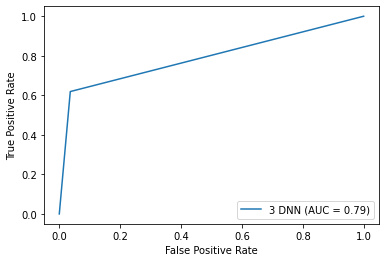

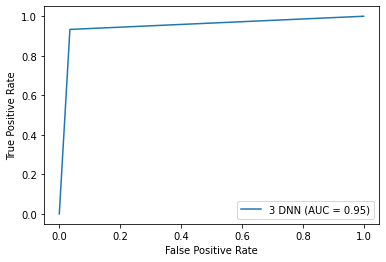

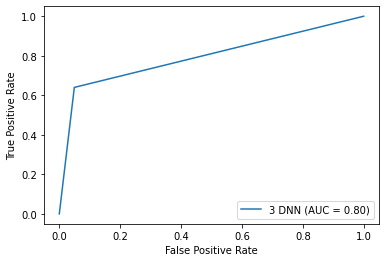

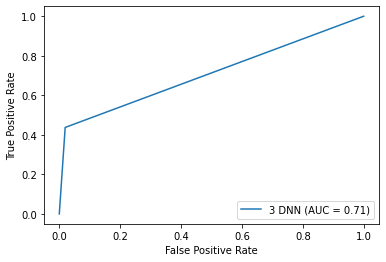

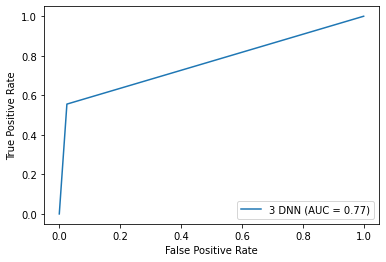

...

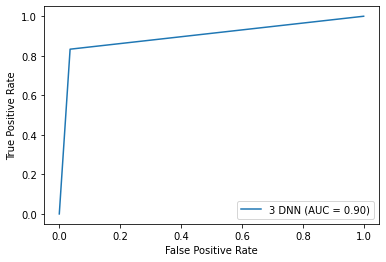

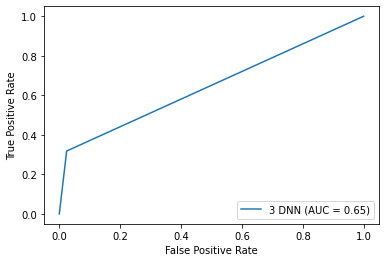

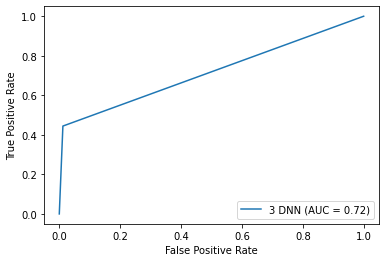

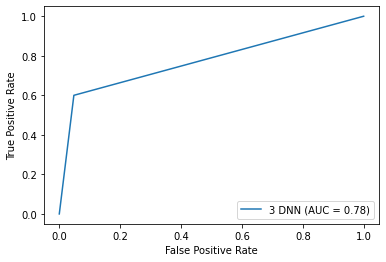

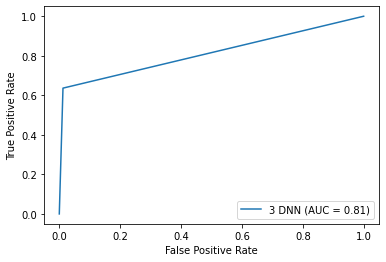

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    X_train = np.asarray(X_train).astype('float32')
    y_train = np.asarray(y_train).astype('float32')
    X_test = np.asarray(X_test).astype('float32')
    y_test = np.asarray(y_test).astype('float32')
    model3 = Sequential()

    model3.add(Dense(64, activation='relu', input_shape=(X_train.shape[1],)))
    model3.add(Dropout(0.3))
    model3.add(Dense(32, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(8, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(1, activation='sigmoid'))

    model3.compile(loss='binary_crossentropy',
                  optimizer='adam',
                  metrics=['accuracy'])
    reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=0.001)
    tic = time.time()
    model3.fit(X_train, y_train, batch_size=64, epochs=100, validation_split=0.1, callbacks=[reduce_lr])
    toc = time.time()
    print("3 DNN Train time = " + str(toc-tic))
    print("3 DNN Accuracy = "+ str(model3.evaluate(X_test, y_test, verbose=0)[1]))
    tic = time.time()
    yhat_probs = model3.predict(X_test, verbose=0)
    yhat_classes = (model3.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("3 DNN Test time = " + str(toc-tic))
    yhat_probs = yhat_probs[:, 0]
    yhat_classes = yhat_classes[:, 0]
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________3 DNN Stats _____________________")

    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    CM = confusion_matrix(y_test, yhat_classes)
    print(CM)
    TN = CM[0][0]
    FN = CM[1][0]
    TP = CM[1][1]
    FP = CM[0][1]
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    auc = roc_auc_score(y_test, yhat_probs)
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    #AUC
    from sklearn import metrics
    fpr, tpr, thresholds = metrics.roc_curve(y_test, yhat_classes)
    roc_auc = metrics.auc(fpr, tpr)
    display = metrics.RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc, estimator_name='3 DNN')
    display.plot()  

    print("____________________________________________________________")
    print("____________________________________________________________")

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

In [ ]:
DNN3WithoutSMOTE = pd.DataFrame(data, columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DNN3WithoutSMOTE.mean(axis=0).values],  columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

In [ ]:
DNN3WithoutSMOTE = DNN3WithoutSMOTE.append(df_temp)

In [ ]:
print(DNN3WithoutSMOTE)
DNN3WithoutSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/DNN3WithoutSMOTE.csv', index = True)

# With SMOTE last N


## Data Processing

### Import dataset

In [ ]:
directory_all = "/content/drive/MyDrive/Surjya Sir Work/5000"
directory_pbd = "/content/drive/MyDrive/Surjya Sir Work/5000_probed"

In [ ]:
# videos = [1,2,3,4,5,6,7,8]
videos = [1,2,3,4,7,8]

In [ ]:
all = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_all + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    all.append(windows_5000_per_subject)

In [ ]:
probed = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_pbd + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    probed.append(windows_5000_per_subject)

### Create df

In [ ]:
df = pd.DataFrame()
for i in range(len(all)):#per video = 8
  for j in range(len(all[i])): #per subject = 30
    df = df.append(all[i][j], ignore_index=True)

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8
5606,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8
5607,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8
5608,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8


In [ ]:
tester = pd.DataFrame()
for i in range(len(probed)):#per video = 8
  for j in range(len(probed[i])): #per subject = 30
    tester = tester.append(probed[i][j], ignore_index=True)

In [ ]:
tester

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1738876.01,1743876.01,1748876.01,6.309,5.096,0.013,0.106,5.632759,0.600,0.378,0.155,0.010,0.369,1.642,8.131,10,1
1,832168.01,837168.01,842168.01,6.488,5.290,0.012,0.159,1.883567,0.300,3.623,0.126,0.021,0.657,0.246,0.000,11,1
2,907168.01,912168.01,917168.01,5.330,4.958,0.394,0.082,3.340205,0.103,3.119,0.136,0.004,7.022,0.699,0.123,11,1
3,917168.01,922168.01,927168.01,6.046,5.011,0.767,0.003,2.078420,0.213,0.785,0.136,0.007,4.846,0.041,0.040,11,1
4,922168.01,927168.01,932168.01,6.476,5.014,0.430,0.022,2.208317,0.307,4.601,0.068,0.010,4.148,1.191,0.288,11,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
653,2282834.01,2287834.01,2292834.01,2.090,7.542,0.918,0.586,3.800016,3.170,4.349,0.261,0.003,0.082,2.916,1.602,8,8
654,2287834.01,2292834.01,2297834.01,1.199,8.115,1.181,0.661,5.052202,4.889,8.049,1.549,0.039,0.164,1.315,2.587,8,8
655,1166459.01,1171459.01,1176459.01,3.156,6.595,0.518,0.543,4.114055,0.256,0.368,4.792,0.011,2.998,3.368,13.429,9,8
656,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8


In [ ]:
temp = df[df.isin(tester)].dropna()

In [ ]:
temp = df.loc[df.set_index(list(df.columns)).index.isin(tester.set_index(list(tester.columns)).index)]

In [ ]:
temp.index

Int64Index([  35,   47,   62,   64,   65,   70,   99,  107,  117,  118,
            ...
            5511, 5532, 5551, 5554, 5559, 5575, 5576, 5604, 5605, 5606],
           dtype='int64', length=658)

In [ ]:
df['Probe'] = 0

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,0
5606,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,0
5607,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
5608,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
for idx in temp.index:
  df.at[idx, 'Probe'] = 1

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
5606,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
5607,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
5608,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


### Optimise df

In [ ]:
df = df.drop(columns=["Start", "Border", "End"], axis=1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
5606,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
5607,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
5608,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
df['valence_acc_video'] = 0
df['arousal_acc_video'] = 0

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,0,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,0,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,0,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,0,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,0
5606,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,0
5607,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,0
5608,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,0


I'm using the following encoding: 

1 - Low
2 - Mid/high
3 - High

In [ ]:
# def basedOnVideoValence(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 2
#     if int(video) == 6:
#         return 2
#     if int(video) == 7:
#         return 1
#     if int(video) == 8:
#         return 1
    
# def basedOnVideoArousal(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 1
#     if int(video) == 6:
#         return 1
#     if int(video) == 7:
#         return 3
#     if int(video) == 8:
#         return 3

New encoding, 
Low - 0 
Med / High - 1

In [ ]:
def basedOnVideoValence(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 1
    if int(video) == 6:
        return 1
    if int(video) == 7:
        return 0
    if int(video) == 8:
        return 0
    
def basedOnVideoArousal(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 0
    if int(video) == 6:
        return 0
    if int(video) == 7:
        return 1
    if int(video) == 8:
        return 1

In [ ]:
df['valence_acc_video'] = df.apply(lambda row : basedOnVideoValence(row['video']), axis = 1)
df['arousal_acc_video'] = df.apply(lambda row : basedOnVideoArousal(row['video']), axis = 1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1
5606,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1
5607,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1
5608,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1


### Last N

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1
5606,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1
5607,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1
5608,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1


In [ ]:
df['last1'] = np.where(df['Probe'].shift(1) == 1,1,0)
df['last2'] = np.where(df['Probe'].shift(2) == 1,1,0)
df['last3'] = np.where(df['Probe'].shift(3) == 1,1,0)
df['last4'] = np.where(df['Probe'].shift(4) == 1,1,0)
df['last5'] = np.where(df['Probe'].shift(5) == 1,1,0)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video,last1,last2,last3,last4,last5
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1,0,0,0,0,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1,0,0,0,0,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1,0,0,0,0,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1,0,0,0,0,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1,1,0,0,0,0
5606,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1,1,1,0,0,0
5607,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1,1,1,1,0,0
5608,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1,0,1,1,1,0


In [ ]:
# df['Last1'] = 0
# df['Last2'] = 0
# df['Last3'] = 0
# df['Last4'] = 0
# df['Last5'] = 0

df['Last1'] = df.apply(lambda row: (row.last1)/1, axis=1)
df['Last2'] = df.apply(lambda row: (row.last1 + row.last2)/2, axis=1)
df['Last3'] = df.apply(lambda row: (row.last1 + row.last2 + row.last3)/3, axis=1)
df['Last4'] = df.apply(lambda row: (row.last1 + row.last2 + row.last3 + row.last4)/4, axis=1)
df['Last5'] = df.apply(lambda row: (row.last1 + row.last2 + row.last3 + row.last4 + row.last5)/5, axis=1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video,last1,last2,last3,last4,last5,Last1,Last2,Last3,Last4,Last5
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1,0,0,0,0,0,0.0,0.0,0.000000,0.00,0.0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1,0,0,0,0,0,0.0,0.0,0.000000,0.00,0.0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1,0,0,0,0,0,0.0,0.0,0.000000,0.00,0.0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1,0,0,0,0,0,0.0,0.0,0.000000,0.00,0.0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1,0,0,0,0,0,0.0,0.0,0.000000,0.00,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1,1,0,0,0,0,1.0,0.5,0.333333,0.25,0.2
5606,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1,1,1,0,0,0,1.0,1.0,0.666667,0.50,0.4
5607,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1,1,1,1,0,0,1.0,1.0,1.000000,0.75,0.6
5608,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1,0,1,1,1,0,0.0,0.5,0.666667,0.75,0.6


In [ ]:
df = df.drop(columns=["last1", "last2", "last3", "last4", "last5"], axis = 1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video,Last1,Last2,Last3,Last4,Last5
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1,0.0,0.0,0.000000,0.00,0.0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1,0.0,0.0,0.000000,0.00,0.0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1,0.0,0.0,0.000000,0.00,0.0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1,0.0,0.0,0.000000,0.00,0.0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1,0.0,0.0,0.000000,0.00,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5605,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1,1.0,0.5,0.333333,0.25,0.2
5606,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1,1.0,1.0,0.666667,0.50,0.4
5607,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1,1.0,1.0,1.000000,0.75,0.6
5608,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1,0.0,0.5,0.666667,0.75,0.6


### Create X,y

In [ ]:
#df

In [ ]:
# X_train = pd.DataFrame()
# y_train = pd.DataFrame()
# X_test = pd.DataFrame()
# y_test = pd.DataFrame()

In [ ]:
# for video in videos:
#     df_selected = df[df['video'] == video]
#     y = df_selected['Probe']
#     y = pd.DataFrame(y)
#     X = df_selected.drop(columns=["Probe"], axis = 1)
#     X_train_new, X_test_new, y_train_new, y_test_new = train_test_split(X, y, test_size=0.2, random_state=42)
#     X_train = X_train.append(X_train_new, ignore_index=True)
#     y_train = y_train.append(y_train_new, ignore_index=True)
#     X_test = X_test.append(X_test_new, ignore_index=True)
#     y_test = y_test.append(y_test_new, ignore_index=True)

In [ ]:
# X_train

In [ ]:
# y_test

In [ ]:
# X_train = X_train.drop(columns=['video', 'subject'])
# X_test = X_test.drop(columns=['video', 'subject'])

In [ ]:
# X_train

### X,y using leave 1 use rest

In [ ]:
X_train_all = []
y_train_all = []
X_test_all = []
y_test_all = []

In [ ]:
users = []
for i in range(1, 31):
  users.append(i)

print(users)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30]


In [ ]:
for testuser in users:
  X_train = pd.DataFrame()
  y_train = pd.DataFrame()
  X_test = pd.DataFrame()
  y_test = pd.DataFrame()
  df_new = df[df['subject'] != str(testuser)]
  for video in videos:
    df_selected = df_new[df_new['video'] == video]
    y = df_selected['Probe']
    y = pd.DataFrame(y)
    X = df_selected.drop(columns=["Probe"], axis = 1)
    X_train = X_train.append(X, ignore_index=True)
    y_train = y_train.append(y, ignore_index=True)
  df_new = df[df['subject'] == str(testuser)]
  # print(df_new)
  for video in videos:
    df_selected = df_new[df_new['video'] == video]
    y = df_selected['Probe']
    y = pd.DataFrame(y)
    X = df_selected.drop(columns=["Probe"], axis = 1)
    X_test = X_test.append(X, ignore_index=True)
    y_test = y_test.append(y, ignore_index=True)  
  X_train_all.append(X_train)
  y_train_all.append(y_train)
  X_test_all.append(X_test)
  y_test_all.append(y_test)

In [ ]:
print(len(X_train_all[29]['subject'].unique()))

29


In [ ]:
new_X_train_all = []

for i in range(len(X_train_all)):
    df_temp = X_train_all[i]
    #df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    df_temp = df_temp.drop(columns=["subject"], axis = 1)
    new_X_train_all.append(df_temp)

X_train_all = new_X_train_all

new_X_test_all = []

for i in range(len(X_test_all)):
    df_temp = X_test_all[i]
    #df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    df_temp = df_temp.drop(columns=["subject"], axis = 1)
    new_X_test_all.append(df_temp)

X_test_all = new_X_test_all

In [ ]:
y_test_all[7]

,Probe
0,0
1,0
2,0
3,0
4,0
...,...
182,0
183,0
184,0
185,0


### SMOTE

In [ ]:
print(X_train_all[0])

      Valence  Arousal  Valence Diff  ...     Last3  Last4  Last5
0       5.000    5.000         0.000  ...  0.000000   0.00    0.0
1       5.000    5.209         0.176  ...  0.000000   0.00    0.0
2       4.824    6.102         0.130  ...  0.000000   0.00    0.0
3       4.870    6.170         0.046  ...  0.000000   0.00    0.0
4       4.870    6.170         0.000  ...  0.000000   0.00    0.0
...       ...      ...           ...  ...       ...    ...    ...
5418    2.857    7.183         0.225  ...  0.333333   0.25    0.2
5419    2.931    7.571         0.008  ...  0.666667   0.50    0.4
5420    2.849    6.989         0.263  ...  1.000000   0.75    0.6
5421    2.668    6.732         0.308  ...  0.666667   0.75    0.6
5422    2.541    7.043         0.235  ...  0.333333   0.50    0.6

[5423 rows x 20 columns]


In [ ]:
from imblearn.over_sampling import SMOTE
new_X_train_all = []
new_y_train_all = []

for i in range(len(X_train_all)):
  X_resampled, y_resampled = SMOTE('auto').fit_resample(X_train_all[i], y_train_all[i])
  new_X_train_all.append(X_resampled)
  new_y_train_all.append(y_resampled)

X_train_all = new_X_train_all
y_train_all = new_y_train_all

# new_X_test_all = []
# new_y_test_all = []

# for i in range(len(X_train_all)):
#   X_resampled, y_resampled = SMOTE('minority').fit_resample(X_test_all[i], y_test_all[i])
#   new_X_test_all.append(X_resampled)
#   new_y_test_all.append(y_resampled)

# X_test_all = new_X_test_all
# y_test_all = new_y_test_all

/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: Future

In [ ]:
print(X_train_all[0])

       Valence   Arousal  Valence Diff  ...     Last3     Last4     Last5
0     5.000000  5.000000      0.000000  ...  0.000000  0.000000  0.000000
1     5.000000  5.209000      0.176000  ...  0.000000  0.000000  0.000000
2     4.824000  6.102000      0.130000  ...  0.000000  0.000000  0.000000
3     4.870000  6.170000      0.046000  ...  0.000000  0.000000  0.000000
4     4.870000  6.170000      0.000000  ...  0.000000  0.000000  0.000000
...        ...       ...           ...  ...       ...       ...       ...
9567  5.774286  5.236483      1.181283  ...  0.423012  0.384518  0.453807
9568  7.408263  6.953173      0.254905  ...  0.000000  0.000000  0.053814
9569  5.468319  5.030763      1.071150  ...  0.000000  0.000000  0.000000
9570  5.975126  4.921079      0.048945  ...  0.000000  0.000000  0.000000
9571  5.000000  5.000022      0.000000  ...  0.333333  0.250000  0.200000

[9572 rows x 20 columns]


### Condensed Nearest Neighbours

In [ ]:
print(X_train_all[0])

       Valence   Arousal  Valence Diff  ...     Last3     Last4     Last5
0     5.000000  5.000000      0.000000  ...  0.000000  0.000000  0.000000
1     5.000000  5.209000      0.176000  ...  0.000000  0.000000  0.000000
2     4.824000  6.102000      0.130000  ...  0.000000  0.000000  0.000000
3     4.870000  6.170000      0.046000  ...  0.000000  0.000000  0.000000
4     4.870000  6.170000      0.000000  ...  0.000000  0.000000  0.000000
...        ...       ...           ...  ...       ...       ...       ...
9567  5.774286  5.236483      1.181283  ...  0.423012  0.384518  0.453807
9568  7.408263  6.953173      0.254905  ...  0.000000  0.000000  0.053814
9569  5.468319  5.030763      1.071150  ...  0.000000  0.000000  0.000000
9570  5.975126  4.921079      0.048945  ...  0.000000  0.000000  0.000000
9571  5.000000  5.000022      0.000000  ...  0.333333  0.250000  0.200000

[9572 rows x 20 columns]


In [ ]:
# from imblearn.under_sampling import CondensedNearestNeighbour
# new_X_train_all = []
# new_y_train_all = []

# for i in range(len(X_train_all)):
#   X_resampled, y_resampled = CondensedNearestNeighbour('auto').fit_resample(X_train_all[i], y_train_all[i])
#   new_X_train_all.append(X_resampled)
#   new_y_train_all.append(y_resampled)

# X_train_all = new_X_train_all
# y_train_all = new_y_train_all


In [ ]:
print(X_train_all[0])

       Valence   Arousal  Valence Diff  ...     Last3     Last4     Last5
0     5.000000  5.000000      0.000000  ...  0.000000  0.000000  0.000000
1     5.000000  5.209000      0.176000  ...  0.000000  0.000000  0.000000
2     4.824000  6.102000      0.130000  ...  0.000000  0.000000  0.000000
3     4.870000  6.170000      0.046000  ...  0.000000  0.000000  0.000000
4     4.870000  6.170000      0.000000  ...  0.000000  0.000000  0.000000
...        ...       ...           ...  ...       ...       ...       ...
9567  5.774286  5.236483      1.181283  ...  0.423012  0.384518  0.453807
9568  7.408263  6.953173      0.254905  ...  0.000000  0.000000  0.053814
9569  5.468319  5.030763      1.071150  ...  0.000000  0.000000  0.000000
9570  5.975126  4.921079      0.048945  ...  0.000000  0.000000  0.000000
9571  5.000000  5.000022      0.000000  ...  0.333333  0.250000  0.200000

[9572 rows x 20 columns]


## Models

###RandomForest

#### Model

In [ ]:
from sklearn.ensemble import RandomForestClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []

TPs = []
FPs = []
FNs = []
TNs = []

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.0175180435180664
Random Forest Accuracy = 0.9251336898395722
Random Forest Test time = 0.03694272041320801
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.925134
[[161   5]
 [  9  12]]
True negatives: 161
True positives: 12
False positives: 5
False negatives: 9
ROC AUC: 0.770654
F1 Score: 0.631579
Precision: 0.705882
TPR: 0.571429
FPR: 0.030120
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.0035622119903564
Random Forest Accuracy = 0.946524064171123
Random Forest Test time = 0.03683876991271973
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.946524
[[163   9]
 [  1  14]]
True negatives: 163
True positives: 14
False positives: 9
False negatives: 1
ROC AUC: 0.940504
F1 Score: 0.736842
Precision: 0.608696
TPR: 0.933333
FPR: 0.052326
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.001910448074341
Random Forest Accuracy = 0.9144385026737968
Random Forest Test time = 0.03779792785644531
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.914439
[[151  11]
 [  5  20]]
True negatives: 151
True positives: 20
False positives: 11
False negatives: 5
ROC AUC: 0.866049
F1 Score: 0.714286
Precision: 0.645161
TPR: 0.800000
FPR: 0.067901
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.9874513149261475
Random Forest Accuracy = 0.9358288770053476
Random Forest Test time = 0.038092851638793945
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.935829
[[151   4]
 [  8  24]]
True negatives: 151
True positives: 24
False positives: 4
False negatives: 8
ROC AUC: 0.862097
F1 Score: 0.800000
Precision: 0.857143
TPR: 0.750000
FPR: 0.025806
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.014051914215088
Random Forest Accuracy = 0.8877005347593583
Random Forest Test time = 0.038173675537109375
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.887701
[[149  11]
 [ 10  17]]
True negatives: 149
True positives: 17
False positives: 11
False negatives: 10
ROC AUC: 0.780440
F1 Score: 0.618182
Precision: 0.607143
TPR: 0.629630
FPR: 0.068750
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.0461039543151855
Random Forest Accuracy = 0.9037433155080213
Random Forest Test time = 0.039723873138427734
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.903743
[[159   9]
 [  9  10]]
True negatives: 159
True positives: 10
False positives: 9
False negatives: 9
ROC AUC: 0.736372
F1 Score: 0.526316
Precision: 0.526316
TPR: 0.526316
FPR: 0.053571
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.9721801280975342
Random Forest Accuracy = 0.8877005347593583
Random Forest Test time = 0.04036211967468262
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.887701
[[147  17]
 [  4  19]]
True negatives: 147
True positives: 19
False positives: 17
False negatives: 4
ROC AUC: 0.861214
F1 Score: 0.644068
Precision: 0.527778
TPR: 0.826087
FPR: 0.103659
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.9900870323181152
Random Forest Accuracy = 0.9197860962566845
Random Forest Test time = 0.03731536865234375
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.919786
[[159   7]
 [  8  13]]
True negatives: 159
True positives: 13
False positives: 7
False negatives: 8
ROC AUC: 0.788439
F1 Score: 0.634146
Precision: 0.650000
TPR: 0.619048
FPR: 0.042169
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.011929750442505
Random Forest Accuracy = 0.93048128342246
Random Forest Test time = 0.03754830360412598
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.930481
[[156   6]
 [  7  18]]
True negatives: 156
True positives: 18
False positives: 6
False negatives: 7
ROC AUC: 0.841481
F1 Score: 0.734694
Precision: 0.750000
TPR: 0.720000
FPR: 0.037037
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.019801378250122
Random Forest Accuracy = 0.93048128342246
Random Forest Test time = 0.03678703308105469
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.930481
[[166   2]
 [ 11   8]]
True negatives: 166
True positives: 8
False positives: 2
False negatives: 11
ROC AUC: 0.704574
F1 Score: 0.551724
Precision: 0.800000
TPR: 0.421053
FPR: 0.011905
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.9733660221099854
Random Forest Accuracy = 0.8983957219251337
Random Forest Test time = 0.037116050720214844
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.898396
[[163   2]
 [ 17   5]]
True negatives: 163
True positives: 5
False positives: 2
False negatives: 17
ROC AUC: 0.607576
F1 Score: 0.344828
Precision: 0.714286
TPR: 0.227273
FPR: 0.012121
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.9929258823394775
Random Forest Accuracy = 0.9411764705882353
Random Forest Test time = 0.037828922271728516
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.941176
[[169   0]
 [ 11   7]]
True negatives: 169
True positives: 7
False positives: 0
False negatives: 11
ROC AUC: 0.694444
F1 Score: 0.560000
Precision: 1.000000
TPR: 0.388889
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.0050950050354004
Random Forest Accuracy = 0.8877005347593583
Random Forest Test time = 0.03705954551696777
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.887701
[[151  14]
 [  7  15]]
True negatives: 151
True positives: 15
False positives: 14
False negatives: 7
ROC AUC: 0.798485
F1 Score: 0.588235
Precision: 0.517241
TPR: 0.681818
FPR: 0.084848
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.9547369480133057
Random Forest Accuracy = 0.9197860962566845
Random Forest Test time = 0.037470102310180664
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.919786
[[159  10]
 [  5  13]]
True negatives: 159
True positives: 13
False positives: 10
False negatives: 5
ROC AUC: 0.831525
F1 Score: 0.634146
Precision: 0.565217
TPR: 0.722222
FPR: 0.059172
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.016199827194214
Random Forest Accuracy = 0.9037433155080213
Random Forest Test time = 0.03741288185119629
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.903743
[[151  13]
 [  5  18]]
True negatives: 151
True positives: 18
False positives: 13
False negatives: 5
ROC AUC: 0.851670
F1 Score: 0.666667
Precision: 0.580645
TPR: 0.782609
FPR: 0.079268
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.9834470748901367
Random Forest Accuracy = 0.9251336898395722
Random Forest Test time = 0.03526782989501953
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.925134
[[166   1]
 [ 13   7]]
True negatives: 166
True positives: 7
False positives: 1
False negatives: 13
ROC AUC: 0.672006
F1 Score: 0.500000
Precision: 0.875000
TPR: 0.350000
FPR: 0.005988
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.014756679534912
Random Forest Accuracy = 0.9090909090909091
Random Forest Test time = 0.03464555740356445
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.909091
[[163   2]
 [ 15   7]]
True negatives: 163
True positives: 7
False positives: 2
False negatives: 15
ROC AUC: 0.653030
F1 Score: 0.451613
Precision: 0.777778
TPR: 0.318182
FPR: 0.012121
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.9907491207122803
Random Forest Accuracy = 0.9518716577540107
Random Forest Test time = 0.035558223724365234
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.951872
[[169   2]
 [  7   9]]
True negatives: 169
True positives: 9
False positives: 2
False negatives: 7
ROC AUC: 0.775402
F1 Score: 0.666667
Precision: 0.818182
TPR: 0.562500
FPR: 0.011696
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.003317356109619
Random Forest Accuracy = 0.8983957219251337
Random Forest Test time = 0.036348581314086914
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.898396
[[153   6]
 [ 13  15]]
True negatives: 153
True positives: 15
False positives: 6
False negatives: 13
ROC AUC: 0.748989
F1 Score: 0.612245
Precision: 0.714286
TPR: 0.535714
FPR: 0.037736
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.0371134281158447
Random Forest Accuracy = 0.9090909090909091
Random Forest Test time = 0.03670096397399902
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.909091
[[148  15]
 [  2  22]]
True negatives: 148
True positives: 22
False positives: 15
False negatives: 2
ROC AUC: 0.912321
F1 Score: 0.721311
Precision: 0.594595
TPR: 0.916667
FPR: 0.092025
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.9791877269744873
Random Forest Accuracy = 0.8716577540106952
Random Forest Test time = 0.03380584716796875
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.871658
[[160   1]
 [ 23   3]]
True negatives: 160
True positives: 3
False positives: 1
False negatives: 23
ROC AUC: 0.554587
F1 Score: 0.200000
Precision: 0.750000
TPR: 0.115385
FPR: 0.006211
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.022336721420288
Random Forest Accuracy = 0.93048128342246
Random Forest Test time = 0.038509368896484375
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.930481
[[161   5]
 [  8  13]]
True negatives: 161
True positives: 13
False positives: 5
False negatives: 8
ROC AUC: 0.794464
F1 Score: 0.666667
Precision: 0.722222
TPR: 0.619048
FPR: 0.030120
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.0140323638916016
Random Forest Accuracy = 0.9037433155080213
Random Forest Test time = 0.038640499114990234
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.903743
[[161   1]
 [ 17   8]]
True negatives: 161
True positives: 8
False positives: 1
False negatives: 17
ROC AUC: 0.656914
F1 Score: 0.470588
Precision: 0.888889
TPR: 0.320000
FPR: 0.006173
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.016444444656372
Random Forest Accuracy = 0.9197860962566845
Random Forest Test time = 0.03562521934509277
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.919786
[[164   1]
 [ 14   8]]
True negatives: 164
True positives: 8
False positives: 1
False negatives: 14
ROC AUC: 0.678788
F1 Score: 0.516129
Precision: 0.888889
TPR: 0.363636
FPR: 0.006061
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.9534282684326172
Random Forest Accuracy = 0.8770053475935828
Random Forest Test time = 0.03628993034362793
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.877005
[[160   3]
 [ 20   4]]
True negatives: 160
True positives: 4
False positives: 3
False negatives: 20
ROC AUC: 0.574131
F1 Score: 0.258065
Precision: 0.571429
TPR: 0.166667
FPR: 0.018405
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.9805231094360352
Random Forest Accuracy = 0.9251336898395722
Random Forest Test time = 0.036808013916015625
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.925134
[[158  11]
 [  3  15]]
True negatives: 158
True positives: 15
False positives: 11
False negatives: 3
ROC AUC: 0.884122
F1 Score: 0.681818
Precision: 0.576923
TPR: 0.833333
FPR: 0.065089
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.000826358795166
Random Forest Accuracy = 0.9144385026737968
Random Forest Test time = 0.03747725486755371
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.914439
[[162   3]
 [ 13   9]]
True negatives: 162
True positives: 9
False positives: 3
False negatives: 13
ROC AUC: 0.695455
F1 Score: 0.529412
Precision: 0.750000
TPR: 0.409091
FPR: 0.018182
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.9758846759796143
Random Forest Accuracy = 0.9358288770053476
Random Forest Test time = 0.03922462463378906
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.935829
[[165   4]
 [  8  10]]
True negatives: 165
True positives: 10
False positives: 4
False negatives: 8
ROC AUC: 0.765943
F1 Score: 0.625000
Precision: 0.714286
TPR: 0.555556
FPR: 0.023669
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 2.0284063816070557
Random Forest Accuracy = 0.9090909090909091
Random Forest Test time = 0.04245257377624512
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.909091
[[155  12]
 [  5  15]]
True negatives: 155
True positives: 15
False positives: 12
False negatives: 5
ROC AUC: 0.839072
F1 Score: 0.638298
Precision: 0.555556
TPR: 0.750000
FPR: 0.071856
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


Random Forest Train time = 1.9866888523101807
Random Forest Accuracy = 0.9358288770053476
Random Forest Test time = 0.03776264190673828
(187,)
(187,)
___________________Random Forest Stats _____________________
Accuracy: 0.935829
[[158   7]
 [  5  17]]
True negatives: 158
True positives: 17
False positives: 7
False negatives: 5
ROC AUC: 0.865152
F1 Score: 0.739130
Precision: 0.708333
TPR: 0.772727
FPR: 0.042424
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


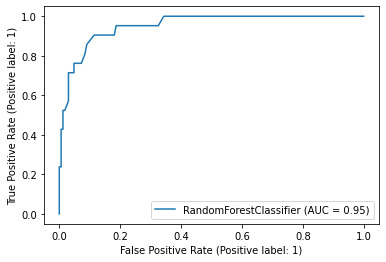

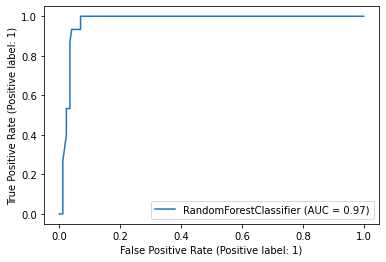

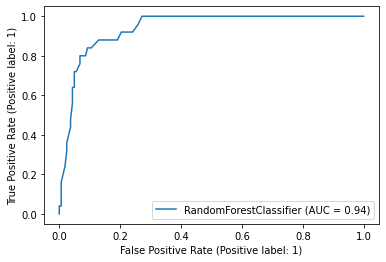

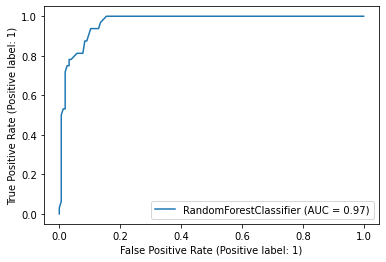

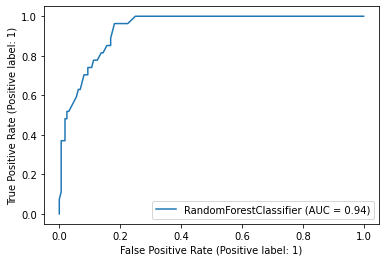

...

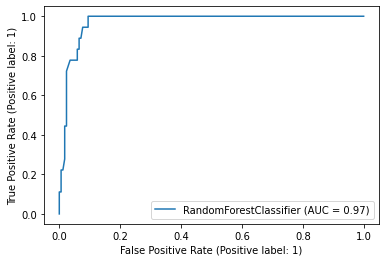

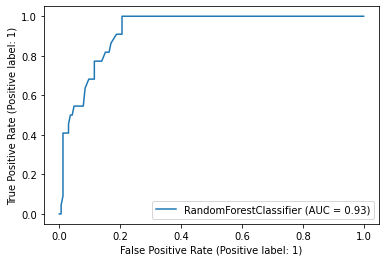

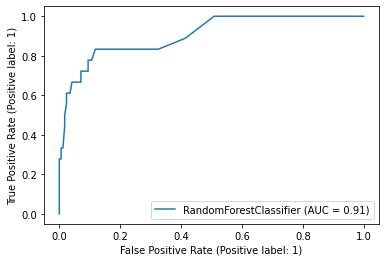

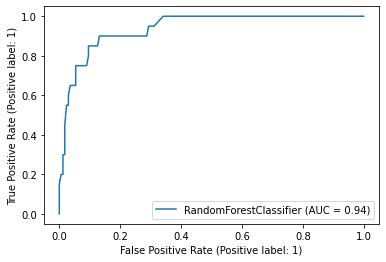

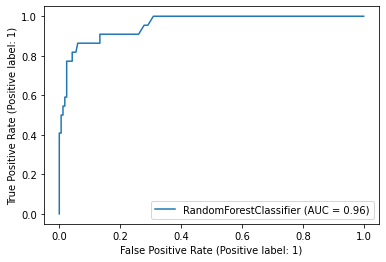

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_rf = RandomForestClassifier() 
    tic = time.time()
    model_rf.fit(X_train, y_train) 
    toc = time.time()
    print("Random Forest Train time = " + str(toc-tic))
    print("Random Forest Accuracy = "+ str(model_rf.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_rf.predict(X_test)
    yhat_classes = (model_rf.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Random Forest Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Random Forest Stats _____________________")

    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    CM = confusion_matrix(y_test, yhat_classes)
    print(CM)
    TN = CM[0][0]
    FN = CM[1][0]
    TP = CM[1][1]
    FP = CM[0][1]
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    auc = roc_auc_score(y_test, yhat_probs)
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    #AUC
    from sklearn.metrics import plot_roc_curve
    plot_roc_curve(model_rf, X_test, y_test)

    print("____________________________________________________________")
    print("____________________________________________________________")

#### Results

In [ ]:
import seaborn as sns

TPsum = np.sum(TPs)
TNsum = np.sum(TNs)
FPsum = np.sum(FPs)
FNsum = np.sum(FNs)

cm_data = [[TPsum, FNsum], [FPsum, TNsum]]
sns.heatmap(cm_data, annot=True, cmap='Blues', fmt='d')

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

In [ ]:
RFWithSMOTE = pd.DataFrame(data, columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([RFWithSMOTE.mean(axis=0).values],  columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

In [ ]:
RFWithSMOTE = RFWithSMOTE.append(df_temp)

In [ ]:
print(RFWithSMOTE)
RFWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/RFWithSMOTE.csv', index = True)

###Descision Tree

####Model

In [ ]:
from sklearn.tree import DecisionTreeClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_dt = DecisionTreeClassifier()
    tic = time.time()
    model_dt.fit(X_train, y_train) 
    toc = time.time()
    print("Decision Tree Train time = " + str(toc-tic))
    print("Decision Tree Accuracy = "+ str(model_dt.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_dt.predict(X_test)
    yhat_classes = (model_dt.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Decision Tree Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Decision Tree Stats _____________________")

    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    CM = confusion_matrix(y_test, yhat_classes)
    print(CM)
    TN = CM[0][0]
    FN = CM[1][0]
    TP = CM[1][1]
    FP = CM[0][1]
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    auc = roc_auc_score(y_test, yhat_probs)
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    #AUC
    from sklearn.metrics import plot_roc_curve
    plot_roc_curve(model_dt, X_test, y_test)

    print("____________________________________________________________")
    print("____________________________________________________________")

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

In [ ]:
DTWithSMOTE = pd.DataFrame(data, columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DTWithSMOTE.mean(axis=0).values],  columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User Left Out  Accuracy   ROC_AUC  ...     TN         FP        FN
Average           15.5  0.851872  0.725181  ...  147.1  17.966667  9.733333

[1 rows x 11 columns]


In [ ]:
DTWithSMOTE = DTWithSMOTE.append(df_temp)

In [ ]:
print(DTWithSMOTE)
DTWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/DTWithSMOTE.csv', index = True)

         User Left Out  Accuracy   ROC_AUC  ...     TN         FP         FN
0                  1.0  0.866310  0.716724  ...  151.0  15.000000  10.000000
1                  2.0  0.850267  0.857752  ...  146.0  26.000000   2.000000
2                  3.0  0.786096  0.741235  ...  130.0  32.000000   8.000000
3                  4.0  0.812834  0.800302  ...  127.0  28.000000   7.000000
4                  5.0  0.828877  0.776852  ...  136.0  24.000000   8.000000
5                  6.0  0.844920  0.703634  ...  148.0  20.000000   9.000000
6                  7.0  0.887701  0.861214  ...  147.0  17.000000   4.000000
7                  8.0  0.818182  0.668818  ...  143.0  23.000000  11.000000
8                  9.0  0.839572  0.721358  ...  143.0  19.000000  11.000000
9                 10.0  0.887701  0.657425  ...  159.0   9.000000  12.000000
10                11.0  0.860963  0.645455  ...  153.0  12.000000  14.000000
11                12.0  0.919786  0.682610  ...  165.0   4.000000  11.000000

###Gradient Boost

####Model

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 40.84136343002319
Gradient Boost Accuracy = 0.9197860962566845
Gradient Boost Test time = 0.011079072952270508
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.919786
[[162   4]
 [ 11  10]]
True negatives: 162
True positives: 10
False positives: 4
False negatives: 11
ROC AUC: 0.726047
F1 Score: 0.571429
Precision: 0.714286
TPR: 0.476190
FPR: 0.024096
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 40.68436050415039
Gradient Boost Accuracy = 0.9197860962566845
Gradient Boost Test time = 0.012779474258422852
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.919786
[[158  14]
 [  1  14]]
True negatives: 158
True positives: 14
False positives: 14
False negatives: 1
ROC AUC: 0.925969
F1 Score: 0.651163
Precision: 0.500000
TPR: 0.933333
FPR: 0.081395
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 40.78209447860718
Gradient Boost Accuracy = 0.8663101604278075
Gradient Boost Test time = 0.011295080184936523
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.866310
[[143  19]
 [  6  19]]
True negatives: 143
True positives: 19
False positives: 19
False negatives: 6
ROC AUC: 0.821358
F1 Score: 0.603175
Precision: 0.500000
TPR: 0.760000
FPR: 0.117284
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 40.8919951915741
Gradient Boost Accuracy = 0.893048128342246
Gradient Boost Test time = 0.011369705200195312
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.893048
[[147   8]
 [ 12  20]]
True negatives: 147
True positives: 20
False positives: 8
False negatives: 12
ROC AUC: 0.786694
F1 Score: 0.666667
Precision: 0.714286
TPR: 0.625000
FPR: 0.051613
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 40.689393758773804
Gradient Boost Accuracy = 0.8609625668449198
Gradient Boost Test time = 0.010019540786743164
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.860963
[[147  13]
 [ 13  14]]
True negatives: 147
True positives: 14
False positives: 13
False negatives: 13
ROC AUC: 0.718634
F1 Score: 0.518519
Precision: 0.518519
TPR: 0.518519
FPR: 0.081250
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 40.668694257736206
Gradient Boost Accuracy = 0.9251336898395722
Gradient Boost Test time = 0.010425090789794922
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.925134
[[160   8]
 [  6  13]]
True negatives: 160
True positives: 13
False positives: 8
False negatives: 6
ROC AUC: 0.818296
F1 Score: 0.650000
Precision: 0.619048
TPR: 0.684211
FPR: 0.047619
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 40.674238443374634
Gradient Boost Accuracy = 0.9037433155080213
Gradient Boost Test time = 0.010716676712036133
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.903743
[[150  14]
 [  4  19]]
True negatives: 150
True positives: 19
False positives: 14
False negatives: 4
ROC AUC: 0.870361
F1 Score: 0.678571
Precision: 0.575758
TPR: 0.826087
FPR: 0.085366


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)


____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 40.512247800827026
Gradient Boost Accuracy = 0.9144385026737968
Gradient Boost Test time = 0.011282205581665039
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.914439
[[160   6]
 [ 10  11]]
True negatives: 160
True positives: 11
False positives: 6
False negatives: 10
ROC AUC: 0.743832
F1 Score: 0.578947
Precision: 0.647059
TPR: 0.523810
FPR: 0.036145
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 40.638155460357666
Gradient Boost Accuracy = 0.9090909090909091
Gradient Boost Test time = 0.010711669921875
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.909091
[[153   9]
 [  8  17]]
True negatives: 153
True positives: 17
False positives: 9
False negatives: 8
ROC AUC: 0.812222
F1 Score: 0.666667
Precision: 0.653846
TPR: 0.680000
FPR: 0.055556
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 40.613162994384766
Gradient Boost Accuracy = 0.93048128342246
Gradient Boost Test time = 0.01096200942993164
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.930481
[[165   3]
 [ 10   9]]
True negatives: 165
True positives: 9
False positives: 3
False negatives: 10
ROC AUC: 0.727914
F1 Score: 0.580645
Precision: 0.750000
TPR: 0.473684
FPR: 0.017857
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 40.60807490348816
Gradient Boost Accuracy = 0.9090909090909091
Gradient Boost Test time = 0.010115861892700195
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.909091
[[161   4]
 [ 13   9]]
True negatives: 161
True positives: 9
False positives: 4
False negatives: 13
ROC AUC: 0.692424
F1 Score: 0.514286
Precision: 0.692308
TPR: 0.409091
FPR: 0.024242
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 40.63103461265564
Gradient Boost Accuracy = 0.9251336898395722
Gradient Boost Test time = 0.010601043701171875
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.925134
[[168   1]
 [ 13   5]]
True negatives: 168
True positives: 5
False positives: 1
False negatives: 13
ROC AUC: 0.635930
F1 Score: 0.416667
Precision: 0.833333
TPR: 0.277778
FPR: 0.005917
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 40.689367055892944
Gradient Boost Accuracy = 0.9144385026737968
Gradient Boost Test time = 0.011136531829833984
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.914439
[[156   9]
 [  7  15]]
True negatives: 156
True positives: 15
False positives: 9
False negatives: 7
ROC AUC: 0.813636
F1 Score: 0.652174
Precision: 0.625000
TPR: 0.681818
FPR: 0.054545
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 40.70484399795532
Gradient Boost Accuracy = 0.9197860962566845
Gradient Boost Test time = 0.010358810424804688
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.919786
[[160   9]
 [  6  12]]
True negatives: 160
True positives: 12
False positives: 9
False negatives: 6
ROC AUC: 0.806706
F1 Score: 0.615385
Precision: 0.571429
TPR: 0.666667
FPR: 0.053254
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 40.8051655292511
Gradient Boost Accuracy = 0.9037433155080213
Gradient Boost Test time = 0.010829448699951172
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.903743
[[151  13]
 [  5  18]]
True negatives: 151
True positives: 18
False positives: 13
False negatives: 5
ROC AUC: 0.851670
F1 Score: 0.666667
Precision: 0.580645
TPR: 0.782609
FPR: 0.079268
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 40.76707196235657
Gradient Boost Accuracy = 0.9090909090909091
Gradient Boost Test time = 0.010869741439819336
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.909091
[[165   2]
 [ 15   5]]
True negatives: 165
True positives: 5
False positives: 2
False negatives: 15
ROC AUC: 0.619012
F1 Score: 0.370370
Precision: 0.714286
TPR: 0.250000
FPR: 0.011976
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 40.8528687953949
Gradient Boost Accuracy = 0.8983957219251337
Gradient Boost Test time = 0.009907007217407227
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.898396
[[162   3]
 [ 16   6]]
True negatives: 162
True positives: 6
False positives: 3
False negatives: 16
ROC AUC: 0.627273
F1 Score: 0.387097
Precision: 0.666667
TPR: 0.272727
FPR: 0.018182
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 40.72590613365173
Gradient Boost Accuracy = 0.946524064171123
Gradient Boost Test time = 0.010664939880371094
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.946524
[[169   2]
 [  8   8]]
True negatives: 169
True positives: 8
False positives: 2
False negatives: 8
ROC AUC: 0.744152
F1 Score: 0.615385
Precision: 0.800000
TPR: 0.500000
FPR: 0.011696
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 40.80827045440674
Gradient Boost Accuracy = 0.8128342245989305
Gradient Boost Test time = 0.010722875595092773
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.812834
[[137  22]
 [ 13  15]]
True negatives: 137
True positives: 15
False positives: 22
False negatives: 13
ROC AUC: 0.698675
F1 Score: 0.461538
Precision: 0.405405
TPR: 0.535714
FPR: 0.138365
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 40.60822153091431
Gradient Boost Accuracy = 0.8823529411764706
Gradient Boost Test time = 0.010339021682739258
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.882353
[[142  21]
 [  1  23]]
True negatives: 142
True positives: 23
False positives: 21
False negatives: 1
ROC AUC: 0.914749
F1 Score: 0.676471
Precision: 0.522727
TPR: 0.958333
FPR: 0.128834
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 40.888195514678955
Gradient Boost Accuracy = 0.8663101604278075
Gradient Boost Test time = 0.009426593780517578
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.866310
[[155   6]
 [ 19   7]]
True negatives: 155
True positives: 7
False positives: 6
False negatives: 19
ROC AUC: 0.615982
F1 Score: 0.358974
Precision: 0.538462
TPR: 0.269231
FPR: 0.037267
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 40.75254845619202
Gradient Boost Accuracy = 0.9037433155080213
Gradient Boost Test time = 0.009862661361694336
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.903743
[[154  12]
 [  6  15]]
True negatives: 154
True positives: 15
False positives: 12
False negatives: 6
ROC AUC: 0.820998
F1 Score: 0.625000
Precision: 0.555556
TPR: 0.714286
FPR: 0.072289
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 40.869367599487305
Gradient Boost Accuracy = 0.9037433155080213
Gradient Boost Test time = 0.010767221450805664
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.903743
[[157   5]
 [ 13  12]]
True negatives: 157
True positives: 12
False positives: 5
False negatives: 13
ROC AUC: 0.724568
F1 Score: 0.571429
Precision: 0.705882
TPR: 0.480000
FPR: 0.030864
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 40.806488275527954
Gradient Boost Accuracy = 0.93048128342246
Gradient Boost Test time = 0.010253190994262695
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.930481
[[165   0]
 [ 13   9]]
True negatives: 165
True positives: 9
False positives: 0
False negatives: 13
ROC AUC: 0.704545
F1 Score: 0.580645
Precision: 1.000000
TPR: 0.409091
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 40.762592792510986
Gradient Boost Accuracy = 0.8556149732620321
Gradient Boost Test time = 0.009734630584716797
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.855615
[[156   7]
 [ 20   4]]
True negatives: 156
True positives: 4
False positives: 7
False negatives: 20
ROC AUC: 0.561861
F1 Score: 0.228571
Precision: 0.363636
TPR: 0.166667
FPR: 0.042945
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 40.57015800476074
Gradient Boost Accuracy = 0.9251336898395722
Gradient Boost Test time = 0.017546653747558594
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.925134
[[158  11]
 [  3  15]]
True negatives: 158
True positives: 15
False positives: 11
False negatives: 3
ROC AUC: 0.884122
F1 Score: 0.681818
Precision: 0.576923
TPR: 0.833333
FPR: 0.065089
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 40.733640909194946
Gradient Boost Accuracy = 0.8983957219251337
Gradient Boost Test time = 0.011901378631591797
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.898396
[[160   5]
 [ 14   8]]
True negatives: 160
True positives: 8
False positives: 5
False negatives: 14
ROC AUC: 0.666667
F1 Score: 0.457143
Precision: 0.615385
TPR: 0.363636
FPR: 0.030303
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 40.68975520133972
Gradient Boost Accuracy = 0.9358288770053476
Gradient Boost Test time = 0.010652303695678711
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.935829
[[167   2]
 [ 10   8]]
True negatives: 167
True positives: 8
False positives: 2
False negatives: 10
ROC AUC: 0.716305
F1 Score: 0.571429
Precision: 0.800000
TPR: 0.444444
FPR: 0.011834
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 40.83470606803894
Gradient Boost Accuracy = 0.8983957219251337
Gradient Boost Test time = 0.010847330093383789
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.898396
[[152  15]
 [  4  16]]
True negatives: 152
True positives: 16
False positives: 15
False negatives: 4
ROC AUC: 0.855090
F1 Score: 0.627451
Precision: 0.516129
TPR: 0.800000
FPR: 0.089820
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

Gradient Boost Train time = 40.57060647010803
Gradient Boost Accuracy = 0.9197860962566845
Gradient Boost Test time = 0.010183572769165039
(187,)
(187,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.919786
[[154  11]
 [  4  18]]
True negatives: 154
True positives: 18
False positives: 11
False negatives: 4
ROC AUC: 0.875758
F1 Score: 0.705882
Precision: 0.620690
TPR: 0.818182
FPR: 0.066667
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


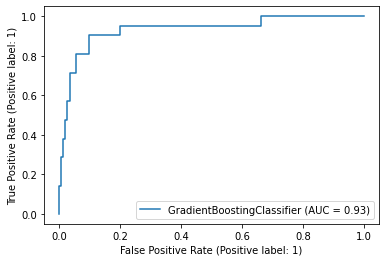

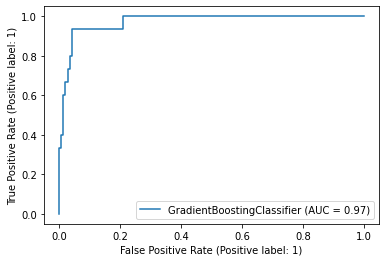

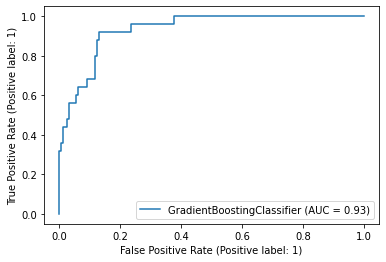

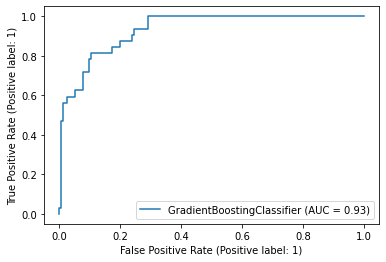

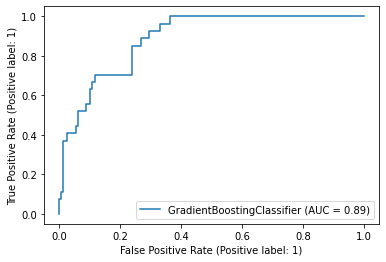

...

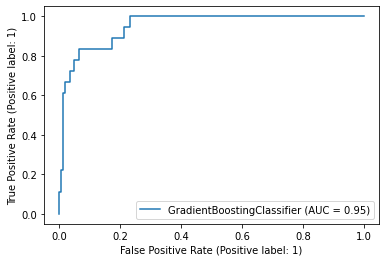

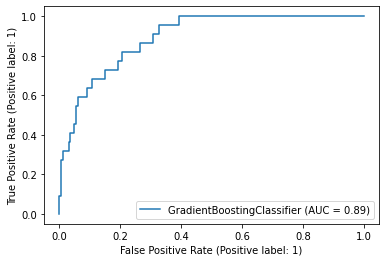

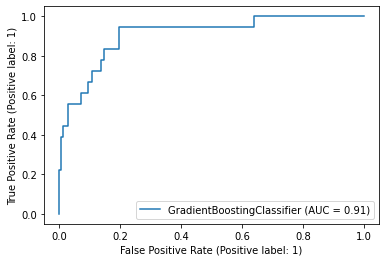

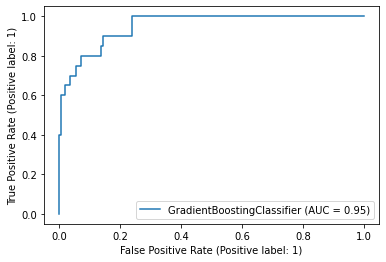

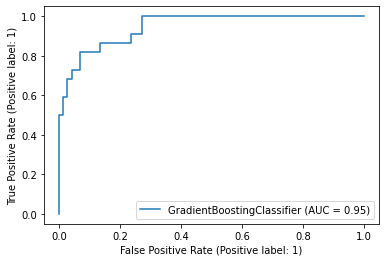

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_gb = GradientBoostingClassifier(n_estimators = 1000) 
    tic = time.time()
    model_gb.fit(X_train, y_train) 
    toc = time.time()
    print("Gradient Boost Train time = " + str(toc-tic))
    print("Gradient Boost Accuracy = "+ str(model_gb.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_gb.predict(X_test)
    yhat_classes = (model_gb.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Gradient Boost Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Gradient Boost Stats _____________________")

    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    CM = confusion_matrix(y_test, yhat_classes)
    print(CM)
    TN = CM[0][0]
    FN = CM[1][0]
    TP = CM[1][1]
    FP = CM[0][1]
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)

    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    auc = roc_auc_score(y_test, yhat_probs)
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    #AUC
    from sklearn.metrics import plot_roc_curve
    plot_roc_curve(model_gb, X_test, y_test)

    print("____________________________________________________________")
    print("____________________________________________________________")

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

In [ ]:
GBWithSMOTE = pd.DataFrame(data, columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([GBWithSMOTE.mean(axis=0).values],  columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

In [ ]:
GBWithSMOTE = GBWithSMOTE.append(df_temp)

In [ ]:
print(GBWithSMOTE)
GBWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/GBWithSMOTE.csv', index = True)

###3 DNN

#### Model

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

Epoch 1/100
135/135 [==============================] - 1s 4ms/step - loss: 0.7731 - accuracy: 0.5601 - val_loss: 0.6636 - val_accuracy: 0.6273 - lr: 0.0010
Epoch 2/100
135/135 [==============================] - 0s 2ms/step - loss: 0.5656 - accuracy: 0.7143 - val_loss: 0.4433 - val_accuracy: 0.7704 - lr: 0.0010
Epoch 3/100
135/135 [==============================] - 0s 2ms/step - loss: 0.4868 - accuracy: 0.7814 - val_loss: 0.4725 - val_accuracy: 0.7704 - lr: 0.0010
Epoch 4/100
135/135 [==============================] - 0s 2ms/step - loss: 0.4527 - accuracy: 0.7997 - val_loss: 0.4325 - val_accuracy: 0.8215 - lr: 0.0010
Epoch 5/100
135/135 [==============================] - 0s 2ms/step - loss: 0.4344 - accuracy: 0.8146 - val_loss: 0.4154 - val_accuracy: 0.8278 - lr: 0.0010
Epoch 6/100
135/135 [==============================] - 0s 2ms/step - loss: 0.4266 - accuracy: 0.8173 - val_loss: 0.3717 - val_accuracy: 0.8476 - lr: 0.0010
Epoch 7/100
135/135 [==============================] - 0s 2ms/st

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Epoch 1/100
135/135 [==============================] - 2s 6ms/step - loss: 0.6831 - accuracy: 0.6293 - val_loss: 0.6234 - val_accuracy: 0.7328 - lr: 0.0010
Epoch 2/100
135/135 [==============================] - 1s 4ms/step - loss: 0.5349 - accuracy: 0.7375 - val_loss: 0.6174 - val_accuracy: 0.7140 - lr: 0.0010
Epoch 3/100
135/135 [==============================] - 1s 4ms/step - loss: 0.4894 - accuracy: 0.7780 - val_loss: 0.4997 - val_accuracy: 0.7526 - lr: 0.0010
Epoch 4/100
135/135 [==============================] - 1s 4ms/step - loss: 0.4526 - accuracy: 0.7997 - val_loss: 0.4658 - val_accuracy: 0.7745 - lr: 0.0010
Epoch 5/100
135/135 [==============================] - 0s 4ms/step - loss: 0.4397 - accuracy: 0.8093 - val_loss: 0.4814 - val_accuracy: 0.7578 - lr: 0.0010
Epoch 6/100
135/135 [==============================] - 1s 4ms/step - loss: 0.4185 - accuracy: 0.8155 - val_loss: 0.4658 - val_accuracy: 0.7683 - lr: 0.0010
Epoch 7/100
135/135 [==============================] - 1s 4ms/st

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


135/135 [==============================] - 1s 4ms/step - loss: 0.7538 - accuracy: 0.5990 - val_loss: 0.6296 - val_accuracy: 0.6232 - lr: 0.0010
Epoch 2/100
135/135 [==============================] - 0s 3ms/step - loss: 0.5709 - accuracy: 0.7002 - val_loss: 0.5395 - val_accuracy: 0.7630 - lr: 0.0010
Epoch 3/100
135/135 [==============================] - 0s 3ms/step - loss: 0.5132 - accuracy: 0.7561 - val_loss: 0.4727 - val_accuracy: 0.8079 - lr: 0.0010
Epoch 4/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4629 - accuracy: 0.7967 - val_loss: 0.4517 - val_accuracy: 0.8069 - lr: 0.0010
Epoch 5/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4305 - accuracy: 0.8212 - val_loss: 0.3765 - val_accuracy: 0.8486 - lr: 0.0010
Epoch 6/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4190 - accuracy: 0.8199 - val_loss: 0.3735 - val_accuracy: 0.8403 - lr: 0.0010
Epoch 7/100
135/135 [==============================] - 0s 3ms/step - loss: 0

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


135/135 [==============================] - 1s 4ms/step - loss: 0.8071 - accuracy: 0.5931 - val_loss: 0.6803 - val_accuracy: 0.6148 - lr: 0.0010
Epoch 2/100
135/135 [==============================] - 0s 3ms/step - loss: 0.5937 - accuracy: 0.6972 - val_loss: 0.5412 - val_accuracy: 0.7296 - lr: 0.0010
Epoch 3/100
135/135 [==============================] - 0s 3ms/step - loss: 0.5166 - accuracy: 0.7613 - val_loss: 0.4531 - val_accuracy: 0.7975 - lr: 0.0010
Epoch 4/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4864 - accuracy: 0.7871 - val_loss: 0.3720 - val_accuracy: 0.8319 - lr: 0.0010
Epoch 5/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4459 - accuracy: 0.7991 - val_loss: 0.3858 - val_accuracy: 0.8257 - lr: 0.0010
Epoch 6/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4317 - accuracy: 0.8069 - val_loss: 0.4465 - val_accuracy: 0.8173 - lr: 0.0010
Epoch 7/100
135/135 [==============================] - 0s 3ms/step - loss: 0

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


135/135 [==============================] - 1s 4ms/step - loss: 0.7713 - accuracy: 0.5724 - val_loss: 0.6080 - val_accuracy: 0.6430 - lr: 0.0010
Epoch 2/100
135/135 [==============================] - 0s 3ms/step - loss: 0.5575 - accuracy: 0.7126 - val_loss: 0.5054 - val_accuracy: 0.7098 - lr: 0.0010
Epoch 3/100
135/135 [==============================] - 0s 3ms/step - loss: 0.5064 - accuracy: 0.7629 - val_loss: 0.4053 - val_accuracy: 0.8142 - lr: 0.0010
Epoch 4/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4500 - accuracy: 0.7972 - val_loss: 0.3976 - val_accuracy: 0.8173 - lr: 0.0010
Epoch 5/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4298 - accuracy: 0.8145 - val_loss: 0.3934 - val_accuracy: 0.8194 - lr: 0.0010
Epoch 6/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4111 - accuracy: 0.8203 - val_loss: 0.3980 - val_accuracy: 0.8236 - lr: 0.0010
Epoch 7/100
135/135 [==============================] - 0s 3ms/step - loss: 0

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


135/135 [==============================] - 1s 4ms/step - loss: 0.7337 - accuracy: 0.5869 - val_loss: 0.6719 - val_accuracy: 0.6029 - lr: 0.0010
Epoch 2/100
135/135 [==============================] - 0s 3ms/step - loss: 0.5569 - accuracy: 0.7206 - val_loss: 0.4803 - val_accuracy: 0.7325 - lr: 0.0010
Epoch 3/100
135/135 [==============================] - 0s 3ms/step - loss: 0.5039 - accuracy: 0.7760 - val_loss: 0.4390 - val_accuracy: 0.7544 - lr: 0.0010
Epoch 4/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4595 - accuracy: 0.7988 - val_loss: 0.4079 - val_accuracy: 0.7868 - lr: 0.0010
Epoch 5/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4479 - accuracy: 0.8140 - val_loss: 0.4546 - val_accuracy: 0.7764 - lr: 0.0010
Epoch 6/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4315 - accuracy: 0.8198 - val_loss: 0.4141 - val_accuracy: 0.8036 - lr: 0.0010
Epoch 7/100
135/135 [==============================] - 0s 3ms/step - loss: 0

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


135/135 [==============================] - 2s 4ms/step - loss: 0.6543 - accuracy: 0.6224 - val_loss: 0.5601 - val_accuracy: 0.6159 - lr: 0.0010
Epoch 2/100
135/135 [==============================] - 0s 3ms/step - loss: 0.5141 - accuracy: 0.7636 - val_loss: 0.4787 - val_accuracy: 0.7328 - lr: 0.0010
Epoch 3/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4488 - accuracy: 0.8071 - val_loss: 0.4102 - val_accuracy: 0.7965 - lr: 0.0010
Epoch 4/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4247 - accuracy: 0.8231 - val_loss: 0.3912 - val_accuracy: 0.8111 - lr: 0.0010
Epoch 5/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4016 - accuracy: 0.8358 - val_loss: 0.3926 - val_accuracy: 0.8163 - lr: 0.0010
Epoch 6/100
135/135 [==============================] - 0s 3ms/step - loss: 0.3888 - accuracy: 0.8330 - val_loss: 0.3687 - val_accuracy: 0.8392 - lr: 0.0010
Epoch 7/100
135/135 [==============================] - 0s 3ms/step - loss: 0

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


135/135 [==============================] - 1s 4ms/step - loss: 0.8123 - accuracy: 0.6180 - val_loss: 0.5939 - val_accuracy: 0.6238 - lr: 0.0010
Epoch 2/100
135/135 [==============================] - 0s 3ms/step - loss: 0.5670 - accuracy: 0.7399 - val_loss: 0.5464 - val_accuracy: 0.7147 - lr: 0.0010
Epoch 3/100
135/135 [==============================] - 0s 3ms/step - loss: 0.5062 - accuracy: 0.7793 - val_loss: 0.4646 - val_accuracy: 0.7774 - lr: 0.0010
Epoch 4/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4630 - accuracy: 0.8030 - val_loss: 0.4371 - val_accuracy: 0.8286 - lr: 0.0010
Epoch 5/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4406 - accuracy: 0.8187 - val_loss: 0.3832 - val_accuracy: 0.8454 - lr: 0.0010
Epoch 6/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4110 - accuracy: 0.8292 - val_loss: 0.4092 - val_accuracy: 0.8391 - lr: 0.0010
Epoch 7/100
135/135 [==============================] - 0s 3ms/step - loss: 0

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


135/135 [==============================] - 1s 4ms/step - loss: 0.7341 - accuracy: 0.6275 - val_loss: 0.5474 - val_accuracy: 0.6102 - lr: 0.0010
Epoch 2/100
135/135 [==============================] - 0s 3ms/step - loss: 0.5737 - accuracy: 0.7123 - val_loss: 0.4756 - val_accuracy: 0.6865 - lr: 0.0010
Epoch 3/100
135/135 [==============================] - 0s 3ms/step - loss: 0.5148 - accuracy: 0.7645 - val_loss: 0.4658 - val_accuracy: 0.7074 - lr: 0.0010
Epoch 4/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4744 - accuracy: 0.7887 - val_loss: 0.4021 - val_accuracy: 0.7440 - lr: 0.0010
Epoch 5/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4492 - accuracy: 0.8054 - val_loss: 0.4678 - val_accuracy: 0.7377 - lr: 0.0010
Epoch 6/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4355 - accuracy: 0.8102 - val_loss: 0.4473 - val_accuracy: 0.7680 - lr: 0.0010
Epoch 7/100
135/135 [==============================] - 0s 3ms/step - loss: 0

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


135/135 [==============================] - 1s 4ms/step - loss: 0.6537 - accuracy: 0.6320 - val_loss: 0.5716 - val_accuracy: 0.5731 - lr: 0.0010
Epoch 2/100
135/135 [==============================] - 0s 3ms/step - loss: 0.5129 - accuracy: 0.7538 - val_loss: 0.5018 - val_accuracy: 0.7046 - lr: 0.0010
Epoch 3/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4655 - accuracy: 0.7991 - val_loss: 0.4602 - val_accuracy: 0.7610 - lr: 0.0010
Epoch 4/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4264 - accuracy: 0.8198 - val_loss: 0.4299 - val_accuracy: 0.7693 - lr: 0.0010
Epoch 5/100
135/135 [==============================] - 0s 3ms/step - loss: 0.4143 - accuracy: 0.8257 - val_loss: 0.4086 - val_accuracy: 0.7944 - lr: 0.0010
Epoch 6/100
135/135 [==============================] - 0s 3ms/step - loss: 0.3987 - accuracy: 0.8283 - val_loss: 0.4497 - val_accuracy: 0.7818 - lr: 0.0010
Epoch 7/100
135/135 [==============================] - 0s 3ms/step - loss: 0

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_plot/roc_curve.py:122: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


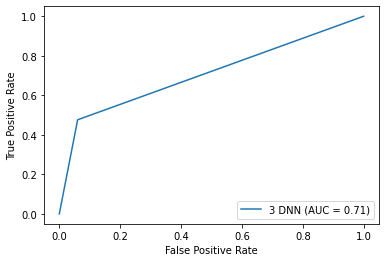

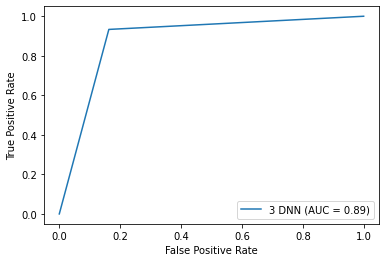

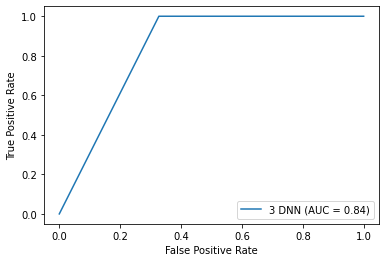

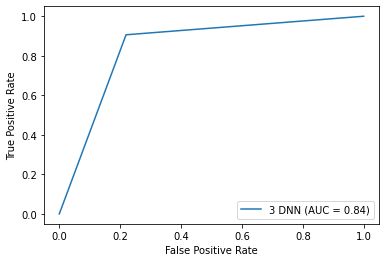

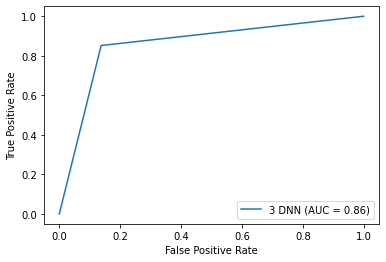

...

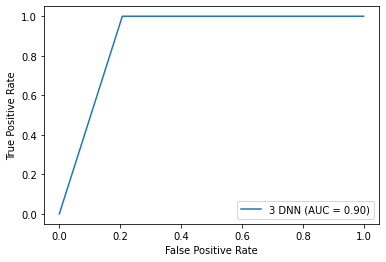

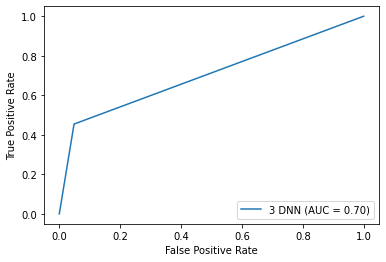

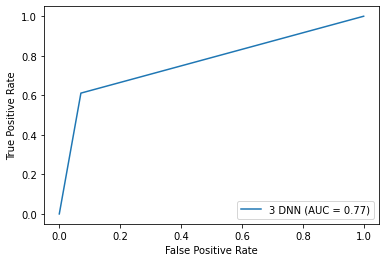

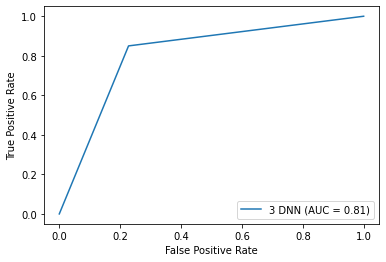

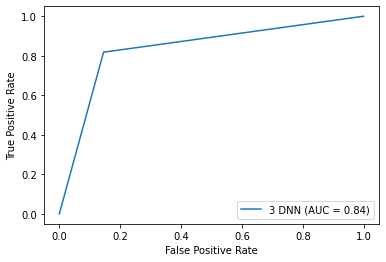

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model3 = Sequential()

    model3.add(Dense(64, activation='relu', input_shape=(X_train.shape[1],)))
    model3.add(Dropout(0.3))
    model3.add(Dense(32, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(8, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(1, activation='sigmoid'))

    model3.compile(loss='binary_crossentropy',
                  optimizer='adam',
                  metrics=['accuracy'])
    reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=0.001)
    tic = time.time()
    model3.fit(X_train, y_train, batch_size=64, epochs=100, validation_split=0.1, callbacks=[reduce_lr])
    toc = time.time()
    print("3 DNN Train time = " + str(toc-tic))
    print("3 DNN Accuracy = "+ str(model3.evaluate(X_test, y_test, verbose=0)[1]))
    tic = time.time()
    yhat_probs = model3.predict(X_test, verbose=0)
    yhat_classes = (model3.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("3 DNN Test time = " + str(toc-tic))
    yhat_probs = yhat_probs[:, 0]
    yhat_classes = yhat_classes[:, 0]
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________3 DNN Stats _____________________")

    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    CM = confusion_matrix(y_test, yhat_classes)
    print(CM)
    TN = CM[0][0]
    FN = CM[1][0]
    TP = CM[1][1]
    FP = CM[0][1]
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)

    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    auc = roc_auc_score(y_test, yhat_probs)
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    #AUC
    from sklearn import metrics
    fpr, tpr, thresholds = metrics.roc_curve(y_test, yhat_classes)
    roc_auc = metrics.auc(fpr, tpr)
    display = metrics.RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc, estimator_name='3 DNN')
    display.plot()  

    print("____________________________________________________________")
    print("____________________________________________________________")

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
DNN3WithSMOTE = pd.DataFrame(data, columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DNN3WithSMOTE.mean(axis=0).values],  columns=['User Left Out', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User Left Out  Accuracy   ROC_AUC  ...          TN    FP   FN
Average           15.5   0.85508  0.915426  ...  144.266667  20.8  6.3

[1 rows x 11 columns]


In [ ]:
DNN3WithSMOTE = DNN3WithSMOTE.append(df_temp)

In [ ]:
print(DNN3WithSMOTE)
DNN3WithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/DNN3WithSMOTE.csv', index = True)

         User Left Out  Accuracy   ROC_AUC  ...          TN    FP    FN
0                  1.0  0.887701  0.825731  ...  156.000000  10.0  11.0
1                  2.0  0.844920  0.967829  ...  144.000000  28.0   1.0
2                  3.0  0.716578  0.958765  ...  109.000000  53.0   0.0
3                  4.0  0.802139  0.921774  ...  121.000000  34.0   3.0
4                  5.0  0.860963  0.934259  ...  138.000000  22.0   4.0
5                  6.0  0.839572  0.936404  ...  141.000000  27.0   3.0
6                  7.0  0.780749  0.974814  ...  123.000000  41.0   0.0
7                  8.0  0.866310  0.876363  ...  152.000000  14.0  11.0
8                  9.0  0.866310  0.945926  ...  140.000000  22.0   3.0
9                 10.0  0.877005  0.910401  ...  157.000000  11.0  12.0
10                11.0  0.828877  0.892287  ...  143.000000  22.0  10.0
11                12.0  0.941176  0.948389  ...  166.000000   3.0   8.0
12                13.0  0.860963  0.866116  ...  144.000000  21.

# Personalized models without SMOTE last N

## Data Processing

### Import dataset

In [ ]:
directory_all = "/content/drive/MyDrive/Surjya Sir Work/5000"
directory_pbd = "/content/drive/MyDrive/Surjya Sir Work/5000_probed"

In [ ]:
videos = [1,2,3,4,5,6,7,8]

In [ ]:
all = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_all + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    all.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 5
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 6
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


In [ ]:
probed = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_pbd + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    probed.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 5
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 6
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


### Create df

In [ ]:
df = pd.DataFrame()
for i in range(len(all)):#per video = 8
  for j in range(len(all[i])): #per subject = 30
    df = df.append(all[i][j], ignore_index=True)

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8


In [ ]:
tester = pd.DataFrame()
for i in range(len(probed)):#per video = 8
  for j in range(len(probed[i])): #per subject = 30
    tester = tester.append(probed[i][j], ignore_index=True)

In [ ]:
tester

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1738876.01,1743876.01,1748876.01,6.309,5.096,0.013,0.106,5.632759,0.600,0.378,0.155,0.010,0.369,1.642,8.131,10,1
1,832168.01,837168.01,842168.01,6.488,5.290,0.012,0.159,1.883567,0.300,3.623,0.126,0.021,0.657,0.246,0.000,11,1
2,907168.01,912168.01,917168.01,5.330,4.958,0.394,0.082,3.340205,0.103,3.119,0.136,0.004,7.022,0.699,0.123,11,1
3,917168.01,922168.01,927168.01,6.046,5.011,0.767,0.003,2.078420,0.213,0.785,0.136,0.007,4.846,0.041,0.040,11,1
4,922168.01,927168.01,932168.01,6.476,5.014,0.430,0.022,2.208317,0.307,4.601,0.068,0.010,4.148,1.191,0.288,11,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
843,2282834.01,2287834.01,2292834.01,2.090,7.542,0.918,0.586,3.800016,3.170,4.349,0.261,0.003,0.082,2.916,1.602,8,8
844,2287834.01,2292834.01,2297834.01,1.199,8.115,1.181,0.661,5.052202,4.889,8.049,1.549,0.039,0.164,1.315,2.587,8,8
845,1166459.01,1171459.01,1176459.01,3.156,6.595,0.518,0.543,4.114055,0.256,0.368,4.792,0.011,2.998,3.368,13.429,9,8
846,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8


In [ ]:
temp = df[df.isin(tester)].dropna()

In [ ]:
temp = df.loc[df.set_index(list(df.columns)).index.isin(tester.set_index(list(tester.columns)).index)]

In [ ]:
temp.index

Int64Index([  35,   47,   62,   64,   65,   70,   99,  107,  117,  118,
            ...
            7191, 7212, 7231, 7234, 7239, 7255, 7256, 7284, 7285, 7286],
           dtype='int64', length=848)

In [ ]:
df['Probe'] = 0

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,0
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,0
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
for idx in temp.index:
  df.at[idx, 'Probe'] = 1

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


### Optimise df

In [ ]:
df = df.drop(columns=["Start", "Border", "End"], axis=1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
df.to_csv('df.csv')

In [ ]:
df['valence_acc_video'] = 0
df['arousal_acc_video'] = 0

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,0,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,0,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,0,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,0,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,0
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,0
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,0
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,0


I'm using the following encoding: 

1 - Low
2 - Mid/high
3 - High

In [ ]:
# def basedOnVideoValence(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 2
#     if int(video) == 6:
#         return 2
#     if int(video) == 7:
#         return 1
#     if int(video) == 8:
#         return 1
    
# def basedOnVideoArousal(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 1
#     if int(video) == 6:
#         return 1
#     if int(video) == 7:
#         return 3
#     if int(video) == 8:
#         return 3

New encoding, 
Low - 0 
Med / High - 1

In [ ]:
def basedOnVideoValence(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 1
    if int(video) == 6:
        return 1
    if int(video) == 7:
        return 0
    if int(video) == 8:
        return 0
    
def basedOnVideoArousal(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 0
    if int(video) == 6:
        return 0
    if int(video) == 7:
        return 1
    if int(video) == 8:
        return 1

In [ ]:
df['valence_acc_video'] = df.apply(lambda row : basedOnVideoValence(row['video']), axis = 1)
df['arousal_acc_video'] = df.apply(lambda row : basedOnVideoArousal(row['video']), axis = 1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1


### Last N

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1


In [ ]:
df['last1'] = np.where(df['Probe'].shift(1) == 1,1,0)
df['last2'] = np.where(df['Probe'].shift(2) == 1,1,0)
df['last3'] = np.where(df['Probe'].shift(3) == 1,1,0)
df['last4'] = np.where(df['Probe'].shift(4) == 1,1,0)
df['last5'] = np.where(df['Probe'].shift(5) == 1,1,0)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,...,subject,video,Probe,valence_acc_video,arousal_acc_video,last1,last2,last3,last4,last5
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,...,10,1,0,1,1,0,0,0,0,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,...,10,1,0,1,1,0,0,0,0,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,...,10,1,0,1,1,0,0,0,0,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,...,10,1,0,1,1,0,0,0,0,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,...,10,1,0,1,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,...,9,8,1,0,1,1,0,0,0,0
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,...,9,8,1,0,1,1,1,0,0,0
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,...,9,8,0,0,1,1,1,1,0,0
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,...,9,8,0,0,1,0,1,1,1,0


In [ ]:
# df['Last1'] = 0
# df['Last2'] = 0
# df['Last3'] = 0
# df['Last4'] = 0
# df['Last5'] = 0

df['Last1'] = df.apply(lambda row: (row.last1)/1, axis=1)
df['Last2'] = df.apply(lambda row: (row.last1 + row.last2)/2, axis=1)
df['Last3'] = df.apply(lambda row: (row.last1 + row.last2 + row.last3)/3, axis=1)
df['Last4'] = df.apply(lambda row: (row.last1 + row.last2 + row.last3 + row.last4)/4, axis=1)
df['Last5'] = df.apply(lambda row: (row.last1 + row.last2 + row.last3 + row.last4 + row.last5)/5, axis=1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,...,last1,last2,last3,last4,last5,Last1,Last2,Last3,Last4,Last5
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,...,0,0,0,0,0,0.0,0.0,0.000000,0.00,0.0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,...,0,0,0,0,0,0.0,0.0,0.000000,0.00,0.0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,...,0,0,0,0,0,0.0,0.0,0.000000,0.00,0.0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,...,0,0,0,0,0,0.0,0.0,0.000000,0.00,0.0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,...,0,0,0,0,0,0.0,0.0,0.000000,0.00,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,...,1,0,0,0,0,1.0,0.5,0.333333,0.25,0.2
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,...,1,1,0,0,0,1.0,1.0,0.666667,0.50,0.4
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,...,1,1,1,0,0,1.0,1.0,1.000000,0.75,0.6
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,...,0,1,1,1,0,0.0,0.5,0.666667,0.75,0.6


In [ ]:
df = df.drop(columns=["last1", "last2", "last3", "last4", "last5"], axis = 1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,...,subject,video,Probe,valence_acc_video,arousal_acc_video,Last1,Last2,Last3,Last4,Last5
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,...,10,1,0,1,1,0.0,0.0,0.000000,0.00,0.0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,...,10,1,0,1,1,0.0,0.0,0.000000,0.00,0.0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,...,10,1,0,1,1,0.0,0.0,0.000000,0.00,0.0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,...,10,1,0,1,1,0.0,0.0,0.000000,0.00,0.0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,...,10,1,0,1,1,0.0,0.0,0.000000,0.00,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,...,9,8,1,0,1,1.0,0.5,0.333333,0.25,0.2
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,...,9,8,1,0,1,1.0,1.0,0.666667,0.50,0.4
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,...,9,8,0,0,1,1.0,1.0,1.000000,0.75,0.6
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,...,9,8,0,0,1,0.0,0.5,0.666667,0.75,0.6


In [ ]:
df.to_csv('file.csv')

### X,y for personalized models

In [ ]:
X_train_all = []
y_train_all = []
X_test_all = []
y_test_all = []

In [ ]:
users = []
for i in range(1, 31):
  users.append(i)

print(users)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30]


In [ ]:
for user in users:
  print("User", user)
  X_train = pd.DataFrame()
  y_train = pd.DataFrame()
  X_test = pd.DataFrame()
  y_test = pd.DataFrame()
  df_new = df[df['subject'] == str(user)]
  df_probe = df_new[df_new['Probe'] == 1]
  df_nonprobe = df_new[df_new['Probe'] == 0]

  y_probe = df_probe['Probe']
  y_nonprobe = df_nonprobe['Probe']

  y_probe = pd.DataFrame(y_probe)
  y_nonprobe = pd.DataFrame(y_nonprobe)

  X_probe = df_probe.drop(columns=["Probe"], axis = 1)
  X_nonprobe = df_nonprobe.drop(columns=["Probe"], axis = 1)

  X_train_probe, X_test_probe, y_train_probe, y_test_probe = train_test_split(X_probe, y_probe, test_size = 0.3)
  X_train_nonprobe, X_test_nonprobe, y_train_nonprobe, y_test_nonprobe = train_test_split(X_nonprobe, y_nonprobe, test_size = 0.3)

  X_train = X_train.append(X_train_probe)
  X_train = X_train.append(X_train_nonprobe)
  X_test = X_test.append(X_test_probe)
  X_test = X_test.append(X_test_nonprobe)
  y_train = y_train.append(y_train_probe)
  y_train = y_train.append(y_train_nonprobe)
  y_test = y_test.append(y_test_probe)
  y_test = y_test.append(y_test_nonprobe)


  
  # for video in videos:
  #   print("    Video", video)
  #   df_selected = df_new[df_new['video'] == video]
  #   df_probe = df_selected[df_selected['Probe'] == 1]
  #   df_nonprobe = df_selected[df_selected['Probe'] == 0]

  #   y_probe = df_probe['Probe']
  #   y_nonprobe = df_nonprobe['Probe']

  #   y_probe = pd.DataFrame(y_probe)
  #   y_nonprobe = pd.DataFrame(y_nonprobe)

  #   X_probe = df_probe.drop(columns=["Probe"], axis = 1)
  #   X_nonprobe = df_nonprobe.drop(columns=["Probe"], axis = 1)

  #   X_train_probe, X_test_probe, y_train_probe, y_test_probe = train_test_split(X_probe, y_probe, test_size = 0.5)
  #   X_train_nonprobe, X_test_nonprobe, y_train_nonprobe, y_test_nonprobe = train_test_split(X_nonprobe, y_nonprobe, test_size = 0.2)
  
  #   X_train = X_train.append(X_train_probe)
  #   X_train = X_train.append(X_train_nonprobe)
  #   X_test = X_test.append(X_test_probe)
  #   X_test = X_test.append(X_test_nonprobe)
  #   y_train = y_train.append(y_train_probe)
  #   y_train = y_train.append(y_train_nonprobe)
  #   y_test = y_test.append(y_test_probe)
  #   y_test = y_test.append(y_test_nonprobe)
  X_train_all.append(X_train)
  y_train_all.append(y_train)
  X_test_all.append(X_test)
  y_test_all.append(y_test)

User 1
User 2
User 3
User 4
User 5
User 6
User 7
User 8
User 9
User 10
User 11
User 12
User 13
User 14
User 15
User 16
User 17
User 18
User 19
User 20
User 21
User 22
User 23
User 24
User 25
User 26
User 27
User 28
User 29
User 30


In [ ]:
print(len(X_train_all[29]['subject'].unique()))

1


In [ ]:
X_train_all[2]

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,valence_acc_video,arousal_acc_video,Last1,Last2,Last3,Last4,Last5
833,7.769,6.395,0.512,0.439,12.270461,0.457,2.063,0.242,0.024,3.943,2.546,0.205,3,1,1,1,0.0,0.0,0.000000,0.25,0.4
3447,4.977,4.105,0.020,0.747,1.488032,0.769,0.038,0.145,0.000,0.042,1.150,0.123,3,4,0,0,0.0,0.0,0.000000,0.00,0.0
7123,2.073,8.601,0.113,0.200,7.879364,1.482,0.049,0.716,0.046,0.452,0.164,0.288,3,8,0,1,0.0,0.0,0.000000,0.00,0.0
4314,6.089,4.165,0.169,0.908,3.837078,0.248,0.998,0.668,0.003,3.368,0.657,12.813,3,5,1,0,0.0,0.0,0.000000,0.00,0.0
3459,4.964,4.552,0.003,0.000,3.543979,0.603,0.048,0.048,0.007,6.982,0.246,0.000,3,4,0,0,1.0,0.5,0.333333,0.25,0.2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3445,4.980,4.082,0.020,0.918,0.829792,1.297,0.155,0.106,0.007,0.081,0.165,8.419,3,4,0,0,0.0,0.0,0.000000,0.00,0.0
4310,6.009,4.871,0.000,0.126,0.213957,0.509,0.649,0.842,0.011,0.000,0.370,0.164,3,5,1,0,0.0,0.0,0.000000,0.00,0.0
6247,2.460,8.433,0.252,0.016,1.326815,0.545,0.358,0.871,0.014,1.971,0.739,0.083,3,7,0,1,0.0,0.0,0.333333,0.25,0.2
6215,4.850,5.671,0.095,0.328,0.659715,0.347,0.349,0.707,0.007,0.000,0.000,0.164,3,7,0,1,0.0,0.0,0.000000,0.00,0.0


In [ ]:
new_X_train_all = []

for i in range(len(X_train_all)):
    df_temp = X_train_all[i]
    #df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    df_temp = df_temp.drop(columns=["subject"], axis = 1)
    new_X_train_all.append(df_temp)

X_train_all = new_X_train_all

new_X_test_all = []

for i in range(len(X_test_all)):
    df_temp = X_test_all[i]
    #df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    df_temp = df_temp.drop(columns=["subject"], axis = 1)
    new_X_test_all.append(df_temp)

X_test_all = new_X_test_all

In [ ]:
X_train_all[2]

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,video,valence_acc_video,arousal_acc_video,Last1,Last2,Last3,Last4,Last5
833,7.769,6.395,0.512,0.439,12.270461,0.457,2.063,0.242,0.024,3.943,2.546,0.205,1,1,1,0.0,0.0,0.000000,0.25,0.4
3447,4.977,4.105,0.020,0.747,1.488032,0.769,0.038,0.145,0.000,0.042,1.150,0.123,4,0,0,0.0,0.0,0.000000,0.00,0.0
7123,2.073,8.601,0.113,0.200,7.879364,1.482,0.049,0.716,0.046,0.452,0.164,0.288,8,0,1,0.0,0.0,0.000000,0.00,0.0
4314,6.089,4.165,0.169,0.908,3.837078,0.248,0.998,0.668,0.003,3.368,0.657,12.813,5,1,0,0.0,0.0,0.000000,0.00,0.0
3459,4.964,4.552,0.003,0.000,3.543979,0.603,0.048,0.048,0.007,6.982,0.246,0.000,4,0,0,1.0,0.5,0.333333,0.25,0.2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3445,4.980,4.082,0.020,0.918,0.829792,1.297,0.155,0.106,0.007,0.081,0.165,8.419,4,0,0,0.0,0.0,0.000000,0.00,0.0
4310,6.009,4.871,0.000,0.126,0.213957,0.509,0.649,0.842,0.011,0.000,0.370,0.164,5,1,0,0.0,0.0,0.000000,0.00,0.0
6247,2.460,8.433,0.252,0.016,1.326815,0.545,0.358,0.871,0.014,1.971,0.739,0.083,7,0,1,0.0,0.0,0.333333,0.25,0.2
6215,4.850,5.671,0.095,0.328,0.659715,0.347,0.349,0.707,0.007,0.000,0.000,0.164,7,0,1,0.0,0.0,0.000000,0.00,0.0


In [ ]:
y_test_all[7]

,Probe
3608,1
6429,1
2696,1
5301,1
1026,1
...,...
6406,0
5287,0
4470,0
5292,0


## Models

###RandomForest

#### Model

In [ ]:
from sklearn.ensemble import RandomForestClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []

TPs = []
FPs = []
FNs = []
TNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_rf = RandomForestClassifier() 
    tic = time.time()
    print("X_train_size = ", str(len(X_train)))
    print("X_test_size = ", str(len(X_test)))
    model_rf.fit(X_train, y_train) 
    toc = time.time()
    print("Random Forest Train time = " + str(toc-tic))
    print("Random Forest Accuracy = "+ str(model_rf.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_rf.predict(X_test)
    print("yhat_probs",yhat_probs)
    yhat_classes = (model_rf.predict(X_test) > 0.5).astype("int32")
    print("yhat_classes",yhat_classes)
    toc = time.time()
    print("Random Forest Test time = " + str(toc-tic))

    print("___________________Random Forest Stats _____________________")

    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.27573561668395996
Random Forest Accuracy = 0.8783783783783784
yhat_probs [0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.06050729751586914
___________________Random Forest Stats _____________________
Accuracy: 0.878378
True negatives: 64
True positives: 1
False positives: 0
False negatives: 9
ROC AUC: 0.550000
F1 Score: 0.181818
Precision: 1.000000
TPR: 0.100000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.25874996185302734
Random Forest Accuracy = 0.9324324324324325
yhat_probs [1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.046388864517211914
___________________Random Forest Stats _____________________
Accuracy: 0.932432
True negatives: 68
True positives: 1
False positives: 0
False negatives: 5
ROC AUC: 0.583333
F1 Score: 0.285714
Precision: 1.000000
TPR: 0.166667
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.25962376594543457
Random Forest Accuracy = 0.9054054054054054
yhat_probs [1 0 1 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 1 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.06746220588684082
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 63
True positives: 4
False positives: 1
False negatives: 6
ROC AUC: 0.692187
F1 Score: 0.533333
Precision: 0.800000
TPR: 0.400000
FPR: 0.015625
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2607424259185791
Random Forest Accuracy = 0.918918918918919
yhat_probs [0 1 1 1 0 1 1 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1
 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 1 1 0 1 1 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1
 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04886770248413086
___________________Random Forest Stats _____________________
Accuracy: 0.918919
True negatives: 60
True positives: 8
False positives: 2
False negatives: 4
ROC AUC: 0.817204
F1 Score: 0.727273
Precision: 0.800000
TPR: 0.666667
FPR: 0.032258
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.27179813385009766
Random Forest Accuracy = 0.8918918918918919
yhat_probs [1 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.046694040298461914
___________________Random Forest Stats _____________________
Accuracy: 0.891892
True negatives: 63
True positives: 3
False positives: 0
False negatives: 8
ROC AUC: 0.636364
F1 Score: 0.428571
Precision: 1.000000
TPR: 0.272727
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.26862502098083496
Random Forest Accuracy = 0.918918918918919
yhat_probs [0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.05091977119445801
___________________Random Forest Stats _____________________
Accuracy: 0.918919
True negatives: 66
True positives: 2
False positives: 0
False negatives: 6
ROC AUC: 0.625000
F1 Score: 0.400000
Precision: 1.000000
TPR: 0.250000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  170
X_test_size =  73


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.26177382469177246
Random Forest Accuracy = 0.9178082191780822
yhat_probs [0 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04591107368469238
___________________Random Forest Stats _____________________
Accuracy: 0.917808
True negatives: 64
True positives: 3
False positives: 0
False negatives: 6
ROC AUC: 0.666667
F1 Score: 0.500000
Precision: 1.000000
TPR: 0.333333
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2936241626739502
Random Forest Accuracy = 0.9054054054054054
yhat_probs [0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04922652244567871
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 65
True positives: 2
False positives: 0
False negatives: 7
ROC AUC: 0.611111
F1 Score: 0.363636
Precision: 1.000000
TPR: 0.222222
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2650589942932129
Random Forest Accuracy = 0.9594594594594594
yhat_probs [1 1 1 1 0 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 1 1 0 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.046367645263671875
___________________Random Forest Stats _____________________
Accuracy: 0.959459
True negatives: 64
True positives: 7
False positives: 0
False negatives: 3
ROC AUC: 0.850000
F1 Score: 0.823529
Precision: 1.000000
TPR: 0.700000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  170
X_test_size =  73


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2731308937072754
Random Forest Accuracy = 0.9041095890410958
yhat_probs [1 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0]
yhat_classes [1 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0]
Random Forest Test time = 0.04622983932495117
___________________Random Forest Stats _____________________
Accuracy: 0.904110
True negatives: 63
True positives: 3
False positives: 3
False negatives: 4
ROC AUC: 0.691558
F1 Score: 0.461538
Precision: 0.500000
TPR: 0.428571
FPR: 0.045455
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.26102352142333984
Random Forest Accuracy = 0.9459459459459459
yhat_probs [1 0 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04609036445617676
___________________Random Forest Stats _____________________
Accuracy: 0.945946
True negatives: 64
True positives: 6
False positives: 2
False negatives: 2
ROC AUC: 0.859848
F1 Score: 0.750000
Precision: 0.750000
TPR: 0.750000
FPR: 0.030303
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.26409363746643066
Random Forest Accuracy = 0.8783783783783784
yhat_probs [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.045500755310058594
___________________Random Forest Stats _____________________
Accuracy: 0.878378
True negatives: 65
True positives: 0
False positives: 0
False negatives: 9
ROC AUC: 0.500000
F1 Score: 0.000000
Precision: nan
TPR: 0.000000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:59: RuntimeWarning: invalid value encountered in long_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.25823140144348145
Random Forest Accuracy = 0.9054054054054054
yhat_probs [0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04639148712158203
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 66
True positives: 1
False positives: 0
False negatives: 7
ROC AUC: 0.562500
F1 Score: 0.222222
Precision: 1.000000
TPR: 0.125000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2619023323059082
Random Forest Accuracy = 0.9054054054054054
yhat_probs [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04904055595397949
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 67
True positives: 0
False positives: 0
False negatives: 7
ROC AUC: 0.500000
F1 Score: 0.000000
Precision: nan
TPR: 0.000000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:59: RuntimeWarning: invalid value encountered in long_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.26441144943237305
Random Forest Accuracy = 0.9594594594594594
yhat_probs [1 1 1 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 1 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.047090768814086914
___________________Random Forest Stats _____________________
Accuracy: 0.959459
True negatives: 64
True positives: 7
False positives: 1
False negatives: 2
ROC AUC: 0.881197
F1 Score: 0.823529
Precision: 0.875000
TPR: 0.777778
FPR: 0.015385
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.253277063369751
Random Forest Accuracy = 0.9459459459459459
yhat_probs [0 1 1 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 1 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04668998718261719
___________________Random Forest Stats _____________________
Accuracy: 0.945946
True negatives: 66
True positives: 4
False positives: 0
False negatives: 4
ROC AUC: 0.750000
F1 Score: 0.666667
Precision: 1.000000
TPR: 0.500000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2621471881866455
Random Forest Accuracy = 0.9324324324324325
yhat_probs [1 1 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0]
yhat_classes [1 1 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.07244205474853516
___________________Random Forest Stats _____________________
Accuracy: 0.932432
True negatives: 64
True positives: 5
False positives: 1
False negatives: 4
ROC AUC: 0.770085
F1 Score: 0.666667
Precision: 0.833333
TPR: 0.555556
FPR: 0.015385
____________________________________________________________
____________________________________________________________
X_train_size =  170
X_test_size =  73


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.32018041610717773
Random Forest Accuracy = 0.9178082191780822
yhat_probs [1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04631447792053223
___________________Random Forest Stats _____________________
Accuracy: 0.917808
True negatives: 65
True positives: 2
False positives: 1
False negatives: 5
ROC AUC: 0.635281
F1 Score: 0.400000
Precision: 0.666667
TPR: 0.285714
FPR: 0.015152
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.26517152786254883
Random Forest Accuracy = 0.8918918918918919
yhat_probs [1 0 1 0 0 0 0 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 1 0 0 0 0 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04594063758850098
___________________Random Forest Stats _____________________
Accuracy: 0.891892
True negatives: 61
True positives: 5
False positives: 1
False negatives: 7
ROC AUC: 0.700269
F1 Score: 0.555556
Precision: 0.833333
TPR: 0.416667
FPR: 0.016129
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.26127076148986816
Random Forest Accuracy = 0.972972972972973
yhat_probs [1 1 1 0 1 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 1 0 1 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04563474655151367
___________________Random Forest Stats _____________________
Accuracy: 0.972973
True negatives: 64
True positives: 8
False positives: 0
False negatives: 2
ROC AUC: 0.900000
F1 Score: 0.888889
Precision: 1.000000
TPR: 0.800000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2586081027984619
Random Forest Accuracy = 0.9054054054054054
yhat_probs [0 1 0 0 1 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 0 0 1 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04821968078613281
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 63
True positives: 4
False positives: 1
False negatives: 6
ROC AUC: 0.692187
F1 Score: 0.533333
Precision: 0.800000
TPR: 0.400000
FPR: 0.015625
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.24472832679748535
Random Forest Accuracy = 0.9054054054054054
yhat_probs [1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.048926591873168945
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 66
True positives: 1
False positives: 0
False negatives: 7
ROC AUC: 0.562500
F1 Score: 0.222222
Precision: 1.000000
TPR: 0.125000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2510523796081543
Random Forest Accuracy = 0.8918918918918919
yhat_probs [0 0 0 1 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 1 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04508805274963379
___________________Random Forest Stats _____________________
Accuracy: 0.891892
True negatives: 62
True positives: 4
False positives: 2
False negatives: 6
ROC AUC: 0.684375
F1 Score: 0.500000
Precision: 0.666667
TPR: 0.400000
FPR: 0.031250
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2540302276611328
Random Forest Accuracy = 0.8648648648648649
yhat_probs [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0]
yhat_classes [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0]
Random Forest Test time = 0.0513150691986084
___________________Random Forest Stats _____________________
Accuracy: 0.864865
True negatives: 64
True positives: 0
False positives: 1
False negatives: 9
ROC AUC: 0.492308
F1 Score: 0.000000
Precision: 0.000000
TPR: 0.000000
FPR: 0.015385
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2505614757537842
Random Forest Accuracy = 0.8513513513513513
yhat_probs [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.047414541244506836
___________________Random Forest Stats _____________________
Accuracy: 0.851351
True negatives: 63
True positives: 0
False positives: 0
False negatives: 11
ROC AUC: 0.500000
F1 Score: 0.000000
Precision: nan
TPR: 0.000000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  170
X_test_size =  73


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:59: RuntimeWarning: invalid value encountered in long_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.25702619552612305
Random Forest Accuracy = 0.9178082191780822
yhat_probs [1 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0
 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0
 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.046875
___________________Random Forest Stats _____________________
Accuracy: 0.917808
True negatives: 64
True positives: 3
False positives: 2
False negatives: 4
ROC AUC: 0.699134
F1 Score: 0.500000
Precision: 0.600000
TPR: 0.428571
FPR: 0.030303
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2557351589202881
Random Forest Accuracy = 0.8918918918918919
yhat_probs [0 0 0 1 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 1 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04652857780456543
___________________Random Forest Stats _____________________
Accuracy: 0.891892
True negatives: 63
True positives: 3
False positives: 1
False negatives: 7
ROC AUC: 0.642188
F1 Score: 0.428571
Precision: 0.750000
TPR: 0.300000
FPR: 0.015625
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.26451659202575684
Random Forest Accuracy = 0.8648648648648649
yhat_probs [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04624319076538086
___________________Random Forest Stats _____________________
Accuracy: 0.864865
True negatives: 64
True positives: 0
False positives: 2
False negatives: 8
ROC AUC: 0.484848
F1 Score: 0.000000
Precision: 0.000000
TPR: 0.000000
FPR: 0.030303
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.26630640029907227
Random Forest Accuracy = 0.9459459459459459
yhat_probs [0 1 0 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 0 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04588723182678223
___________________Random Forest Stats _____________________
Accuracy: 0.945946
True negatives: 66
True positives: 4
False positives: 0
False negatives: 4
ROC AUC: 0.750000
F1 Score: 0.666667
Precision: 1.000000
TPR: 0.500000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  169
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2764909267425537
Random Forest Accuracy = 0.9054054054054054
yhat_probs [0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.046094655990600586
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 65
True positives: 2
False positives: 0
False negatives: 7
ROC AUC: 0.611111
F1 Score: 0.363636
Precision: 1.000000
TPR: 0.222222
FPR: 0.000000
____________________________________________________________
____________________________________________________________


#### Results

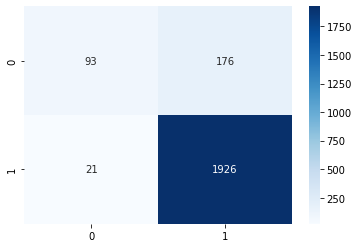

In [ ]:
import seaborn as sns

TPsum = np.sum(TPs)
TNsum = np.sum(TNs)
FPsum = np.sum(FPs)
FNsum = np.sum(FNs)

cm_data = [[TPsum, FNsum], [FPsum, TNsum]]
sns.heatmap(cm_data, annot=True, cmap='Blues', fmt='d')

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
RFWithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([RFWithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC        F1  ...   TP    TN   FP        FN
Average  15.5  0.911107  0.663375  0.429779  ...  3.1  64.2  0.7  5.866667

[1 rows x 11 columns]


In [ ]:
RFWithSMOTE = RFWithSMOTE.append(df_temp)

In [ ]:
print(RFWithSMOTE)
RFWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/Personalized/RFPersonalized.csv', index = True)

         User  Accuracy   ROC_AUC        F1  ...   TP    TN   FP         FN
0         1.0  0.878378  0.550000  0.181818  ...  1.0  64.0  0.0   9.000000
1         2.0  0.932432  0.583333  0.285714  ...  1.0  68.0  0.0   5.000000
2         3.0  0.905405  0.692187  0.533333  ...  4.0  63.0  1.0   6.000000
3         4.0  0.918919  0.817204  0.727273  ...  8.0  60.0  2.0   4.000000
4         5.0  0.891892  0.636364  0.428571  ...  3.0  63.0  0.0   8.000000
5         6.0  0.918919  0.625000  0.400000  ...  2.0  66.0  0.0   6.000000
6         7.0  0.917808  0.666667  0.500000  ...  3.0  64.0  0.0   6.000000
7         8.0  0.905405  0.611111  0.363636  ...  2.0  65.0  0.0   7.000000
8         9.0  0.959459  0.850000  0.823529  ...  7.0  64.0  0.0   3.000000
9        10.0  0.904110  0.691558  0.461538  ...  3.0  63.0  3.0   4.000000
10       11.0  0.945946  0.859848  0.750000  ...  6.0  64.0  2.0   2.000000
11       12.0  0.878378  0.500000  0.000000  ...  0.0  65.0  0.0   9.000000
12       13.

###Descision Tree

####Model

In [ ]:
from sklearn.tree import DecisionTreeClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_dt = DecisionTreeClassifier()
    tic = time.time()
    model_dt.fit(X_train, y_train) 
    toc = time.time()
    print("Decision Tree Train time = " + str(toc-tic))
    print("Decision Tree Accuracy = "+ str(model_dt.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_dt.predict(X_test)
    yhat_classes = (model_dt.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Decision Tree Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Decision Tree Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

Decision Tree Train time = 0.006003141403198242
Decision Tree Accuracy = 0.8918918918918919
Decision Tree Test time = 0.00476837158203125
(74,)
(74,)
___________________Decision Tree Stats _____________________
Accuracy: 0.891892
True negatives: 61
True positives: 5
False positives: 3
False negatives: 5
ROC AUC: 0.726562
F1 Score: 0.555556
Precision: 0.625000
TPR: 0.500000
FPR: 0.046875
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.0051462650299072266
Decision Tree Accuracy = 0.9594594594594594
Decision Tree Test time = 0.004725456237792969
(74,)
(74,)
___________________Decision Tree Stats _____________________
Accuracy: 0.959459
True negatives: 67
True positives: 4
False positives: 1
False negatives: 2
ROC AUC: 0.825980
F1 Score: 0.727273
Precision: 0.800000
TPR: 0.666667
FPR: 0.014706
____________________________________________________________
___________________________________

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
DTWithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DTWithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC        F1  ...        TP         TN        FP   FN
Average  15.5  0.912933  0.784195  0.618538  ...  5.466667  61.966667  2.933333  3.5

[1 rows x 11 columns]


In [ ]:
DTWithSMOTE = DTWithSMOTE.append(df_temp)

In [ ]:
print(DTWithSMOTE)
DTWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/Personalized/DTPersonalized.csv', index = True)

         User  Accuracy   ROC_AUC        F1  ...        TP         TN        FP   FN
0         1.0  0.891892  0.726562  0.555556  ...  5.000000  61.000000  3.000000  5.0
1         2.0  0.959459  0.825980  0.727273  ...  4.000000  67.000000  1.000000  2.0
2         3.0  0.945946  0.842187  0.777778  ...  7.000000  63.000000  1.000000  3.0
3         4.0  0.932432  0.858871  0.782609  ...  9.000000  60.000000  2.000000  3.0
4         5.0  0.932432  0.772727  0.705882  ...  6.000000  63.000000  0.000000  5.0
5         6.0  0.959459  0.867424  0.800000  ...  6.000000  65.000000  1.000000  2.0
6         7.0  0.931507  0.817708  0.705882  ...  6.000000  62.000000  2.000000  3.0
7         8.0  0.918919  0.810256  0.666667  ...  6.000000  62.000000  3.000000  3.0
8         9.0  0.945946  0.800000  0.750000  ...  6.000000  64.000000  0.000000  4.0
9        10.0  0.890411  0.683983  0.428571  ...  3.000000  62.000000  4.000000  4.0
10       11.0  0.918919  0.899621  0.700000  ...  7.000000  61.00

###Gradient Boost

####Model

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_gb = GradientBoostingClassifier(n_estimators = 1000) 
    tic = time.time()
    model_gb.fit(X_train, y_train) 
    toc = time.time()
    print("Gradient Boost Train time = " + str(toc-tic))
    print("Gradient Boost Accuracy = "+ str(model_gb.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_gb.predict(X_test)
    yhat_classes = (model_gb.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Gradient Boost Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Gradient Boost Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9831523895263672
Gradient Boost Accuracy = 0.918918918918919
Gradient Boost Test time = 0.008881807327270508
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.918919
True negatives: 64
True positives: 4
False positives: 0
False negatives: 6
ROC AUC: 0.700000
F1 Score: 0.571429
Precision: 1.000000
TPR: 0.400000
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.668607234954834
Gradient Boost Accuracy = 0.9594594594594594
Gradient Boost Test time = 0.00731968879699707
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.959459
True negatives: 67
True positives: 4
False positives: 1
False negatives: 2
ROC AUC: 0.825980
F1 Score: 0.727273
Precision: 0.800000
TPR: 0.666667
FPR: 0.014706
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.8965201377868652
Gradient Boost Accuracy = 0.9594594594594594
Gradient Boost Test time = 0.008644342422485352
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.959459
True negatives: 64
True positives: 7
False positives: 0
False negatives: 3
ROC AUC: 0.850000
F1 Score: 0.823529
Precision: 1.000000
TPR: 0.700000
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9518113136291504
Gradient Boost Accuracy = 0.9324324324324325
Gradient Boost Test time = 0.008225679397583008
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.932432
True negatives: 60
True positives: 9
False positives: 2
False negatives: 3
ROC AUC: 0.858871
F1 Score: 0.782609
Precision: 0.818182
TPR: 0.750000
FPR: 0.032258
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0955171585083008
Gradient Boost Accuracy = 0.918918918918919
Gradient Boost Test time = 0.009622573852539062
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.918919
True negatives: 62
True positives: 6
False positives: 1
False negatives: 5
ROC AUC: 0.764791
F1 Score: 0.666667
Precision: 0.857143
TPR: 0.545455
FPR: 0.015873
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0395967960357666
Gradient Boost Accuracy = 0.9864864864864865
Gradient Boost Test time = 0.008552789688110352
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.986486
True negatives: 66
True positives: 7
False positives: 0
False negatives: 1
ROC AUC: 0.937500
F1 Score: 0.933333
Precision: 1.000000
TPR: 0.875000
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0562751293182373
Gradient Boost Accuracy = 0.9041095890410958
Gradient Boost Test time = 0.012581348419189453
(73,)
(73,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.904110
True negatives: 63
True positives: 3
False positives: 1
False negatives: 6
ROC AUC: 0.658854
F1 Score: 0.461538
Precision: 0.750000
TPR: 0.333333
FPR: 0.015625
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9795053005218506
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.010647058486938477
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 63
True positives: 7
False positives: 2
False negatives: 2
ROC AUC: 0.873504
F1 Score: 0.777778
Precision: 0.777778
TPR: 0.777778
FPR: 0.030769
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0259110927581787
Gradient Boost Accuracy = 0.972972972972973
Gradient Boost Test time = 0.008735179901123047
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.972973
True negatives: 64
True positives: 8
False positives: 0
False negatives: 2
ROC AUC: 0.900000
F1 Score: 0.888889
Precision: 1.000000
TPR: 0.800000
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9954595565795898
Gradient Boost Accuracy = 0.9178082191780822
Gradient Boost Test time = 0.009075641632080078
(73,)
(73,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.917808
True negatives: 63
True positives: 4
False positives: 3
False negatives: 3
ROC AUC: 0.762987
F1 Score: 0.571429
Precision: 0.571429
TPR: 0.571429
FPR: 0.045455
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9420764446258545
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.008638381958007812
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 64
True positives: 6
False positives: 2
False negatives: 2
ROC AUC: 0.859848
F1 Score: 0.750000
Precision: 0.750000
TPR: 0.750000
FPR: 0.030303
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9457218647003174
Gradient Boost Accuracy = 0.9594594594594594
Gradient Boost Test time = 0.008696556091308594
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.959459
True negatives: 65
True positives: 6
False positives: 0
False negatives: 3
ROC AUC: 0.833333
F1 Score: 0.800000
Precision: 1.000000
TPR: 0.666667
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.938042402267456
Gradient Boost Accuracy = 0.9324324324324325
Gradient Boost Test time = 0.009944438934326172
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.932432
True negatives: 66
True positives: 3
False positives: 0
False negatives: 5
ROC AUC: 0.687500
F1 Score: 0.545455
Precision: 1.000000
TPR: 0.375000
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.8929181098937988
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.008518457412719727
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 66
True positives: 4
False positives: 1
False negatives: 3
ROC AUC: 0.778252
F1 Score: 0.666667
Precision: 0.800000
TPR: 0.571429
FPR: 0.014925
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0183615684509277
Gradient Boost Accuracy = 0.9594594594594594
Gradient Boost Test time = 0.009855508804321289
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.959459
True negatives: 64
True positives: 7
False positives: 1
False negatives: 2
ROC AUC: 0.881197
F1 Score: 0.823529
Precision: 0.875000
TPR: 0.777778
FPR: 0.015385
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0867338180541992
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.00930023193359375
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 66
True positives: 4
False positives: 0
False negatives: 4
ROC AUC: 0.750000
F1 Score: 0.666667
Precision: 1.000000
TPR: 0.500000
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9227073192596436
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.008960485458374023
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 62
True positives: 8
False positives: 3
False negatives: 1
ROC AUC: 0.921368
F1 Score: 0.800000
Precision: 0.727273
TPR: 0.888889
FPR: 0.046154
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.8489284515380859
Gradient Boost Accuracy = 0.9041095890410958
Gradient Boost Test time = 0.00931859016418457
(73,)
(73,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.904110
True negatives: 63
True positives: 3
False positives: 3
False negatives: 4
ROC AUC: 0.691558
F1 Score: 0.461538
Precision: 0.500000
TPR: 0.428571
FPR: 0.045455
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.1037592887878418
Gradient Boost Accuracy = 0.9054054054054054
Gradient Boost Test time = 0.009348869323730469
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.905405
True negatives: 59
True positives: 8
False positives: 3
False negatives: 4
ROC AUC: 0.809140
F1 Score: 0.695652
Precision: 0.727273
TPR: 0.666667
FPR: 0.048387
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9708671569824219
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.008968353271484375
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 63
True positives: 7
False positives: 1
False negatives: 3
ROC AUC: 0.842187
F1 Score: 0.777778
Precision: 0.875000
TPR: 0.700000
FPR: 0.015625
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0359959602355957
Gradient Boost Accuracy = 0.8648648648648649
Gradient Boost Test time = 0.009653568267822266
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.864865
True negatives: 61
True positives: 3
False positives: 3
False negatives: 7
ROC AUC: 0.626563
F1 Score: 0.375000
Precision: 0.500000
TPR: 0.300000
FPR: 0.046875
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.6819758415222168
Gradient Boost Accuracy = 0.972972972972973
Gradient Boost Test time = 0.00768733024597168
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.972973
True negatives: 66
True positives: 6
False positives: 0
False negatives: 2
ROC AUC: 0.875000
F1 Score: 0.857143
Precision: 1.000000
TPR: 0.750000
FPR: 0.000000
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9174489974975586
Gradient Boost Accuracy = 0.8648648648648649
Gradient Boost Test time = 0.0291292667388916
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.864865
True negatives: 60
True positives: 4
False positives: 4
False negatives: 6
ROC AUC: 0.668750
F1 Score: 0.444444
Precision: 0.500000
TPR: 0.400000
FPR: 0.062500
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.957878589630127
Gradient Boost Accuracy = 0.8648648648648649
Gradient Boost Test time = 0.010355472564697266
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.864865
True negatives: 63
True positives: 1
False positives: 2
False negatives: 8
ROC AUC: 0.540171
F1 Score: 0.166667
Precision: 0.333333
TPR: 0.111111
FPR: 0.030769
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.7349662780761719
Gradient Boost Accuracy = 0.918918918918919
Gradient Boost Test time = 0.019697904586791992
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.918919
True negatives: 62
True positives: 6
False positives: 1
False negatives: 5
ROC AUC: 0.764791
F1 Score: 0.666667
Precision: 0.857143
TPR: 0.545455
FPR: 0.015873
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.9943845272064209
Gradient Boost Accuracy = 0.9726027397260274
Gradient Boost Test time = 0.00851297378540039
(73,)
(73,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.972603
True negatives: 64
True positives: 7
False positives: 2
False negatives: 0
ROC AUC: 0.984848
F1 Score: 0.875000
Precision: 0.777778
TPR: 1.000000
FPR: 0.030303
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0447545051574707
Gradient Boost Accuracy = 0.9594594594594594
Gradient Boost Test time = 0.00917816162109375
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.959459
True negatives: 62
True positives: 9
False positives: 2
False negatives: 1
ROC AUC: 0.934375
F1 Score: 0.857143
Precision: 0.818182
TPR: 0.900000
FPR: 0.031250
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.0024936199188232
Gradient Boost Accuracy = 0.8513513513513513
Gradient Boost Test time = 0.009288787841796875
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.851351
True negatives: 60
True positives: 3
False positives: 6
False negatives: 5
ROC AUC: 0.642045
F1 Score: 0.352941
Precision: 0.333333
TPR: 0.375000
FPR: 0.090909
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 0.8269751071929932
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.008378982543945312
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 62
True positives: 8
False positives: 4
False negatives: 0
ROC AUC: 0.969697
F1 Score: 0.800000
Precision: 0.666667
TPR: 1.000000
FPR: 0.060606
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.1285345554351807
Gradient Boost Accuracy = 0.9324324324324325
Gradient Boost Test time = 0.009259939193725586
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.932432
True negatives: 64
True positives: 5
False positives: 1
False negatives: 4
ROC AUC: 0.770085
F1 Score: 0.666667
Precision: 0.833333
TPR: 0.555556
FPR: 0.015385
____________________________________________________________
____________________________________________________________


#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
GBWithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([GBWithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC        F1  ...        TP         TN        FP   FN
Average  15.5  0.931846  0.798773  0.675114  ...  5.566667  63.266667  1.633333  3.4

[1 rows x 11 columns]


In [ ]:
GBWithSMOTE = GBWithSMOTE.append(df_temp)

In [ ]:
print(GBWithSMOTE)
GBWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/Personalized/GBPersonalized.csv', index = True)

         User  Accuracy   ROC_AUC        F1  ...        TP         TN        FP   FN
0         1.0  0.918919  0.700000  0.571429  ...  4.000000  64.000000  0.000000  6.0
1         2.0  0.959459  0.825980  0.727273  ...  4.000000  67.000000  1.000000  2.0
2         3.0  0.959459  0.850000  0.823529  ...  7.000000  64.000000  0.000000  3.0
3         4.0  0.932432  0.858871  0.782609  ...  9.000000  60.000000  2.000000  3.0
4         5.0  0.918919  0.764791  0.666667  ...  6.000000  62.000000  1.000000  5.0
5         6.0  0.986486  0.937500  0.933333  ...  7.000000  66.000000  0.000000  1.0
6         7.0  0.904110  0.658854  0.461538  ...  3.000000  63.000000  1.000000  6.0
7         8.0  0.945946  0.873504  0.777778  ...  7.000000  63.000000  2.000000  2.0
8         9.0  0.972973  0.900000  0.888889  ...  8.000000  64.000000  0.000000  2.0
9        10.0  0.917808  0.762987  0.571429  ...  4.000000  63.000000  3.000000  3.0
10       11.0  0.945946  0.859848  0.750000  ...  6.000000  64.00

###3 DNN

#### Model

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model3 = Sequential()

    model3.add(Dense(64, activation='relu', input_shape=(X_train.shape[1],)))
    model3.add(Dropout(0.3))
    model3.add(Dense(32, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(8, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(1, activation='sigmoid'))

    model3.compile(loss='binary_crossentropy',
                  optimizer='adam',
                  metrics=['accuracy'])
    reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=0.001)
    tic = time.time()
    model3.fit(X_train, y_train, batch_size=64, epochs=100, validation_split=0.1, callbacks=[reduce_lr])
    toc = time.time()
    print("3 DNN Train time = " + str(toc-tic))
    print("3 DNN Accuracy = "+ str(model3.evaluate(X_test, y_test, verbose=0)[1]))
    tic = time.time()
    yhat_probs = model3.predict(X_test, verbose=0)
    yhat_classes = (model3.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("3 DNN Test time = " + str(toc-tic))
    yhat_probs = yhat_probs[:, 0]
    yhat_classes = yhat_classes[:, 0]
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________3 DNN Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

Epoch 1/100
3/3 [==============================] - 2s 185ms/step - loss: 1.3382 - accuracy: 0.2697 - val_loss: 1.0226 - val_accuracy: 0.0000e+00 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 19ms/step - loss: 1.1759 - accuracy: 0.3684 - val_loss: 0.7763 - val_accuracy: 0.2353 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 20ms/step - loss: 1.0543 - accuracy: 0.4013 - val_loss: 0.6051 - val_accuracy: 0.7647 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 22ms/step - loss: 0.8332 - accuracy: 0.5066 - val_loss: 0.4996 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 23ms/step - loss: 0.7877 - accuracy: 0.6316 - val_loss: 0.4195 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 21ms/step - loss: 0.7997 - accuracy: 0.6382 - val_loss: 0.3538 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 22ms/step - loss: 0.622

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


Epoch 1/100
3/3 [==============================] - 1s 161ms/step - loss: 1.5225 - accuracy: 0.4444 - val_loss: 0.7959 - val_accuracy: 0.2353 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 20ms/step - loss: 1.4697 - accuracy: 0.4444 - val_loss: 0.7156 - val_accuracy: 0.2353 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 20ms/step - loss: 0.8911 - accuracy: 0.5359 - val_loss: 0.6640 - val_accuracy: 0.6471 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 21ms/step - loss: 0.8106 - accuracy: 0.6536 - val_loss: 0.6306 - val_accuracy: 0.7647 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 20ms/step - loss: 0.7668 - accuracy: 0.7386 - val_loss: 0.6010 - val_accuracy: 0.9412 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 25ms/step - loss: 0.7443 - accuracy: 0.7255 - val_loss: 0.5680 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 20ms/step - loss: 0.8087 - 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


Epoch 1/100
3/3 [==============================] - 1s 164ms/step - loss: 1.1045 - accuracy: 0.5658 - val_loss: 0.5600 - val_accuracy: 0.7059 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 21ms/step - loss: 0.9317 - accuracy: 0.6184 - val_loss: 0.3084 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 22ms/step - loss: 0.7721 - accuracy: 0.7105 - val_loss: 0.1834 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 29ms/step - loss: 0.5793 - accuracy: 0.7895 - val_loss: 0.1308 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 24ms/step - loss: 0.6045 - accuracy: 0.7763 - val_loss: 0.1077 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 25ms/step - loss: 0.5765 - accuracy: 0.8355 - val_loss: 0.0986 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 23ms/step - loss: 0.5735 - 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


Epoch 1/100
3/3 [==============================] - 1s 160ms/step - loss: 0.9767 - accuracy: 0.5000 - val_loss: 0.4238 - val_accuracy: 0.8824 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 22ms/step - loss: 0.7474 - accuracy: 0.6382 - val_loss: 0.3288 - val_accuracy: 0.9412 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 24ms/step - loss: 0.6166 - accuracy: 0.6513 - val_loss: 0.2607 - val_accuracy: 0.9412 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 23ms/step - loss: 0.6181 - accuracy: 0.7105 - val_loss: 0.2124 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 20ms/step - loss: 0.5638 - accuracy: 0.7105 - val_loss: 0.1809 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 23ms/step - loss: 0.6446 - accuracy: 0.7237 - val_loss: 0.1659 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 21ms/step - loss: 0.6213 - 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


Epoch 1/100
3/3 [==============================] - 1s 159ms/step - loss: 0.8893 - accuracy: 0.5395 - val_loss: 0.5324 - val_accuracy: 0.8235 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 22ms/step - loss: 0.5837 - accuracy: 0.6513 - val_loss: 0.3610 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 22ms/step - loss: 0.5548 - accuracy: 0.7566 - val_loss: 0.2790 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 23ms/step - loss: 0.6609 - accuracy: 0.7697 - val_loss: 0.2326 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 21ms/step - loss: 0.5519 - accuracy: 0.7895 - val_loss: 0.2112 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 22ms/step - loss: 0.5539 - accuracy: 0.7829 - val_loss: 0.1998 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 19ms/step - loss: 0.6163 - 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


Epoch 1/100
3/3 [==============================] - 2s 417ms/step - loss: 1.2216 - accuracy: 0.3355 - val_loss: 0.7629 - val_accuracy: 0.2941 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 21ms/step - loss: 1.0755 - accuracy: 0.4013 - val_loss: 0.5808 - val_accuracy: 0.7647 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 24ms/step - loss: 0.8452 - accuracy: 0.5263 - val_loss: 0.4476 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 22ms/step - loss: 0.7494 - accuracy: 0.5724 - val_loss: 0.3476 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 25ms/step - loss: 0.6992 - accuracy: 0.6579 - val_loss: 0.2754 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 26ms/step - loss: 0.6357 - accuracy: 0.6579 - val_loss: 0.2232 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 31ms/step - loss: 0.5309 - 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


Epoch 1/100
3/3 [==============================] - 2s 159ms/step - loss: 1.7164 - accuracy: 0.2697 - val_loss: 1.3914 - val_accuracy: 0.0000e+00 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 23ms/step - loss: 1.3842 - accuracy: 0.3224 - val_loss: 1.0812 - val_accuracy: 0.0000e+00 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 24ms/step - loss: 1.0915 - accuracy: 0.4211 - val_loss: 0.8287 - val_accuracy: 0.2353 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 29ms/step - loss: 1.0427 - accuracy: 0.4276 - val_loss: 0.6277 - val_accuracy: 0.5882 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 25ms/step - loss: 0.8231 - accuracy: 0.5132 - val_loss: 0.4811 - val_accuracy: 0.8824 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 28ms/step - loss: 0.6798 - accuracy: 0.6184 - val_loss: 0.3863 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 24ms/step - loss: 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in long_scalars


Epoch 1/100
3/3 [==============================] - 1s 154ms/step - loss: 0.6862 - accuracy: 0.6118 - val_loss: 0.4136 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 2/100
3/3 [==============================] - 0s 30ms/step - loss: 0.5475 - accuracy: 0.7829 - val_loss: 0.3387 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 23ms/step - loss: 0.5524 - accuracy: 0.7763 - val_loss: 0.2964 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 4/100
3/3 [==============================] - 0s 22ms/step - loss: 0.4714 - accuracy: 0.8487 - val_loss: 0.2580 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 5/100
3/3 [==============================] - 0s 23ms/step - loss: 0.4848 - accuracy: 0.8816 - val_loss: 0.2242 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 6/100
3/3 [==============================] - 0s 27ms/step - loss: 0.4573 - accuracy: 0.8487 - val_loss: 0.1970 - val_accuracy: 1.0000 - lr: 0.0010
Epoch 7/100
3/3 [==============================] - 0s 26ms/step - loss: 0.4188 - 

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
DNN3WithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DNN3WithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy  ROC_AUC       F1  ...   TP    TN   FP        FN
Average  15.5  0.896211     0.86  0.30029  ...  2.3  63.9  1.0  6.666667

[1 rows x 11 columns]


In [ ]:
DNN3WithSMOTE = DNN3WithSMOTE.append(df_temp)

In [ ]:
print(DNN3WithSMOTE)
DNN3WithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/Personalized/DNNPersonalized.csv', index = True)

         User  Accuracy   ROC_AUC        F1  ...   TP    TN   FP         FN
0         1.0  0.864865  0.829688  0.166667  ...  1.0  63.0  1.0   9.000000
1         2.0  0.918919  0.980392  0.250000  ...  1.0  67.0  1.0   5.000000
2         3.0  0.905405  0.957812  0.588235  ...  5.0  62.0  2.0   5.000000
3         4.0  0.891892  0.879032  0.692308  ...  9.0  57.0  5.0   3.000000
4         5.0  0.864865  0.652237  0.166667  ...  1.0  63.0  0.0  10.000000
5         6.0  0.891892  0.916667  0.000000  ...  0.0  66.0  0.0   8.000000
6         7.0  0.876712  0.760417  0.000000  ...  0.0  64.0  0.0   9.000000
7         8.0  0.878378  0.731624  0.000000  ...  0.0  65.0  0.0   9.000000
8         9.0  0.945946  0.960938  0.777778  ...  7.0  63.0  1.0   3.000000
9        10.0  0.904110  0.911255  0.000000  ...  0.0  66.0  0.0   7.000000
10       11.0  0.945946  0.954545  0.750000  ...  6.0  64.0  2.0   2.000000
11       12.0  0.878378  0.870085  0.000000  ...  0.0  65.0  0.0   9.000000
12       13.

# Personalized models with SMOTE last N

## Data Processing

### Import dataset

In [ ]:
directory_all = "/content/drive/MyDrive/Surjya Sir Work/5000"
directory_pbd = "/content/drive/MyDrive/Surjya Sir Work/5000_probed"

In [ ]:
videos = [1,2,3,4,5,6,7,8]

In [ ]:
all = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_all + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    all.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 5
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 6
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


In [ ]:
probed = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_pbd + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    probed.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 5
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 6
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


### Create df

In [ ]:
df = pd.DataFrame()
for i in range(len(all)):#per video = 8
  for j in range(len(all[i])): #per subject = 30
    df = df.append(all[i][j], ignore_index=True)

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8


In [ ]:
tester = pd.DataFrame()
for i in range(len(probed)):#per video = 8
  for j in range(len(probed[i])): #per subject = 30
    tester = tester.append(probed[i][j], ignore_index=True)

In [ ]:
tester

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1738876.01,1743876.01,1748876.01,6.309,5.096,0.013,0.106,5.632759,0.600,0.378,0.155,0.010,0.369,1.642,8.131,10,1
1,832168.01,837168.01,842168.01,6.488,5.290,0.012,0.159,1.883567,0.300,3.623,0.126,0.021,0.657,0.246,0.000,11,1
2,907168.01,912168.01,917168.01,5.330,4.958,0.394,0.082,3.340205,0.103,3.119,0.136,0.004,7.022,0.699,0.123,11,1
3,917168.01,922168.01,927168.01,6.046,5.011,0.767,0.003,2.078420,0.213,0.785,0.136,0.007,4.846,0.041,0.040,11,1
4,922168.01,927168.01,932168.01,6.476,5.014,0.430,0.022,2.208317,0.307,4.601,0.068,0.010,4.148,1.191,0.288,11,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
843,2282834.01,2287834.01,2292834.01,2.090,7.542,0.918,0.586,3.800016,3.170,4.349,0.261,0.003,0.082,2.916,1.602,8,8
844,2287834.01,2292834.01,2297834.01,1.199,8.115,1.181,0.661,5.052202,4.889,8.049,1.549,0.039,0.164,1.315,2.587,8,8
845,1166459.01,1171459.01,1176459.01,3.156,6.595,0.518,0.543,4.114055,0.256,0.368,4.792,0.011,2.998,3.368,13.429,9,8
846,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8


In [ ]:
temp = df[df.isin(tester)].dropna()

In [ ]:
temp = df.loc[df.set_index(list(df.columns)).index.isin(tester.set_index(list(tester.columns)).index)]

In [ ]:
temp.index

Int64Index([  35,   47,   62,   64,   65,   70,   99,  107,  117,  118,
            ...
            7191, 7212, 7231, 7234, 7239, 7255, 7256, 7284, 7285, 7286],
           dtype='int64', length=848)

In [ ]:
df['Probe'] = 0

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,0
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,0
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
for idx in temp.index:
  df.at[idx, 'Probe'] = 1

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


### Optimise df

In [ ]:
df = df.drop(columns=["Start", "Border", "End"], axis=1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
df['valence_acc_video'] = 0
df['arousal_acc_video'] = 0

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,0,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,0,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,0,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,0,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,0
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,0
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,0
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,0


I'm using the following encoding: 

1 - Low
2 - Mid/high
3 - High

In [ ]:
# def basedOnVideoValence(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 2
#     if int(video) == 6:
#         return 2
#     if int(video) == 7:
#         return 1
#     if int(video) == 8:
#         return 1
    
# def basedOnVideoArousal(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 1
#     if int(video) == 6:
#         return 1
#     if int(video) == 7:
#         return 3
#     if int(video) == 8:
#         return 3

New encoding, 
Low - 0 
Med / High - 1

In [ ]:
def basedOnVideoValence(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 1
    if int(video) == 6:
        return 1
    if int(video) == 7:
        return 0
    if int(video) == 8:
        return 0
    
def basedOnVideoArousal(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 0
    if int(video) == 6:
        return 0
    if int(video) == 7:
        return 1
    if int(video) == 8:
        return 1

In [ ]:
df['valence_acc_video'] = df.apply(lambda row : basedOnVideoValence(row['video']), axis = 1)
df['arousal_acc_video'] = df.apply(lambda row : basedOnVideoArousal(row['video']), axis = 1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1


### Last N

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1


In [ ]:
df['last1'] = np.where(df['Probe'].shift(1) == 1,1,0)
df['last2'] = np.where(df['Probe'].shift(2) == 1,1,0)
df['last3'] = np.where(df['Probe'].shift(3) == 1,1,0)
df['last4'] = np.where(df['Probe'].shift(4) == 1,1,0)
df['last5'] = np.where(df['Probe'].shift(5) == 1,1,0)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video,last1,last2,last3,last4,last5
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1,0,0,0,0,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1,0,0,0,0,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1,0,0,0,0,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1,0,0,0,0,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1,1,0,0,0,0
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1,1,1,0,0,0
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1,1,1,1,0,0
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1,0,1,1,1,0


In [ ]:
# df['Last1'] = 0
# df['Last2'] = 0
# df['Last3'] = 0
# df['Last4'] = 0
# df['Last5'] = 0

df['Last1'] = df.apply(lambda row: (row.last1)/1, axis=1)
df['Last2'] = df.apply(lambda row: (row.last1 + row.last2)/2, axis=1)
df['Last3'] = df.apply(lambda row: (row.last1 + row.last2 + row.last3)/3, axis=1)
df['Last4'] = df.apply(lambda row: (row.last1 + row.last2 + row.last3 + row.last4)/4, axis=1)
df['Last5'] = df.apply(lambda row: (row.last1 + row.last2 + row.last3 + row.last4 + row.last5)/5, axis=1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video,last1,last2,last3,last4,last5,Last1,Last2,Last3,Last4,Last5
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1,0,0,0,0,0,0.0,0.0,0.000000,0.00,0.0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1,0,0,0,0,0,0.0,0.0,0.000000,0.00,0.0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1,0,0,0,0,0,0.0,0.0,0.000000,0.00,0.0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1,0,0,0,0,0,0.0,0.0,0.000000,0.00,0.0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1,0,0,0,0,0,0.0,0.0,0.000000,0.00,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1,1,0,0,0,0,1.0,0.5,0.333333,0.25,0.2
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1,1,1,0,0,0,1.0,1.0,0.666667,0.50,0.4
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1,1,1,1,0,0,1.0,1.0,1.000000,0.75,0.6
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1,0,1,1,1,0,0.0,0.5,0.666667,0.75,0.6


In [ ]:
df = df.drop(columns=["last1", "last2", "last3", "last4", "last5"], axis = 1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video,Last1,Last2,Last3,Last4,Last5
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1,0.0,0.0,0.000000,0.00,0.0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1,0.0,0.0,0.000000,0.00,0.0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1,0.0,0.0,0.000000,0.00,0.0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1,0.0,0.0,0.000000,0.00,0.0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1,0.0,0.0,0.000000,0.00,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1,1.0,0.5,0.333333,0.25,0.2
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1,1.0,1.0,0.666667,0.50,0.4
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1,1.0,1.0,1.000000,0.75,0.6
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1,0.0,0.5,0.666667,0.75,0.6


### X,y for personalized models

In [ ]:
X_train_all = []
y_train_all = []
X_test_all = []
y_test_all = []

In [ ]:
users = []
for i in range(1, 31):
  users.append(i)

print(users)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30]


In [ ]:
for user in users:
  print("User", user)
  X_train = pd.DataFrame()
  y_train = pd.DataFrame()
  X_test = pd.DataFrame()
  y_test = pd.DataFrame()
  df_new = df[df['subject'] == str(user)]
  df_probe = df_new[df_new['Probe'] == 1]
  df_nonprobe = df_new[df_new['Probe'] == 0]

  y_probe = df_probe['Probe']
  y_nonprobe = df_nonprobe['Probe']

  y_probe = pd.DataFrame(y_probe)
  y_nonprobe = pd.DataFrame(y_nonprobe)

  X_probe = df_probe.drop(columns=["Probe"], axis = 1)
  X_nonprobe = df_nonprobe.drop(columns=["Probe"], axis = 1)

  X_train_probe, X_test_probe, y_train_probe, y_test_probe = train_test_split(X_probe, y_probe, test_size = 0.3)
  X_train_nonprobe, X_test_nonprobe, y_train_nonprobe, y_test_nonprobe = train_test_split(X_nonprobe, y_nonprobe, test_size = 0.3)

  X_train = X_train.append(X_train_probe)
  X_train = X_train.append(X_train_nonprobe)
  X_test = X_test.append(X_test_probe)
  X_test = X_test.append(X_test_nonprobe)
  y_train = y_train.append(y_train_probe)
  y_train = y_train.append(y_train_nonprobe)
  y_test = y_test.append(y_test_probe)
  y_test = y_test.append(y_test_nonprobe)


  
  # for video in videos:
  #   print("    Video", video)
  #   df_selected = df_new[df_new['video'] == video]
  #   df_probe = df_selected[df_selected['Probe'] == 1]
  #   df_nonprobe = df_selected[df_selected['Probe'] == 0]

  #   y_probe = df_probe['Probe']
  #   y_nonprobe = df_nonprobe['Probe']

  #   y_probe = pd.DataFrame(y_probe)
  #   y_nonprobe = pd.DataFrame(y_nonprobe)

  #   X_probe = df_probe.drop(columns=["Probe"], axis = 1)
  #   X_nonprobe = df_nonprobe.drop(columns=["Probe"], axis = 1)

  #   X_train_probe, X_test_probe, y_train_probe, y_test_probe = train_test_split(X_probe, y_probe, test_size = 0.5)
  #   X_train_nonprobe, X_test_nonprobe, y_train_nonprobe, y_test_nonprobe = train_test_split(X_nonprobe, y_nonprobe, test_size = 0.2)
  
  #   X_train = X_train.append(X_train_probe)
  #   X_train = X_train.append(X_train_nonprobe)
  #   X_test = X_test.append(X_test_probe)
  #   X_test = X_test.append(X_test_nonprobe)
  #   y_train = y_train.append(y_train_probe)
  #   y_train = y_train.append(y_train_nonprobe)
  #   y_test = y_test.append(y_test_probe)
  #   y_test = y_test.append(y_test_nonprobe)
  X_train_all.append(X_train)
  y_train_all.append(y_train)
  X_test_all.append(X_test)
  y_test_all.append(y_test)

User 1
User 2
User 3
User 4
User 5
User 6
User 7
User 8
User 9
User 10
User 11
User 12
User 13
User 14
User 15
User 16
User 17
User 18
User 19
User 20
User 21
User 22
User 23
User 24
User 25
User 26
User 27
User 28
User 29
User 30


In [ ]:
print(len(X_train_all[29]['subject'].unique()))

1


In [ ]:
X_train_all[2]

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,valence_acc_video,arousal_acc_video,Last1,Last2,Last3,Last4,Last5
6240,1.532,9.500,0.218,0.000,8.973229,0.627,2.237,1.346,0.000,1.971,9.446,0.616,3,7,0,1,0.0,0.0,0.000000,0.00,0.0
3458,4.964,4.552,0.000,0.000,1.610015,0.571,0.300,0.609,0.021,0.000,0.000,0.534,3,4,0,0,0.0,0.0,0.000000,0.00,0.0
6221,4.584,7.063,0.707,1.024,9.848254,2.570,0.407,0.504,0.010,0.699,0.575,0.287,3,7,0,1,0.0,0.0,0.000000,0.00,0.0
3459,4.964,4.552,0.003,0.000,3.543979,0.603,0.048,0.048,0.007,6.982,0.246,0.000,3,4,0,0,1.0,0.5,0.333333,0.25,0.2
3447,4.977,4.105,0.020,0.747,1.488032,0.769,0.038,0.145,0.000,0.042,1.150,0.123,3,4,0,0,0.0,0.0,0.000000,0.00,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5157,6.063,4.787,0.001,0.000,0.941371,0.638,0.407,0.009,0.014,0.247,0.041,0.124,3,6,1,0,0.0,0.0,0.000000,0.00,0.0
5167,6.061,4.776,0.000,0.014,0.500018,0.504,1.327,1.655,0.007,1.232,0.534,0.493,3,6,1,0,0.0,0.0,0.000000,0.00,0.0
7119,2.098,8.910,0.017,0.281,0.417426,0.158,2.402,1.007,0.014,0.165,0.903,0.452,3,8,0,1,0.0,0.0,0.000000,0.25,0.2
1866,5.802,6.616,0.469,0.396,5.045085,1.975,0.145,0.136,0.010,8.132,0.575,2.875,3,2,1,1,0.0,0.0,0.000000,0.00,0.0


In [ ]:
new_X_train_all = []

for i in range(len(X_train_all)):
    df_temp = X_train_all[i]
    #df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    df_temp = df_temp.drop(columns=["subject"], axis = 1)
    new_X_train_all.append(df_temp)

X_train_all = new_X_train_all

new_X_test_all = []

for i in range(len(X_test_all)):
    df_temp = X_test_all[i]
    #df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    df_temp = df_temp.drop(columns=["subject"], axis = 1)
    new_X_test_all.append(df_temp)

X_test_all = new_X_test_all

In [ ]:
X_train_all[2]

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,video,valence_acc_video,arousal_acc_video,Last1,Last2,Last3,Last4,Last5
6240,1.532,9.500,0.218,0.000,8.973229,0.627,2.237,1.346,0.000,1.971,9.446,0.616,7,0,1,0.0,0.0,0.000000,0.00,0.0
3458,4.964,4.552,0.000,0.000,1.610015,0.571,0.300,0.609,0.021,0.000,0.000,0.534,4,0,0,0.0,0.0,0.000000,0.00,0.0
6221,4.584,7.063,0.707,1.024,9.848254,2.570,0.407,0.504,0.010,0.699,0.575,0.287,7,0,1,0.0,0.0,0.000000,0.00,0.0
3459,4.964,4.552,0.003,0.000,3.543979,0.603,0.048,0.048,0.007,6.982,0.246,0.000,4,0,0,1.0,0.5,0.333333,0.25,0.2
3447,4.977,4.105,0.020,0.747,1.488032,0.769,0.038,0.145,0.000,0.042,1.150,0.123,4,0,0,0.0,0.0,0.000000,0.00,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5157,6.063,4.787,0.001,0.000,0.941371,0.638,0.407,0.009,0.014,0.247,0.041,0.124,6,1,0,0.0,0.0,0.000000,0.00,0.0
5167,6.061,4.776,0.000,0.014,0.500018,0.504,1.327,1.655,0.007,1.232,0.534,0.493,6,1,0,0.0,0.0,0.000000,0.00,0.0
7119,2.098,8.910,0.017,0.281,0.417426,0.158,2.402,1.007,0.014,0.165,0.903,0.452,8,0,1,0.0,0.0,0.000000,0.25,0.2
1866,5.802,6.616,0.469,0.396,5.045085,1.975,0.145,0.136,0.010,8.132,0.575,2.875,2,1,1,0.0,0.0,0.000000,0.00,0.0


In [ ]:
y_test_all[7]

,Probe
1040,1
3610,1
3626,1
4444,1
3619,1
...,...
6407,0
2692,0
3624,0
4469,0


### SMOTE

In [ ]:
print(X_train_all[0])

      Valence  Arousal  Valence Diff  ...     Last3  Last4  Last5
3941    5.599    4.734         0.802  ...  0.333333    0.5    0.6
1429    8.958    6.362         0.450  ...  0.333333    0.5    0.4
4781    4.835    5.844         0.265  ...  0.666667    0.5    0.4
5731    0.731    9.500         2.453  ...  0.000000    0.0    0.0
3950    6.018    5.896         2.253  ...  0.000000    0.0    0.0
...       ...      ...           ...  ...       ...    ...    ...
5725    4.781    6.073         0.008  ...  0.000000    0.0    0.0
6756    3.922    5.870         0.220  ...  0.000000    0.0    0.0
2292    4.963    4.558         0.774  ...  0.000000    0.0    0.0
369     7.103    5.550         0.147  ...  0.000000    0.0    0.0
3065    6.940    4.598         0.000  ...  0.000000    0.0    0.0

[169 rows x 20 columns]


In [ ]:
from imblearn.over_sampling import SMOTE
new_X_train_all = []
new_y_train_all = []

for i in range(len(X_train_all)):
  X_resampled, y_resampled = SMOTE('auto').fit_resample(X_train_all[i], y_train_all[i])
  new_X_train_all.append(X_resampled)
  new_y_train_all.append(y_resampled)

X_train_all = new_X_train_all
y_train_all = new_y_train_all

# new_X_test_all = []
# new_y_test_all = []

# for i in range(len(X_train_all)):
#   X_resampled, y_resampled = SMOTE('minority').fit_resample(X_test_all[i], y_test_all[i])
#   new_X_test_all.append(X_resampled)
#   new_y_test_all.append(y_resampled)

# X_test_all = new_X_test_all
# y_test_all = new_y_test_all

/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: Future

In [ ]:
print(X_train_all[0])

      Valence   Arousal  Valence Diff  ...     Last3     Last4     Last5
0    5.599000  4.734000      0.802000  ...  0.333333  0.500000  0.600000
1    8.958000  6.362000      0.450000  ...  0.333333  0.500000  0.400000
2    4.835000  5.844000      0.265000  ...  0.666667  0.500000  0.400000
3    0.731000  9.500000      2.453000  ...  0.000000  0.000000  0.000000
4    6.018000  5.896000      2.253000  ...  0.000000  0.000000  0.000000
..        ...       ...           ...  ...       ...       ...       ...
291  4.867553  5.683095      0.233997  ...  0.563323  0.422493  0.337994
292  9.010104  6.181806      0.452895  ...  0.212721  0.319082  0.255266
293  9.366871  7.544853      0.137809  ...  0.020823  0.015617  0.012494
294  0.975377  9.300702      0.627118  ...  0.168078  0.126058  0.100847
295  3.482451  8.499701      1.763333  ...  0.104590  0.078443  0.062754

[296 rows x 20 columns]


## Models

###RandomForest

#### Model

In [ ]:
from sklearn.ensemble import RandomForestClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []

TPs = []
FPs = []
FNs = []
TNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_rf = RandomForestClassifier() 
    tic = time.time()
    print("X_train_size = ", str(len(X_train)))
    print("X_test_size = ", str(len(X_test)))
    model_rf.fit(X_train, y_train) 
    toc = time.time()
    print("Random Forest Train time = " + str(toc-tic))
    print("Random Forest Accuracy = "+ str(model_rf.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_rf.predict(X_test)
    print("yhat_probs",yhat_probs)
    yhat_classes = (model_rf.predict(X_test) > 0.5).astype("int32")
    print("yhat_classes",yhat_classes)
    toc = time.time()
    print("Random Forest Test time = " + str(toc-tic))

    print("___________________Random Forest Stats _____________________")

    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

X_train_size =  296
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.30086588859558105
Random Forest Accuracy = 0.8648648648648649
yhat_probs [0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04970097541809082
___________________Random Forest Stats _____________________
Accuracy: 0.864865
True negatives: 63
True positives: 1
False positives: 1
False negatives: 9
ROC AUC: 0.542188
F1 Score: 0.166667
Precision: 0.500000
TPR: 0.100000
FPR: 0.015625
____________________________________________________________
____________________________________________________________
X_train_size =  314
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.29331254959106445
Random Forest Accuracy = 0.9054054054054054
yhat_probs [0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04928421974182129
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 66
True positives: 1
False positives: 2
False negatives: 5
ROC AUC: 0.568627
F1 Score: 0.222222
Precision: 0.333333
TPR: 0.166667
FPR: 0.029412
____________________________________________________________
____________________________________________________________
X_train_size =  296
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2858083248138428
Random Forest Accuracy = 0.9054054054054054
yhat_probs [0 0 0 1 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 1 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04643440246582031
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 64
True positives: 3
False positives: 0
False negatives: 7
ROC AUC: 0.650000
F1 Score: 0.461538
Precision: 1.000000
TPR: 0.300000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  286
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.29453134536743164
Random Forest Accuracy = 0.9054054054054054
yhat_probs [0 1 1 0 1 0 1 1 1 1 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0
 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 1 0 1 0 1 1 1 1 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0
 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.049089908599853516
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 58
True positives: 9
False positives: 4
False negatives: 3
ROC AUC: 0.842742
F1 Score: 0.720000
Precision: 0.692308
TPR: 0.750000
FPR: 0.064516
____________________________________________________________
____________________________________________________________
X_train_size =  288
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2771022319793701
Random Forest Accuracy = 0.8783783783783784
yhat_probs [0 1 1 1 0 1 0 1 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0
 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 1 1 0 1 0 1 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0
 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04697394371032715
___________________Random Forest Stats _____________________
Accuracy: 0.878378
True negatives: 59
True positives: 6
False positives: 4
False negatives: 5
ROC AUC: 0.740981
F1 Score: 0.571429
Precision: 0.600000
TPR: 0.545455
FPR: 0.063492
____________________________________________________________
____________________________________________________________
X_train_size =  304
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2774534225463867
Random Forest Accuracy = 0.9459459459459459
yhat_probs [1 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.07341480255126953
___________________Random Forest Stats _____________________
Accuracy: 0.945946
True negatives: 66
True positives: 4
False positives: 0
False negatives: 4
ROC AUC: 0.750000
F1 Score: 0.666667
Precision: 1.000000
TPR: 0.500000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  298
X_test_size =  73


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2887418270111084
Random Forest Accuracy = 0.9041095890410958
yhat_probs [1 1 1 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 1 0 0 0 0 0 0 0 0 0 1 0]
yhat_classes [1 1 1 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 1 0 0 0 0 0 0 0 0 0 1 0]
Random Forest Test time = 0.04961204528808594
___________________Random Forest Stats _____________________
Accuracy: 0.904110
True negatives: 60
True positives: 6
False positives: 4
False negatives: 3
ROC AUC: 0.802083
F1 Score: 0.631579
Precision: 0.600000
TPR: 0.666667
FPR: 0.062500
____________________________________________________________
____________________________________________________________
X_train_size =  302
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.3056344985961914
Random Forest Accuracy = 0.8648648648648649
yhat_probs [0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.05006051063537598
___________________Random Forest Stats _____________________
Accuracy: 0.864865
True negatives: 63
True positives: 1
False positives: 2
False negatives: 8
ROC AUC: 0.540171
F1 Score: 0.166667
Precision: 0.333333
TPR: 0.111111
FPR: 0.030769
____________________________________________________________
____________________________________________________________
X_train_size =  294
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.29964494705200195
Random Forest Accuracy = 0.8918918918918919
yhat_probs [1 0 0 1 1 1 0 0 1 1 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 1 1 1 0 0 1 1 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04591703414916992
___________________Random Forest Stats _____________________
Accuracy: 0.891892
True negatives: 60
True positives: 6
False positives: 4
False negatives: 4
ROC AUC: 0.768750
F1 Score: 0.600000
Precision: 0.600000
TPR: 0.600000
FPR: 0.062500
____________________________________________________________
____________________________________________________________
X_train_size =  308
X_test_size =  73


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2830941677093506
Random Forest Accuracy = 0.9452054794520548
yhat_probs [1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.0469057559967041
___________________Random Forest Stats _____________________
Accuracy: 0.945205
True negatives: 66
True positives: 3
False positives: 0
False negatives: 4
ROC AUC: 0.714286
F1 Score: 0.600000
Precision: 1.000000
TPR: 0.428571
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  302
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.277268648147583
Random Forest Accuracy = 0.9324324324324325
yhat_probs [0 1 1 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 1 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04640674591064453
___________________Random Forest Stats _____________________
Accuracy: 0.932432
True negatives: 64
True positives: 5
False positives: 2
False negatives: 3
ROC AUC: 0.797348
F1 Score: 0.666667
Precision: 0.714286
TPR: 0.625000
FPR: 0.030303
____________________________________________________________
____________________________________________________________
X_train_size =  300
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.28784632682800293
Random Forest Accuracy = 0.8513513513513513
yhat_probs [0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.045966386795043945
___________________Random Forest Stats _____________________
Accuracy: 0.851351
True negatives: 61
True positives: 2
False positives: 4
False negatives: 7
ROC AUC: 0.580342
F1 Score: 0.266667
Precision: 0.333333
TPR: 0.222222
FPR: 0.061538
____________________________________________________________
____________________________________________________________
X_train_size =  304
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.29290294647216797
Random Forest Accuracy = 0.8648648648648649
yhat_probs [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04705691337585449
___________________Random Forest Stats _____________________
Accuracy: 0.864865
True negatives: 64
True positives: 0
False positives: 2
False negatives: 8
ROC AUC: 0.484848
F1 Score: 0.000000
Precision: 0.000000
TPR: 0.000000
FPR: 0.030303
____________________________________________________________
____________________________________________________________
X_train_size =  310
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2855570316314697
Random Forest Accuracy = 0.9324324324324325
yhat_probs [1 1 1 0 1 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 1 0 1 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04779195785522461
___________________Random Forest Stats _____________________
Accuracy: 0.932432
True negatives: 65
True positives: 4
False positives: 2
False negatives: 3
ROC AUC: 0.770789
F1 Score: 0.615385
Precision: 0.666667
TPR: 0.571429
FPR: 0.029851
____________________________________________________________
____________________________________________________________
X_train_size =  302
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.28504228591918945
Random Forest Accuracy = 0.9054054054054054
yhat_probs [1 0 0 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04578566551208496
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 63
True positives: 4
False positives: 2
False negatives: 5
ROC AUC: 0.706838
F1 Score: 0.533333
Precision: 0.666667
TPR: 0.444444
FPR: 0.030769
____________________________________________________________
____________________________________________________________
X_train_size =  302
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.30432891845703125
Random Forest Accuracy = 0.8648648648648649
yhat_probs [0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04642891883850098
___________________Random Forest Stats _____________________
Accuracy: 0.864865
True negatives: 63
True positives: 1
False positives: 3
False negatives: 7
ROC AUC: 0.539773
F1 Score: 0.166667
Precision: 0.250000
TPR: 0.125000
FPR: 0.045455
____________________________________________________________
____________________________________________________________
X_train_size =  302
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.29073429107666016
Random Forest Accuracy = 0.8513513513513513
yhat_probs [0 1 1 0 1 0 0 0 1 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0]
yhat_classes [0 1 1 0 1 0 0 0 1 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0]
Random Forest Test time = 0.05885052680969238
___________________Random Forest Stats _____________________
Accuracy: 0.851351
True negatives: 59
True positives: 4
False positives: 6
False negatives: 5
ROC AUC: 0.676068
F1 Score: 0.421053
Precision: 0.400000
TPR: 0.444444
FPR: 0.092308
____________________________________________________________
____________________________________________________________
X_train_size =  308
X_test_size =  73


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.27632832527160645
Random Forest Accuracy = 0.9041095890410958
yhat_probs [0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0]
yhat_classes [0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0]
Random Forest Test time = 0.0470433235168457
___________________Random Forest Stats _____________________
Accuracy: 0.904110
True negatives: 64
True positives: 2
False positives: 2
False negatives: 5
ROC AUC: 0.627706
F1 Score: 0.363636
Precision: 0.500000
TPR: 0.285714
FPR: 0.030303
____________________________________________________________
____________________________________________________________
X_train_size =  288
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2848496437072754
Random Forest Accuracy = 0.9054054054054054
yhat_probs [0 1 1 0 0 1 0 0 1 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 1 0 0 1 0 0 1 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04648566246032715
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 61
True positives: 6
False positives: 1
False negatives: 6
ROC AUC: 0.741935
F1 Score: 0.631579
Precision: 0.857143
TPR: 0.500000
FPR: 0.016129
____________________________________________________________
____________________________________________________________
X_train_size =  294
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.29430627822875977
Random Forest Accuracy = 0.9054054054054054
yhat_probs [0 1 0 1 1 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 1
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 0 1 1 1 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 1
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04677844047546387
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 60
True positives: 7
False positives: 4
False negatives: 3
ROC AUC: 0.818750
F1 Score: 0.666667
Precision: 0.636364
TPR: 0.700000
FPR: 0.062500
____________________________________________________________
____________________________________________________________
X_train_size =  296
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.29557228088378906
Random Forest Accuracy = 0.9054054054054054
yhat_probs [0 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.050429582595825195
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 63
True positives: 4
False positives: 1
False negatives: 6
ROC AUC: 0.692187
F1 Score: 0.533333
Precision: 0.800000
TPR: 0.400000
FPR: 0.015625
____________________________________________________________
____________________________________________________________
X_train_size =  302
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2763369083404541
Random Forest Accuracy = 0.9054054054054054
yhat_probs [0 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.047962188720703125
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 64
True positives: 3
False positives: 2
False negatives: 5
ROC AUC: 0.672348
F1 Score: 0.461538
Precision: 0.600000
TPR: 0.375000
FPR: 0.030303
____________________________________________________________
____________________________________________________________
X_train_size =  294
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.29573726654052734
Random Forest Accuracy = 0.8783783783783784
yhat_probs [0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.047266483306884766
___________________Random Forest Stats _____________________
Accuracy: 0.878378
True negatives: 64
True positives: 1
False positives: 0
False negatives: 9
ROC AUC: 0.550000
F1 Score: 0.181818
Precision: 1.000000
TPR: 0.100000
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  298
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2813553810119629
Random Forest Accuracy = 0.9054054054054054
yhat_probs [0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04643750190734863
___________________Random Forest Stats _____________________
Accuracy: 0.905405
True negatives: 65
True positives: 2
False positives: 0
False negatives: 7
ROC AUC: 0.611111
F1 Score: 0.363636
Precision: 1.000000
TPR: 0.222222
FPR: 0.000000
____________________________________________________________
____________________________________________________________
X_train_size =  292
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2771883010864258
Random Forest Accuracy = 0.8513513513513513
yhat_probs [1 1 0 1 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 0 1 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04655766487121582
___________________Random Forest Stats _____________________
Accuracy: 0.851351
True negatives: 58
True positives: 5
False positives: 5
False negatives: 6
ROC AUC: 0.687590
F1 Score: 0.476190
Precision: 0.500000
TPR: 0.454545
FPR: 0.079365
____________________________________________________________
____________________________________________________________
X_train_size =  308
X_test_size =  73


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2852613925933838
Random Forest Accuracy = 0.9452054794520548
yhat_probs [1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04662728309631348
___________________Random Forest Stats _____________________
Accuracy: 0.945205
True negatives: 64
True positives: 5
False positives: 2
False negatives: 2
ROC AUC: 0.841991
F1 Score: 0.714286
Precision: 0.714286
TPR: 0.714286
FPR: 0.030303
____________________________________________________________
____________________________________________________________
X_train_size =  296
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2776668071746826
Random Forest Accuracy = 0.8513513513513513
yhat_probs [1 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.0466923713684082
___________________Random Forest Stats _____________________
Accuracy: 0.851351
True negatives: 61
True positives: 2
False positives: 3
False negatives: 8
ROC AUC: 0.576562
F1 Score: 0.266667
Precision: 0.400000
TPR: 0.200000
FPR: 0.046875
____________________________________________________________
____________________________________________________________
X_train_size =  306
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.29688119888305664
Random Forest Accuracy = 0.8648648648648649
yhat_probs [0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.04653286933898926
___________________Random Forest Stats _____________________
Accuracy: 0.864865
True negatives: 62
True positives: 2
False positives: 4
False negatives: 6
ROC AUC: 0.594697
F1 Score: 0.285714
Precision: 0.333333
TPR: 0.250000
FPR: 0.060606
____________________________________________________________
____________________________________________________________
X_train_size =  302
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.2990286350250244
Random Forest Accuracy = 0.918918918918919
yhat_probs [0 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1]
yhat_classes [0 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1]
Random Forest Test time = 0.04813671112060547
___________________Random Forest Stats _____________________
Accuracy: 0.918919
True negatives: 65
True positives: 3
False positives: 1
False negatives: 5
ROC AUC: 0.679924
F1 Score: 0.500000
Precision: 0.750000
TPR: 0.375000
FPR: 0.015152
____________________________________________________________
____________________________________________________________
X_train_size =  298
X_test_size =  74


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Random Forest Train time = 0.27950596809387207
Random Forest Accuracy = 0.8513513513513513
yhat_probs [1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0
 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
yhat_classes [1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0
 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Random Forest Test time = 0.05411076545715332
___________________Random Forest Stats _____________________
Accuracy: 0.851351
True negatives: 60
True positives: 3
False positives: 5
False negatives: 6
ROC AUC: 0.628205
F1 Score: 0.352941
Precision: 0.375000
TPR: 0.333333
FPR: 0.076923
____________________________________________________________
____________________________________________________________


#### Results

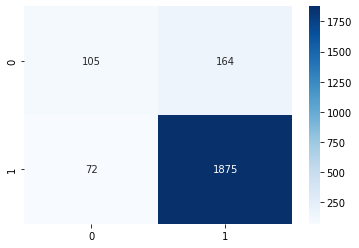

In [ ]:
import seaborn as sns

TPsum = np.sum(TPs)
TNsum = np.sum(TNs)
FPsum = np.sum(FPs)
FNsum = np.sum(FNs)


cm_data = [[TPsum, FNsum], [FPsum, TNsum]]
sns.heatmap(cm_data, annot=True, cmap='Blues', fmt='d')

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
RFWithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([RFWithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC        F1  ...   TP    TN   FP        FN
Average  15.5  0.893558  0.673295  0.442485  ...  3.5  62.5  2.4  5.466667

[1 rows x 11 columns]


In [ ]:
RFWithSMOTE = RFWithSMOTE.append(df_temp)

In [ ]:
print(RFWithSMOTE)
RFWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/Personalized/RFPersonalizedSMOTE.csv', index = True)

         User  Accuracy   ROC_AUC        F1  ...   TP    TN   FP        FN
0         1.0  0.864865  0.542188  0.166667  ...  1.0  63.0  1.0  9.000000
1         2.0  0.905405  0.568627  0.222222  ...  1.0  66.0  2.0  5.000000
2         3.0  0.905405  0.650000  0.461538  ...  3.0  64.0  0.0  7.000000
3         4.0  0.905405  0.842742  0.720000  ...  9.0  58.0  4.0  3.000000
4         5.0  0.878378  0.740981  0.571429  ...  6.0  59.0  4.0  5.000000
5         6.0  0.945946  0.750000  0.666667  ...  4.0  66.0  0.0  4.000000
6         7.0  0.904110  0.802083  0.631579  ...  6.0  60.0  4.0  3.000000
7         8.0  0.864865  0.540171  0.166667  ...  1.0  63.0  2.0  8.000000
8         9.0  0.891892  0.768750  0.600000  ...  6.0  60.0  4.0  4.000000
9        10.0  0.945205  0.714286  0.600000  ...  3.0  66.0  0.0  4.000000
10       11.0  0.932432  0.797348  0.666667  ...  5.0  64.0  2.0  3.000000
11       12.0  0.851351  0.580342  0.266667  ...  2.0  61.0  4.0  7.000000
12       13.0  0.864865  

###Descision Tree

####Model

In [ ]:
from sklearn.tree import DecisionTreeClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_dt = DecisionTreeClassifier()
    tic = time.time()
    model_dt.fit(X_train, y_train) 
    toc = time.time()
    print("Decision Tree Train time = " + str(toc-tic))
    print("Decision Tree Accuracy = "+ str(model_dt.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_dt.predict(X_test)
    yhat_classes = (model_dt.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Decision Tree Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Decision Tree Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

Decision Tree Train time = 0.009147882461547852
Decision Tree Accuracy = 0.8918918918918919
Decision Tree Test time = 0.006005048751831055
(74,)
(74,)
___________________Decision Tree Stats _____________________
Accuracy: 0.891892
True negatives: 60
True positives: 6
False positives: 4
False negatives: 4
ROC AUC: 0.768750
F1 Score: 0.600000
Precision: 0.600000
TPR: 0.600000
FPR: 0.062500
____________________________________________________________
____________________________________________________________
Decision Tree Train time = 0.00700068473815918
Decision Tree Accuracy = 0.9594594594594594
Decision Tree Test time = 0.004759311676025391
(74,)
(74,)
___________________Decision Tree Stats _____________________
Accuracy: 0.959459
True negatives: 66
True positives: 5
False positives: 2
False negatives: 1
ROC AUC: 0.901961
F1 Score: 0.769231
Precision: 0.714286
TPR: 0.833333
FPR: 0.029412
____________________________________________________________
____________________________________

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
DTWithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DTWithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC        F1  ...   TP         TN        FP        FN
Average  15.5  0.883623  0.742947  0.527835  ...  5.0  60.266667  4.633333  3.966667

[1 rows x 11 columns]


In [ ]:
DTWithSMOTE = DTWithSMOTE.append(df_temp)

In [ ]:
print(DTWithSMOTE)
DTWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/Personalized/DTPersonalizedSMOTE.csv', index = True)

         User  Accuracy   ROC_AUC  ...         TN         FP        FN
0         1.0  0.891892  0.768750  ...  60.000000   4.000000  4.000000
1         2.0  0.959459  0.901961  ...  66.000000   2.000000  1.000000
2         3.0  0.864865  0.626563  ...  61.000000   3.000000  7.000000
3         4.0  0.864865  0.717742  ...  58.000000   4.000000  6.000000
4         5.0  0.864865  0.845599  ...  55.000000   8.000000  2.000000
5         6.0  0.905405  0.672348  ...  64.000000   2.000000  5.000000
6         7.0  0.945205  0.873264  ...  62.000000   2.000000  2.000000
7         8.0  0.864865  0.540171  ...  63.000000   2.000000  8.000000
8         9.0  0.891892  0.810937  ...  59.000000   5.000000  3.000000
9        10.0  0.917808  0.762987  ...  63.000000   3.000000  3.000000
10       11.0  0.945946  0.859848  ...  64.000000   2.000000  2.000000
11       12.0  0.864865  0.731624  ...  59.000000   6.000000  4.000000
12       13.0  0.810811  0.454545  ...  60.000000   6.000000  8.000000
13    

###Gradient Boost

####Model

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model_gb = GradientBoostingClassifier(n_estimators = 1000) 
    tic = time.time()
    model_gb.fit(X_train, y_train) 
    toc = time.time()
    print("Gradient Boost Train time = " + str(toc-tic))
    print("Gradient Boost Accuracy = "+ str(model_gb.score(X_test, y_test)))
    tic = time.time()
    yhat_probs = model_gb.predict(X_test)
    yhat_classes = (model_gb.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("Gradient Boost Test time = " + str(toc-tic))
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________Gradient Boost Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.5564651489257812
Gradient Boost Accuracy = 0.9054054054054054
Gradient Boost Test time = 0.010119915008544922
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.905405
True negatives: 61
True positives: 6
False positives: 3
False negatives: 4
ROC AUC: 0.776563
F1 Score: 0.631579
Precision: 0.666667
TPR: 0.600000
FPR: 0.046875
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.2797331809997559
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.008882761001586914
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 65
True positives: 5
False positives: 3
False negatives: 1
ROC AUC: 0.894608
F1 Score: 0.714286
Precision: 0.625000
TPR: 0.833333
FPR: 0.044118
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.533125400543213
Gradient Boost Accuracy = 0.9594594594594594
Gradient Boost Test time = 0.010532140731811523
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.959459
True negatives: 63
True positives: 8
False positives: 1
False negatives: 2
ROC AUC: 0.892188
F1 Score: 0.842105
Precision: 0.888889
TPR: 0.800000
FPR: 0.015625
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.132575273513794
Gradient Boost Accuracy = 0.9054054054054054
Gradient Boost Test time = 0.008714675903320312
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.905405
True negatives: 59
True positives: 8
False positives: 3
False negatives: 4
ROC AUC: 0.809140
F1 Score: 0.695652
Precision: 0.727273
TPR: 0.666667
FPR: 0.048387
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.6849114894866943
Gradient Boost Accuracy = 0.9054054054054054
Gradient Boost Test time = 0.010102272033691406
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.905405
True negatives: 59
True positives: 8
False positives: 4
False negatives: 3
ROC AUC: 0.831890
F1 Score: 0.695652
Precision: 0.666667
TPR: 0.727273
FPR: 0.063492
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.605818510055542
Gradient Boost Accuracy = 0.972972972972973
Gradient Boost Test time = 0.009905338287353516
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.972973
True negatives: 65
True positives: 7
False positives: 1
False negatives: 1
ROC AUC: 0.929924
F1 Score: 0.875000
Precision: 0.875000
TPR: 0.875000
FPR: 0.015152
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.3667550086975098
Gradient Boost Accuracy = 0.9315068493150684
Gradient Boost Test time = 0.010354280471801758
(73,)
(73,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.931507
True negatives: 62
True positives: 6
False positives: 2
False negatives: 3
ROC AUC: 0.817708
F1 Score: 0.705882
Precision: 0.750000
TPR: 0.666667
FPR: 0.031250
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.364516258239746
Gradient Boost Accuracy = 0.8918918918918919
Gradient Boost Test time = 0.010162353515625
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.891892
True negatives: 64
True positives: 2
False positives: 1
False negatives: 7
ROC AUC: 0.603419
F1 Score: 0.333333
Precision: 0.666667
TPR: 0.222222
FPR: 0.015385
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.487473487854004
Gradient Boost Accuracy = 0.918918918918919
Gradient Boost Test time = 0.009642601013183594
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.918919
True negatives: 62
True positives: 6
False positives: 2
False negatives: 4
ROC AUC: 0.784375
F1 Score: 0.666667
Precision: 0.750000
TPR: 0.600000
FPR: 0.031250
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.7121083736419678
Gradient Boost Accuracy = 0.9452054794520548
Gradient Boost Test time = 0.009812355041503906
(73,)
(73,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945205
True negatives: 64
True positives: 5
False positives: 2
False negatives: 2
ROC AUC: 0.841991
F1 Score: 0.714286
Precision: 0.714286
TPR: 0.714286
FPR: 0.030303
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.3029754161834717
Gradient Boost Accuracy = 0.9594594594594594
Gradient Boost Test time = 0.009505748748779297
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.959459
True negatives: 64
True positives: 7
False positives: 2
False negatives: 1
ROC AUC: 0.922348
F1 Score: 0.823529
Precision: 0.777778
TPR: 0.875000
FPR: 0.030303
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.484518051147461
Gradient Boost Accuracy = 0.8918918918918919
Gradient Boost Test time = 0.015053272247314453
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.891892
True negatives: 60
True positives: 6
False positives: 5
False negatives: 3
ROC AUC: 0.794872
F1 Score: 0.600000
Precision: 0.545455
TPR: 0.666667
FPR: 0.076923
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.253122329711914
Gradient Boost Accuracy = 0.918918918918919
Gradient Boost Test time = 0.008987665176391602
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.918919
True negatives: 65
True positives: 3
False positives: 1
False negatives: 5
ROC AUC: 0.679924
F1 Score: 0.500000
Precision: 0.750000
TPR: 0.375000
FPR: 0.015152
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.2618815898895264
Gradient Boost Accuracy = 0.9324324324324325
Gradient Boost Test time = 0.009404659271240234
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.932432
True negatives: 64
True positives: 5
False positives: 3
False negatives: 2
ROC AUC: 0.834755
F1 Score: 0.666667
Precision: 0.625000
TPR: 0.714286
FPR: 0.044776
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.2821531295776367
Gradient Boost Accuracy = 0.9324324324324325
Gradient Boost Test time = 0.009738922119140625
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.932432
True negatives: 64
True positives: 5
False positives: 1
False negatives: 4
ROC AUC: 0.770085
F1 Score: 0.666667
Precision: 0.833333
TPR: 0.555556
FPR: 0.015385
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.5622825622558594
Gradient Boost Accuracy = 0.9324324324324325
Gradient Boost Test time = 0.009760856628417969
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.932432
True negatives: 61
True positives: 8
False positives: 5
False negatives: 0
ROC AUC: 0.962121
F1 Score: 0.761905
Precision: 0.615385
TPR: 1.000000
FPR: 0.075758
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.477475643157959
Gradient Boost Accuracy = 0.8783783783783784
Gradient Boost Test time = 0.010354280471801758
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.878378
True negatives: 59
True positives: 6
False positives: 6
False negatives: 3
ROC AUC: 0.787179
F1 Score: 0.571429
Precision: 0.500000
TPR: 0.666667
FPR: 0.092308
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.4765713214874268
Gradient Boost Accuracy = 0.8904109589041096
Gradient Boost Test time = 0.009950399398803711
(73,)
(73,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.890411
True negatives: 62
True positives: 3
False positives: 4
False negatives: 4
ROC AUC: 0.683983
F1 Score: 0.428571
Precision: 0.428571
TPR: 0.428571
FPR: 0.060606
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.8541240692138672
Gradient Boost Accuracy = 0.918918918918919
Gradient Boost Test time = 0.010894060134887695
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.918919
True negatives: 59
True positives: 9
False positives: 3
False negatives: 3
ROC AUC: 0.850806
F1 Score: 0.750000
Precision: 0.750000
TPR: 0.750000
FPR: 0.048387
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.4123544692993164
Gradient Boost Accuracy = 0.918918918918919
Gradient Boost Test time = 0.009564876556396484
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.918919
True negatives: 61
True positives: 7
False positives: 3
False negatives: 3
ROC AUC: 0.826562
F1 Score: 0.700000
Precision: 0.700000
TPR: 0.700000
FPR: 0.046875
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.8401727676391602
Gradient Boost Accuracy = 0.918918918918919
Gradient Boost Test time = 0.011160850524902344
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.918919
True negatives: 61
True positives: 7
False positives: 3
False negatives: 3
ROC AUC: 0.826562
F1 Score: 0.700000
Precision: 0.700000
TPR: 0.700000
FPR: 0.046875
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.2656168937683105
Gradient Boost Accuracy = 0.9054054054054054
Gradient Boost Test time = 0.009523391723632812
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.905405
True negatives: 64
True positives: 3
False positives: 2
False negatives: 5
ROC AUC: 0.672348
F1 Score: 0.461538
Precision: 0.600000
TPR: 0.375000
FPR: 0.030303
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.4591624736785889
Gradient Boost Accuracy = 0.9324324324324325
Gradient Boost Test time = 0.009673357009887695
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.932432
True negatives: 61
True positives: 8
False positives: 3
False negatives: 2
ROC AUC: 0.876563
F1 Score: 0.761905
Precision: 0.727273
TPR: 0.800000
FPR: 0.046875
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.5667762756347656
Gradient Boost Accuracy = 0.9324324324324325
Gradient Boost Test time = 0.011819601058959961
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.932432
True negatives: 63
True positives: 6
False positives: 2
False negatives: 3
ROC AUC: 0.817949
F1 Score: 0.705882
Precision: 0.750000
TPR: 0.666667
FPR: 0.030769
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.780698537826538
Gradient Boost Accuracy = 0.8783783783783784
Gradient Boost Test time = 0.011054039001464844
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.878378
True negatives: 57
True positives: 8
False positives: 6
False negatives: 3
ROC AUC: 0.816017
F1 Score: 0.640000
Precision: 0.571429
TPR: 0.727273
FPR: 0.095238
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.120854377746582
Gradient Boost Accuracy = 0.9178082191780822
Gradient Boost Test time = 0.008455276489257812
(73,)
(73,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.917808
True negatives: 63
True positives: 4
False positives: 3
False negatives: 3
ROC AUC: 0.762987
F1 Score: 0.571429
Precision: 0.571429
TPR: 0.571429
FPR: 0.045455
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 1.479733943939209
Gradient Boost Accuracy = 0.8918918918918919
Gradient Boost Test time = 0.010262012481689453
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.891892
True negatives: 59
True positives: 7
False positives: 5
False negatives: 3
ROC AUC: 0.810937
F1 Score: 0.636364
Precision: 0.583333
TPR: 0.700000
FPR: 0.078125
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 2.507079601287842
Gradient Boost Accuracy = 0.9459459459459459
Gradient Boost Test time = 0.010530233383178711
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.945946
True negatives: 64
True positives: 6
False positives: 2
False negatives: 2
ROC AUC: 0.859848
F1 Score: 0.750000
Precision: 0.750000
TPR: 0.750000
FPR: 0.030303
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 2.1190364360809326
Gradient Boost Accuracy = 0.9324324324324325
Gradient Boost Test time = 0.009740829467773438
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.932432
True negatives: 64
True positives: 5
False positives: 2
False negatives: 3
ROC AUC: 0.797348
F1 Score: 0.666667
Precision: 0.714286
TPR: 0.625000
FPR: 0.030303
____________________________________________________________
____________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:494: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Gradient Boost Train time = 2.1241796016693115
Gradient Boost Accuracy = 0.8918918918918919
Gradient Boost Test time = 0.009775161743164062
(74,)
(74,)
___________________Gradient Boost Stats _____________________
Accuracy: 0.891892
True negatives: 60
True positives: 6
False positives: 5
False negatives: 3
ROC AUC: 0.794872
F1 Score: 0.600000
Precision: 0.545455
TPR: 0.666667
FPR: 0.076923
____________________________________________________________
____________________________________________________________


#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
GBWithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([GBWithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC        F1  ...   TP         TN        FP        FN
Average  15.5  0.920128  0.810996  0.661233  ...  6.0  61.966667  2.933333  2.966667

[1 rows x 11 columns]


In [ ]:
GBWithSMOTE = GBWithSMOTE.append(df_temp)

In [ ]:
print(GBWithSMOTE)
GBWithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/Personalized/GBPersonalizedSMOTE.csv', index = True)

         User  Accuracy   ROC_AUC        F1  ...   TP         TN        FP        FN
0         1.0  0.905405  0.776563  0.631579  ...  6.0  61.000000  3.000000  4.000000
1         2.0  0.945946  0.894608  0.714286  ...  5.0  65.000000  3.000000  1.000000
2         3.0  0.959459  0.892188  0.842105  ...  8.0  63.000000  1.000000  2.000000
3         4.0  0.905405  0.809140  0.695652  ...  8.0  59.000000  3.000000  4.000000
4         5.0  0.905405  0.831890  0.695652  ...  8.0  59.000000  4.000000  3.000000
5         6.0  0.972973  0.929924  0.875000  ...  7.0  65.000000  1.000000  1.000000
6         7.0  0.931507  0.817708  0.705882  ...  6.0  62.000000  2.000000  3.000000
7         8.0  0.891892  0.603419  0.333333  ...  2.0  64.000000  1.000000  7.000000
8         9.0  0.918919  0.784375  0.666667  ...  6.0  62.000000  2.000000  4.000000
9        10.0  0.945205  0.841991  0.714286  ...  5.0  64.000000  2.000000  2.000000
10       11.0  0.959459  0.922348  0.823529  ...  7.0  64.000000 

###3 DNN

#### Model

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

In [ ]:
Accuracies = []
ROC_AUCs = []
F1s = []
Precisions = []
TPRs = []
FPRs = []


TPs = []
FPs = []
TNs = []
FNs = []

In [ ]:
for i in range(len(X_train_all)):
    X_train = X_train_all[i]
    y_train = y_train_all[i]
    X_test = X_test_all[i]
    y_test = y_test_all[i]
    model3 = Sequential()

    model3.add(Dense(64, activation='relu', input_shape=(X_train.shape[1],)))
    model3.add(Dropout(0.3))
    model3.add(Dense(32, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(8, activation='relu'))
    model3.add(Dropout(0.3))
    model3.add(Dense(1, activation='sigmoid'))

    model3.compile(loss='binary_crossentropy',
                  optimizer='adam',
                  metrics=['accuracy'])
    reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=0.001)
    tic = time.time()
    model3.fit(X_train, y_train, batch_size=64, epochs=100, validation_split=0.1, callbacks=[reduce_lr])
    toc = time.time()
    print("3 DNN Train time = " + str(toc-tic))
    print("3 DNN Accuracy = "+ str(model3.evaluate(X_test, y_test, verbose=0)[1]))
    tic = time.time()
    yhat_probs = model3.predict(X_test, verbose=0)
    yhat_classes = (model3.predict(X_test) > 0.5).astype("int32")
    toc = time.time()
    print("3 DNN Test time = " + str(toc-tic))
    yhat_probs = yhat_probs[:, 0]
    yhat_classes = yhat_classes[:, 0]
    print(yhat_probs.shape)
    print(yhat_classes.shape)

    print("___________________3 DNN Stats _____________________")
# accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test, yhat_classes)
    print('Accuracy: %f' % accuracy)

    Accuracies.append(accuracy)

    # confusion matrix
    TN, FP, FN, TP = confusion_matrix(y_test, yhat_classes, labels=[0, 1]).ravel()
    print('True negatives: %d' % TN)
    print('True positives: %d' % TP)
    print('False positives: %d' % FP)
    print('False negatives: %d' % FN)


    TPs.append(TP)
    FPs.append(FP)
    TNs.append(TN)
    FNs.append(FN)

    # ROC AUC
    try:
        auc = roc_auc_score(y_test, yhat_probs)
    except ValueError:
        auc = -1
    print('ROC AUC: %f' % auc)

    ROC_AUCs.append(auc)

    #F1 score
    F1 = (2*TP / (2*TP + FP + FN))
    print('F1 Score: %f' % F1)

    F1s.append(F1)

    # precision tp / (tp + fp)
    precision = TP / (TP + FP)
    print('Precision: %f' % precision)

    Precisions.append(precision)

    # TPR
    tpr = (TP)/(TP + FN)
    print('TPR: %f' % tpr)

    TPRs.append(tpr)

    #FPR
    fpr = (FP)/(FP + TN)
    print('FPR: %f' % fpr)

    FPRs.append(fpr)

    print("____________________________________________________________")
    print("____________________________________________________________")

Streaming output truncated to the last 5000 lines.
Epoch 8/100
5/5 [==============================] - 0s 14ms/step - loss: 0.6403 - accuracy: 0.6421 - val_loss: 0.6828 - val_accuracy: 0.3871 - lr: 0.0010
Epoch 9/100
5/5 [==============================] - 0s 21ms/step - loss: 0.6732 - accuracy: 0.6015 - val_loss: 0.6763 - val_accuracy: 0.3871 - lr: 0.0010
Epoch 10/100
5/5 [==============================] - 0s 22ms/step - loss: 0.6158 - accuracy: 0.6642 - val_loss: 0.6680 - val_accuracy: 0.4839 - lr: 0.0010
Epoch 11/100
5/5 [==============================] - 0s 22ms/step - loss: 0.5903 - accuracy: 0.6937 - val_loss: 0.6401 - val_accuracy: 0.5484 - lr: 0.0010
Epoch 12/100
5/5 [==============================] - 0s 19ms/step - loss: 0.5651 - accuracy: 0.6863 - val_loss: 0.6048 - val_accuracy: 0.6452 - lr: 0.0010
Epoch 13/100
5/5 [==============================] - 0s 15ms/step - loss: 0.6054 - accuracy: 0.6753 - val_loss: 0.5558 - val_accuracy: 0.7742 - lr: 0.0010
Epoch 14/100
5/5 [=========

#### Results

In [ ]:
data = []

for i in range(len(Accuracies)):
  data.append([users[i], Accuracies[i], ROC_AUCs[i], F1s[i], Precisions[i], TPRs[i], FPRs[i], TPs[i], TNs[i], FPs[i], FNs[i]])

In [ ]:
print(len(data[0]))

11


In [ ]:
DNN3WithSMOTE = pd.DataFrame(data, columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'])

In [ ]:
df_temp = pd.DataFrame([DNN3WithSMOTE.mean(axis=0).values],  columns=['User', 'Accuracy', 'ROC_AUC', 'F1', 'Precision', 'TPR', 'FPR', 'TP', 'TN', 'FP', 'FN'], index=['Average'])

In [ ]:
print(df_temp)

         User  Accuracy   ROC_AUC        F1  ...        TP    TN   FP        FN
Average  15.5  0.902049  0.887732  0.593198  ...  5.433333  61.2  3.7  3.533333

[1 rows x 11 columns]


In [ ]:
DNN3WithSMOTE = DNN3WithSMOTE.append(df_temp)

In [ ]:
print(DNN3WithSMOTE)
DNN3WithSMOTE.to_csv('/content/drive/MyDrive/Surjya Sir Work/Personalized/DNNPersonalizedSMOTE.csv', index = True)

         User  Accuracy   ROC_AUC        F1  ...        TP    TN    FP        FN
0         1.0  0.864865  0.859375  0.500000  ...  5.000000  59.0   5.0  5.000000
1         2.0  0.972973  0.997549  0.833333  ...  5.000000  67.0   1.0  1.000000
2         3.0  0.932432  0.979688  0.736842  ...  7.000000  62.0   2.0  3.000000
3         4.0  0.878378  0.893817  0.608696  ...  7.000000  58.0   4.0  5.000000
4         5.0  0.878378  0.898990  0.640000  ...  8.000000  57.0   6.0  3.000000
5         6.0  0.945946  0.975379  0.714286  ...  5.000000  65.0   1.0  3.000000
6         7.0  0.821918  0.935764  0.518519  ...  7.000000  53.0  11.0  2.000000
7         8.0  0.905405  0.765812  0.461538  ...  3.000000  64.0   1.0  6.000000
8         9.0  0.959459  0.982812  0.857143  ...  9.000000  62.0   2.0  1.000000
9        10.0  0.945205  0.954545  0.666667  ...  4.000000  65.0   1.0  3.000000
10       11.0  0.932432  0.969697  0.705882  ...  6.000000  63.0   3.0  2.000000
11       12.0  0.932432  0.8

# LSTM

## Data Processing

### Import dataset

In [ ]:
directory_all = "/content/drive/MyDrive/Surjya Sir Work/5000"
directory_pbd = "/content/drive/MyDrive/Surjya Sir Work/5000_probed"

In [ ]:
videos = [1,2,3,4,5,6,7,8]
#videos = [1,2,3,4,7,8]

In [ ]:
all = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_all + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    all.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 5
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 6
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


In [ ]:
probed = [] #per subject per video... ##len(all) = 8

for video in videos:
    print("Video " + str(video))
    directory = directory_pbd + "/scores_" + str(video)
    files = os.listdir(directory)
    files = sorted(files)
    f = []

    for file in files:
        if file.endswith(".csv"):
            f.append(file)


    windows_5000_per_subject = []

    for i in range(len(f)):
        if i % 3 == 0:
            print("Subject " + str(i))
        df = pd.read_csv(directory + '/' + f[i])
        if len(f[i]) == 16:
            name = f[i][:5]
            name = name[4:]
        if len(f[i]) == 17:
            name = f[i][:6]
            name = name[4:]
        df['subject'] = name
        df['video'] = video
        windows_5000_per_subject.append(df)
    
    probed.append(windows_5000_per_subject)

Video 1
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 2
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 3
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 4
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 5
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 6
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 7
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27
Video 8
Subject 0
Subject 3
Subject 6
Subject 9
Subject 12
Subject 15
Subject 18
Subject 21
Subject 24
Subject 27


### Create df

In [ ]:
df = pd.DataFrame()
for i in range(len(all)):#per video = 8
  for j in range(len(all[i])): #per subject = 30
    df = df.append(all[i][j], ignore_index=True)

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8


In [ ]:
tester = pd.DataFrame()
for i in range(len(probed)):#per video = 8
  for j in range(len(probed[i])): #per subject = 30
    tester = tester.append(probed[i][j], ignore_index=True)

In [ ]:
tester

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video
0,1738876.01,1743876.01,1748876.01,6.309,5.096,0.013,0.106,5.632759,0.600,0.378,0.155,0.010,0.369,1.642,8.131,10,1
1,832168.01,837168.01,842168.01,6.488,5.290,0.012,0.159,1.883567,0.300,3.623,0.126,0.021,0.657,0.246,0.000,11,1
2,907168.01,912168.01,917168.01,5.330,4.958,0.394,0.082,3.340205,0.103,3.119,0.136,0.004,7.022,0.699,0.123,11,1
3,917168.01,922168.01,927168.01,6.046,5.011,0.767,0.003,2.078420,0.213,0.785,0.136,0.007,4.846,0.041,0.040,11,1
4,922168.01,927168.01,932168.01,6.476,5.014,0.430,0.022,2.208317,0.307,4.601,0.068,0.010,4.148,1.191,0.288,11,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
843,2282834.01,2287834.01,2292834.01,2.090,7.542,0.918,0.586,3.800016,3.170,4.349,0.261,0.003,0.082,2.916,1.602,8,8
844,2287834.01,2292834.01,2297834.01,1.199,8.115,1.181,0.661,5.052202,4.889,8.049,1.549,0.039,0.164,1.315,2.587,8,8
845,1166459.01,1171459.01,1176459.01,3.156,6.595,0.518,0.543,4.114055,0.256,0.368,4.792,0.011,2.998,3.368,13.429,9,8
846,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8


In [ ]:
temp = df[df.isin(tester)].dropna()

In [ ]:
temp = df.loc[df.set_index(list(df.columns)).index.isin(tester.set_index(list(tester.columns)).index)]

In [ ]:
temp.index

Int64Index([  35,   47,   62,   64,   65,   70,   99,  107,  117,  118,
            ...
            7191, 7212, 7231, 7234, 7239, 7255, 7256, 7284, 7285, 7286],
           dtype='int64', length=848)

In [ ]:
df['Probe'] = 0

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,0
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,0
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
for idx in temp.index:
  df.at[idx, 'Probe'] = 1

In [ ]:
df

,Start,Border,End,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,1563876.01,1568876.01,1573876.01,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,1568876.01,1573876.01,1578876.01,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,1573876.01,1578876.01,1583876.01,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,1578876.01,1583876.01,1588876.01,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,1583876.01,1588876.01,1593876.01,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,1171459.01,1176459.01,1181459.01,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
7286,1176459.01,1181459.01,1186459.01,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
7287,1181459.01,1186459.01,1191459.01,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,1186459.01,1191459.01,1196459.01,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


### Optimise df

In [ ]:
df = df.drop(columns=["Start", "Border", "End"], axis=1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0


In [ ]:
df['valence_acc_video'] = 0
df['arousal_acc_video'] = 0

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,0,0
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,0,0
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,0,0
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,0,0
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,0
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,0
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,0
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,0


I'm using the following encoding: 

1 - Low
2 - Mid/high
3 - High

In [ ]:
# def basedOnVideoValence(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 2
#     if int(video) == 6:
#         return 2
#     if int(video) == 7:
#         return 1
#     if int(video) == 8:
#         return 1
    
# def basedOnVideoArousal(video):
#     if int(video) == 1:
#         return 2
#     if int(video) == 2:
#         return 2
#     if int(video) == 3:
#         return 1
#     if int(video) == 4:
#         return 1
#     if int(video) == 5:
#         return 1
#     if int(video) == 6:
#         return 1
#     if int(video) == 7:
#         return 3
#     if int(video) == 8:
#         return 3

New encoding, 
Low - 0 
Med / High - 1

In [ ]:
def basedOnVideoValence(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 1
    if int(video) == 6:
        return 1
    if int(video) == 7:
        return 0
    if int(video) == 8:
        return 0
    
def basedOnVideoArousal(video):
    if int(video) == 1:
        return 1
    if int(video) == 2:
        return 1
    if int(video) == 3:
        return 0
    if int(video) == 4:
        return 0
    if int(video) == 5:
        return 0
    if int(video) == 6:
        return 0
    if int(video) == 7:
        return 1
    if int(video) == 8:
        return 1

In [ ]:
df['valence_acc_video'] = df.apply(lambda row : basedOnVideoValence(row['video']), axis = 1)
df['arousal_acc_video'] = df.apply(lambda row : basedOnVideoArousal(row['video']), axis = 1)

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1


### Final df

In [ ]:
df

,Valence,Arousal,Valence Diff,Arousal Diff,Score,GSR_Diff,BVP_Diff,RSP_Diff,SKT_Diff,EMG_ZYGO_Diff,EMG_CORU_Diff,EMG_TRAP_Diff,subject,video,Probe,valence_acc_video,arousal_acc_video
0,5.000,5.000,0.000,0.209,3.688616,1.652,1.220,2.333,0.025,0.123,1.479,27.393,10,1,0,1,1
1,5.000,5.209,0.176,1.102,0.863257,1.001,0.388,1.006,0.015,0.000,0.246,17.454,10,1,0,1,1
2,4.824,6.102,0.130,0.961,0.395150,0.454,0.620,0.668,0.007,0.206,0.164,4.722,10,1,0,1,1
3,4.870,6.170,0.046,0.068,0.317583,0.343,0.048,0.368,0.007,0.042,0.041,13.594,10,1,0,1,1
4,4.870,6.170,0.000,0.000,0.704248,0.650,0.378,1.762,0.017,0.041,0.698,25.380,10,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7285,2.857,7.183,0.225,0.976,5.618515,2.432,0.029,1.481,0.014,1.314,2.176,12.690,9,8,1,0,1
7286,2.931,7.571,0.008,0.194,3.952989,3.162,0.891,7.502,0.000,2.505,2.341,2.341,9,8,1,0,1
7287,2.849,6.989,0.263,0.839,2.137981,1.100,0.067,2.217,0.010,0.985,1.026,0.288,9,8,0,0,1
7288,2.668,6.732,0.308,0.054,0.464563,0.351,0.213,2.042,0.000,0.329,0.123,0.041,9,8,0,0,1


In [ ]:
#df = df.drop(columns=["Valence", 	'Arousal', 	'Valence Diff', 	'Arousal Diff', 	'Score', 	'GSR_Diff',	'BVP_Diff', 	'RSP_Diff', 	'SKT_Diff', 	'EMG_ZYGO_Diff', 	'EMG_CORU_Diff', 	'EMG_TRAP_Diff', 	'subject', 	'video', 	'Probe', 	'valence_acc_video', 	'arousal_acc_video'], axis=1)
df = df.drop(columns=["Valence", 	'Arousal', 	'Valence Diff', 	'Arousal Diff', 	'GSR_Diff',	'BVP_Diff', 	'RSP_Diff', 	'SKT_Diff', 	'EMG_ZYGO_Diff', 	'EMG_CORU_Diff', 	'EMG_TRAP_Diff'], axis=1)

In [ ]:
df

,Score,subject,video,Probe,valence_acc_video,arousal_acc_video
0,3.688616,10,1,0,1,1
1,0.863257,10,1,0,1,1
2,0.395150,10,1,0,1,1
3,0.317583,10,1,0,1,1
4,0.704248,10,1,0,1,1
...,...,...,...,...,...,...
7285,5.618515,9,8,1,0,1
7286,3.952989,9,8,1,0,1
7287,2.137981,9,8,0,0,1
7288,0.464563,9,8,0,0,1


### X,y using leave 1 use rest

In [ ]:
X_train_all = []
y_train_all = []
X_test_all = []
y_test_all = []

In [ ]:
users = []
for i in range(1, 31):
  users.append(i)

print(users)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30]


In [ ]:
for testuser in users:
  X_train = pd.DataFrame()
  y_train = pd.DataFrame()
  X_test = pd.DataFrame()
  y_test = pd.DataFrame()
  df_new = df[df['subject'] != str(testuser)]
  for video in videos:
    df_selected = df_new[df_new['video'] == video]
    y = df_selected['Probe']
    y = pd.DataFrame(y)
    X = df_selected.drop(columns=["Probe", "video"], axis = 1)
    X_train = X_train.append(X, ignore_index=True)
    y_train = y_train.append(y, ignore_index=True)
  df_new = df[df['subject'] == str(testuser)]
  # print(df_new)
  for video in videos:
    df_selected = df_new[df_new['video'] == video]
    y = df_selected['Probe']
    y = pd.DataFrame(y)
    X = df_selected.drop(columns=["Probe", "video"], axis = 1)
    X_test = X_test.append(X, ignore_index=True)
    y_test = y_test.append(y, ignore_index=True)  
  X_train_all.append(X_train)
  y_train_all.append(y_train)
  X_test_all.append(X_test)
  y_test_all.append(y_test)

In [ ]:
print(len(X_train_all[29]['subject'].unique()))

29


In [ ]:
new_X_train_all = []

for i in range(len(X_train_all)):
    df_temp = X_train_all[i]
    #df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    df_temp = df_temp.drop(columns=["subject"], axis = 1)
    new_X_train_all.append(df_temp)

X_train_all = new_X_train_all

new_X_test_all = []

for i in range(len(X_test_all)):
    df_temp = X_test_all[i]
    #df_temp = df_temp.drop(columns=["subject", "video"], axis = 1)
    df_temp = df_temp.drop(columns=["subject"], axis = 1)
    new_X_test_all.append(df_temp)

X_test_all = new_X_test_all

In [ ]:
y_test_all[7]

,Probe
0,0
1,0
2,0
3,0
4,0
...,...
238,0
239,0
240,0
241,0


### SMOTE

In [ ]:
print(X_train_all[0])

         Score  valence_acc_video  arousal_acc_video
0     3.688616                  1                  1
1     0.863257                  1                  1
2     0.395150                  1                  1
3     0.317583                  1                  1
4     0.704248                  1                  1
...        ...                ...                ...
7042  5.618515                  0                  1
7043  3.952989                  0                  1
7044  2.137981                  0                  1
7045  0.464563                  0                  1
7046  0.527487                  0                  1

[7047 rows x 3 columns]


In [ ]:
from imblearn.over_sampling import SMOTE
new_X_train_all = []
new_y_train_all = []

for i in range(len(X_train_all)):
  X_resampled, y_resampled = SMOTE('auto').fit_resample(X_train_all[i], y_train_all[i])
  new_X_train_all.append(X_resampled)
  new_y_train_all.append(y_resampled)

X_train_all = new_X_train_all
y_train_all = new_y_train_all

# new_X_test_all = []
# new_y_test_all = []

# for i in range(len(X_train_all)):
#   X_resampled, y_resampled = SMOTE('minority').fit_resample(X_test_all[i], y_test_all[i])
#   new_X_test_all.append(X_resampled)
#   new_y_test_all.append(y_resampled)

# X_test_all = new_X_test_all
# y_test_all = new_y_test_all

/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: FutureWarning: Pass sampling_strategy=auto as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/imblearn/utils/_validation.py:591: Future

In [ ]:
print(X_train_all[0])

          Score  valence_acc_video  arousal_acc_video
0      3.688616                  1                  1
1      0.863257                  1                  1
2      0.395150                  1                  1
3      0.317583                  1                  1
4      0.704248                  1                  1
...         ...                ...                ...
12455  5.873138                  1                  1
12456  5.031074                  0                  1
12457  3.822250                  0                  1
12458  1.761067                  1                  1
12459  1.244928                  0                  0

[12460 rows x 3 columns]


## LSTM

In [ ]:
#Do manual window based method.

In [ ]:
import numpy
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
from keras.layers.embeddings import Embedding
from keras.preprocessing import sequence

In [ ]:
print(len(X_train_all))

30


In [ ]:
X_train_all[0]

,Score,valence_acc_video,arousal_acc_video
0,3.688616,1,1
1,0.863257,1,1
2,0.395150,1,1
3,0.317583,1,1
4,0.704248,1,1
...,...,...,...
12455,5.873138,1,1
12456,5.031074,0,1
12457,3.822250,0,1
12458,1.761067,1,1


In [ ]:
n_features = 3

In [ ]:
y_train_all_new = []

for y_train in y_train_all:
  new_y_train = tf.keras.utils.to_categorical(y_train, 2)
  y_train_all_new.append(new_y_train)

y_train_all = y_train_all_new

print(len(y_train_all))
print(y_train_all[0])

30
[[1. 0.]
 [1. 0.]
 [1. 0.]
 ...
 [0. 1.]
 [0. 1.]
 [0. 1.]]


In [ ]:
# reshape to 3d array
new_X_train_all = []

for i in range(len(X_train_all)):
  print(f"User {i}")
  X_train_temp = []
  y_train_temp = []
  for j in range(5, len(X_train_all[i]), 3):
      temp = np.array(X_train_all[i])
      X_train_temp.append(temp[j-5:j, :])
  X_train_temp, y_train_temp = np.array(X_train_temp), np.array(y_train_temp)

  print(X_train_temp.shape)
  X_train_temp = np.reshape(X_train_temp, (X_train_temp.shape[0], X_train_temp.shape[1], n_features))
  new_X_train_all.append(X_train_temp)

User 0
(4152, 5, 3)
User 1
(4143, 5, 3)
User 2
(4152, 5, 3)
User 3
(4157, 5, 3)
User 4
(4155, 5, 3)
User 5
(4148, 5, 3)
User 6
(4151, 5, 3)
User 7
(4149, 5, 3)
User 8
(4153, 5, 3)
User 9
(4147, 5, 3)
User 10
(4149, 5, 3)
User 11
(4150, 5, 3)
User 12
(4148, 5, 3)
User 13
(4145, 5, 3)
User 14
(4149, 5, 3)
User 15
(4149, 5, 3)
User 16
(4149, 5, 3)
User 17
(4147, 5, 3)
User 18
(4156, 5, 3)
User 19
(4153, 5, 3)
User 20
(4152, 5, 3)
User 21
(4149, 5, 3)
User 22
(4153, 5, 3)
User 23
(4151, 5, 3)
User 24
(4154, 5, 3)
User 25
(4147, 5, 3)
User 26
(4152, 5, 3)
User 27
(4147, 5, 3)
User 28
(4149, 5, 3)
User 29
(4151, 5, 3)


In [ ]:
# reshape to 3d array
new_y_train_all = []

for i in range(len(y_train_all)):
  print(f"User {i}")
  y_train_temp = []
  for j in range(5, len(y_train_all[i]), 3):
      temp = np.array(y_train_all[i])
      y_train_temp.append(temp[j-5:j, :])
  y_train_temp = np.array(y_train_temp)

  print(y_train_temp.shape)
  new_y_train_all.append(y_train_temp)

User 0
(4152, 5, 2)
User 1
(4143, 5, 2)
User 2
(4152, 5, 2)
User 3
(4157, 5, 2)
User 4
(4155, 5, 2)
User 5
(4148, 5, 2)
User 6
(4151, 5, 2)
User 7
(4149, 5, 2)
User 8
(4153, 5, 2)
User 9
(4147, 5, 2)
User 10
(4149, 5, 2)
User 11
(4150, 5, 2)
User 12
(4148, 5, 2)
User 13
(4145, 5, 2)
User 14
(4149, 5, 2)
User 15
(4149, 5, 2)
User 16
(4149, 5, 2)
User 17
(4147, 5, 2)
User 18
(4156, 5, 2)
User 19
(4153, 5, 2)
User 20
(4152, 5, 2)
User 21
(4149, 5, 2)
User 22
(4153, 5, 2)
User 23
(4151, 5, 2)
User 24
(4154, 5, 2)
User 25
(4147, 5, 2)
User 26
(4152, 5, 2)
User 27
(4147, 5, 2)
User 28
(4149, 5, 2)
User 29
(4151, 5, 2)


In [ ]:
y_train_all = new_y_train_all

In [ ]:
model_lstm = Sequential()

model_lstm.add(LSTM(units = 50, return_sequences = True, input_shape = (new_X_train_all[0].shape[1], n_features)))
model_lstm.add(Dropout(0.2))

model_lstm.add(LSTM(units = 50, return_sequences = True))
model_lstm.add(Dropout(0.25))

# model_lstm.add(LSTM(units = 50, return_sequences = True))
# model_lstm.add(Dropout(0.25))

# model_lstm.add(LSTM(units = 50))
# model_lstm.add(Dropout(0.25))

model_lstm.add(Dense(units = 2, activation='softmax'))

model_lstm.compile(optimizer = 'adam', loss = 'categorical_crossentropy', metrics=['accuracy'])


In [ ]:
for i in range(len(X_train_all)):
    print(f"USER {i}")
    y_train = new_y_train_all[i]
    X_train = new_X_train_all[i]
    model_lstm.fit(X_train, y_train, epochs=5, batch_size=64)

USER 0
Epoch 1/5
65/65 [==============================] - 7s 16ms/step - loss: 0.5492 - accuracy: 0.7426
Epoch 2/5
65/65 [==============================] - 1s 15ms/step - loss: 0.4025 - accuracy: 0.8378
Epoch 3/5
65/65 [==============================] - 1s 14ms/step - loss: 0.3545 - accuracy: 0.8474
Epoch 4/5
65/65 [==============================] - 1s 15ms/step - loss: 0.3400 - accuracy: 0.8509
Epoch 5/5
65/65 [==============================] - 1s 15ms/step - loss: 0.3295 - accuracy: 0.8555
USER 1
Epoch 1/5
65/65 [==============================] - 1s 16ms/step - loss: 0.3157 - accuracy: 0.8643
Epoch 2/5
65/65 [==============================] - 1s 15ms/step - loss: 0.3114 - accuracy: 0.8650
Epoch 3/5
65/65 [==============================] - 1s 15ms/step - loss: 0.3035 - accuracy: 0.8713
Epoch 4/5
65/65 [==============================] - 1s 15ms/step - loss: 0.2939 - accuracy: 0.8756
Epoch 5/5
65/65 [==============================] - 1s 17ms/step - loss: 0.2822 - accuracy: 0.8801
USER 2

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import confusion_matrix

In [ ]:
# reshape to 3d array
new_X_test_all = []

for i in range(len(X_test_all)):
  print(f"User {i}")
  X_test_temp = []
  for j in range(5, len(X_test_all[i])):
      temp = np.array(X_test_all[i])
      X_test_temp.append(temp[j-5:j, :])
  X_test_temp = np.array(X_test_temp)

  print(X_test_temp.shape)
  X_test_temp = np.reshape(X_test_temp, (X_test_temp.shape[0], X_test_temp.shape[1], n_features))
  new_X_test_all.append(X_test_temp)

User 0
(238, 5, 3)
User 1
(238, 5, 3)
User 2
(238, 5, 3)
User 3
(238, 5, 3)
User 4
(238, 5, 3)
User 5
(238, 5, 3)
User 6
(238, 5, 3)
User 7
(238, 5, 3)
User 8
(238, 5, 3)
User 9
(238, 5, 3)
User 10
(238, 5, 3)
User 11
(238, 5, 3)
User 12
(238, 5, 3)
User 13
(238, 5, 3)
User 14
(238, 5, 3)
User 15
(238, 5, 3)
User 16
(238, 5, 3)
User 17
(238, 5, 3)
User 18
(238, 5, 3)
User 19
(238, 5, 3)
User 20
(238, 5, 3)
User 21
(238, 5, 3)
User 22
(238, 5, 3)
User 23
(238, 5, 3)
User 24
(238, 5, 3)
User 25
(238, 5, 3)
User 26
(238, 5, 3)
User 27
(238, 5, 3)
User 28
(238, 5, 3)
User 29
(238, 5, 3)


In [ ]:
y_test_all_new = []

for y_test in y_test_all:
  new_y_test = tf.keras.utils.to_categorical(y_test, 2)
  y_test_all_new.append(new_y_test)

y_test_all = y_test_all_new

print(len(y_test_all))
print(y_test_all[0])

30
[[1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [0. 1.]
 [1. 0.]
 [1. 0.]
 [0. 1.]
 [1. 0.]
 [0. 1.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [0. 1.]
 [0. 1.]
 [1. 0.]
 [0. 1.]
 [1. 0.]
 [1. 0.]
 [0. 1.]
 [1. 0.]
 [1. 0.]
 [0. 1.]
 [0. 1.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [0. 1.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [0. 1.]
 [1. 0.]
 [1. 0.]
 [0. 1.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [0. 1.]
 [0. 1.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [0. 1.]
 [1. 0.]
 [1. 0.

In [ ]:
new_y_test_all = []

for i in range(len(y_test_all)):
  y_test = y_test_all[i]
  y_test = y_test[5:]
  new_y_test_all.append(y_test)

In [ ]:
print(new_X_test_all[0].shape)

(238, 5, 3)


In [ ]:
F1s = []
Accuracies = []

In [ ]:
for i in range(len(new_X_test_all)):
    print(f'__________________________')
    print(f'_________USER {i}__________')
    print(f'__________________________')
    # predict probabilities for test set


    yhat_probs = model_lstm.predict(new_X_test_all[i], verbose=0)
    # predict crisp classes for test set
    predict_x=model_lstm.predict(new_X_test_all[i])
    yhat_classes = np.argmax(predict_x, axis=1)
    print(yhat_classes)
    y_test_user = []
    for element in new_y_test_all[i]:
      if element[0] == 0. and element[1] == 1.:
        y_test_user.append(1)
      else:
        y_test_user.append(0)
    print(y_test_user)
    # accuracy: (tp + tn) / (p + n)
    accuracy = accuracy_score(y_test_user, yhat_classes)
    Accuracies.append(accuracy)
    print('Accuracy: %f' % accuracy)
    # precision tp / (tp + fp)
    precision = precision_score(y_test_user, yhat_classes)
    print('Precision: %f' % precision)
    # recall: tp / (tp + fn)
    recall = recall_score(y_test_user, yhat_classes)
    print('Recall: %f' % recall)
    # f1: 2 tp / (2 tp + fp + fn)
    f1 = f1_score(y_test_user, yhat_classes)
    print('F1 score: %f' % f1)
    F1s.append(f1)
    print(confusion_matrix(y_test_user, yhat_classes))

__________________________
_________USER 0__________
__________________________
[[1 2]
 [2 4]
 [2 0]
 [4 0]
 [3 0]
 [2 0]
 [4 0]
 [3 1]
 [3 0]
 [2 0]
 [1 4]
 [2 4]
 [1 3]
 [0 2]
 [2 1]
 [2 0]
 [2 4]
 [2 3]
 [3 4]
 [2 3]
 [1 2]
 [4 1]
 [3 0]
 [4 0]
 [3 2]
 [2 1]
 [4 0]
 [3 2]
 [4 1]
 [4 0]
 [3 0]
 [2 0]
 [1 4]
 [0 3]
 [4 2]
 [4 1]
 [3 0]
 [1 4]
 [4 3]
 [4 2]
 [3 1]
 [3 4]
 [1 4]
 [0 3]
 [3 1]
 [4 1]
 [3 0]
 [3 4]
 [4 3]
 [4 2]
 [3 1]
 [2 0]
 [1 2]
 [3 1]
 [4 0]
 [4 0]
 [4 0]
 [3 0]
 [2 0]
 [1 4]
 [4 3]
 [4 0]
 [3 1]
 [4 0]
 [3 4]
 [2 4]
 [1 4]
 [0 3]
 [0 2]
 [4 2]
 [3 0]
 [3 0]
 [4 0]
 [3 2]
 [4 1]
 [4 0]
 [4 1]
 [3 0]
 [4 3]
 [3 2]
 [2 4]
 [4 0]
 [3 2]
 [2 1]
 [1 4]
 [0 3]
 [4 2]
 [4 1]
 [3 0]
 [4 0]
 [4 0]
 [4 1]
 [3 0]
 [4 0]
 [3 0]
 [3 0]
 [2 0]
 [1 4]
 [0 3]
 [4 0]
 [3 0]
 [4 0]
 [4 0]
 [4 0]
 [3 0]
 [4 0]
 [3 0]
 [4 1]
 [3 0]
 [2 0]
 [3 0]
 [3 4]
 [4 0]
 [4 0]
 [3 0]
 [4 0]
 [3 0]
 [4 0]
 [3 4]
 [2 4]
 [1 4]
 [0 3]
 [4 0]
 [3 0]
 [3 0]
 [4 3]
 [3 2]
 [2 1]
 [1 4]
 [0 3]
 [4 2]
 [4

ValueError: ignored

In [ ]:
print(np.mean(F1s))

In [ ]:

print(np.mean(Accuracies))